In [1]:
from utils import *
import sys
import copy
import random
import time
from pathlib import Path
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv, VecNormalize
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.callbacks import BaseCallback, EvalCallback,CheckpointCallback,CallbackList
import torch as th
import torch.nn as nn
from stable_baselines3.common.torch_layers import BaseFeaturesExtractor


ModuleNotFoundError: No module named 'gymnasium'

In [ ]:
model = PPO.load("./ppo_1M_simulator/ppo_best_model/best_model.zip")
env= get_env(env_string='transferService')
data = np.load('obs_stats.npz')
obs_min = data['min']
obs_max = data['max']

print("obs_min after loading", obs_min)
print("obs_max after loading", obs_max)

data = np.load('reward_stats.npz')
reward_mean = data['mean']
reward_std = data['std']

print("reward_mean after loading", reward_mean)
print("reward_std after loading", reward_std)

# env = NormalizeObservationAndRewardWrapper(env, obs_mean, obs_std, reward_scale=1.0)
env = NormalizeObservationAndRewardWrapper(env, obs_min, obs_max, reward_scale=1.0)

# # Load from disk
data = np.load('obs_stats.npz')
obs_min = data['min']
obs_max = data['max']

print("obs_min after loading", obs_min)
print("obs_max after loading", obs_max)

data = np.load('reward_stats.npz')
reward_mean = data['mean']
reward_std = data['std']

print("reward_mean after loading", reward_mean)
print("reward_std after loading", reward_std)

# env = NormalizeObservationAndRewardWrapper(env, obs_mean, obs_std, reward_scale=1.0)
env = NormalizeObservationAndRewardWrapper(env, obs_min, obs_max, reward_scale=1.0)

# done = False
# episode_reward = 0
# action_list=[]
# reward_list=[]
# obs = env.reset()
# while not done:
#     action, _ = model.predict(obs, deterministic=True)
#     action_list.append(int(action))
#     print("action: ",action)
#     obs, reward, done, info = env.step(action)
#     print("obs: ", obs,".... reward: ",reward)
#     reward_list.append(reward)
#     episode_reward += reward
# env.close()
# print(f"Episode reward: {episode_reward}")
# print(f"actions {action_list},   {len(action_list)}")
# print(f"rewards {reward_list},  {len(reward_list)}")


In [ ]:
# Assuming the input is a string with space-separated numbers
input_string = "4.1599998e+00 6.0000000e+00 6.0000000e+00 0.0000000e+00 4.0000000e+00 \
 3.4000000e+01 6.6000000e+01 3.0246596e-05 1.2800000e+00 6.0000000e+00 \
 6.0000000e+00 0.0000000e+00 1.0000000e+00 3.2700001e+01 6.6000000e+01 \
 0.0000000e+00 2.8800001e+00 6.0000000e+00 6.0000000e+00 0.0000000e+00 \
 3.0000000e+00 3.4099998e+01 6.6000000e+01 0.0000000e+00 3.2000000e+00 \
 6.0000000e+00 6.0000000e+00 0.0000000e+00 3.0000000e+00 3.3099998e+01 \
 6.6000000e+01 1.3276863e-05 0.0000000e+00 6.0000000e+00 6.0000000e+00 \
 0.0000000e+00 0.0000000e+00 3.3200001e+01 9.4000000e+01 1.8963862e-04"

# Convert the space-separated string to a list of strings
string_list = input_string.split()

# Convert the list of strings to a list of floats
float_list = [float(item) for item in string_list]

# Print the list to verify
print(float_list)
print(len(float_list))

In [ ]:
# Function to convert np array to a dataframe with specified columns and shape, with reordered columns
def np_array_to_df_with_reordered_columns(arr, num_rows=5, num_cols=8, col_names=None):
    if col_names is None:
        col_names = ['Throughput', 'concurrency', 'parallelism', 'receiver_lr', 
                     'Score', 'RTT', 'Energy', 'sender_lr']
    
    # Ensure that the array has the correct number of elements
    if len(arr) != num_rows * num_cols:
        raise ValueError("The numpy array does not have the correct number of elements")
    
    # Reshape the array and create the dataframe
    reshaped_array = arr.reshape((num_rows, num_cols))
    df = pd.DataFrame(reshaped_array, columns=col_names)

    # Reorder the columns
    reordered_col_names = ['Throughput', 'receiver_lr', 'Score', 'RTT', 'Energy', 'sender_lr', 'concurrency', 'parallelism']
    df = df[reordered_col_names]

    return df


array_np=np.array([4.1599998, 6.0, 6.0, 0.0, 4.0, 34.0, 66.0, 3.0246596e-05, 1.28, 6.0, 6.0, 0.0, 1.0, 32.700001, 66.0, 0.0, 2.8800001, 6.0, 6.0, 0.0, 3.0, 34.099998, 66.0, 0.0, 3.2, 6.0, 6.0, 0.0, 3.0, 33.099998, 66.0, 1.3276863e-05, 0.0, 6.0, 6.0, 0.0, 0.0, 33.200001, 94.0, 0.00018963862])
# Create the dataframe with reordered columns
df_reordered = np_array_to_df_with_reordered_columns(array_np)

df_reordered  # Display the dataframe


In [2]:
import os
import re
from math import sqrt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

def get_concurrency_parallelism(cc_value):
    value = int(sqrt(cc_value))
    return value, value

def process_log_files(directory,string):
    dataframes = []
    for filename in os.listdir(directory):
        if filename.startswith(string) and filename.endswith(".log"):
            full_path = os.path.join(directory, filename)
            if os.stat(full_path).st_size == 0:
                print(f"Skipping empty file: {filename}")
                continue
            with open(full_path, 'r') as file:
                data = []
                last_non_zero_throughput = None
                for line in file:
#                     match = re.search(r'(\d+\.\d+).*Throughput @(\d+\.\d+)s:\s+(\d+\.\d+)Gbps, lossRate: (\d+\.\d+|\d+) CC:(\d+)\s+score:(-?\d+\.\d+)\s+rtt:(\d+\.\d+) ms energy:(\d+\.\d+) Jules s-plr:(\d+\.\d+)', line)
                    match = re.search(r'(\d+\.\d+).*Throughput @(\d+\.\d+)s:\s+(\d+\.\d+)Gbps, lossRate: (\d+\.\d+|\d+) CC:(\d+)\s+score:(-?\d+\.\d+)\s+rtt:(\d+\.\d+) ms energy:(\d+\.\d+) Jules s-plr:([\deE.-]+)', line)
                    if match:
                        time = datetime.fromtimestamp(float(match.group(1)))
                        throughput = float(match.group(3))
                        if throughput == 0.00 and last_non_zero_throughput is not None:
                            throughput = last_non_zero_throughput
                        elif throughput != 0.00:
                            last_non_zero_throughput = throughput

                        loss_rate = float(match.group(4))
                        cc = int(match.group(5))
                        score = float(match.group(6))
                        rtt = float(match.group(7))
                        energy = float(match.group(8))
                        sender_lr = float(match.group(9))
                        concurrency, parallelism = get_concurrency_parallelism(cc)
                        data.append([time, throughput, loss_rate, cc, score, rtt, energy, sender_lr, concurrency, parallelism])

                if data:
                    df = pd.DataFrame(data, columns=['Time', 'Throughput', 'receiver_lr', 'CC', 'Score', 'RTT', 'Energy', 'sender_lr', 'concurrency', 'parallelism'])
                    dataframes.append(df)
                else:
                    print(f"No valid data in file: {filename}")
    return dataframes



                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:51:57.237772         0.0          0.0   1    0.0   0.0   
1  2024-01-26 04:51:58.233078         0.0          0.0   9    0.0   0.0   
2  2024-01-26 04:51:59.233130         0.0          0.0   9    0.0  32.7   
3  2024-01-26 04:52:00.235042         0.0          0.0   9    0.0  32.7   
4  2024-01-26 04:52:01.235644         0.0          0.0   9    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 04:53:04.300667         6.4          0.0  25    6.0  32.7   
68 2024-01-26 04:53:05.304030         6.4          0.0  25    6.0  32.7   
69 2024-01-26 04:53:06.303929         6.4          0.0  25    6.0  32.6   
70 2024-01-26 04:53:07.303732         6.4          0.0  25    6.0  32.6   
71 2024-01-26 04:53:08.338584         6.4          0.0  25    6.0  32.7   

    Energy  sender_lr  concurrency  parallelism  
0      0.0        0.0            1            1  

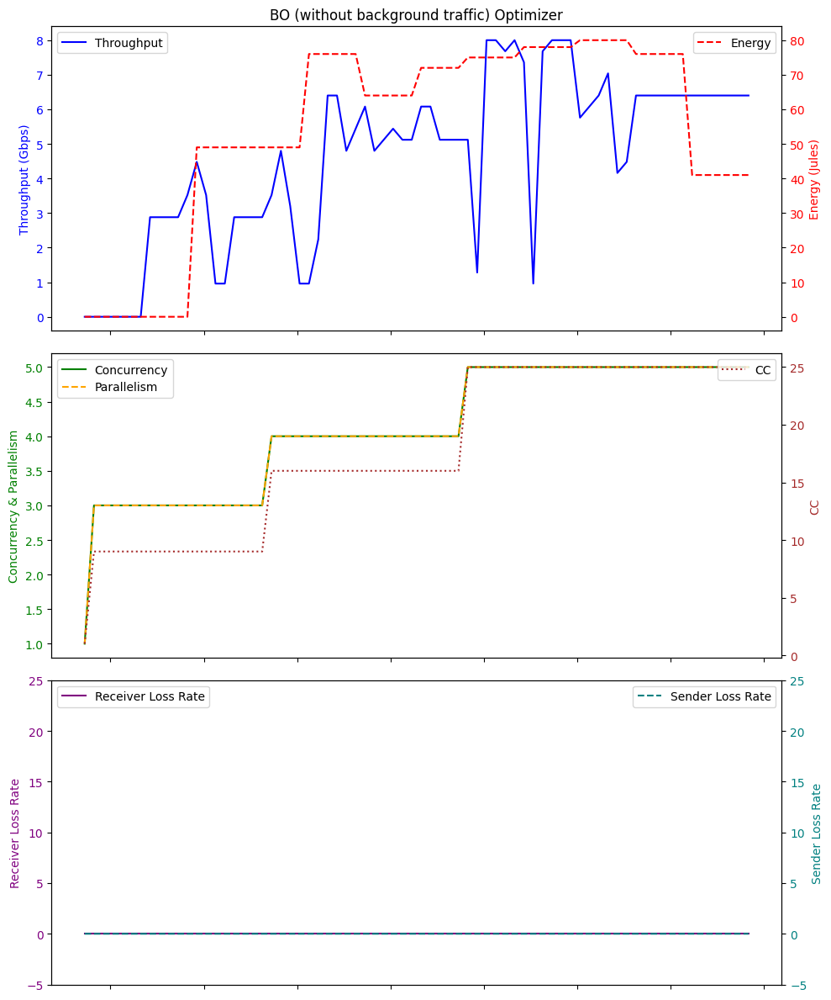

Average Throughput: 4.5777777777777775
Total Energy: 3929.0
Total loss rate: 0.0013196564482315988
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:04:12.696536        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:04:13.692239        0.00          0.0  64    0.0   0.0   
2  2024-01-26 04:04:14.691764        0.00          0.0  64    0.0  32.7   
3  2024-01-26 04:04:15.692794        0.00          0.0  64    0.0  32.7   
4  2024-01-26 04:04:16.691399        0.00          0.0  64    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 04:05:19.756655        2.88          0.0   9    3.0  32.7   
68 2024-01-26 04:05:20.757171        2.88          0.0   9    3.0  32.8   
69 2024-01-26 04:05:21.755913        2.88          0.0   9    3.0  32.8   
70 2024-01-26 04:05:22.756995        2.88          0.0   9    3.0  32.8   
71 2024-01-26 04:05:23.754015        2.88          0.0   9    3.0  32.6   



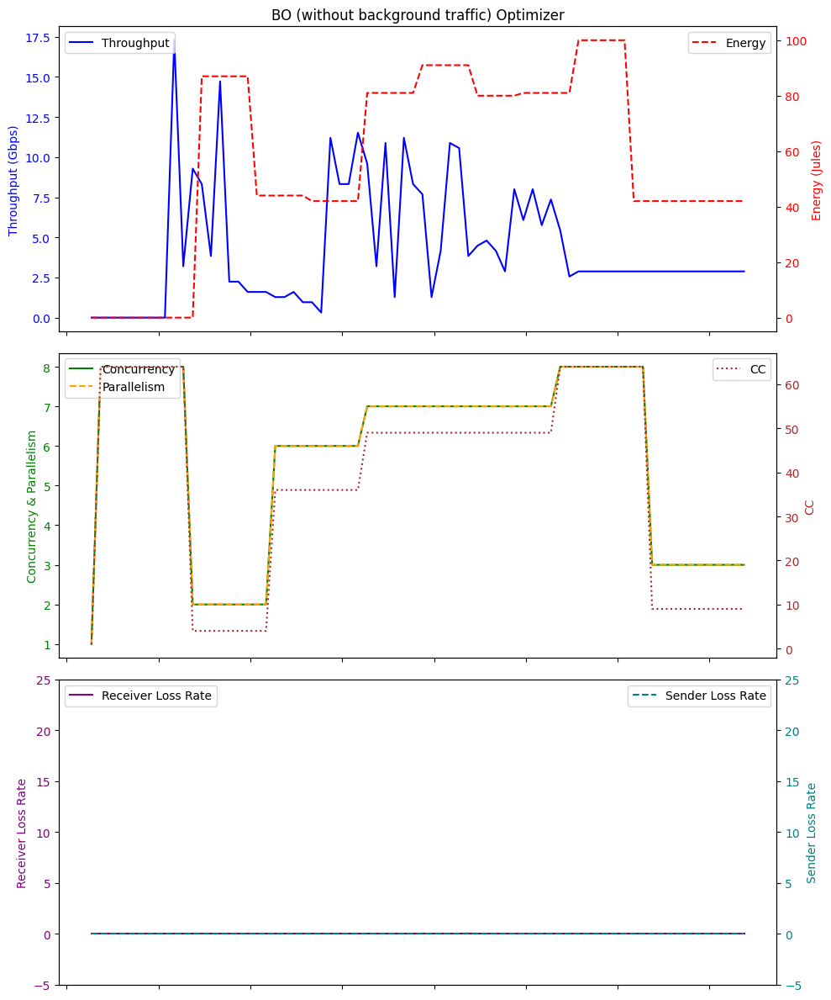

Average Throughput: 4.288888888888889
Total Energy: 4102.0
Total loss rate: 0.025355848371700098
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:31:36.605625        0.00          0.0   1    0.0   0.0   
1  2024-01-26 01:31:37.603339        0.00          0.0   9    0.0   0.0   
2  2024-01-26 01:31:38.603445        0.00          0.0   9    0.0  32.6   
3  2024-01-26 01:31:39.603332        0.00          0.0   9    0.0  32.6   
4  2024-01-26 01:31:40.609280        0.00          0.0   9    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 01:32:43.668783        0.32          0.0   1    0.0  32.6   
68 2024-01-26 01:32:44.668726        0.32          0.0   1    0.0  32.7   
69 2024-01-26 01:32:45.672321        0.32          0.0   1    0.0  32.7   
70 2024-01-26 01:32:46.673704        0.32          0.0   1    0.0  32.7   
71 2024-01-26 01:32:47.673680        0.32          0.0   1    0.0  32.7   

  

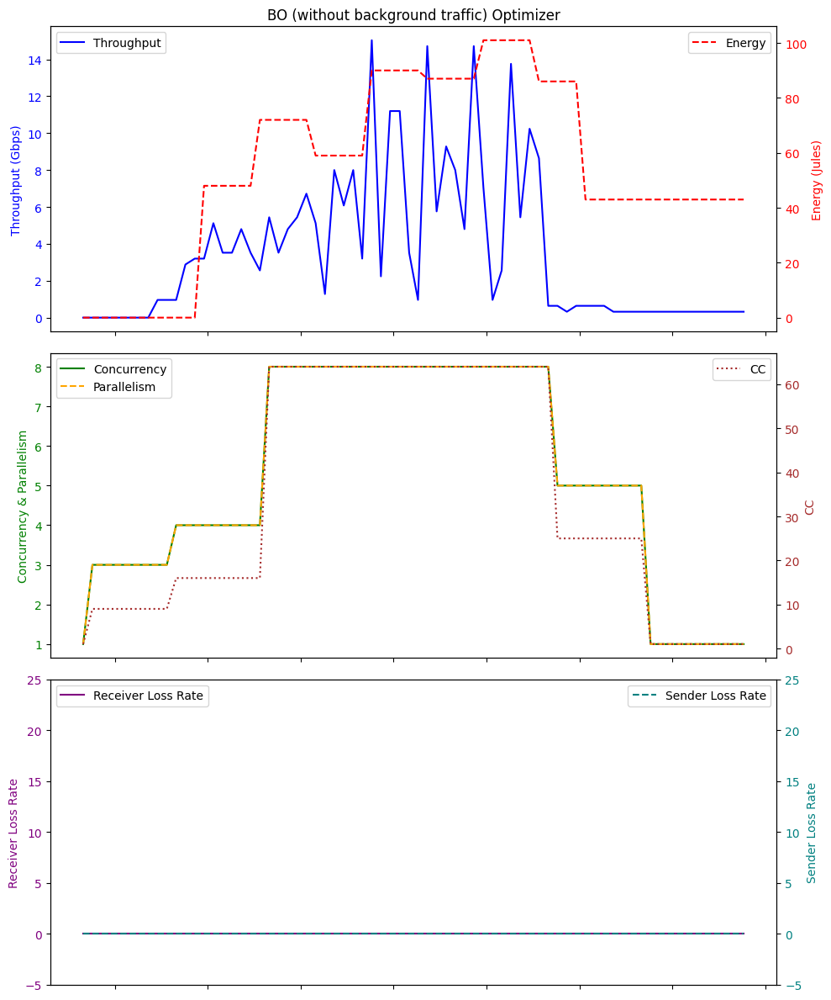

Average Throughput: 3.497777777777778
Total Energy: 3946.0
Total loss rate: 0.002733598467231685
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:58:20.495783        0.00          0.0   1    0.0   0.0   
1  2024-01-26 01:58:21.491672        0.00          0.0  16    0.0   0.0   
2  2024-01-26 01:58:22.491681        0.00          0.0  16    0.0  32.7   
3  2024-01-26 01:58:23.493093        0.00          0.0  16    0.0  32.7   
4  2024-01-26 01:58:24.495242        0.00          0.0  16    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 01:59:26.558889        3.52          0.0  64    3.0  32.6   
67 2024-01-26 01:59:27.558499        3.52          0.0  64    3.0  32.7   
68 2024-01-26 01:59:28.558143        3.52          0.0  64    3.0  32.8   
69 2024-01-26 01:59:29.561152        3.52          0.0  64    3.0  32.7   
70 2024-01-26 01:59:30.561514        3.52          0.0  64    3.0  32.7   

  

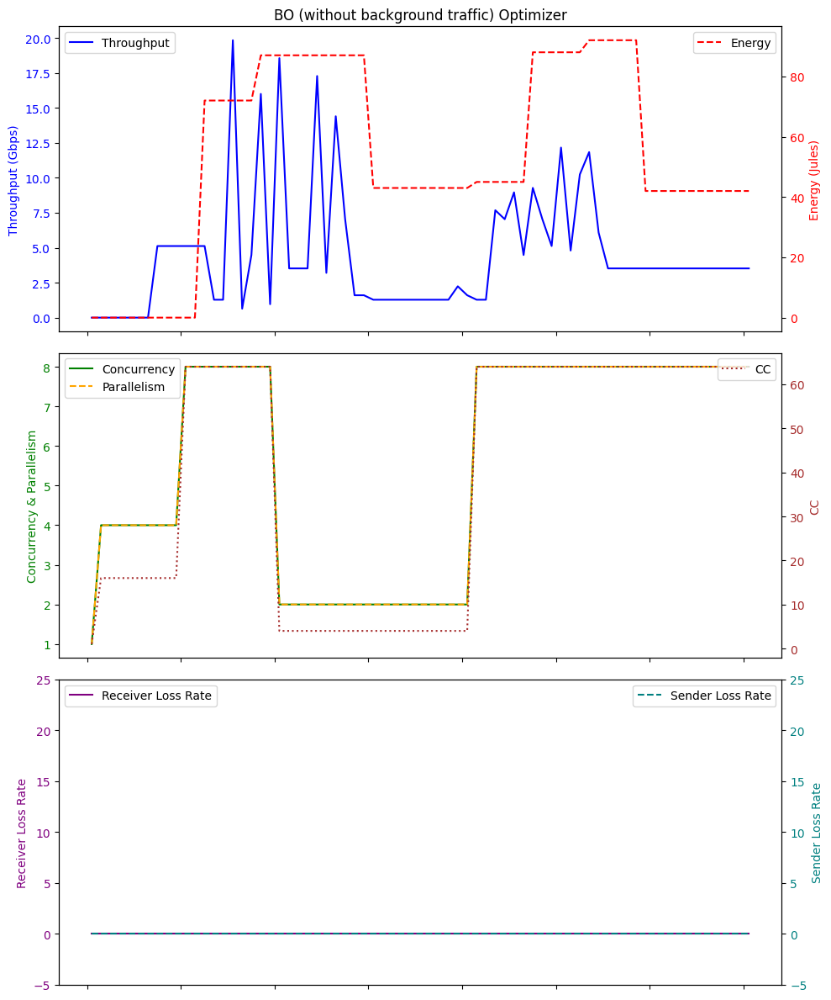

Average Throughput: 4.48450704225352
Total Energy: 3803.0
Total loss rate: 0.0016626152372297455
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:31:39.509147        0.00          0.0   1    0.0   0.0   
1  2024-01-26 02:31:40.503476        0.00          0.0  25    0.0   0.0   
2  2024-01-26 02:31:41.504268        0.00          0.0  25    0.0  32.7   
3  2024-01-26 02:31:42.504552        0.00          0.0  25    0.0  32.7   
4  2024-01-26 02:31:43.504237        0.00          0.0  25    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 02:32:36.554630        0.32          0.0  36    0.0  32.7   
58 2024-01-26 02:32:37.558638        0.32          0.0  36    0.0  32.7   
59 2024-01-26 02:32:38.559437        0.32          0.0  36    0.0  32.7   
60 2024-01-26 02:32:39.557937        0.32          0.0  36    0.0  32.6   
61 2024-01-26 02:32:40.558532        0.32          0.0  36    0.0  32.7   

  

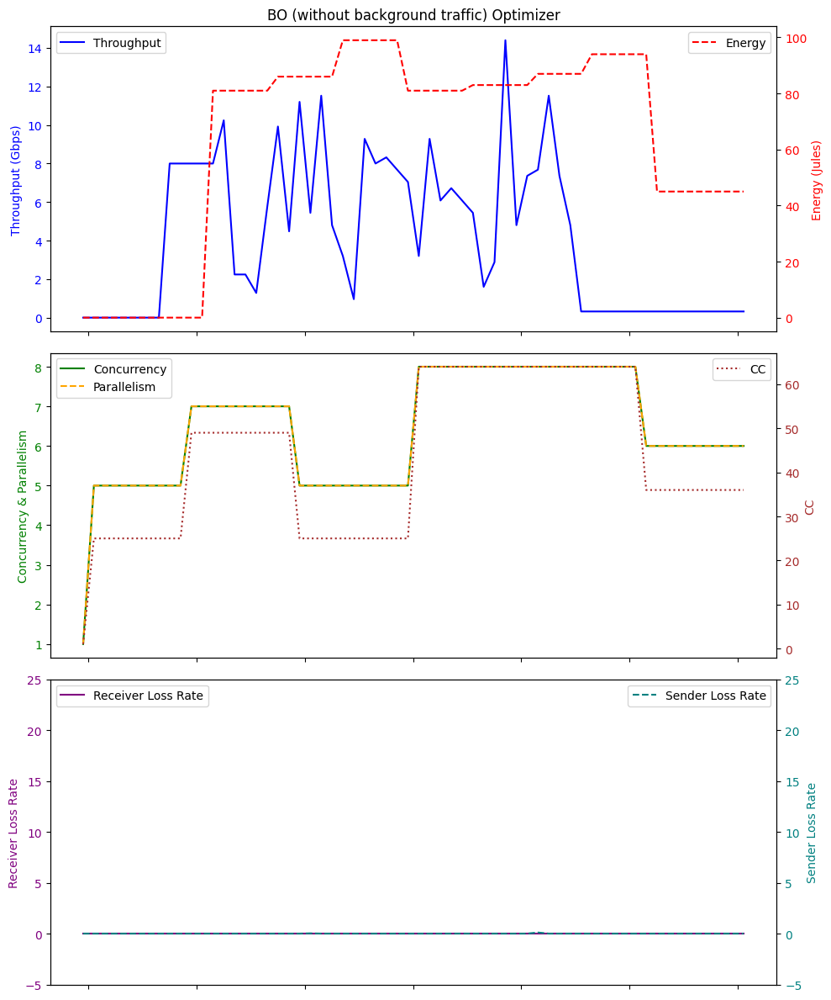

Average Throughput: 4.159999999999999
Total Energy: 3984.0
Total loss rate: 0.13358180620550922
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:10:05.022002        0.00          0.0   1    0.0   0.0   
1  2024-01-26 02:10:06.018687        0.00          0.0  36    0.0   0.0   
2  2024-01-26 02:10:07.019350        0.00          0.0  36    0.0  32.6   
3  2024-01-26 02:10:08.018667        0.00          0.0  36    0.0  32.6   
4  2024-01-26 02:10:09.022242        0.00          0.0  36    0.0  32.6   
5  2024-01-26 02:10:10.021956        0.00          0.0  36    0.0  32.6   
6  2024-01-26 02:10:11.024884        0.00          0.0  36    0.0  32.6   
7  2024-01-26 02:10:12.028580        0.00          0.0  36    0.0  33.0   
8  2024-01-26 02:10:13.028143        9.60          0.0  36    9.0  32.8   
9  2024-01-26 02:10:14.018662        9.60          0.0  36    9.0  36.1   
10 2024-01-26 02:10:15.019015        9.60          0.0  64    0.0  32.7   
11 2

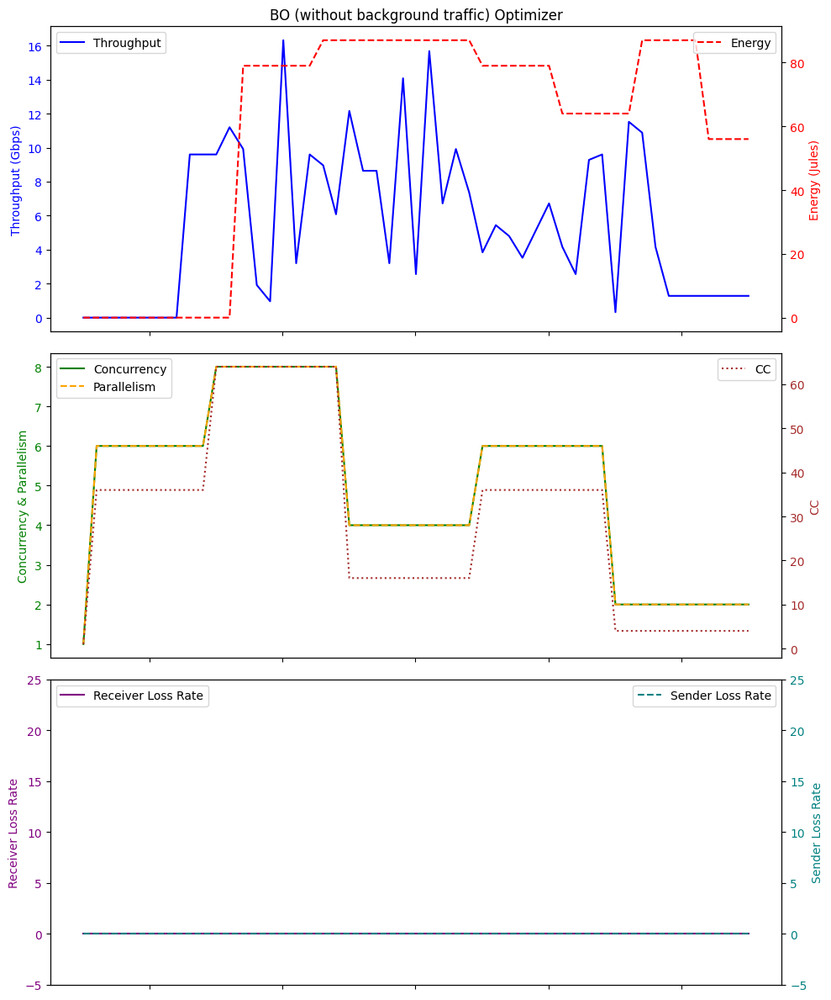

Average Throughput: 5.427450980392156
Total Energy: 3035.0
Total loss rate: 0.002425785400053039
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:05:34.227270        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:05:35.224408        0.00          0.0  25    0.0   0.0   
2  2024-01-26 03:05:36.224404        0.00          0.0  25    0.0  32.6   
3  2024-01-26 03:05:37.224363        0.00          0.0  25    0.0  32.7   
4  2024-01-26 03:05:38.226814        0.00          0.0  25    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 03:06:40.289967        1.92          0.0  16    2.0  32.7   
67 2024-01-26 03:06:41.292385        1.92          0.0  16    2.0  32.6   
68 2024-01-26 03:06:42.294055        1.92          0.0  16    2.0  32.8   
69 2024-01-26 03:06:43.293496        1.92          0.0  16    2.0  32.8   
70 2024-01-26 03:06:44.296352        1.92          0.0  16    2.0  32.6   

  

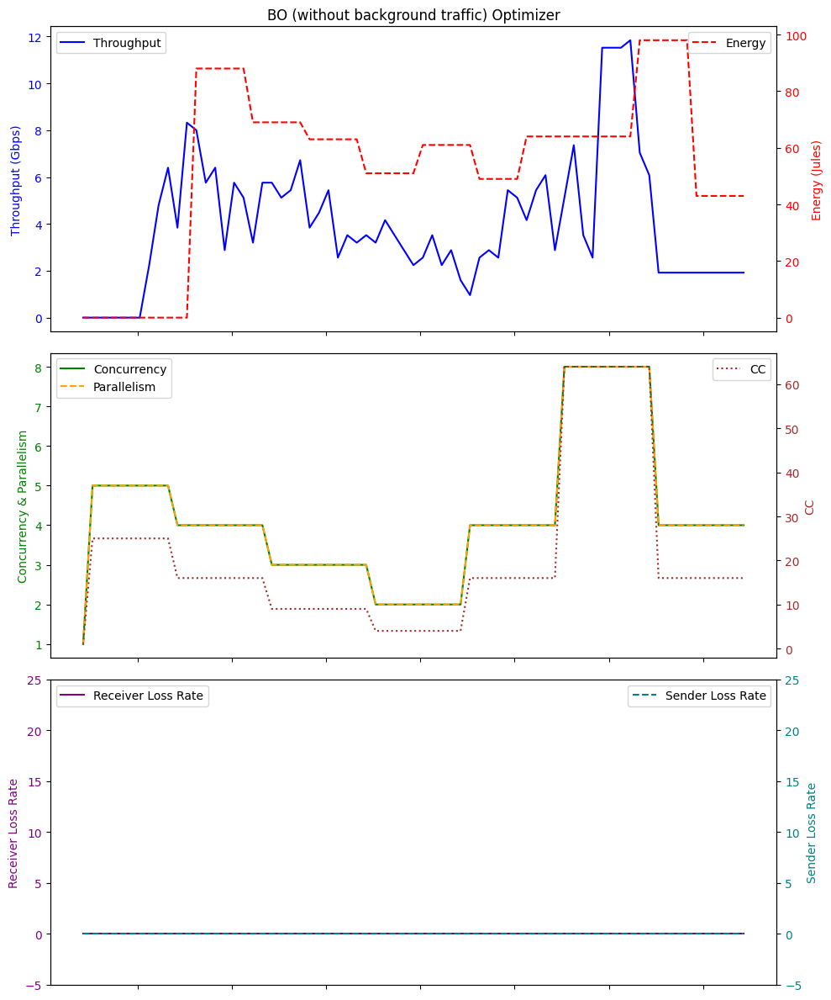

Average Throughput: 3.975211267605635
Total Energy: 3851.0
Total loss rate: 0.004897205156641361
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:00:54.097617        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:00:55.093682        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:00:56.093699        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:00:57.094797        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:00:58.096674        0.00          0.0  49    0.0  32.7   
5  2024-01-26 03:00:59.099024        0.00          0.0  49    0.0  32.6   
6  2024-01-26 03:01:00.099598        0.00          0.0  49    0.0  32.5   
7  2024-01-26 03:01:01.101228        0.00          0.0  49    0.0  33.3   
8  2024-01-26 03:01:02.101318        8.64          0.0  49    8.0  33.0   
9  2024-01-26 03:01:03.128594        8.96          0.0  49    8.0  33.0   
10 2024-01-26 03:01:04.095645        0.32          0.0  49    0.0  32.7   
11 

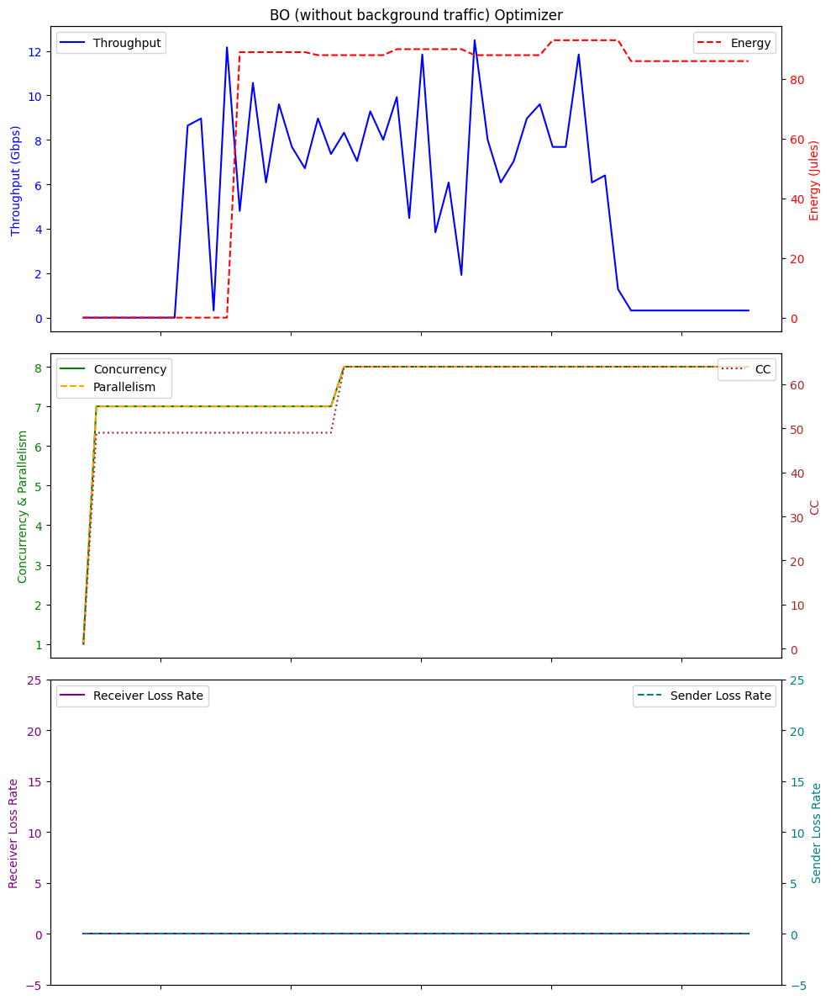

Average Throughput: 4.978461538461539
Total Energy: 3548.0
Total loss rate: 0.004339938408367555
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:35:55.939387        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:35:56.933640        0.00          0.0   4    0.0   0.0   
2  2024-01-26 04:35:57.933865        0.00          0.0   4    0.0  32.7   
3  2024-01-26 04:35:58.936518        0.00          0.0   4    0.0  32.7   
4  2024-01-26 04:35:59.938243        0.00          0.0   4    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 04:37:13.017031        1.28          0.0  25    1.0  32.7   
78 2024-01-26 04:37:14.017435        1.28          0.0  25    1.0  32.7   
79 2024-01-26 04:37:15.018665        1.28          0.0  25    1.0  32.7   
80 2024-01-26 04:37:16.019264        1.28          0.0  25    1.0  32.7   
81 2024-01-26 04:37:17.019536        1.28          0.0  25    1.0  32.8   

  

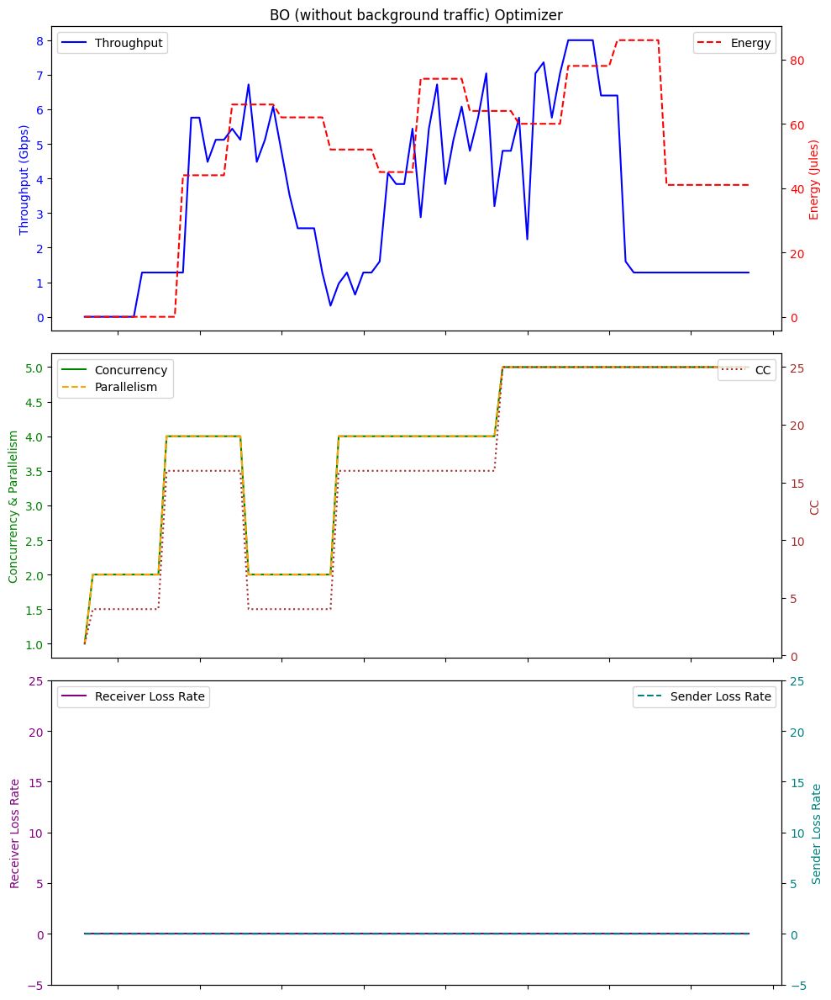

Average Throughput: 3.37170731707317
Total Energy: 4192.0
Total loss rate: 0.002071616965006728
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:54:26.666764        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:54:27.662167        0.00          0.0   9    0.0   0.0   
2  2024-01-26 03:54:28.662706        0.00          0.0   9    0.0  32.6   
3  2024-01-26 03:54:29.666084        0.00          0.0   9    0.0  32.6   
4  2024-01-26 03:54:30.665319        0.00          0.0   9    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:55:22.727828        1.92          0.0  36    2.0  32.7   
57 2024-01-26 03:55:23.726993        1.92          0.0  36    2.0  32.7   
58 2024-01-26 03:55:24.727339        1.92          0.0  36    2.0  32.8   
59 2024-01-26 03:55:25.730887        1.92          0.0  36    2.0  32.8   
60 2024-01-26 03:55:26.730860        1.92          0.0  36    2.0  32.7   

   

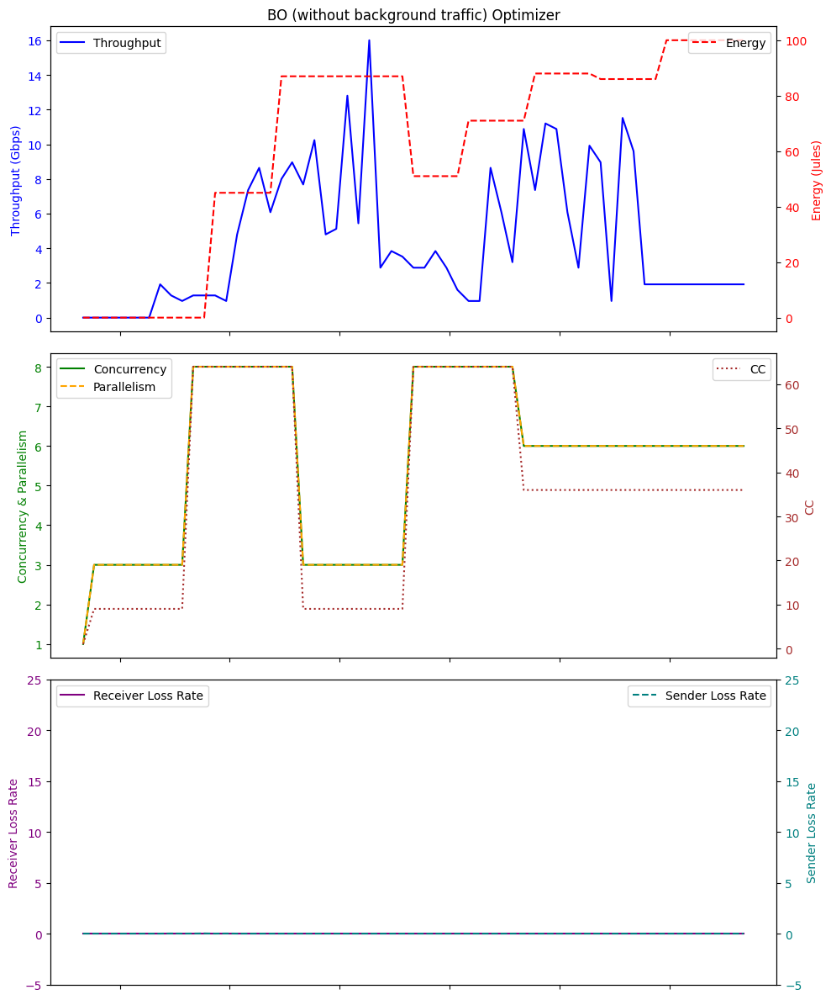

Average Throughput: 4.4013114754098375
Total Energy: 3839.0
Total loss rate: 0.046125847803273695
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:55:50.097995        0.00          0.0   1    0.0   0.0   
1  2024-01-26 02:55:51.093457        0.00          0.0  36    0.0   0.0   
2  2024-01-26 02:55:52.092414        0.00          0.0  36    0.0  32.7   
3  2024-01-26 02:55:53.095506        0.00          0.0  36    0.0  32.6   
4  2024-01-26 02:55:54.096023        0.00          0.0  36    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 02:56:47.150989        0.64          0.0  64    1.0  32.6   
58 2024-01-26 02:56:48.149908        0.64          0.0  64    1.0  32.7   
59 2024-01-26 02:56:49.150774        0.64          0.0  64    1.0  32.7   
60 2024-01-26 02:56:50.153352        0.64          0.0  64    1.0  32.7   
61 2024-01-26 02:56:51.146762        0.64          0.0  64    1.0  32.7   

 

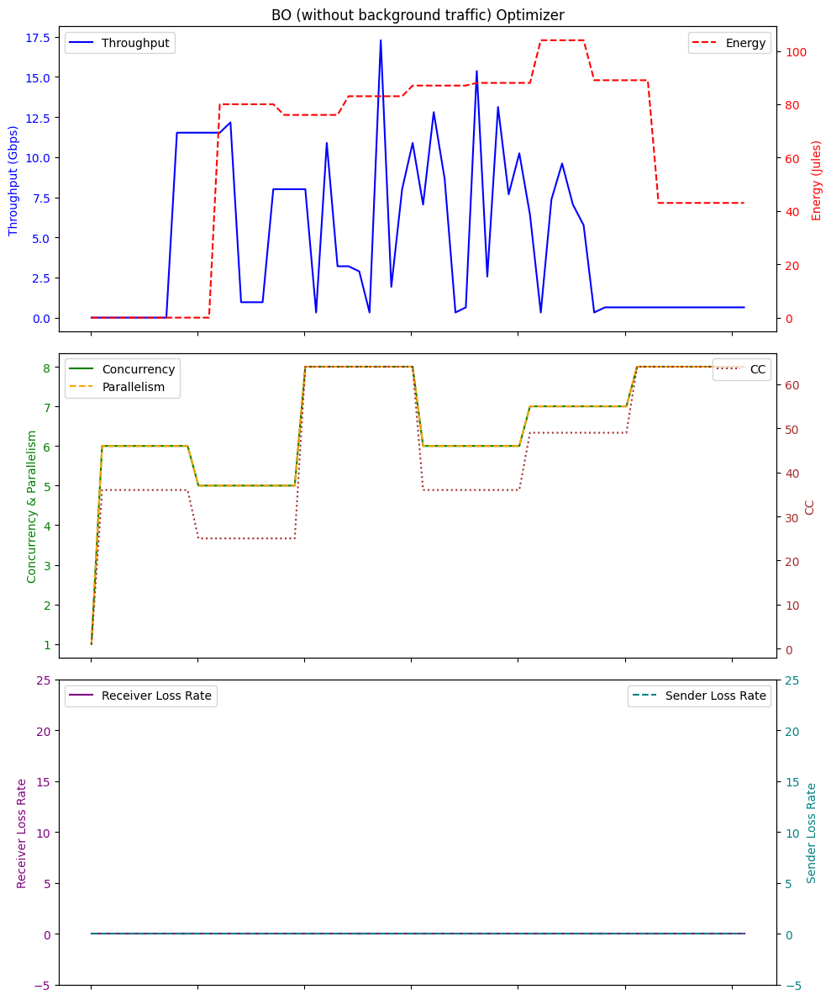

Average Throughput: 4.639999999999998
Total Energy: 3925.0
Total loss rate: 0.007639703767986986
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:43:25.591097        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:43:26.588467        0.00          0.0  36    0.0   0.0   
2  2024-01-26 03:43:27.587474        0.00          0.0  36    0.0  32.7   
3  2024-01-26 03:43:28.588906        0.00          0.0  36    0.0  32.7   
4  2024-01-26 03:43:29.591452        0.00          0.0  36    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 03:44:42.665490        0.64          0.0  64    1.0  32.7   
78 2024-01-26 03:44:43.665355        0.64          0.0  64    1.0  32.6   
79 2024-01-26 03:44:44.669190        0.64          0.0  64    1.0  32.7   
80 2024-01-26 03:44:45.668491        0.64          0.0  64    1.0  32.8   
81 2024-01-26 03:44:46.669554        0.64          0.0  64    1.0  32.8   

  

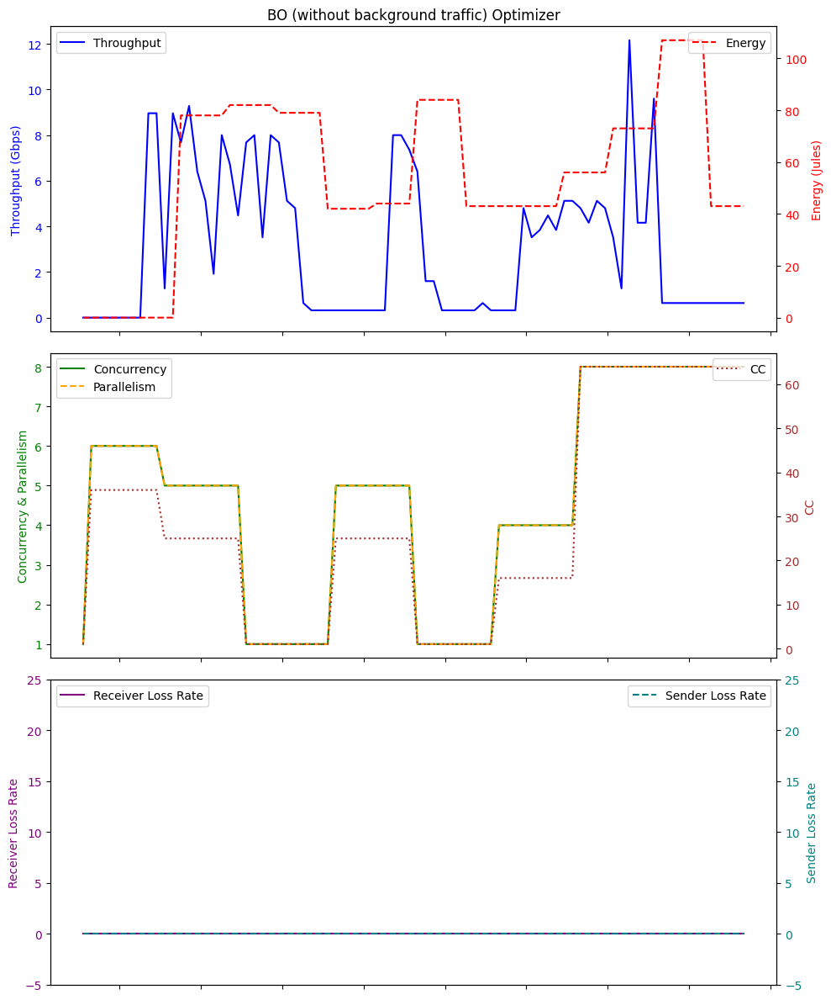

Average Throughput: 3.1024390243902444
Total Energy: 4557.0
Total loss rate: 0.015346023749412376
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 03:48:45.095486        0.00          0.0   1    0.0   0.0   
1   2024-01-26 03:48:46.089657        0.00          0.0  64    0.0   0.0   
2   2024-01-26 03:48:47.091685        0.00          0.0  64    0.0  32.6   
3   2024-01-26 03:48:48.093119        0.00          0.0  64    0.0  32.6   
4   2024-01-26 03:48:49.092852        0.00          0.0  64    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
98  2024-01-26 03:50:23.191391        1.28          0.0   4    1.0  32.8   
99  2024-01-26 03:50:24.191041        1.28          0.0   4    1.0  32.8   
100 2024-01-26 03:50:25.194736        1.28          0.0   4    1.0  32.7   
101 2024-01-26 03:50:26.194586        1.28          0.0   4    1.0  32.7   
102 2024-01-26 03:50:27.193341        1.28          0.0   4    1.0

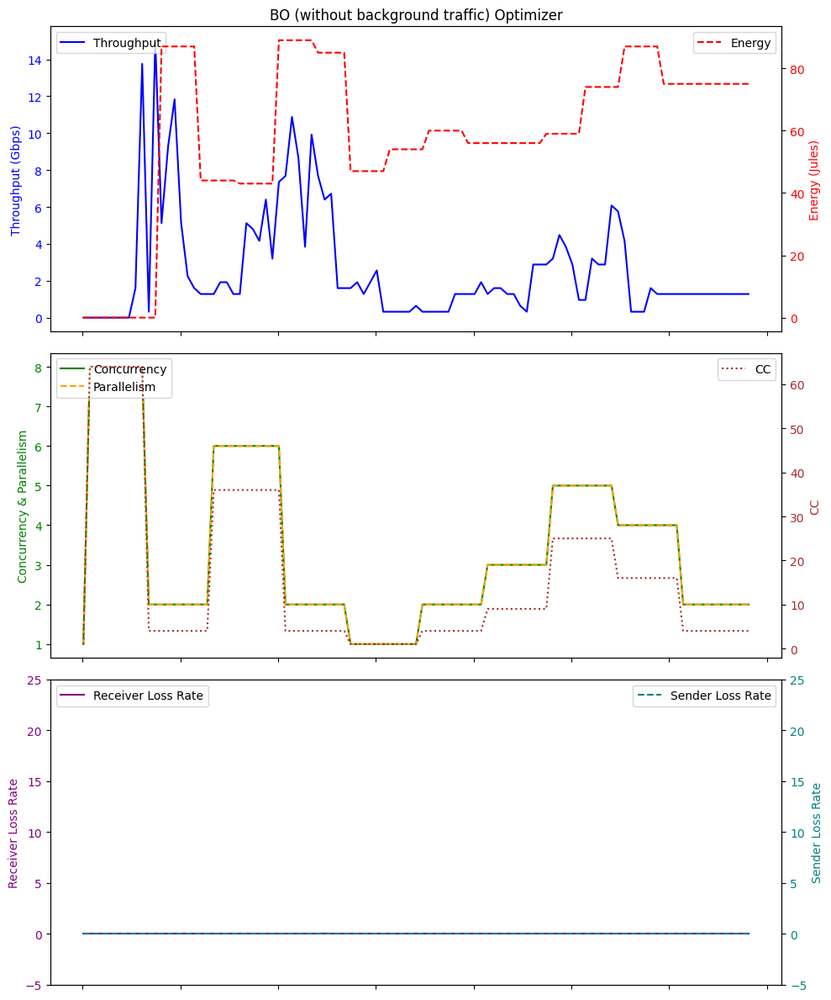

Average Throughput: 2.6407766990291246
Total Energy: 6011.0
Total loss rate: 0.021791199482840567
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:19:31.417117         0.0          0.0   1    0.0   0.0   
1   2024-01-26 01:19:32.414003         0.0          0.0  49    0.0   0.0   
2   2024-01-26 01:19:33.411885         0.0          0.0  49    0.0  32.7   
3   2024-01-26 01:19:34.415195         0.0          0.0  49    0.0  33.0   
4   2024-01-26 01:19:35.415247         0.0          0.0  49    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
97  2024-01-26 01:21:08.513264         1.6          0.0  64    1.0  32.6   
98  2024-01-26 01:21:09.509988         1.6          0.0  64    1.0  32.6   
99  2024-01-26 01:21:10.510727         1.6          0.0  64    1.0  32.7   
100 2024-01-26 01:21:11.513542         1.6          0.0  64    1.0  32.7   
101 2024-01-26 01:21:12.515170         1.6          0.0  64    1.0

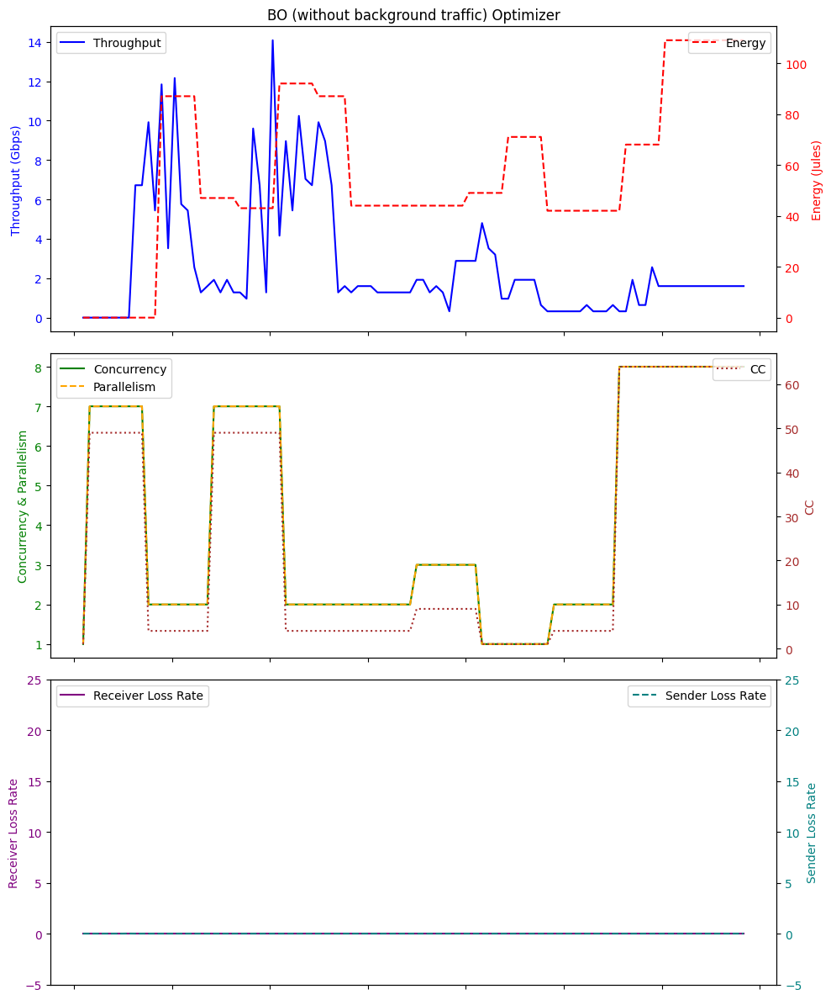

Average Throughput: 2.67294117647059
Total Energy: 5890.0
Total loss rate: 0.007217583528263827
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:10:56.242599        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:10:57.237546        0.00          0.0  64    0.0   0.0   
2  2024-01-26 03:10:58.238172        0.00          0.0  64    0.0  32.6   
3  2024-01-26 03:10:59.237705        0.00          0.0  64    0.0  32.6   
4  2024-01-26 03:11:00.240310        0.00          0.0  64    0.0  32.6   
5  2024-01-26 03:11:01.240980        0.00          0.0  64    0.0  32.6   
6  2024-01-26 03:11:02.243807        0.00          0.0  64    0.0  32.6   
7  2024-01-26 03:11:03.246431        0.00          0.0  64    0.0  40.2   
8  2024-01-26 03:11:04.235022        9.92          0.0  64    8.0  44.3   
9  2024-01-26 03:11:05.240312        1.60          0.0  64    1.0  32.6   
10 2024-01-26 03:11:06.243141       10.24          0.0  16    9.0  33.2   
11 2

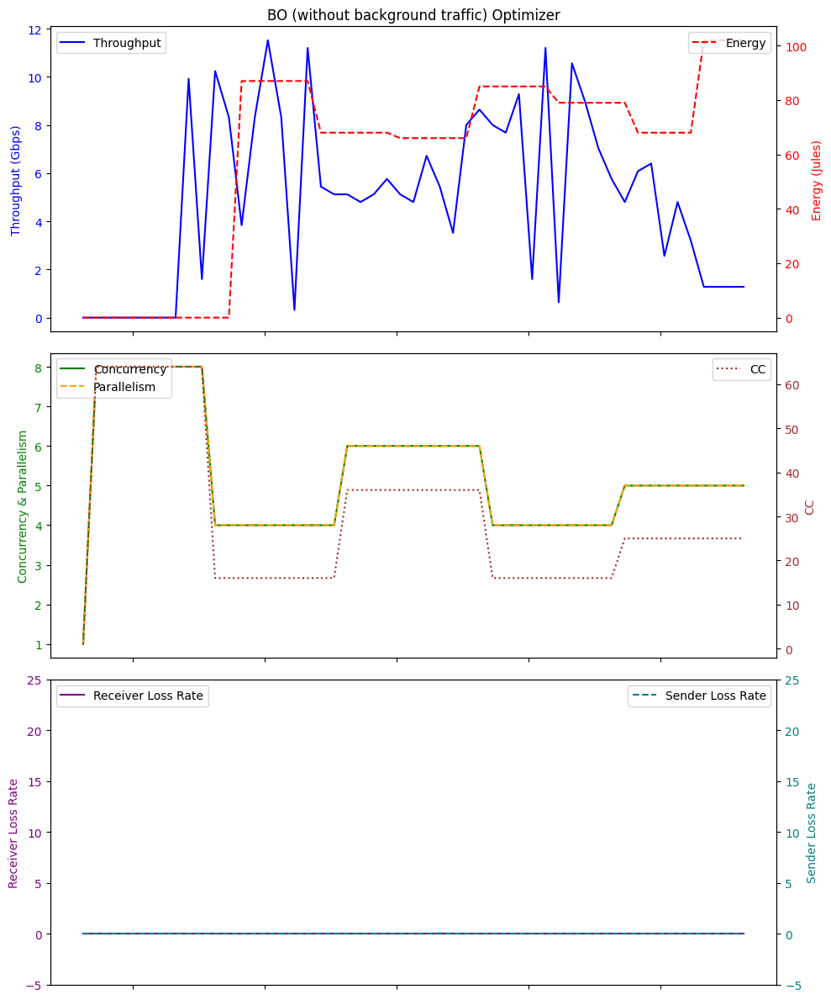

Average Throughput: 4.91921568627451
Total Energy: 3058.0
Total loss rate: 0.03852059546304229
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:20:09.972960        0.00          0.0   1    0.0   0.0   
1  2024-01-26 02:20:10.972085        0.00          0.0  16    0.0   0.0   
2  2024-01-26 02:20:11.973377        0.00          0.0  16    0.0  32.6   
3  2024-01-26 02:20:12.972507        0.00          0.0  16    0.0  32.7   
4  2024-01-26 02:20:13.972016        0.00          0.0  16    0.0  32.6   
5  2024-01-26 02:20:14.975346        0.00          0.0  16    0.0  32.6   
6  2024-01-26 02:20:15.978178        0.00          0.0  16    0.0  32.6   
7  2024-01-26 02:20:16.982440        2.56          0.0  16    2.0  32.8   
8  2024-01-26 02:20:17.977202        2.56          0.0  16    2.0  32.9   
9  2024-01-26 02:20:18.980715        2.56          0.0  16    2.0  32.8   
10 2024-01-26 02:20:19.981003        2.88          0.0  25    2.0  32.6   
11 20

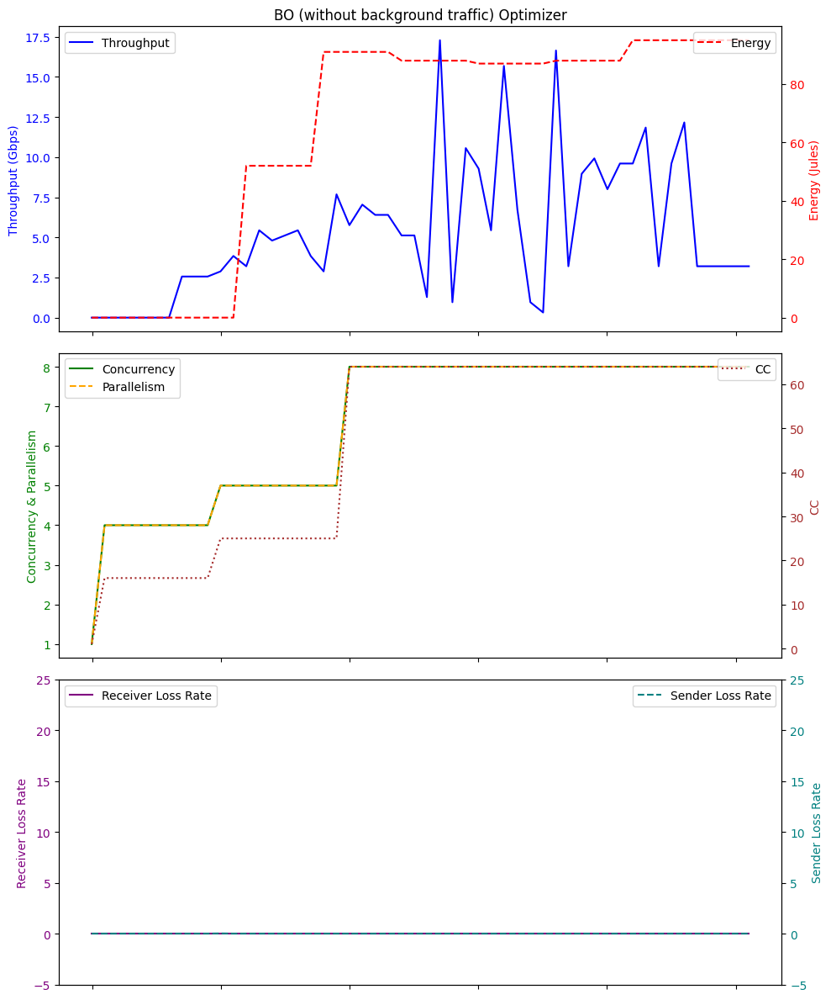

Average Throughput: 5.304615384615383
Total Energy: 3386.0
Total loss rate: 0.018475407294985022
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:23:20.761580        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:23:21.758895        0.00          0.0  36    0.0   0.0   
2  2024-01-26 04:23:22.760847        0.00          0.0  36    0.0  32.7   
3  2024-01-26 04:23:23.760785        0.00          0.0  36    0.0  32.7   
4  2024-01-26 04:23:24.761532        0.00          0.0  36    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
87 2024-01-26 04:24:47.845101        0.32          0.0  64    0.0  32.7   
88 2024-01-26 04:24:48.847918        0.32          0.0  64    0.0  32.7   
89 2024-01-26 04:24:49.847831        0.32          0.0  64    0.0  32.6   
90 2024-01-26 04:24:50.848208        0.32          0.0  64    0.0  32.6   
91 2024-01-26 04:24:51.851216        0.32          0.0  64    0.0  32.6   

  

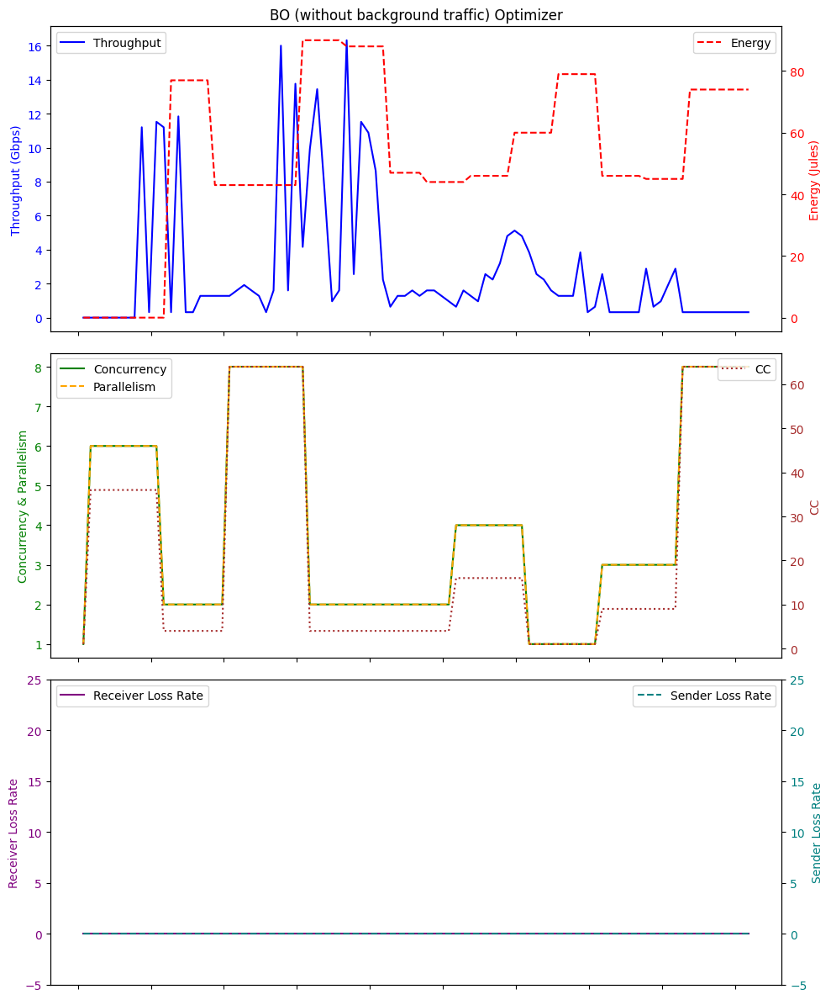

Average Throughput: 2.7930434782608695
Total Energy: 4867.0
Total loss rate: 0.007419025688472454
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:59:10.375048        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:59:11.372060        0.00          0.0   4    0.0   0.0   
2  2024-01-26 03:59:12.372258        0.00          0.0   4    0.0  32.6   
3  2024-01-26 03:59:13.372021        0.00          0.0   4    0.0  32.6   
4  2024-01-26 03:59:14.375912        0.00          0.0   4    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 04:00:17.440511        0.96          0.0  36    1.0  32.6   
68 2024-01-26 04:00:18.440561        0.96          0.0  36    1.0  32.7   
69 2024-01-26 04:00:19.443196        0.96          0.0  36    1.0  32.7   
70 2024-01-26 04:00:20.443578        0.96          0.0  36    1.0  32.8   
71 2024-01-26 04:00:21.443370        0.96          0.0  36    1.0  32.8   

 

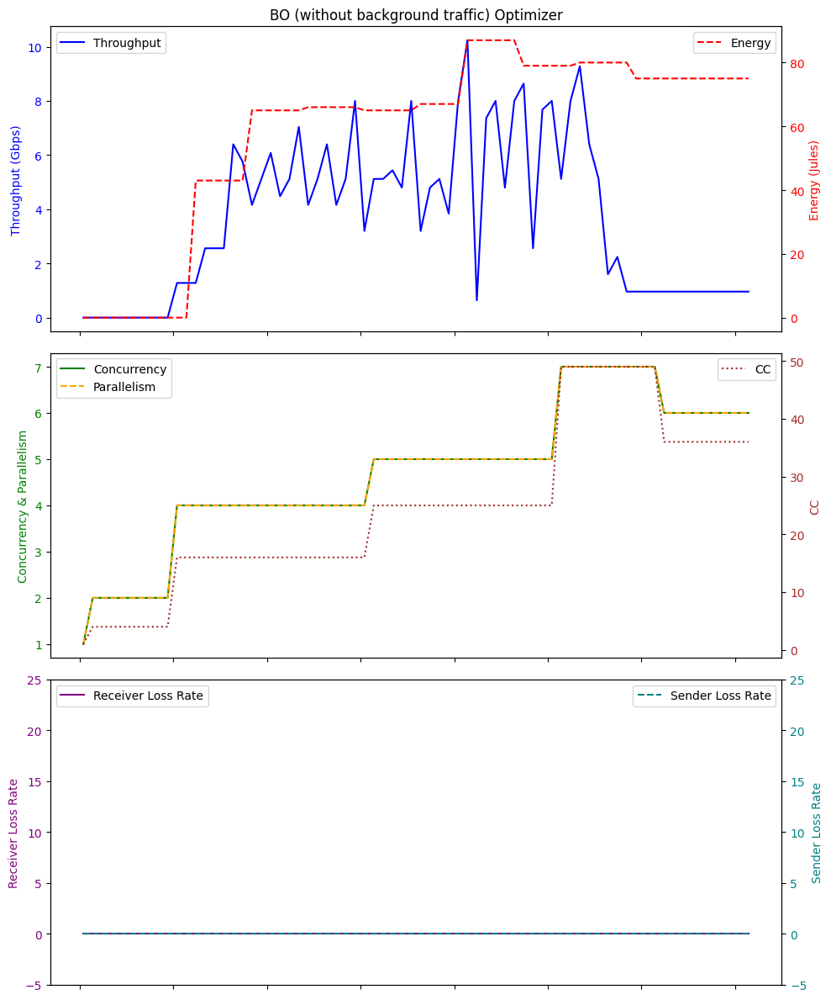

Average Throughput: 3.644444444444444
Total Energy: 4220.0
Total loss rate: 0.001966268276181421
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:22:55.977436         0.0          0.0   1    0.0   0.0   
1  2024-01-26 03:22:56.974308         0.0          0.0   4    0.0   0.0   
2  2024-01-26 03:22:57.974447         0.0          0.0   4    0.0  32.7   
3  2024-01-26 03:22:58.974132         0.0          0.0   4    0.0  32.7   
4  2024-01-26 03:22:59.977855         0.0          0.0   4    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 03:24:13.055094         8.0          0.0  64    7.0  32.7   
78 2024-01-26 03:24:14.056779         8.0          0.0  64    7.0  32.7   
79 2024-01-26 03:24:15.056215         8.0          0.0  64    7.0  32.7   
80 2024-01-26 03:24:16.058927         8.0          0.0  64    7.0  32.7   
81 2024-01-26 03:24:17.059252         8.0          0.0  64    7.0  32.7   

  

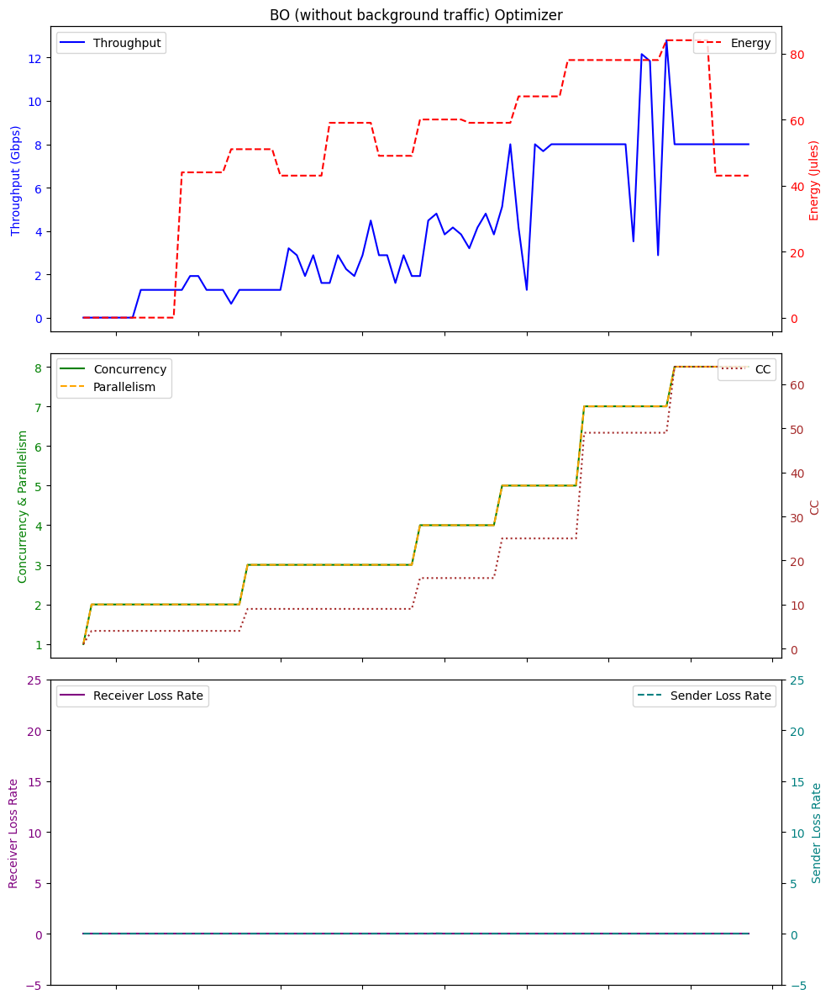

Average Throughput: 4.15609756097561
Total Energy: 4198.0
Total loss rate: 0.03322512382397141
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:41:50.889281         0.0          0.0   1    0.0   0.0   
1  2024-01-26 01:41:51.883554         0.0          0.0  49    0.0   0.0   
2  2024-01-26 01:41:52.885106         0.0          0.0  49    0.0  32.6   
3  2024-01-26 01:41:53.886413         0.0          0.0  49    0.0  32.6   
4  2024-01-26 01:41:54.886670         0.0          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 01:42:47.940988         1.6          0.0  64    1.0  32.6   
58 2024-01-26 01:42:48.939137         1.6          0.0  64    1.0  32.7   
59 2024-01-26 01:42:49.941426         1.6          0.0  64    1.0  32.7   
60 2024-01-26 01:42:50.942972         1.6          0.0  64    1.0  32.7   
61 2024-01-26 01:42:51.939404         1.6          0.0  64    1.0  32.6   

    

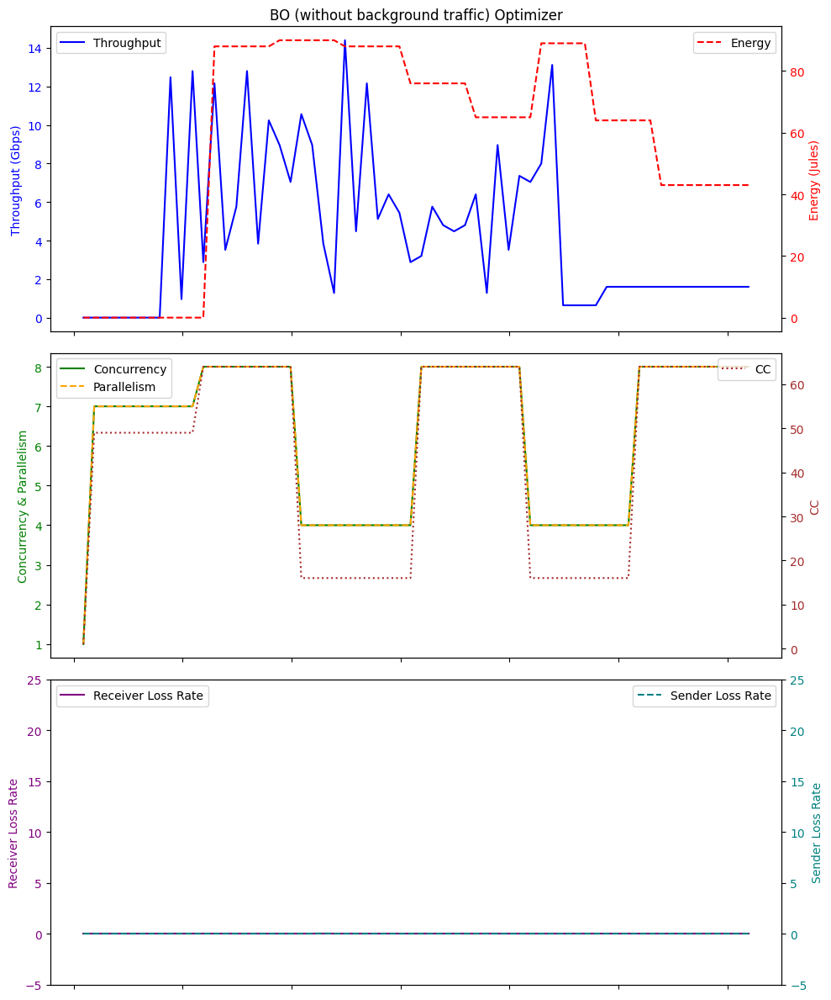

Average Throughput: 4.397419354838712
Total Energy: 3658.0
Total loss rate: 0.027589165885168746
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:41:16.483554        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:41:17.477952        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:41:18.479836        0.00          0.0  49    0.0  32.6   
3  2024-01-26 04:41:19.480013        0.00          0.0  49    0.0  32.8   
4  2024-01-26 04:41:20.481711        0.00          0.0  49    0.0  32.8   
5  2024-01-26 04:41:21.481743        0.00          0.0  49    0.0  32.8   
6  2024-01-26 04:41:22.475936        0.00          0.0  49    0.0  32.6   
7  2024-01-26 04:41:23.477365        0.00          0.0  49    0.0  33.3   
8  2024-01-26 04:41:24.477377        2.56          0.0  49    2.0  32.8   
9  2024-01-26 04:41:25.483997       11.84          0.0  49   10.0  33.5   
10 2024-01-26 04:41:26.479589        8.96          0.0  49    8.0  35.8   
11 

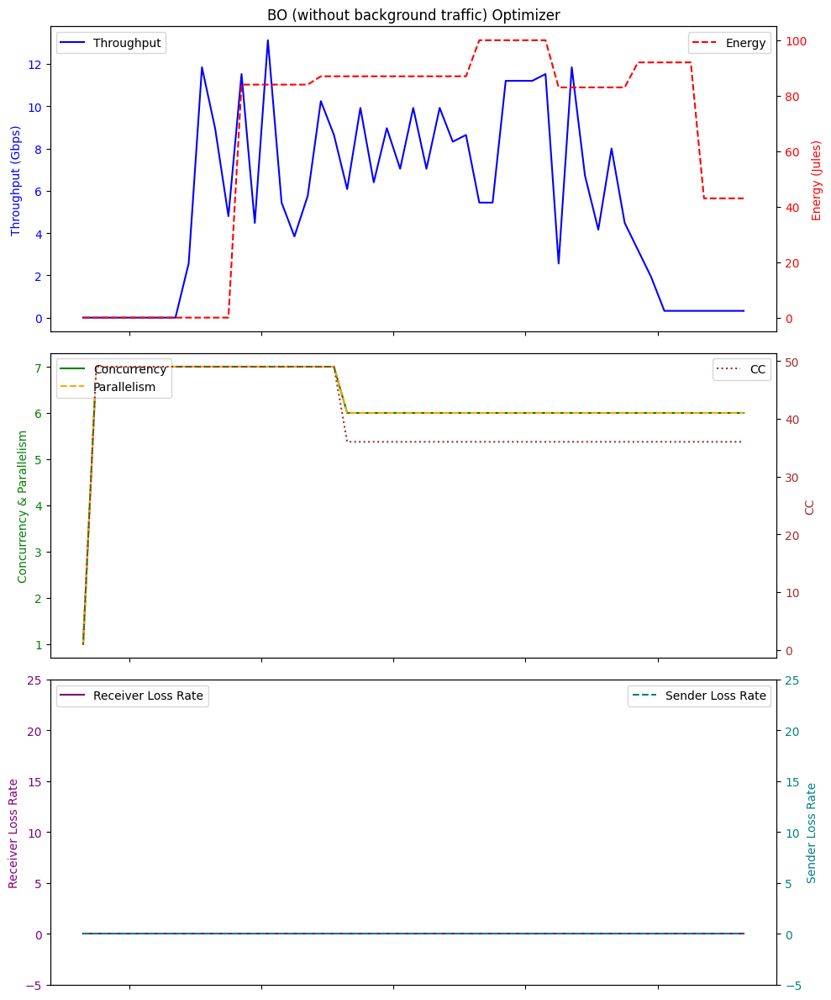

Average Throughput: 5.383529411764706
Total Energy: 3278.0
Total loss rate: 0.002563034730863069
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:28:10.564323        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:28:11.559165        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:28:12.561631        0.00          0.0  49    0.0  32.7   
3  2024-01-26 03:28:13.562711        0.00          0.0  49    0.0  32.6   
4  2024-01-26 03:28:14.563073        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 03:29:16.624594        0.32          0.0  16    0.0  32.7   
67 2024-01-26 03:29:17.627123        0.32          0.0  16    0.0  32.7   
68 2024-01-26 03:29:18.627915        0.32          0.0  16    0.0  32.7   
69 2024-01-26 03:29:19.627806        0.32          0.0  16    0.0  32.9   
70 2024-01-26 03:29:20.628895        0.32          0.0  16    0.0  32.7   

  

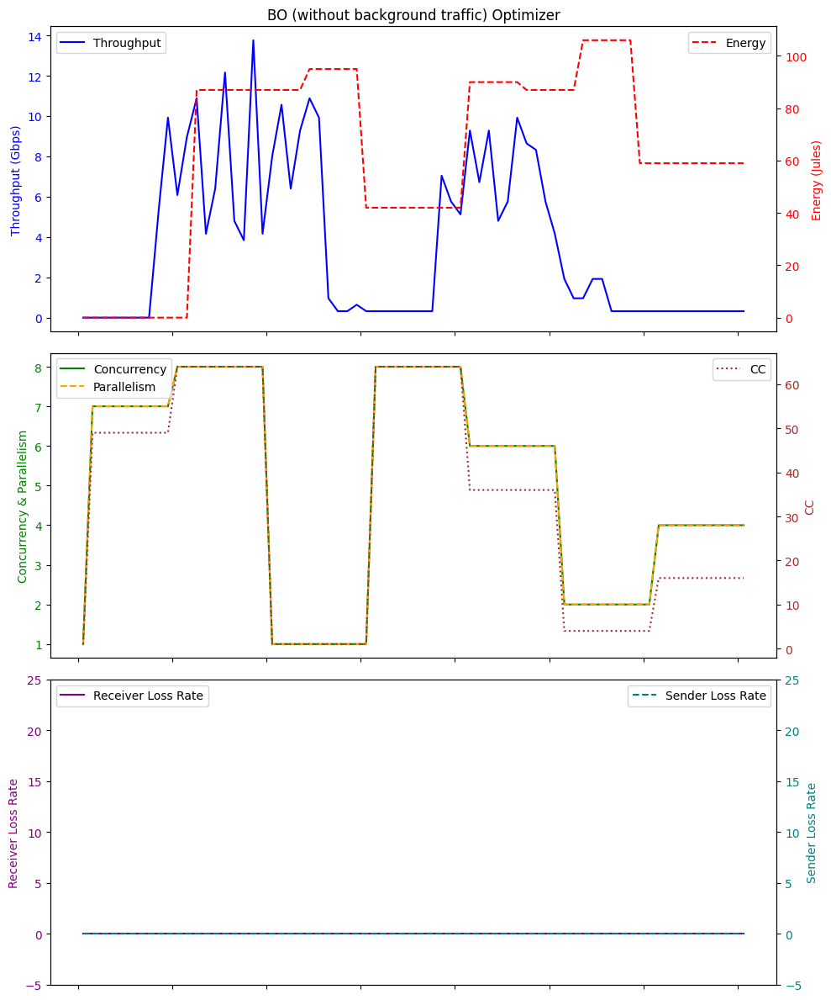

Average Throughput: 3.5695774647887317
Total Energy: 4482.0
Total loss rate: 0.012098080350833044
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:43:15.282543         0.0          0.0   1    0.0   0.0   
1  2024-01-26 02:43:16.279458         0.0          0.0  64    0.0   0.0   
2  2024-01-26 02:43:17.281809         0.0          0.0  64    0.0  32.8   
3  2024-01-26 02:43:18.281253         0.0          0.0  64    0.0  32.7   
4  2024-01-26 02:43:19.282387         0.0          0.0  64    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 02:44:22.345710         8.0          0.0  49    7.0  32.7   
68 2024-01-26 02:44:23.346476         8.0          0.0  49    7.0  32.8   
69 2024-01-26 02:44:24.347757         8.0          0.0  49    7.0  32.8   
70 2024-01-26 02:44:25.347917         8.0          0.0  49    7.0  32.7   
71 2024-01-26 02:44:26.344602         8.0          0.0  49    7.0  32.7   

 

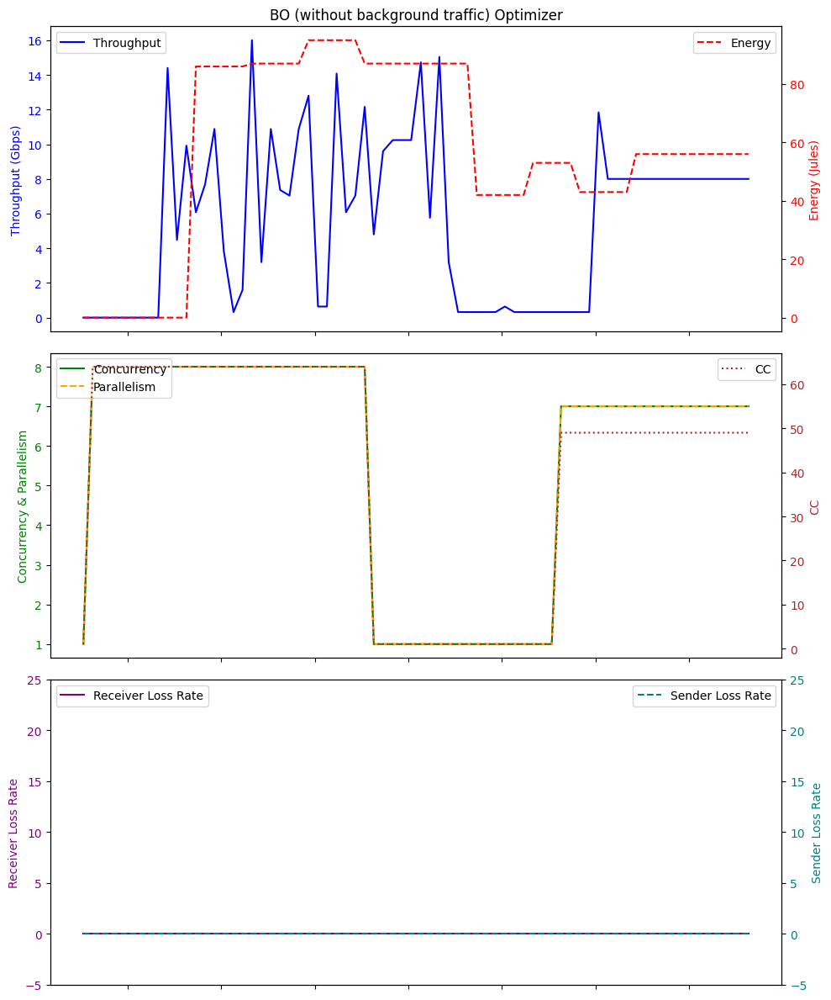

Average Throughput: 5.51111111111111
Total Energy: 4155.0
Total loss rate: 0.010257911965830643
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:37:55.451542        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:37:56.447093        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:37:57.448951        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:37:58.446844        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:37:59.450525        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 03:39:12.521240        0.32          0.0   1    0.0  32.6   
78 2024-01-26 03:39:13.524387        0.32          0.0   1    0.0  32.7   
79 2024-01-26 03:39:14.525248        0.32          0.0   1    0.0  32.7   
80 2024-01-26 03:39:15.524486        0.32          0.0   1    0.0  32.7   
81 2024-01-26 03:39:16.527570        0.32          0.0   1    0.0  32.7   

   

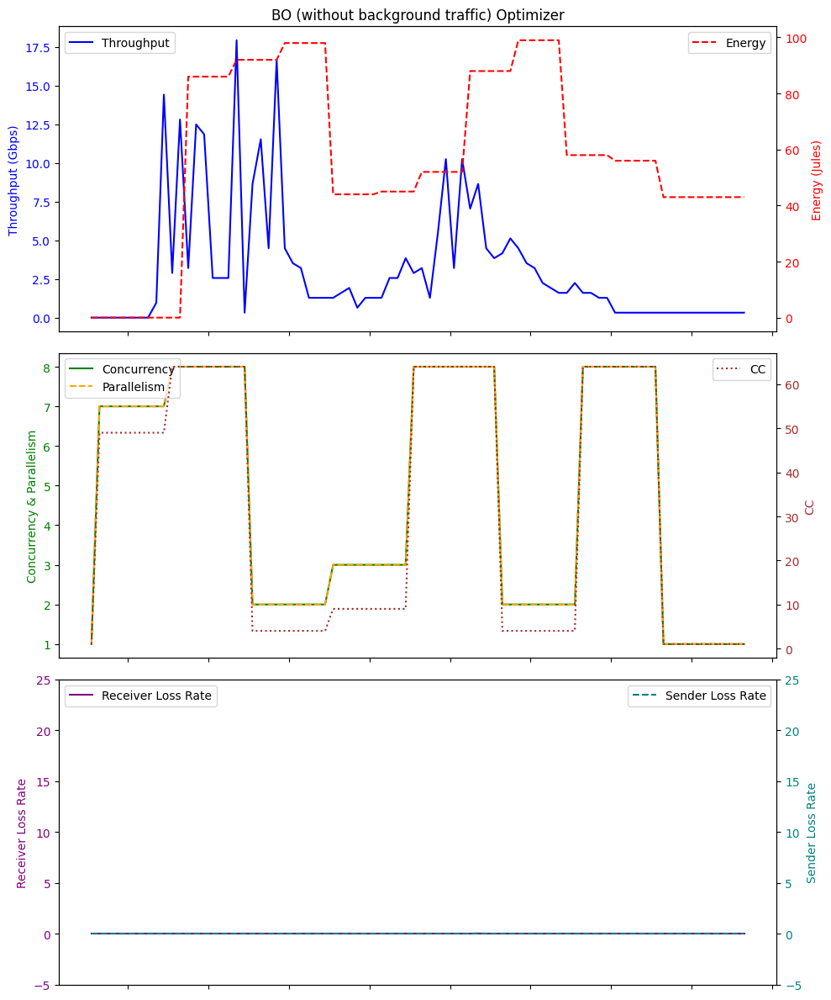

Average Throughput: 3.180487804878049
Total Energy: 4736.0
Total loss rate: 0.031171712447542212
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:36:56.703767        0.00          0.0   1    0.0   0.0   
1  2024-01-26 01:36:57.696006        0.00          0.0   4    0.0   0.0   
2  2024-01-26 01:36:58.698391        0.00          0.0   4    0.0  32.6   
3  2024-01-26 01:36:59.699851        0.00          0.0   4    0.0  32.7   
4  2024-01-26 01:37:00.699044        0.00          0.0   4    0.0  32.6   
5  2024-01-26 01:37:01.701247        0.00          0.0   4    0.0  32.6   
6  2024-01-26 01:37:02.703113        0.00          0.0   4    0.0  32.6   
7  2024-01-26 01:37:03.703329        0.64          0.0   4    1.0  32.6   
8  2024-01-26 01:37:04.704909        0.64          0.0   4    1.0  32.6   
9  2024-01-26 01:37:05.707365        0.64          0.0   4    1.0  32.6   
10 2024-01-26 01:37:06.707351        1.28          0.0  49    1.0  32.6   
11 

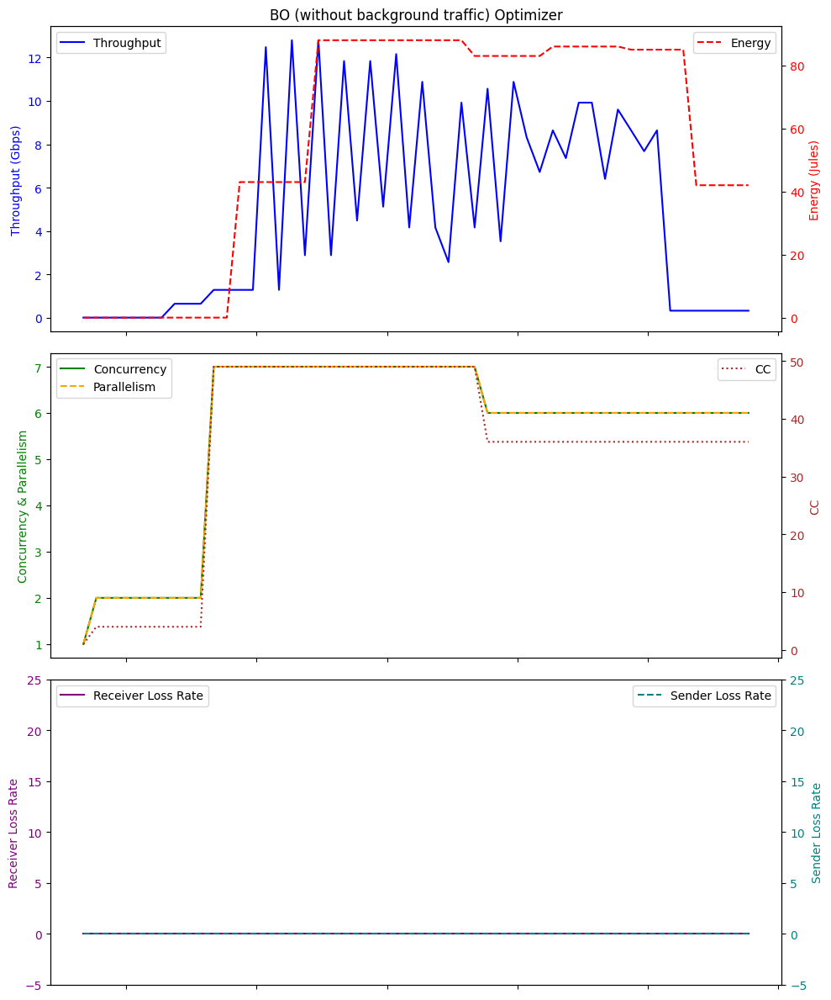

Average Throughput: 4.855384615384614
Total Energy: 2963.0
Total loss rate: 0.0023908012337389914
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:33:20.485268        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:33:21.483442        0.00          0.0  64    0.0   0.0   
2  2024-01-26 03:33:22.483150        0.00          0.0  64    0.0  32.8   
3  2024-01-26 03:33:23.483110        0.00          0.0  64    0.0  32.7   
4  2024-01-26 03:33:24.485831        0.00          0.0  64    0.0  32.8   
5  2024-01-26 03:33:25.486461        0.00          0.0  64    0.0  32.8   
6  2024-01-26 03:33:26.516399        0.00          0.0  64    0.0  32.6   
7  2024-01-26 03:33:27.519435        0.00          0.0  64    0.0  34.6   
8  2024-01-26 03:33:28.486222        0.00          0.0  64    0.0  32.8   
9  2024-01-26 03:33:29.538451       18.24          0.0  64   16.0  36.6   
10 2024-01-26 03:33:30.514548        2.24          0.0  64    2.0  33.0   
11

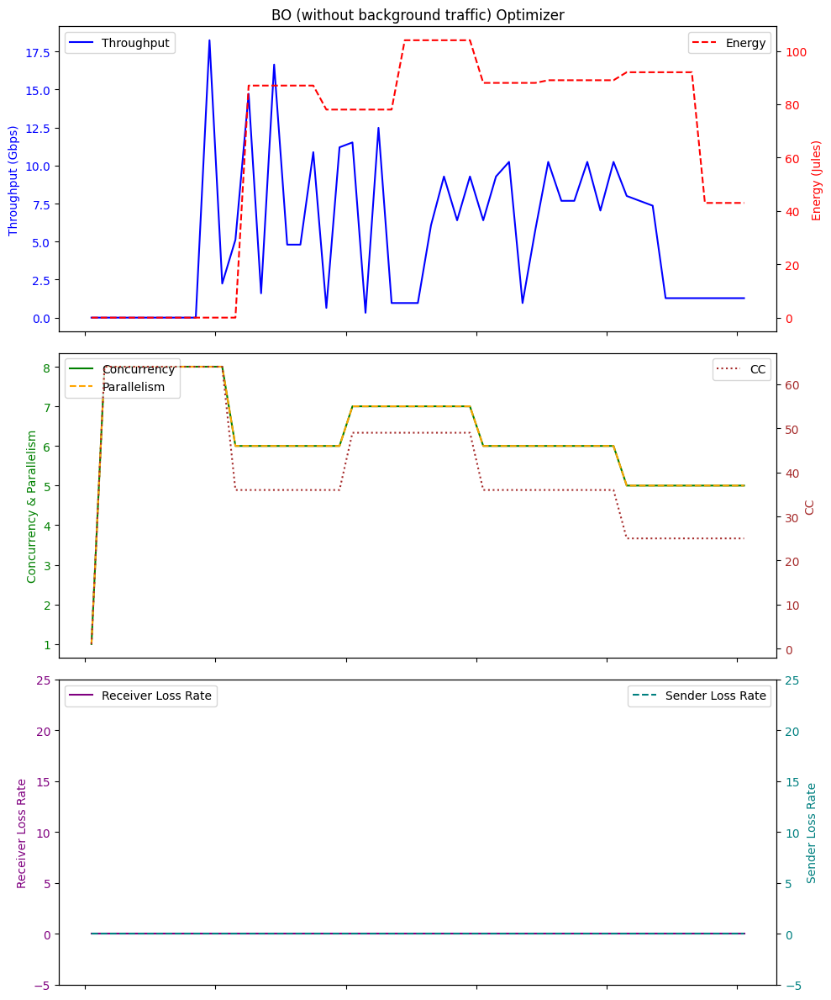

Average Throughput: 5.232941176470587
Total Energy: 3312.0
Total loss rate: 0.0019470337282782497
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:10:35.911050        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:10:36.905945        0.00          0.0  25    0.0   0.0   
2  2024-01-26 04:10:37.904943        0.00          0.0  25    0.0  32.7   
3  2024-01-26 04:10:38.905508        0.00          0.0  25    0.0  32.6   
4  2024-01-26 04:10:39.907910        0.00          0.0  25    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
87 2024-01-26 04:12:02.990118        0.32          0.0  64    0.0  32.7   
88 2024-01-26 04:12:03.992278        0.32          0.0  64    0.0  32.7   
89 2024-01-26 04:12:04.993884        0.32          0.0  64    0.0  32.6   
90 2024-01-26 04:12:05.992943        0.32          0.0  64    0.0  32.6   
91 2024-01-26 04:12:06.993674        0.32          0.0  64    0.0  32.7   

 

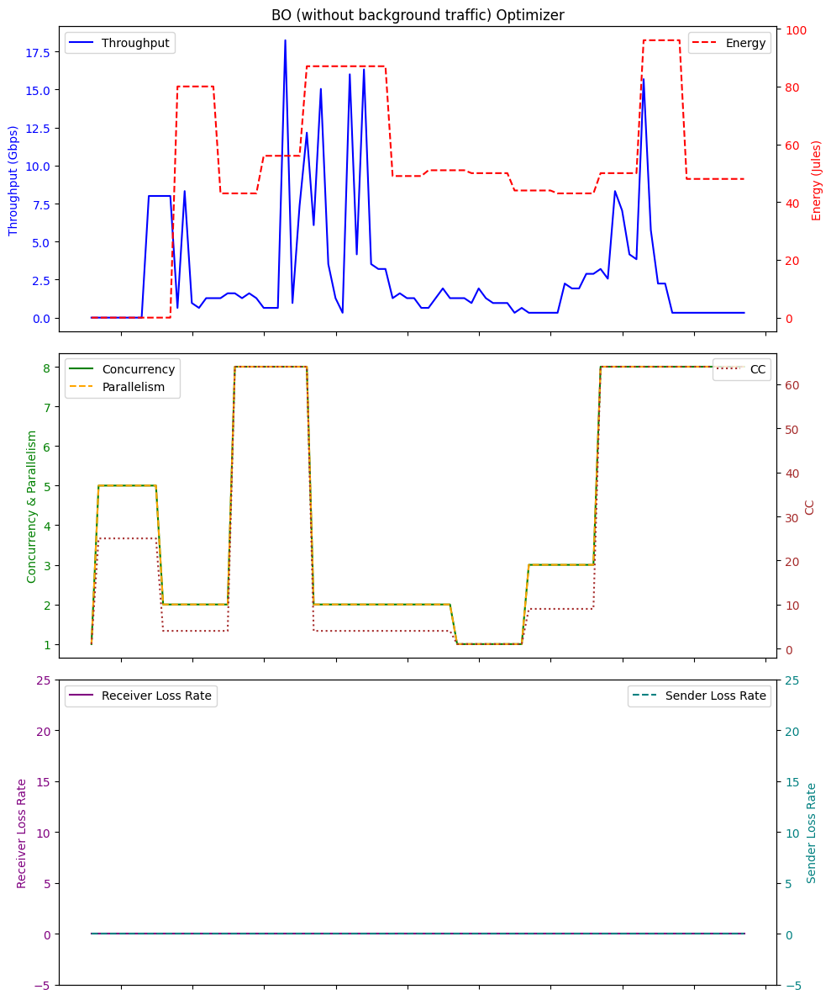

Average Throughput: 2.834782608695652
Total Energy: 4799.0
Total loss rate: 0.012533169655043114
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:46:23.751881        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:46:24.746639        0.00          0.0  16    0.0   0.0   
2  2024-01-26 04:46:25.749624        0.00          0.0  16    0.0  32.7   
3  2024-01-26 04:46:26.751416        0.00          0.0  16    0.0  32.7   
4  2024-01-26 04:46:27.749411        0.00          0.0  16    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 04:47:30.817526        0.64          0.0  64    1.0  32.7   
68 2024-01-26 04:47:31.820730        0.64          0.0  64    1.0  32.7   
69 2024-01-26 04:47:32.821302        0.64          0.0  64    1.0  32.8   
70 2024-01-26 04:47:33.820722        0.64          0.0  64    1.0  32.8   
71 2024-01-26 04:47:34.819273        0.64          0.0  64    1.0  32.9   

  

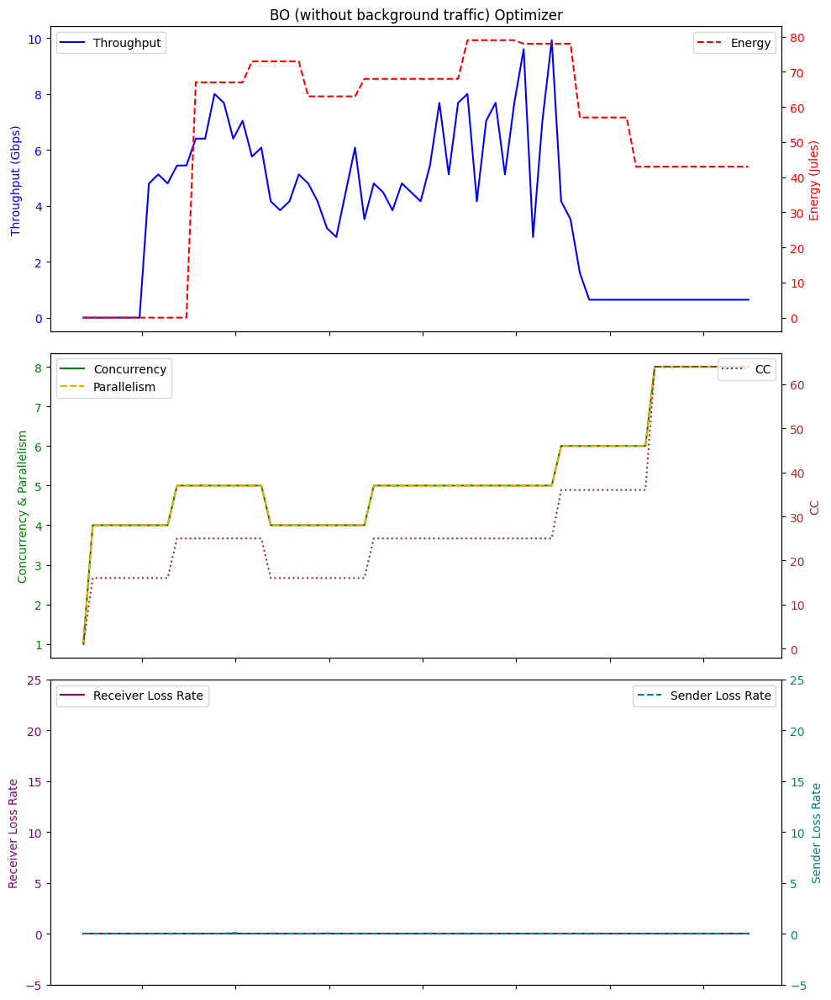

Average Throughput: 3.724444444444445
Total Energy: 3809.0
Total loss rate: 0.10927835247458294
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:53:16.268214        0.00          0.0   1    0.0   0.0   
1  2024-01-26 01:53:17.262467        0.00          0.0   9    0.0   0.0   
2  2024-01-26 01:53:18.264704        0.00          0.0   9    0.0  32.7   
3  2024-01-26 01:53:19.264996        0.00          0.0   9    0.0  32.8   
4  2024-01-26 01:53:20.266534        0.00          0.0   9    0.0  32.8   
5  2024-01-26 01:53:21.266422        0.00          0.0   9    0.0  32.8   
6  2024-01-26 01:53:22.268560        0.00          0.0   9    0.0  32.7   
7  2024-01-26 01:53:23.265972        1.92          0.0   9    2.0  32.8   
8  2024-01-26 01:53:24.274057        1.92          0.0   9    2.0  32.7   
9  2024-01-26 01:53:25.275006        1.92          0.0   9    2.0  32.6   
10 2024-01-26 01:53:26.272874        2.56          0.0  36    2.0  32.9   
11 2

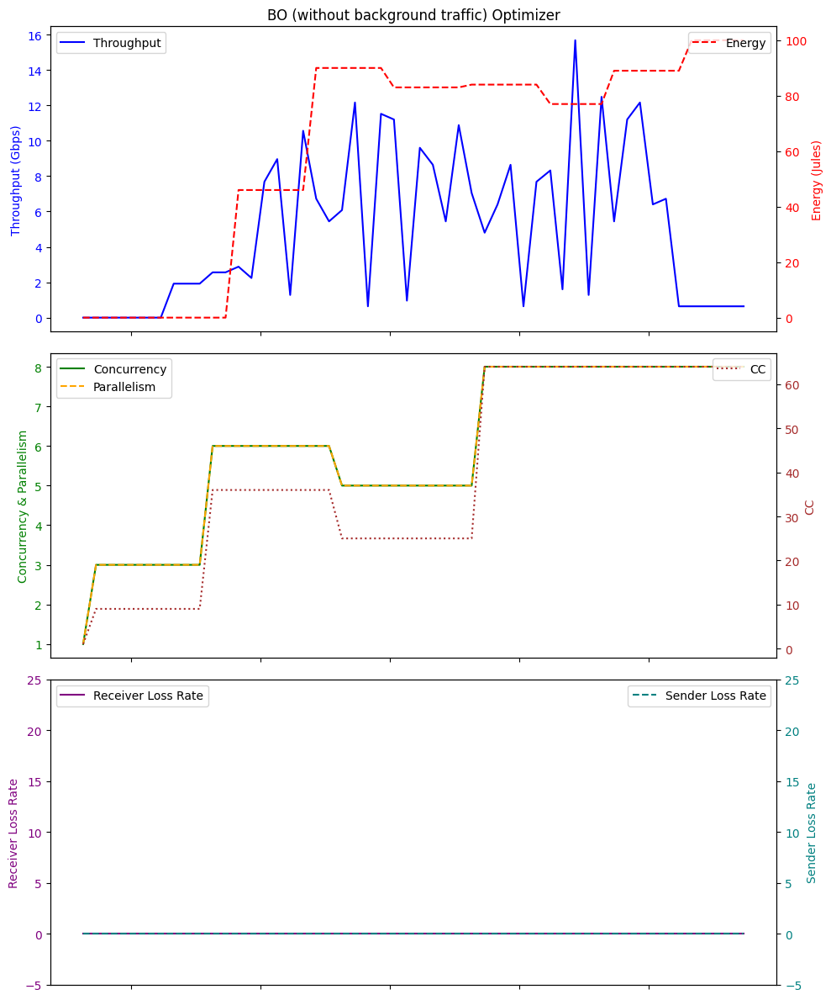

Average Throughput: 4.886153846153845
Total Energy: 3237.0
Total loss rate: 0.0019771202153169793
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:14:59.636564        0.00          0.0   1    0.0   0.0   
1  2024-01-26 02:15:00.634398        0.00          0.0   9    0.0   0.0   
2  2024-01-26 02:15:01.633582        0.00          0.0   9    0.0  32.6   
3  2024-01-26 02:15:02.634309        0.00          0.0   9    0.0  32.6   
4  2024-01-26 02:15:03.635250        0.00          0.0   9    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 02:15:56.686250        0.96          0.0  64    1.0  32.7   
58 2024-01-26 02:15:57.689642        0.96          0.0  64    1.0  32.7   
59 2024-01-26 02:15:58.689396        0.96          0.0  64    1.0  32.7   
60 2024-01-26 02:15:59.689222        0.96          0.0  64    1.0  32.7   
61 2024-01-26 02:16:00.689568        0.96          0.0  64    1.0  32.7   

 

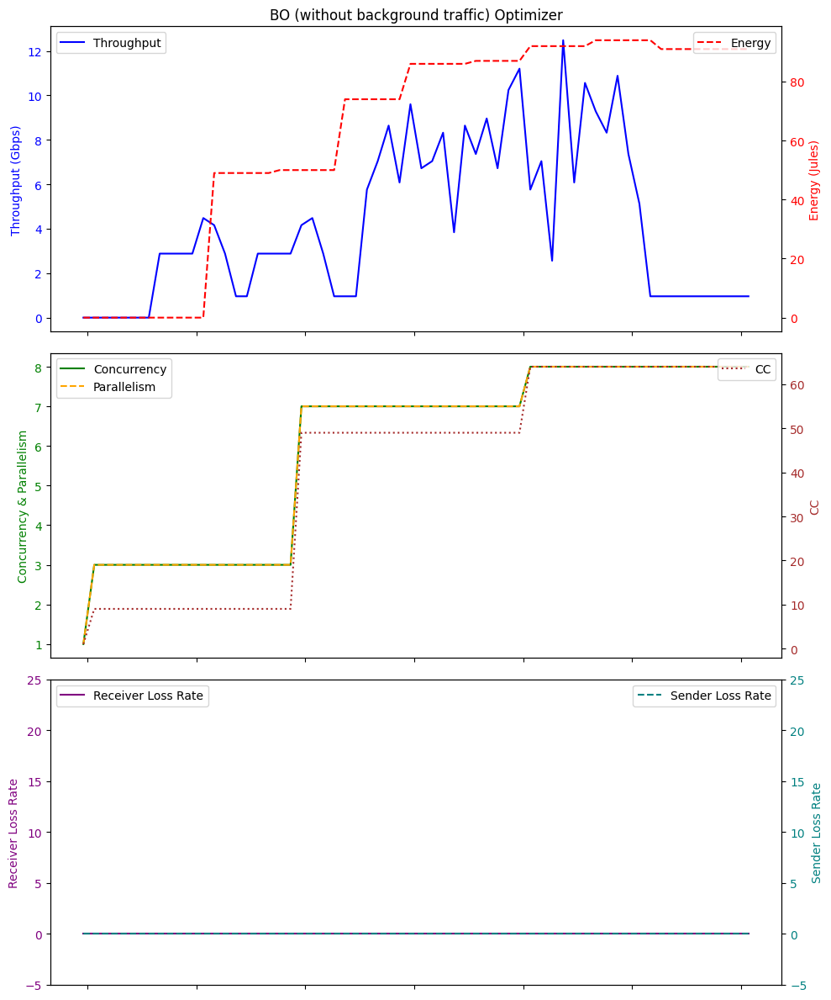

Average Throughput: 4.227096774193546
Total Energy: 3924.0
Total loss rate: 0.0017999011104693327


In [21]:
# Example usage BO
directory = './logFileDir_simu_wo_bg/BO/'
dfs = process_log_files(directory,"BO_logFile_")

bo_throughput_list=[]
bo_energy_list=[]
bo_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('BO (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    bo_throughput_list.append(average_throughput)
    bo_energy_list.append(total_energy)
    bo_plr_list.append(total_plr)


                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:59:01.840962        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:59:02.839064        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:59:03.838986        0.00          0.0   1    0.0  32.7   
3   2024-01-26 02:59:04.841587        0.00          0.0   1    0.0  32.7   
4   2024-01-26 02:59:05.841490        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 03:00:46.948838        0.96          0.0   4    1.0  32.6   
106 2024-01-26 03:00:47.948719        0.96          0.0   4    1.0  32.7   
107 2024-01-26 03:00:48.950408        0.96          0.0   4    1.0  32.7   
108 2024-01-26 03:00:49.951927        0.96          0.0   4    1.0  32.7   
109 2024-01-26 03:00:50.952250        0.96          0.0   4    1.0  32.6   

     Energy  sender_lr  concurrency  parallelism  
0       0.0        0.0            1 

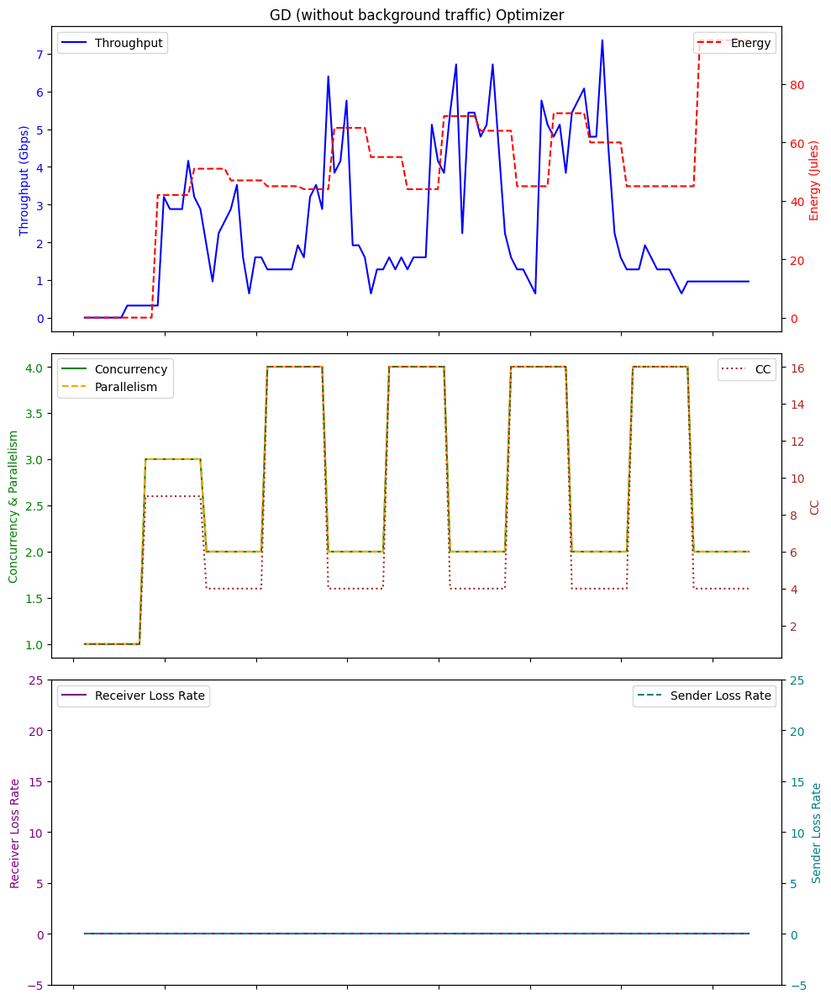

Average Throughput: 2.3679999999999994
Total Energy: 5557.0
Total loss rate: 0.0020634141372501617
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:21:13.734089        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:21:14.728492        0.00          0.0   1    0.0   0.0   
2  2024-01-26 03:21:15.730536        0.00          0.0   1    0.0  32.7   
3  2024-01-26 03:21:16.730536        0.00          0.0   1    0.0  32.6   
4  2024-01-26 03:21:17.731078        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:22:48.825001        1.28          0.0  25    1.0  32.6   
96 2024-01-26 03:22:49.827299        1.28          0.0  25    1.0  32.6   
97 2024-01-26 03:22:50.827312        1.28          0.0  25    1.0  32.7   
98 2024-01-26 03:22:51.827347        1.28          0.0  25    1.0  32.7   
99 2024-01-26 03:22:52.829885        1.28          0.0  25    1.0  32.8   



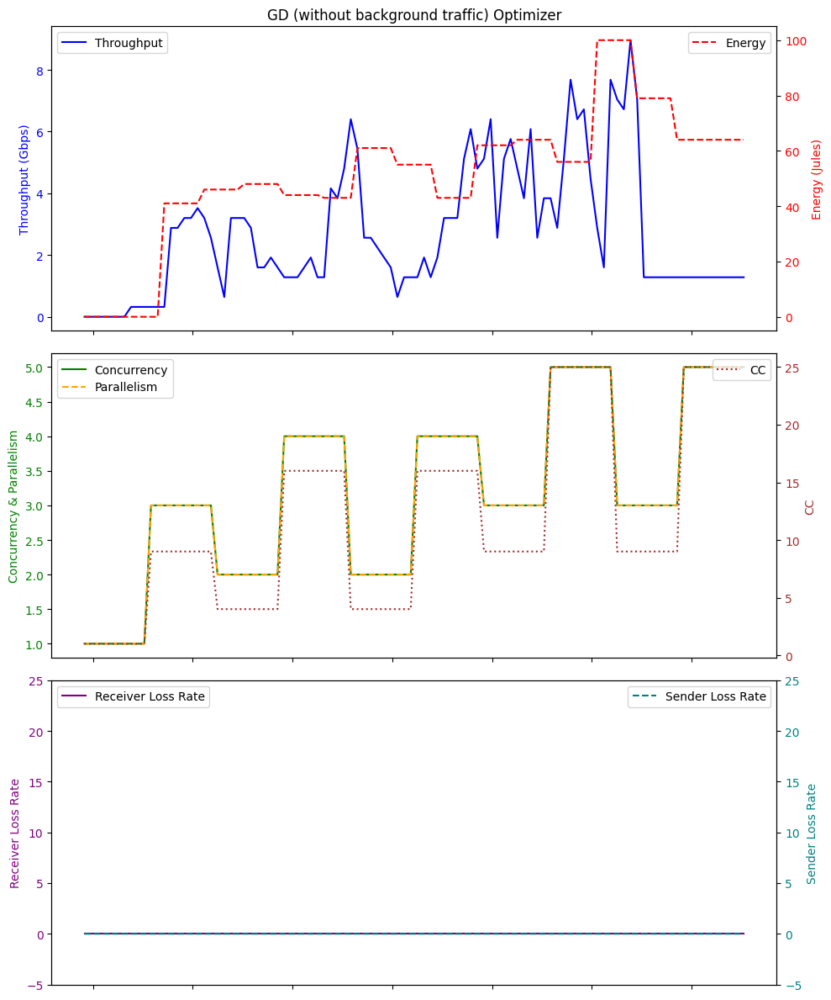

Average Throughput: 2.710399999999999
Total Energy: 5113.0
Total loss rate: 0.003336901037185989
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:12:57.385369        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:12:58.378195        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:12:59.381925        0.00          0.0   1    0.0  32.7   
3   2024-01-26 02:13:00.383375        0.00          0.0   1    0.0  32.7   
4   2024-01-26 02:13:01.379923        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 02:14:52.496643        0.32          0.0  16    0.0  32.6   
116 2024-01-26 02:14:53.497660        0.32          0.0  16    0.0  32.6   
117 2024-01-26 02:14:54.500473        0.32          0.0  16    0.0  32.7   
118 2024-01-26 02:14:55.498038        0.32          0.0  16    0.0  32.6   
119 2024-01-26 02:14:56.500859        0.32          0.0  16    0.0 

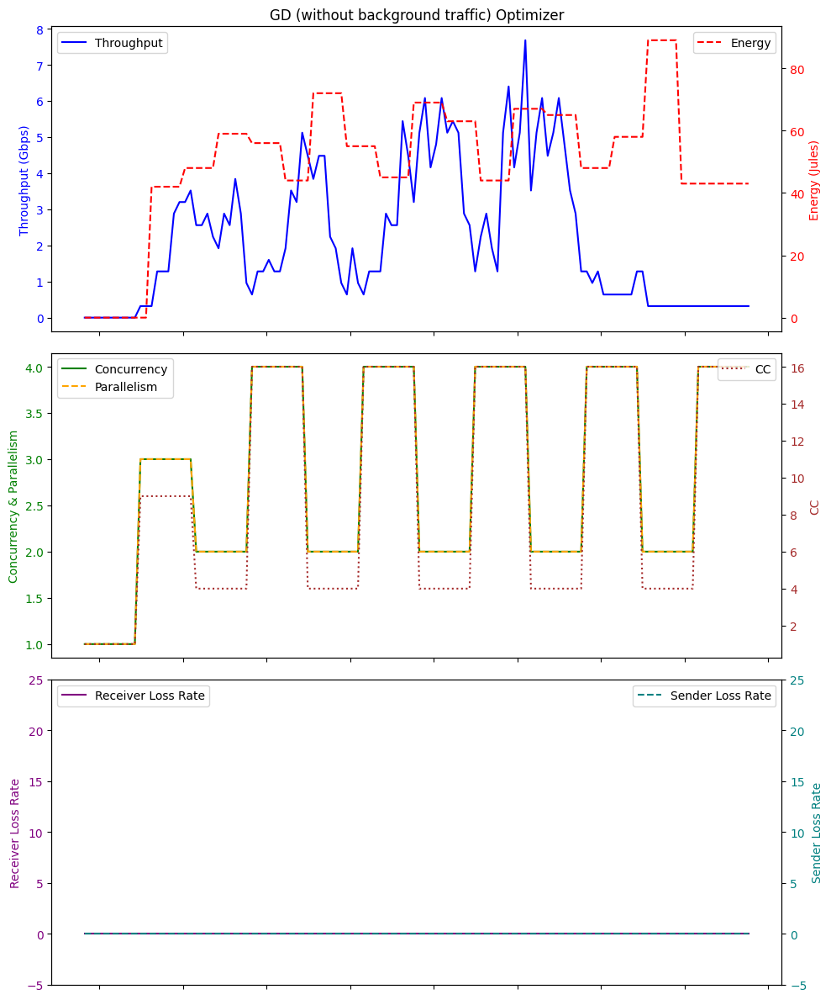

Average Throughput: 2.1653333333333338
Total Energy: 6059.0
Total loss rate: 0.003479809916065284
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:34:54.443282        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:34:55.438159        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:34:56.441266        0.00          0.0   1    0.0  32.7   
3   2024-01-26 01:34:57.443068        0.00          0.0   1    0.0  32.6   
4   2024-01-26 01:34:58.444906        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 01:36:49.558644        0.32          0.0  16    0.0  32.8   
116 2024-01-26 01:36:50.558211        0.32          0.0  16    0.0  32.7   
117 2024-01-26 01:36:51.559718        0.32          0.0  16    0.0  32.7   
118 2024-01-26 01:36:52.561553        0.32          0.0  16    0.0  32.6   
119 2024-01-26 01:36:53.561217        0.32          0.0  16    0.0

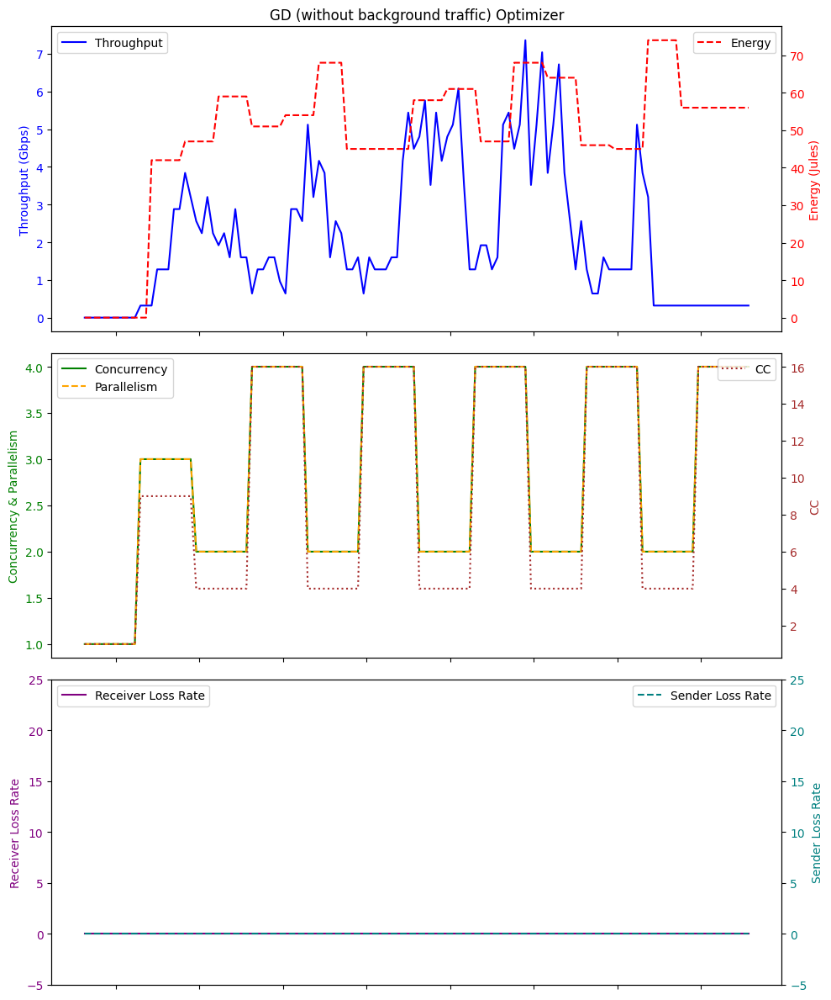

Average Throughput: 2.1360000000000006
Total Energy: 5904.0
Total loss rate: 0.003135322641555219
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:34:48.541417        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:34:49.536283        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:34:50.537979        0.00          0.0   1    0.0  32.6   
3   2024-01-26 02:34:51.539672        0.00          0.0   1    0.0  32.6   
4   2024-01-26 02:34:52.539970        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 02:43:04.067717        0.32          0.0  16    0.0  32.7   
496 2024-01-26 02:43:05.070203        0.32          0.0  16    0.0  32.7   
497 2024-01-26 02:43:06.070738        0.32          0.0  16    0.0  32.6   
498 2024-01-26 02:43:07.071043        0.32          0.0  16    0.0  32.7   
499 2024-01-26 02:43:08.070904        0.32          0.0  16    0.0

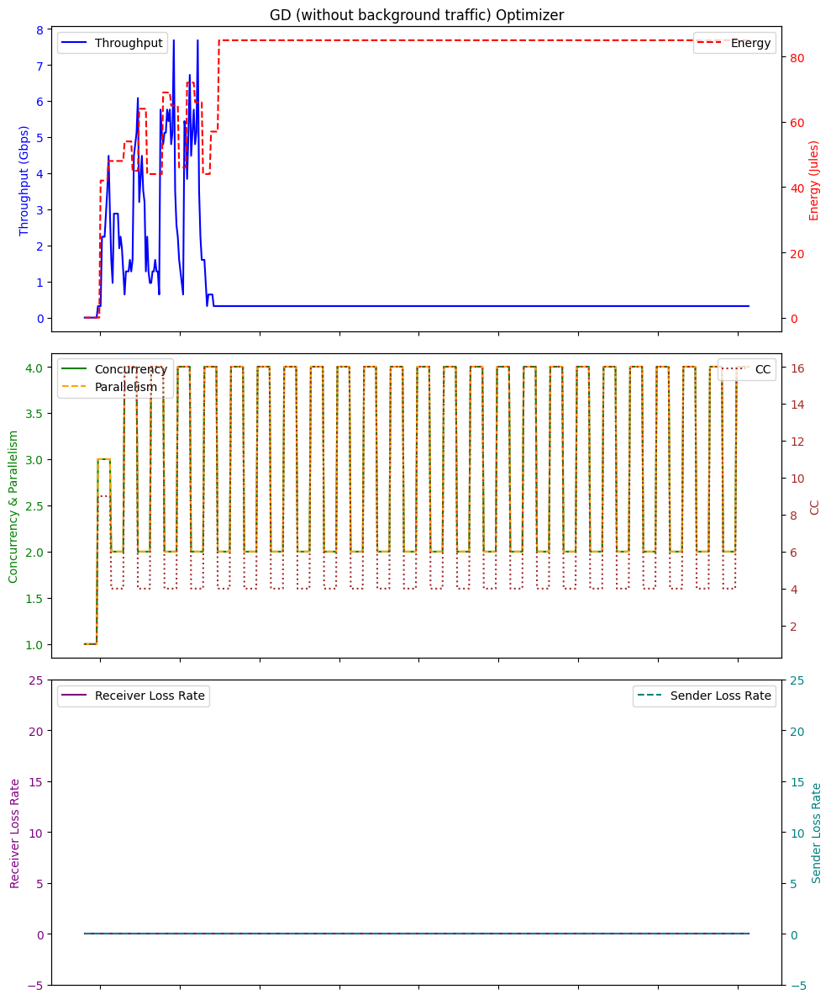

Average Throughput: 0.76096
Total Energy: 38718.0
Total loss rate: 0.011025542681934931
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 04:49:54.977120        0.00          0.0   1    0.0   0.0   
1   2024-01-26 04:49:55.972634        0.00          0.0   1    0.0   0.0   
2   2024-01-26 04:49:56.972608        0.00          0.0   1    0.0  32.7   
3   2024-01-26 04:49:57.973826        0.00          0.0   1    0.0  32.7   
4   2024-01-26 04:49:58.975318        0.00          0.0   1    0.0  32.8   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 04:51:50.090123        0.64          0.0  16    1.0  32.8   
116 2024-01-26 04:51:51.093454        0.64          0.0  16    1.0  32.8   
117 2024-01-26 04:51:52.093432        0.64          0.0  16    1.0  32.7   
118 2024-01-26 04:51:53.093202        0.64          0.0  16    1.0  32.8   
119 2024-01-26 04:51:54.094920        0.64          0.0  16    1.0  32.7   


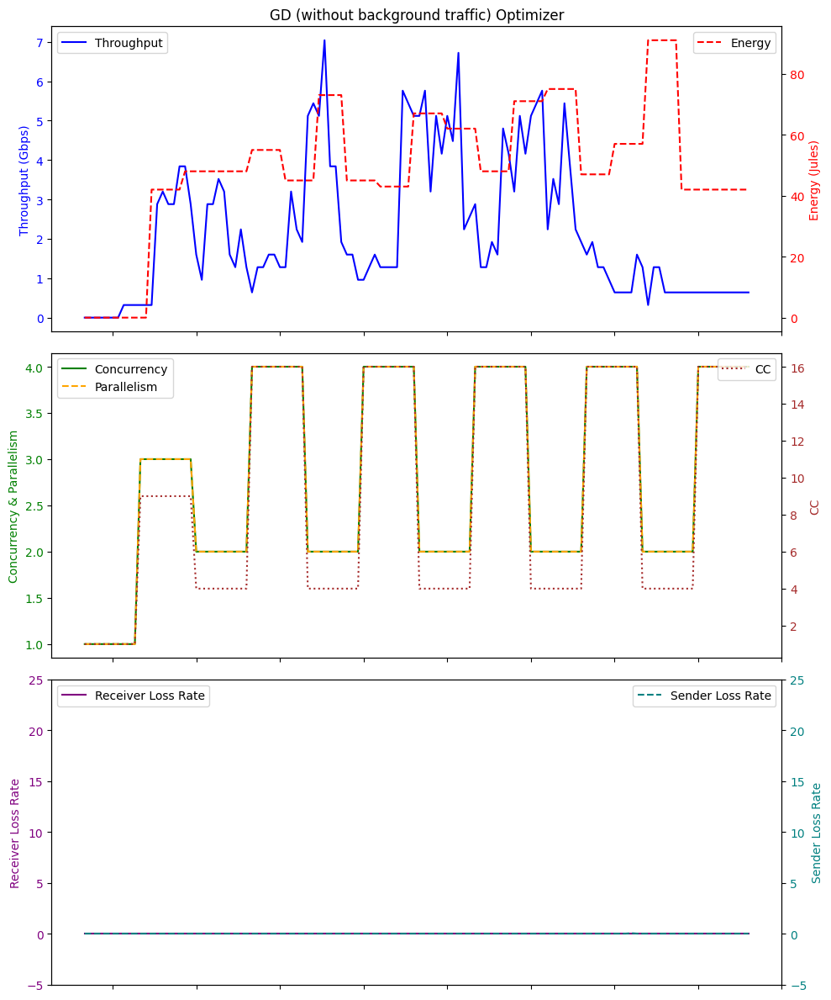

Average Throughput: 2.1893333333333334
Total Energy: 5975.0
Total loss rate: 0.03734144093789617
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:02:30.437435        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:02:31.433435        0.00          0.0   1    0.0   0.0   
2  2024-01-26 04:02:32.432657        0.00          0.0   1    0.0  32.6   
3  2024-01-26 04:02:33.433264        0.00          0.0   1    0.0  32.7   
4  2024-01-26 04:02:34.435456        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 04:04:05.531661        2.56          0.0  25    2.0  32.8   
96 2024-01-26 04:04:06.530574        2.56          0.0  25    2.0  32.6   
97 2024-01-26 04:04:07.533163        2.56          0.0  25    2.0  32.7   
98 2024-01-26 04:04:08.533267        2.56          0.0  25    2.0  32.6   
99 2024-01-26 04:04:09.533189        2.56          0.0  25    2.0  32.7   

  

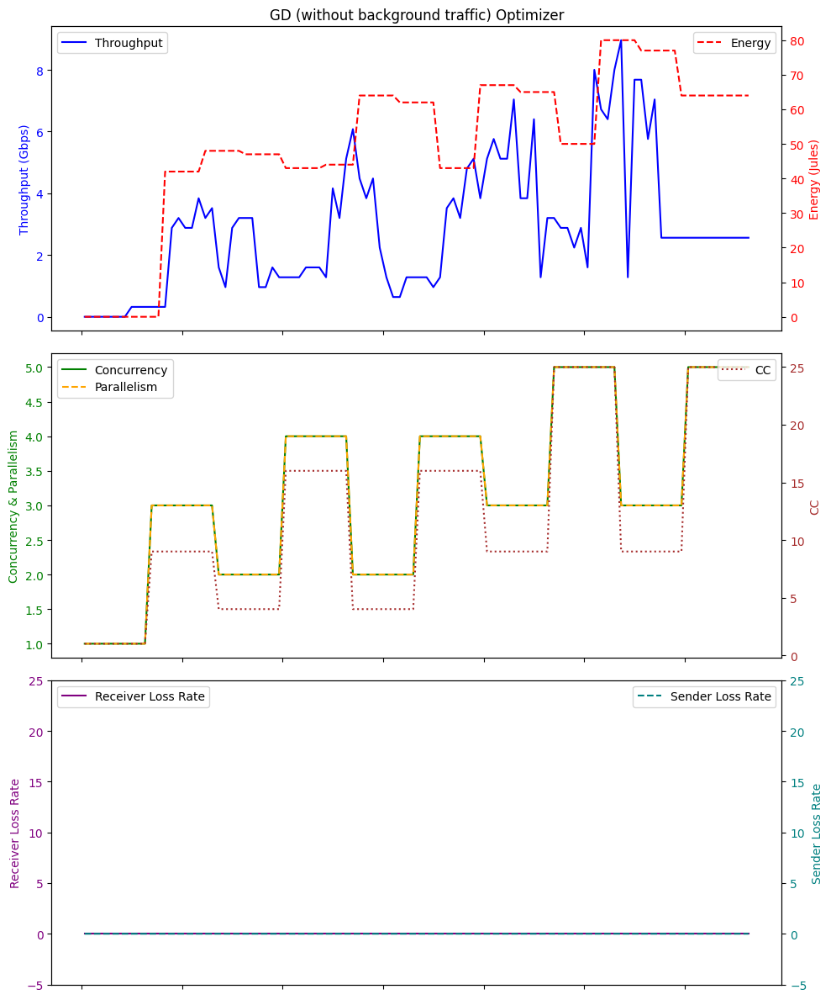

Average Throughput: 2.8768000000000007
Total Energy: 5052.0
Total loss rate: 0.010476518003952008
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:21:38.509017        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:21:39.505004        0.00          0.0   1    0.0   0.0   
2  2024-01-26 04:21:40.504231        0.00          0.0   1    0.0  32.7   
3  2024-01-26 04:21:41.505175        0.00          0.0   1    0.0  32.6   
4  2024-01-26 04:21:42.506370        0.00          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 04:23:13.601705        2.56          0.0  25    2.0  32.7   
96 2024-01-26 04:23:14.604826        2.56          0.0  25    2.0  32.7   
97 2024-01-26 04:23:15.604473        2.56          0.0  25    2.0  32.7   
98 2024-01-26 04:23:16.604289        2.56          0.0  25    2.0  32.7   
99 2024-01-26 04:23:17.606577        2.56          0.0  25    2.0  32.7   

 

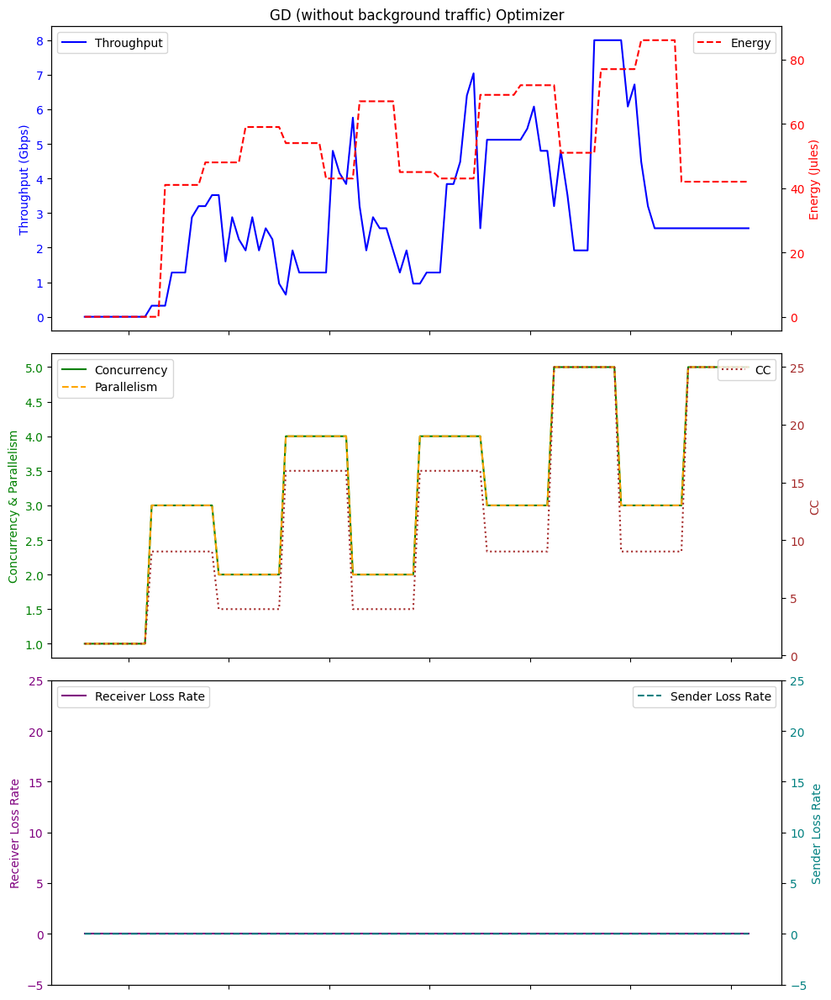

Average Throughput: 2.88
Total Energy: 4949.0
Total loss rate: 0.0005365456842688267
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 03:52:24.414479        0.00          0.0   1    0.0   0.0   
1   2024-01-26 03:52:25.409539        0.00          0.0   1    0.0   0.0   
2   2024-01-26 03:52:26.410405        0.00          0.0   1    0.0  32.6   
3   2024-01-26 03:52:27.409041        0.00          0.0   1    0.0  32.6   
4   2024-01-26 03:52:28.411880        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 03:54:19.528046        0.32          0.0  16    0.0  32.7   
116 2024-01-26 03:54:20.528192        0.32          0.0  16    0.0  32.8   
117 2024-01-26 03:54:21.529664        0.32          0.0  16    0.0  32.7   
118 2024-01-26 03:54:22.531546        0.32          0.0  16    0.0  32.7   
119 2024-01-26 03:54:23.531754        0.32          0.0  16    0.0  32.7   

  

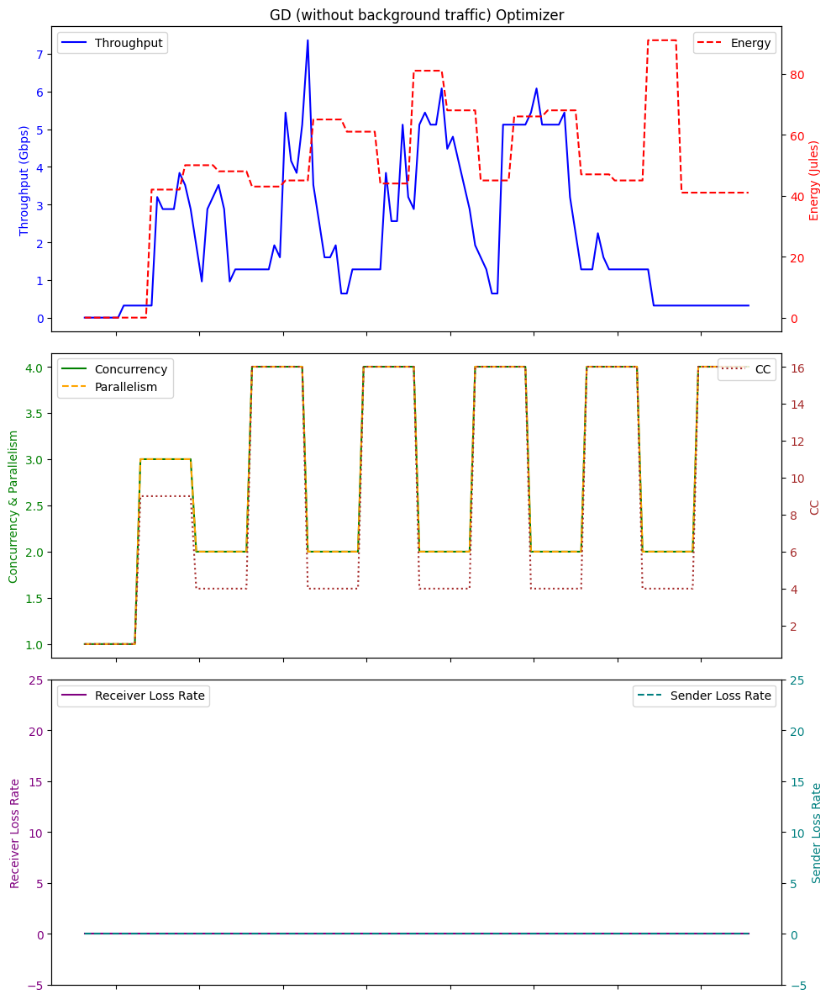

Average Throughput: 2.2
Total Energy: 5942.0
Total loss rate: 0.0008316492374000893
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:34:13.693869        0.00          0.0   1    0.0   0.0   
1  2024-01-26 04:34:14.687564        0.00          0.0   1    0.0   0.0   
2  2024-01-26 04:34:15.688767        0.00          0.0   1    0.0  32.7   
3  2024-01-26 04:34:16.688449        0.00          0.0   1    0.0  32.7   
4  2024-01-26 04:34:17.689886        0.00          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 04:35:48.784575        0.96          0.0  25    1.0  32.8   
96 2024-01-26 04:35:49.787835        0.96          0.0  25    1.0  32.7   
97 2024-01-26 04:35:50.788157        0.96          0.0  25    1.0  32.7   
98 2024-01-26 04:35:51.788521        0.96          0.0  25    1.0  32.8   
99 2024-01-26 04:35:52.790538        0.96          0.0  25    1.0  32.6   

    Energy  sen

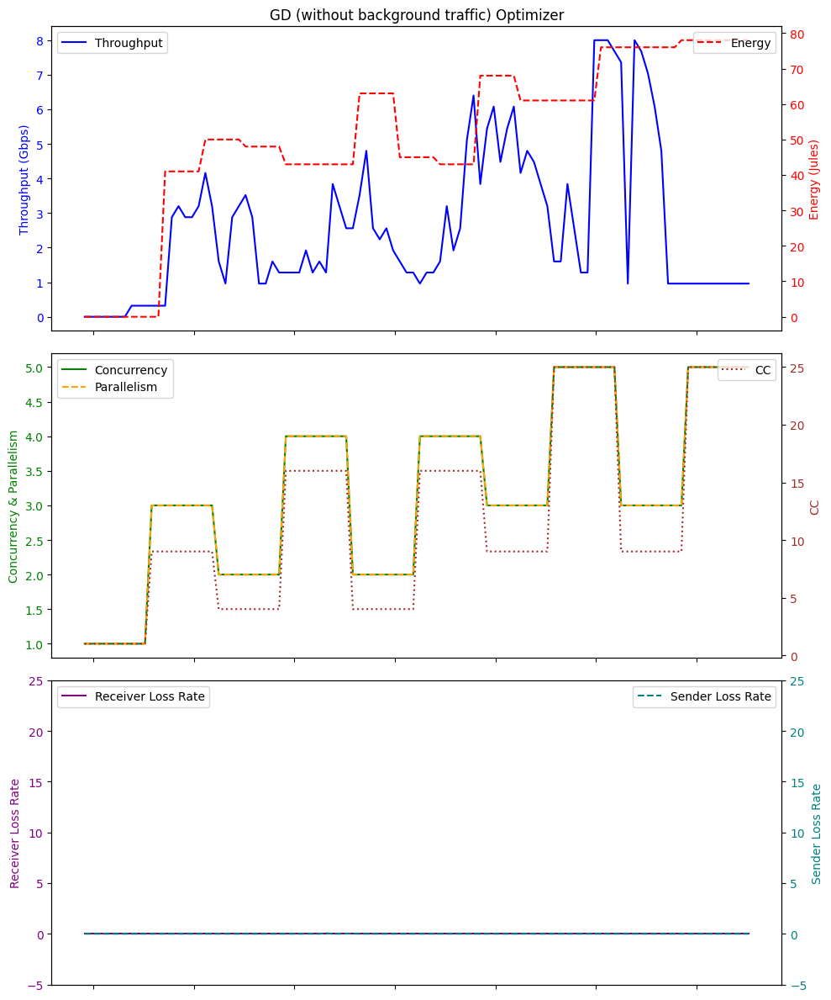

Average Throughput: 2.623999999999999
Total Energy: 5123.0
Total loss rate: 0.09013199127078163
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:36:13.199627        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:36:14.194169        0.00          0.0   1    0.0   0.0   
2  2024-01-26 03:36:15.194451        0.00          0.0   1    0.0  32.6   
3  2024-01-26 03:36:16.198009        0.00          0.0   1    0.0  32.7   
4  2024-01-26 03:36:17.197875        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:37:48.295091        1.92          0.0  25    2.0  32.7   
96 2024-01-26 03:37:49.297983        1.92          0.0  25    2.0  32.8   
97 2024-01-26 03:37:50.297762        1.92          0.0  25    2.0  32.7   
98 2024-01-26 03:37:51.297665        1.92          0.0  25    2.0  32.6   
99 2024-01-26 03:37:52.297893        1.92          0.0  25    2.0  32.6   

   

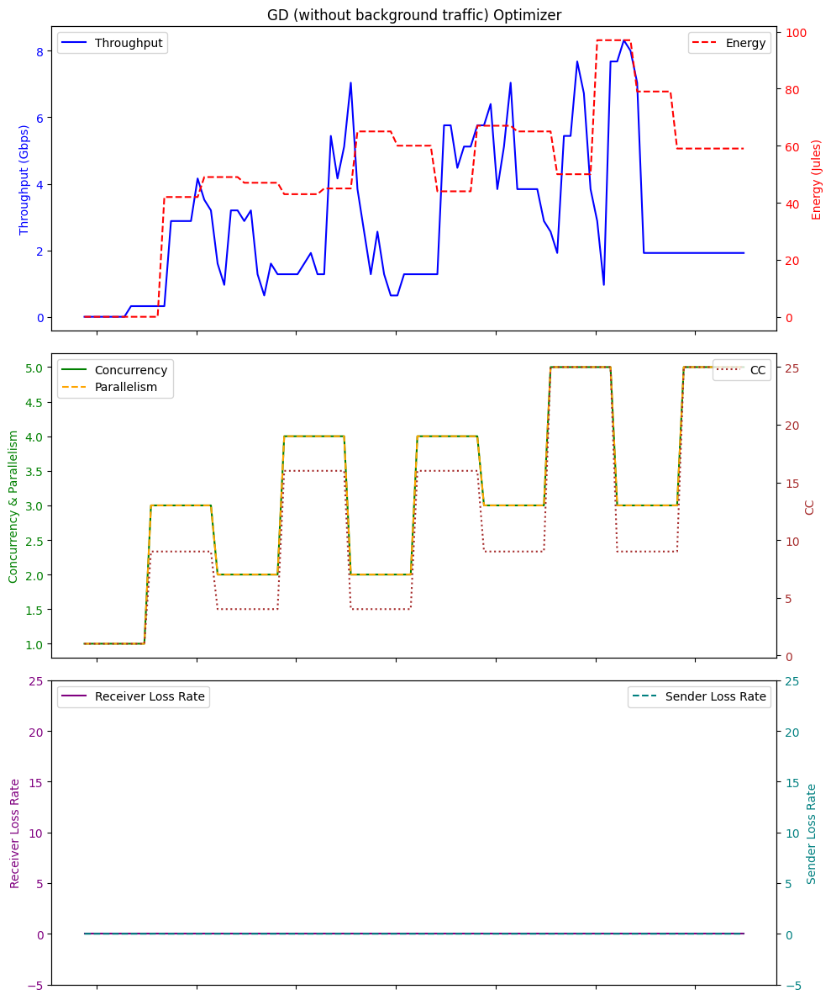

Average Throughput: 2.8160000000000007
Total Energy: 5122.0
Total loss rate: 0.010986844082051857
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:23:09.876290        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:23:10.874740        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:23:11.874726        0.00          0.0   1    0.0  32.6   
3   2024-01-26 01:23:12.876605        0.00          0.0   1    0.0  32.6   
4   2024-01-26 01:23:13.877645        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 01:31:25.399308        5.44          0.0  25    5.0  32.9   
496 2024-01-26 01:31:26.399088        5.44          0.0  25    5.0  32.6   
497 2024-01-26 01:31:27.402550        5.44          0.0  25    5.0  32.7   
498 2024-01-26 01:31:28.404174        5.44          0.0  25    5.0  32.7   
499 2024-01-26 01:31:29.402313        5.44          0.0  25    5.0

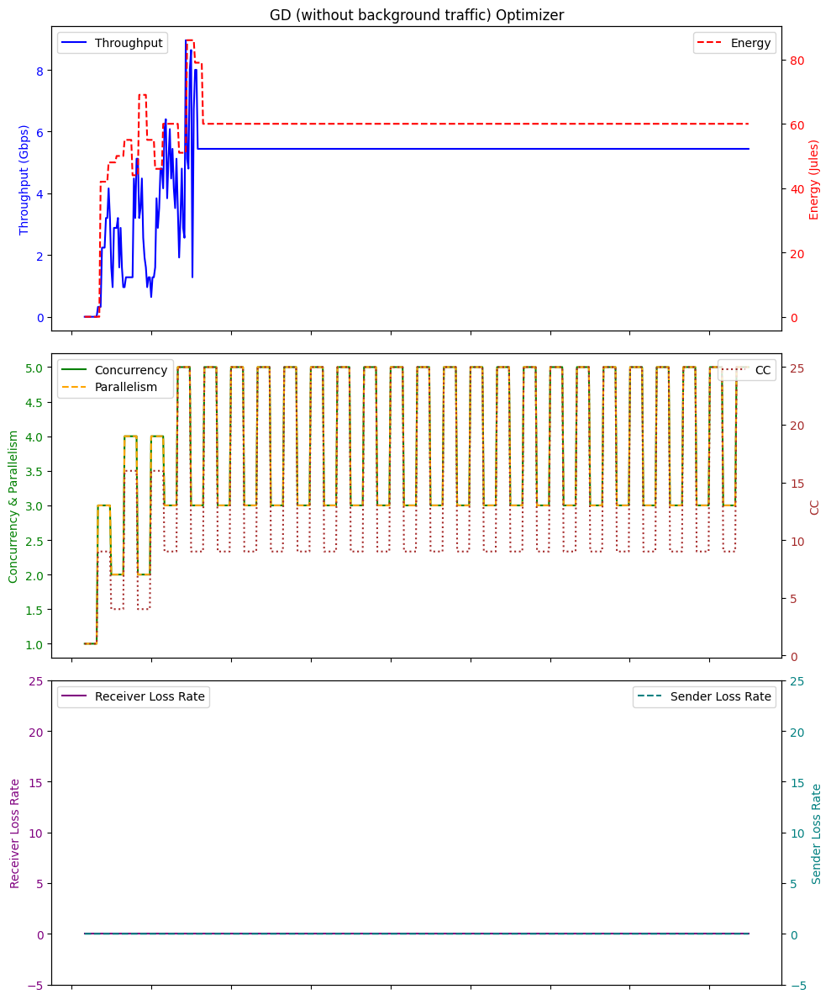

Average Throughput: 5.010559999999999
Total Energy: 29086.0
Total loss rate: 0.002590496443234834
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:46:59.425464        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:47:00.418742        0.00          0.0   1    0.0   0.0   
2  2024-01-26 03:47:01.418406        0.00          0.0   1    0.0  32.6   
3  2024-01-26 03:47:02.422196        0.00          0.0   1    0.0  32.6   
4  2024-01-26 03:47:03.421714        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:48:34.516876        0.32          0.0  36    0.0  32.8   
96 2024-01-26 03:48:35.516490        0.32          0.0  36    0.0  32.7   
97 2024-01-26 03:48:36.519109        0.32          0.0  36    0.0  32.6   
98 2024-01-26 03:48:37.519644        0.32          0.0  36    0.0  32.7   
99 2024-01-26 03:48:38.519908        0.32          0.0  36    0.0  32.6   

 

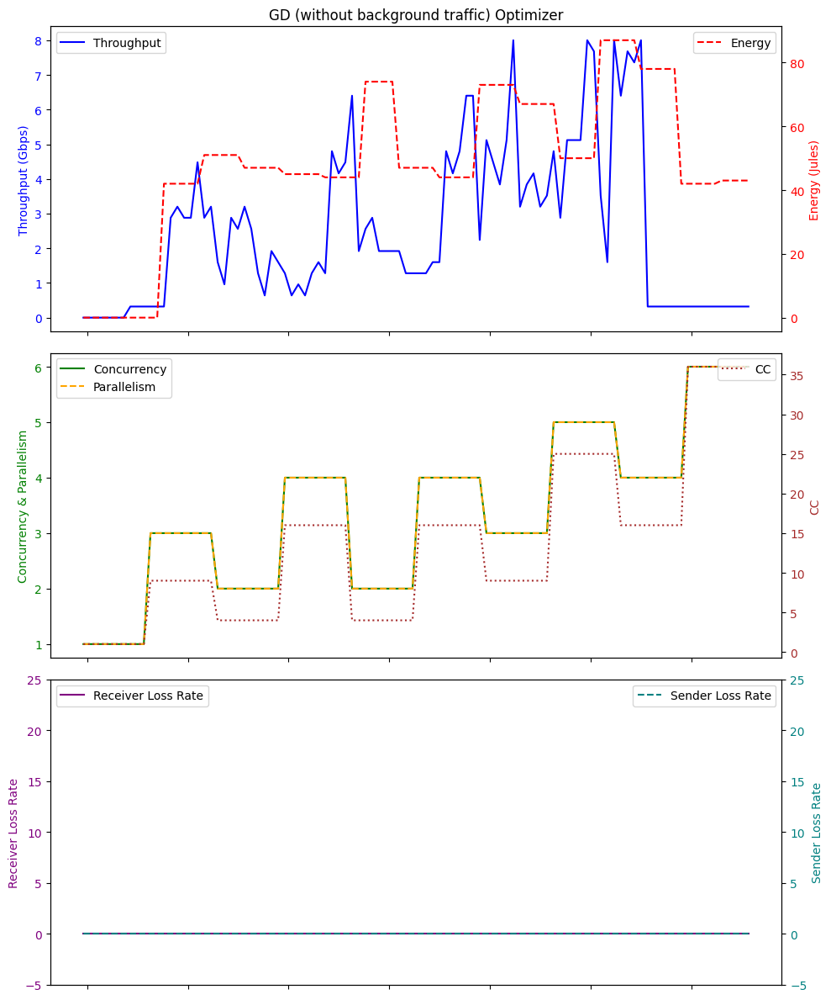

Average Throughput: 2.5408
Total Energy: 4887.0
Total loss rate: 0.001961734050571092
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 04:39:14.224439        0.00          0.0   1    0.0   0.0   
1   2024-01-26 04:39:15.219222        0.00          0.0   1    0.0   0.0   
2   2024-01-26 04:39:16.218099        0.00          0.0   1    0.0  32.7   
3   2024-01-26 04:39:17.219292        0.00          0.0   1    0.0  32.6   
4   2024-01-26 04:39:18.218963        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 04:41:09.337077        1.92          0.0  16    2.0  32.8   
116 2024-01-26 04:41:10.337041        1.92          0.0  16    2.0  32.7   
117 2024-01-26 04:41:11.337496        1.92          0.0  16    2.0  32.7   
118 2024-01-26 04:41:12.339444        1.92          0.0  16    2.0  32.7   
119 2024-01-26 04:41:13.339117        1.92          0.0  16    2.0  32.6   

 

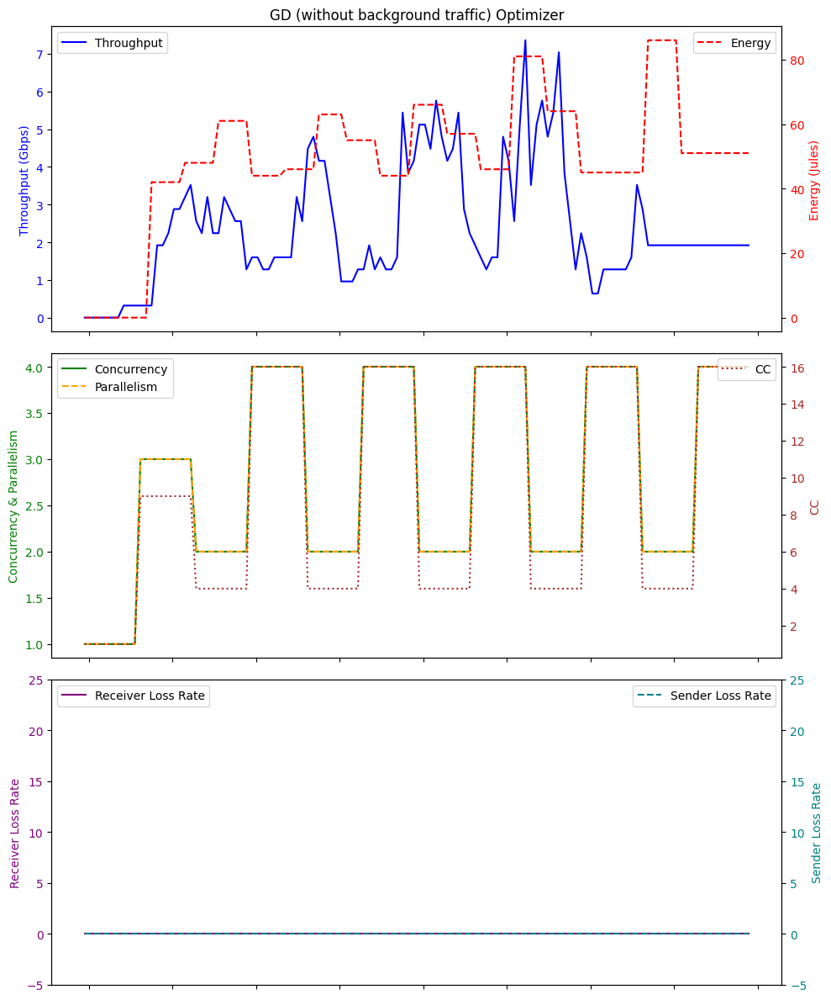

Average Throughput: 2.3840000000000003
Total Energy: 5958.0
Total loss rate: 0.001096318336386631
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:23:12.812311        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:23:13.806064        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:23:14.809537        0.00          0.0   1    0.0  32.6   
3   2024-01-26 02:23:15.808570        0.00          0.0   1    0.0  32.6   
4   2024-01-26 02:23:16.808729        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 02:31:28.336629        0.32          0.0  16    0.0  32.7   
496 2024-01-26 02:31:29.339952        0.32          0.0  16    0.0  32.7   
497 2024-01-26 02:31:30.341363        0.32          0.0  16    0.0  32.7   
498 2024-01-26 02:31:31.339976        0.32          0.0  16    0.0  32.7   
499 2024-01-26 02:31:32.341816        0.32          0.0  16    0.0

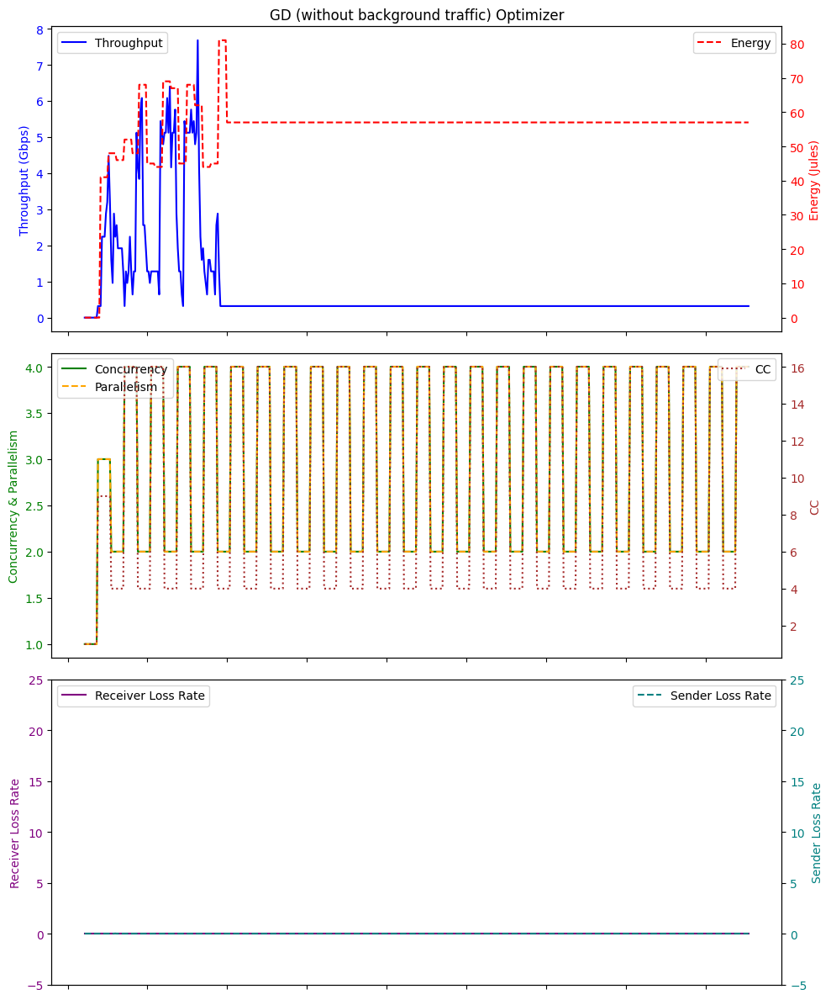

Average Throughput: 0.76224
Total Energy: 27591.0
Total loss rate: 0.04850504906903368
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:03:51.985919         0.0          0.0   1    0.0   0.0   
1  2024-01-26 03:03:52.981879         0.0          0.0   1    0.0   0.0   
2  2024-01-26 03:03:53.982427         0.0          0.0   1    0.0  32.7   
3  2024-01-26 03:03:54.984911         0.0          0.0   1    0.0  32.7   
4  2024-01-26 03:03:55.985125         0.0          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:05:27.081155         1.6          0.0  36    1.0  32.6   
96 2024-01-26 03:05:28.082062         1.6          0.0  36    1.0  32.8   
97 2024-01-26 03:05:29.081927         1.6          0.0  36    1.0  32.8   
98 2024-01-26 03:05:30.085027         1.6          0.0  36    1.0  32.7   
99 2024-01-26 03:05:31.084411         1.6          0.0  36    1.0  32.8   

    Energy  

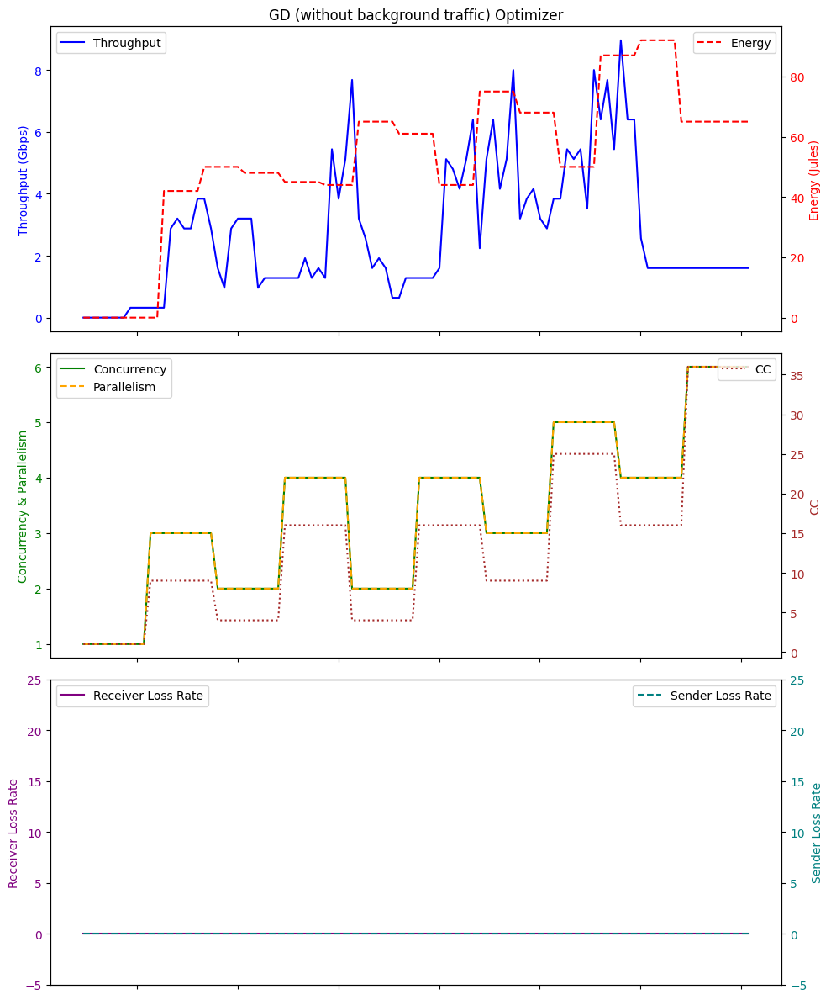

Average Throughput: 2.748800000000001
Total Energy: 5297.0
Total loss rate: 0.003000172784820068
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 04:44:21.489647        0.00          0.0   1    0.0   0.0   
1   2024-01-26 04:44:22.484865        0.00          0.0   1    0.0   0.0   
2   2024-01-26 04:44:23.485469        0.00          0.0   1    0.0  32.7   
3   2024-01-26 04:44:24.488962        0.00          0.0   1    0.0  32.8   
4   2024-01-26 04:44:25.489264        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 04:46:16.602608        1.28          0.0  16    1.0  32.6   
116 2024-01-26 04:46:17.603361        1.28          0.0  16    1.0  32.6   
117 2024-01-26 04:46:18.605498        1.28          0.0  16    1.0  32.7   
118 2024-01-26 04:46:19.605359        1.28          0.0  16    1.0  32.9   
119 2024-01-26 04:46:20.606779        1.28          0.0  16    1.0 

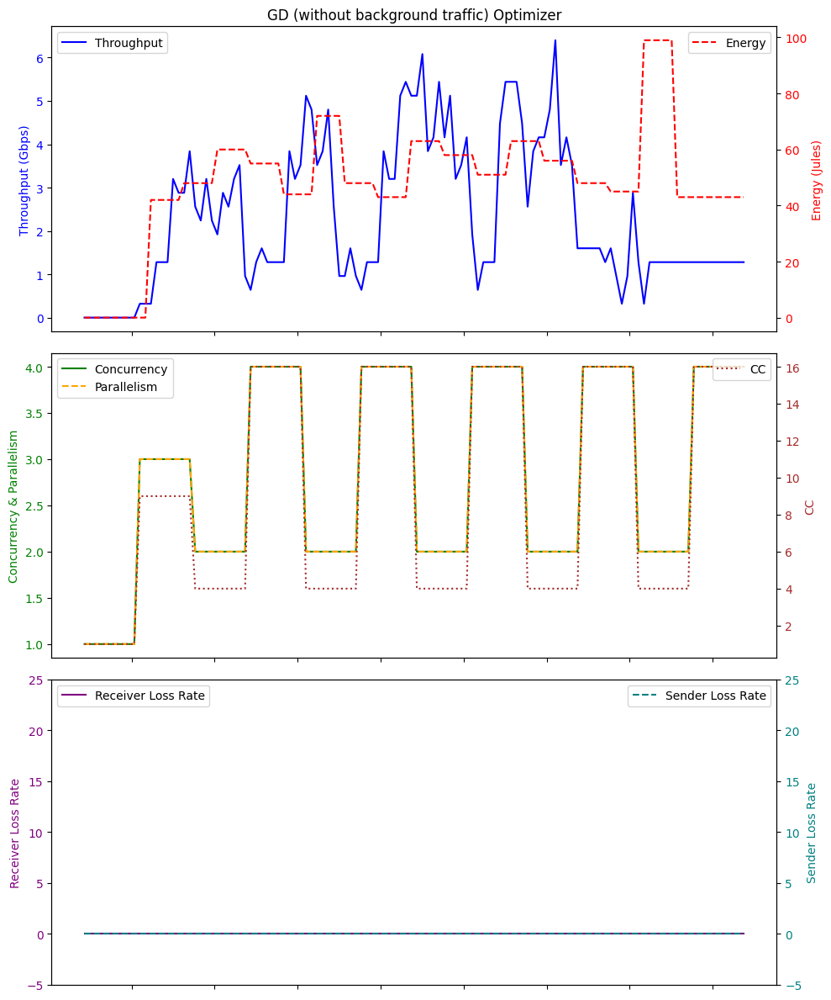

Average Throughput: 2.298666666666667
Total Energy: 5857.0
Total loss rate: 0.008346779594847071
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:44:49.523410        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:44:50.518565        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:44:51.522105        0.00          0.0   1    0.0  32.7   
3   2024-01-26 01:44:52.521960        0.00          0.0   1    0.0  32.7   
4   2024-01-26 01:44:53.523973        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 01:53:05.044225        1.28          0.0  16    1.0  32.6   
496 2024-01-26 01:53:06.045941        1.28          0.0  16    1.0  32.6   
497 2024-01-26 01:53:07.045703        1.28          0.0  16    1.0  32.7   
498 2024-01-26 01:53:08.049338        1.28          0.0  16    1.0  32.7   
499 2024-01-26 01:53:09.048203        1.28          0.0  16    1.0 

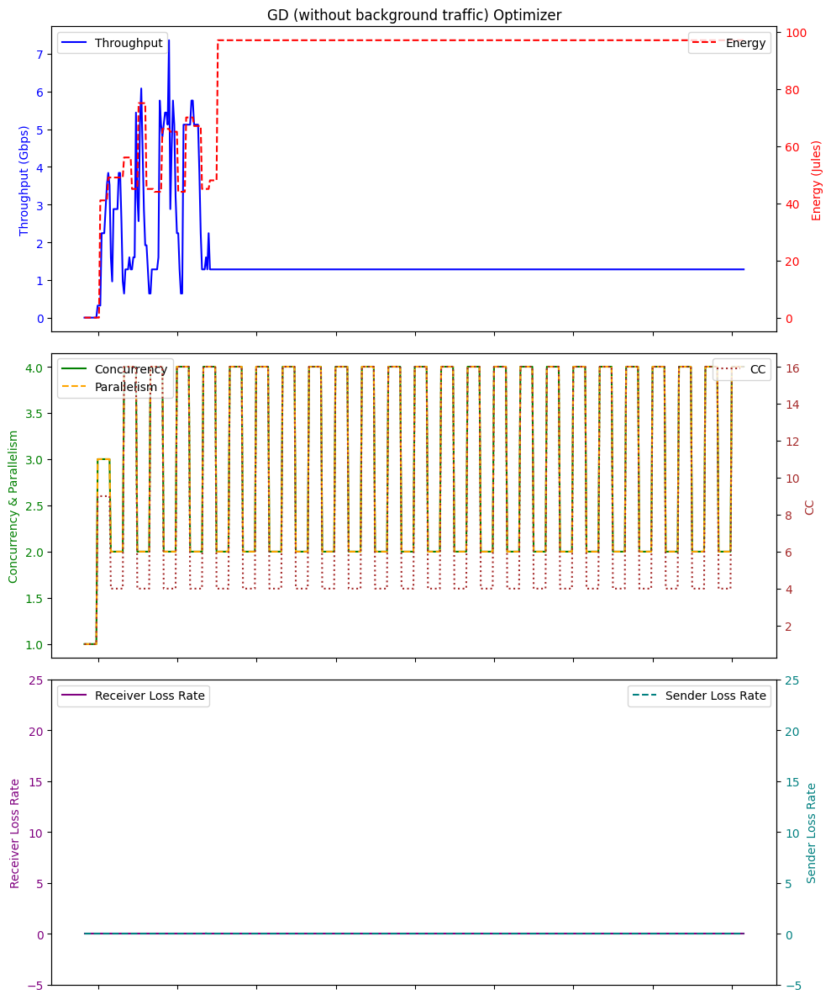

Average Throughput: 1.54304
Total Energy: 43512.0
Total loss rate: 0.026165414722597605
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:56:18.236506        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:56:19.231574        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:56:20.233278        0.00          0.0   1    0.0  32.7   
3   2024-01-26 01:56:21.234732        0.00          0.0   1    0.0  32.8   
4   2024-01-26 01:56:22.234766        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 01:58:13.352784        0.96          0.0  16    1.0  32.6   
116 2024-01-26 01:58:14.351730        0.96          0.0  16    1.0  32.6   
117 2024-01-26 01:58:15.353697        0.96          0.0  16    1.0  32.6   
118 2024-01-26 01:58:16.353456        0.96          0.0  16    1.0  32.7   
119 2024-01-26 01:58:17.355163        0.96          0.0  16    1.0  32.7   


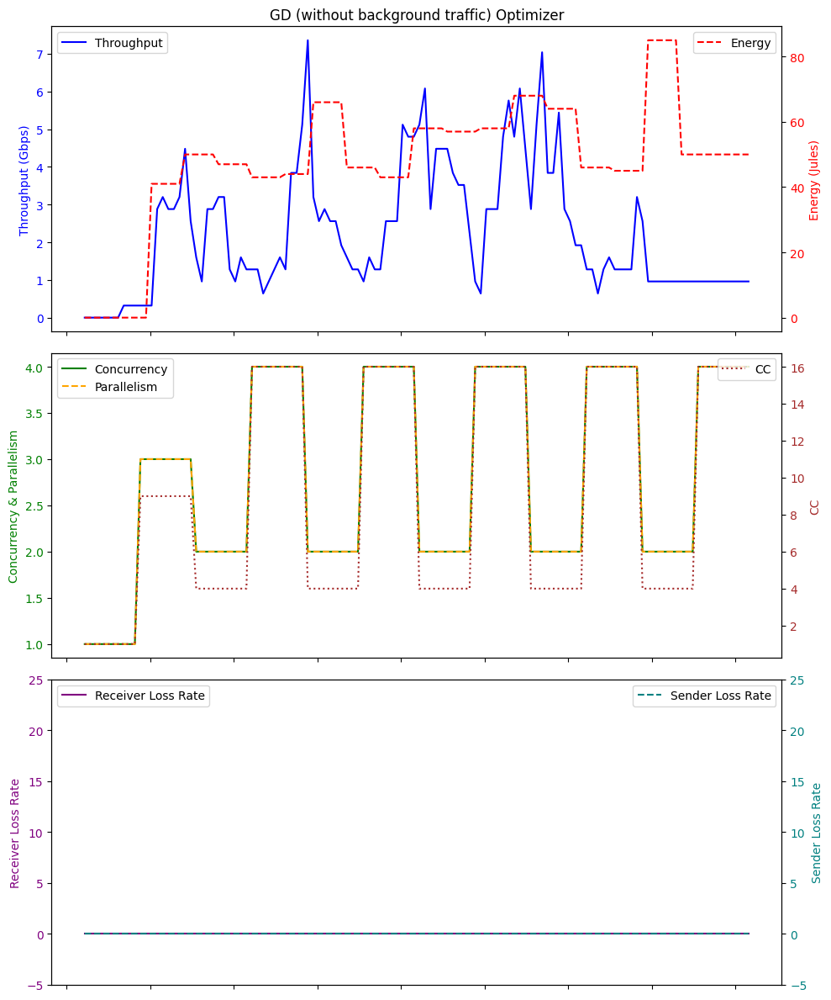

Average Throughput: 2.2426666666666666
Total Energy: 5772.0
Total loss rate: 0.002815974413722015
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:53:57.855871        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:53:58.850790        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:53:59.854183        0.00          0.0   1    0.0  32.6   
3   2024-01-26 02:54:00.853667        0.00          0.0   1    0.0  33.1   
4   2024-01-26 02:54:01.854578        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 02:55:42.960763        0.64          0.0   4    1.0  32.7   
106 2024-01-26 02:55:43.960924        0.64          0.0   4    1.0  32.8   
107 2024-01-26 02:55:44.964672        0.64          0.0   4    1.0  32.6   
108 2024-01-26 02:55:45.964230        0.64          0.0   4    1.0  32.8   
109 2024-01-26 02:55:46.964081        0.64          0.0   4    1.0

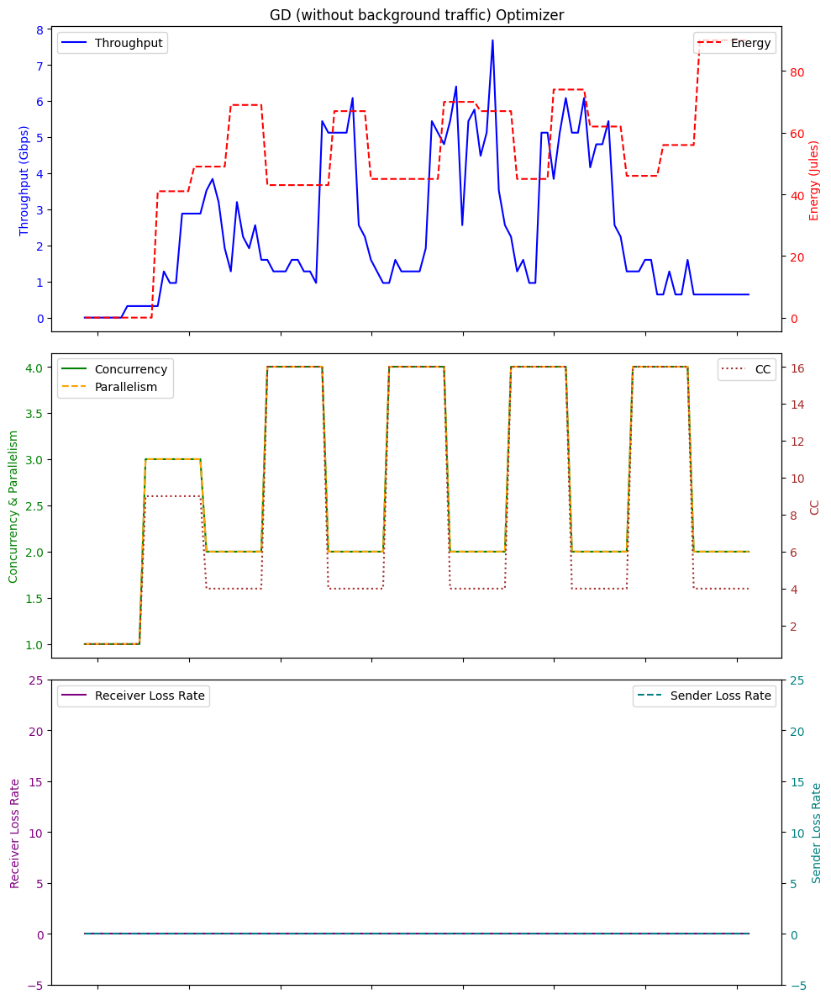

Average Throughput: 2.3650909090909087
Total Energy: 5699.0
Total loss rate: 0.008430657915135305
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:57:25.218958        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:57:26.213649        0.00          0.0   1    0.0   0.0   
2  2024-01-26 03:57:27.214102        0.00          0.0   1    0.0  32.6   
3  2024-01-26 03:57:28.216356        0.00          0.0   1    0.0  32.7   
4  2024-01-26 03:57:29.217386        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:59:00.309597        0.32          0.0  25    0.0  32.6   
96 2024-01-26 03:59:01.310364        0.32          0.0  25    0.0  32.7   
97 2024-01-26 03:59:02.312579        0.32          0.0  25    0.0  32.7   
98 2024-01-26 03:59:03.311596        0.32          0.0  25    0.0  32.7   
99 2024-01-26 03:59:04.314508        0.32          0.0  25    0.0  32.7   

 

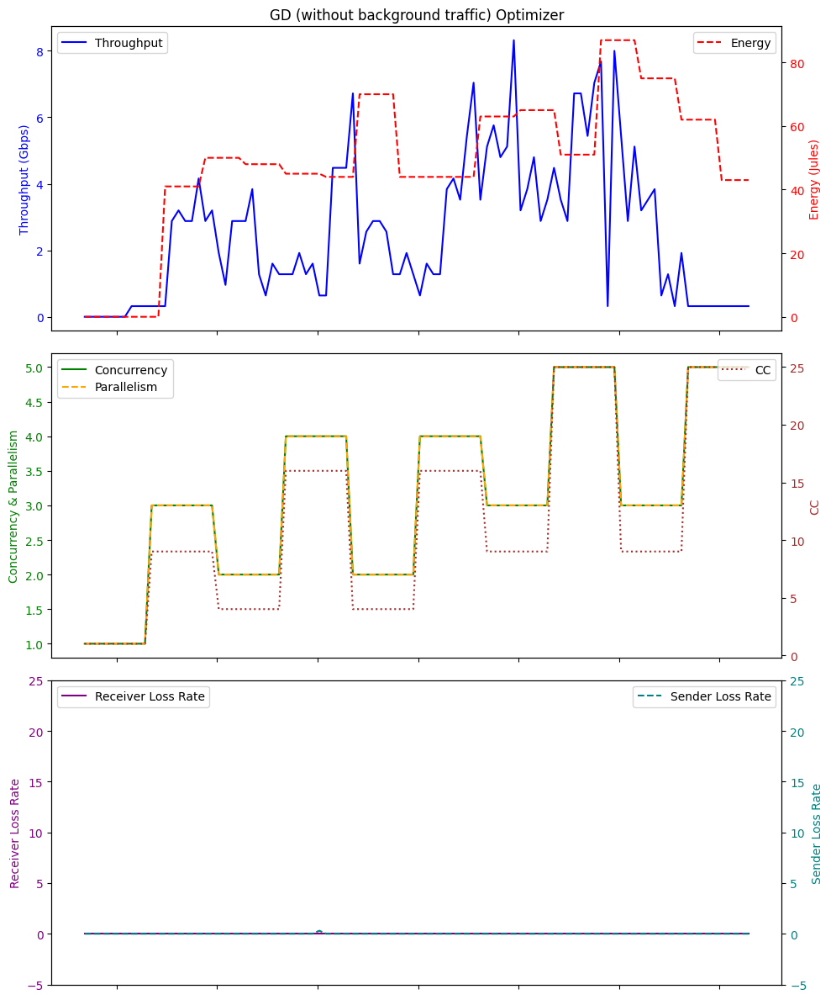

Average Throughput: 2.5504
Total Energy: 4905.0
Total loss rate: 0.3024170232471098
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:11:04.707214        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:11:05.703602        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:11:06.701746        0.00          0.0   1    0.0  32.7   
3   2024-01-26 01:11:07.704466        0.00          0.0   1    0.0  32.7   
4   2024-01-26 01:11:08.704586        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 01:19:20.228304        0.32          0.0  16    0.0  32.9   
496 2024-01-26 01:19:21.229234        0.32          0.0  16    0.0  32.7   
497 2024-01-26 01:19:22.232988        0.32          0.0  16    0.0  32.7   
498 2024-01-26 01:19:23.235676        0.32          0.0  16    0.0  32.7   
499 2024-01-26 01:19:24.233733        0.32          0.0  16    0.0  32.7   

   

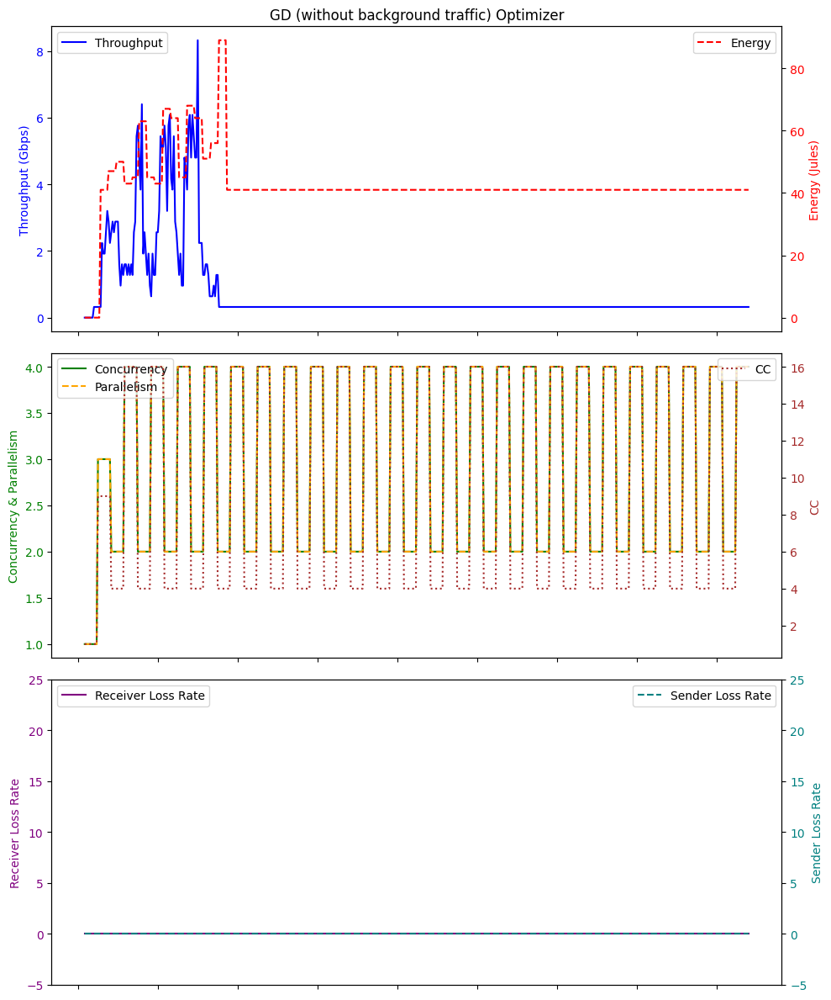

Average Throughput: 0.7622399999999999
Total Energy: 21354.0
Total loss rate: 0.007023274775503163
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:18:07.718963        0.00          0.0   1    0.0   0.0   
1   2024-01-26 02:18:08.716393        0.00          0.0   1    0.0   0.0   
2   2024-01-26 02:18:09.717611        0.00          0.0   1    0.0  32.6   
3   2024-01-26 02:18:10.717330        0.00          0.0   1    0.0  32.7   
4   2024-01-26 02:18:11.717743        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 02:20:02.833350        0.32          0.0  16    0.0  32.7   
116 2024-01-26 02:20:03.836200        0.32          0.0  16    0.0  32.7   
117 2024-01-26 02:20:04.836124        0.32          0.0  16    0.0  32.6   
118 2024-01-26 02:20:05.835402        0.32          0.0  16    0.0  32.6   
119 2024-01-26 02:20:06.837876        0.32          0.0  16    0.

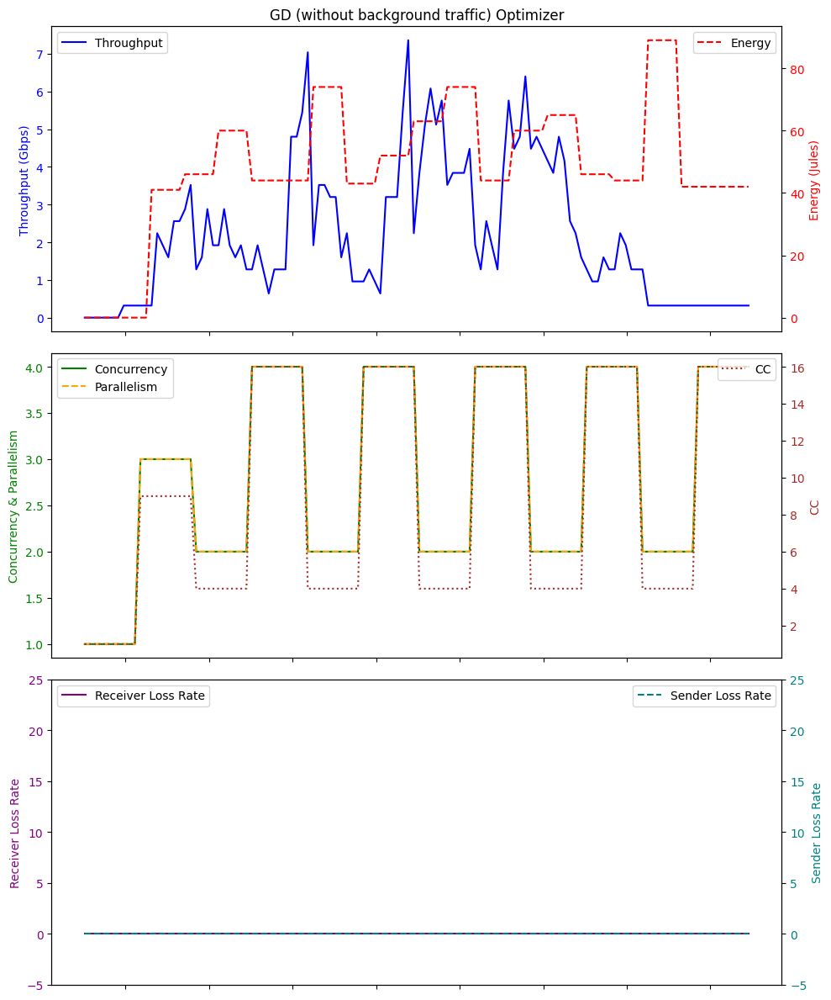

Average Throughput: 2.144
Total Energy: 5836.0
Total loss rate: 0.02213068696120678
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 03:31:18.235968        0.00          0.0   1    0.0   0.0   
1   2024-01-26 03:31:19.233456        0.00          0.0   1    0.0   0.0   
2   2024-01-26 03:31:20.233516        0.00          0.0   1    0.0  32.7   
3   2024-01-26 03:31:21.233101        0.00          0.0   1    0.0  32.8   
4   2024-01-26 03:31:22.233872        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 03:33:13.352352        0.32          0.0  16    0.0  32.6   
116 2024-01-26 03:33:14.354184        0.32          0.0  16    0.0  32.8   
117 2024-01-26 03:33:15.355813        0.32          0.0  16    0.0  32.7   
118 2024-01-26 03:33:16.355284        0.32          0.0  16    0.0  32.8   
119 2024-01-26 03:33:17.356503        0.32          0.0  16    0.0  32.8   

   

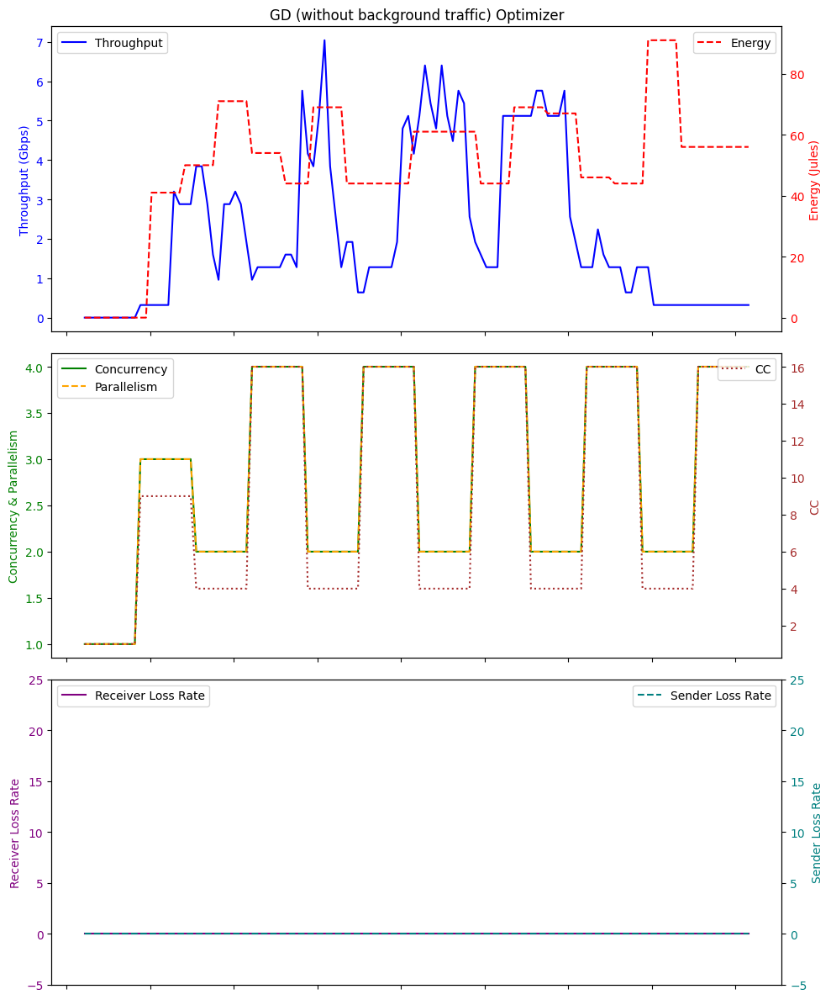

Average Throughput: 2.1893333333333334
Total Energy: 6084.0
Total loss rate: 0.0007636330967568054
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:26:28.312771        0.00          0.0   1    0.0   0.0   
1  2024-01-26 03:26:29.309996        0.00          0.0   1    0.0   0.0   
2  2024-01-26 03:26:30.312659        0.00          0.0   1    0.0  32.7   
3  2024-01-26 03:26:31.312438        0.00          0.0   1    0.0  32.6   
4  2024-01-26 03:26:32.313167        0.00          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 03:28:03.407275        2.24          0.0  25    2.0  32.8   
96 2024-01-26 03:28:04.409283        2.24          0.0  25    2.0  32.7   
97 2024-01-26 03:28:05.409656        2.24          0.0  25    2.0  32.7   
98 2024-01-26 03:28:06.409644        2.24          0.0  25    2.0  32.6   
99 2024-01-26 03:28:07.412849        2.24          0.0  25    2.0  32.7   



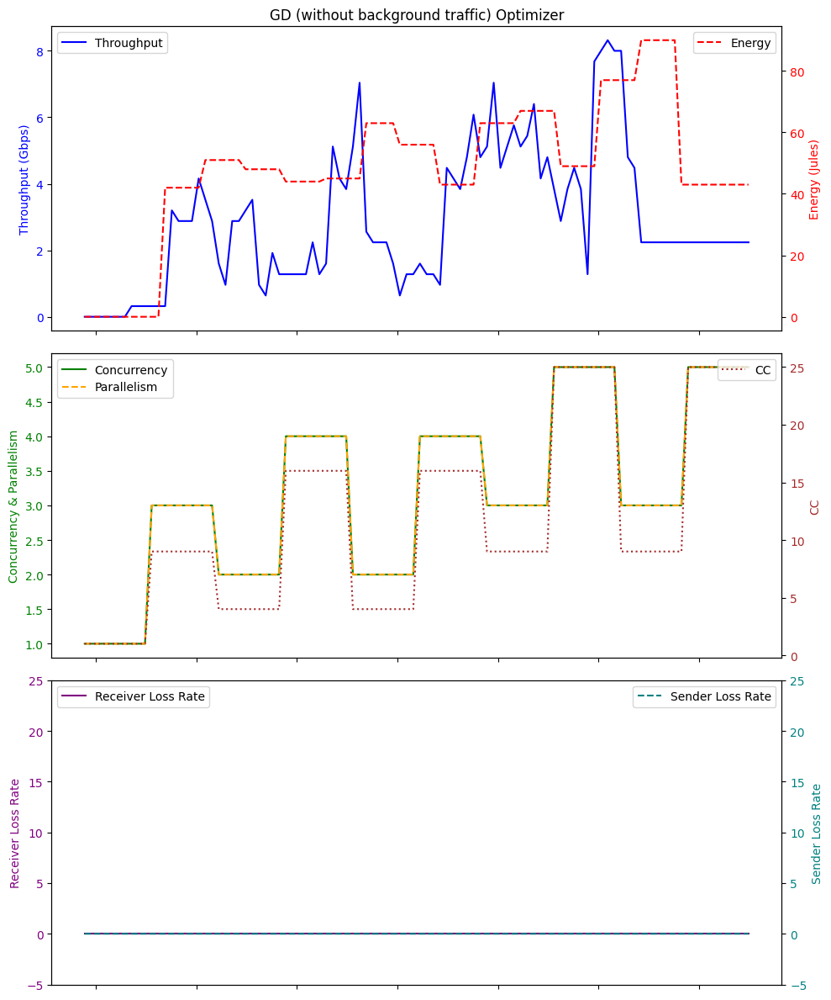

Average Throughput: 2.880000000000001
Total Energy: 4838.0
Total loss rate: 0.0005014165016170682
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 04:07:20.599744        0.00          0.0   1    0.0   0.0   
1   2024-01-26 04:07:21.595288        0.00          0.0   1    0.0   0.0   
2   2024-01-26 04:07:22.595792        0.00          0.0   1    0.0  32.7   
3   2024-01-26 04:07:23.596258        0.00          0.0   1    0.0  32.7   
4   2024-01-26 04:07:24.598564        0.00          0.0   1    0.0  32.8   
..                         ...         ...          ...  ..    ...   ...   
185 2024-01-26 04:10:25.788442        0.32          0.0   1    0.0  32.8   
186 2024-01-26 04:10:26.788325        0.32          0.0   1    0.0  32.6   
187 2024-01-26 04:10:27.789294        0.32          0.0   1    0.0  32.7   
188 2024-01-26 04:10:28.791236        0.32          0.0   1    0.0  32.6   
189 2024-01-26 04:10:29.792005        0.32          0.0   1    0.0

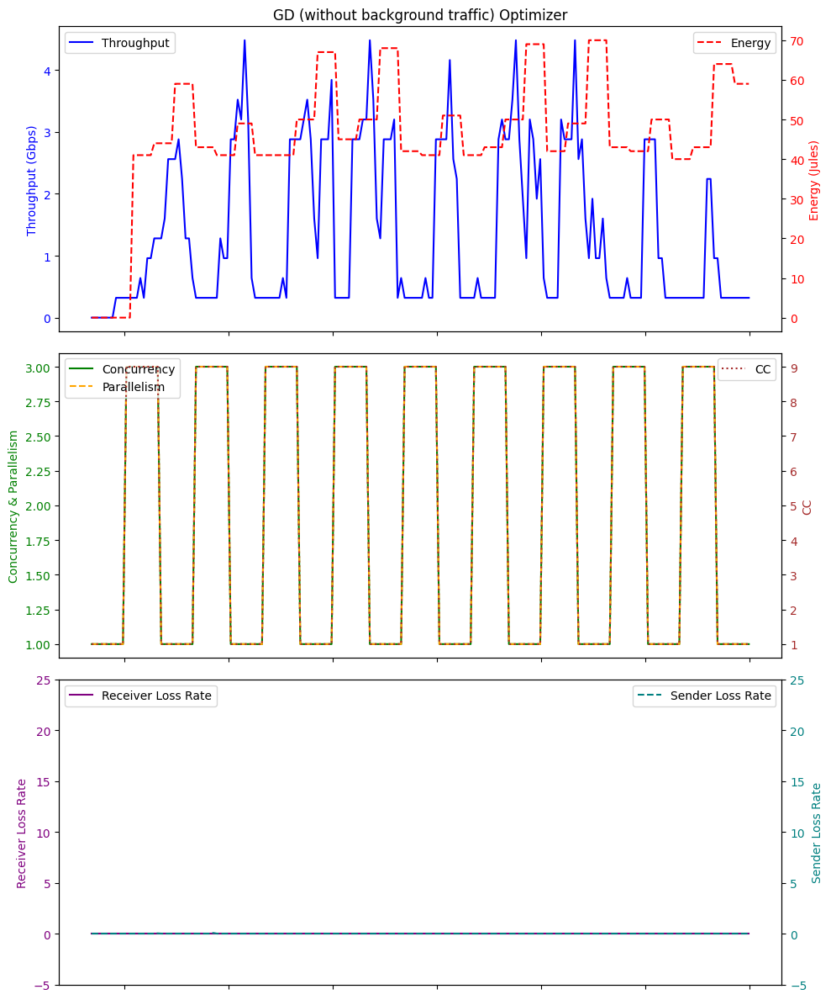

Average Throughput: 1.3625263157894734
Total Energy: 8760.0
Total loss rate: 0.09722698204514274
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 03:41:23.335438        0.00          0.0   1    0.0   0.0   
1   2024-01-26 03:41:24.328684        0.00          0.0   1    0.0   0.0   
2   2024-01-26 03:41:25.331465        0.00          0.0   1    0.0  32.8   
3   2024-01-26 03:41:26.331168        0.00          0.0   1    0.0  32.7   
4   2024-01-26 03:41:27.333615        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 03:43:18.446657        0.32          0.0  16    0.0  32.7   
116 2024-01-26 03:43:19.446086        0.32          0.0  16    0.0  32.8   
117 2024-01-26 03:43:20.447652        0.32          0.0  16    0.0  32.7   
118 2024-01-26 03:43:21.449367        0.32          0.0  16    0.0  32.8   
119 2024-01-26 03:43:22.449691        0.32          0.0  16    0.0 

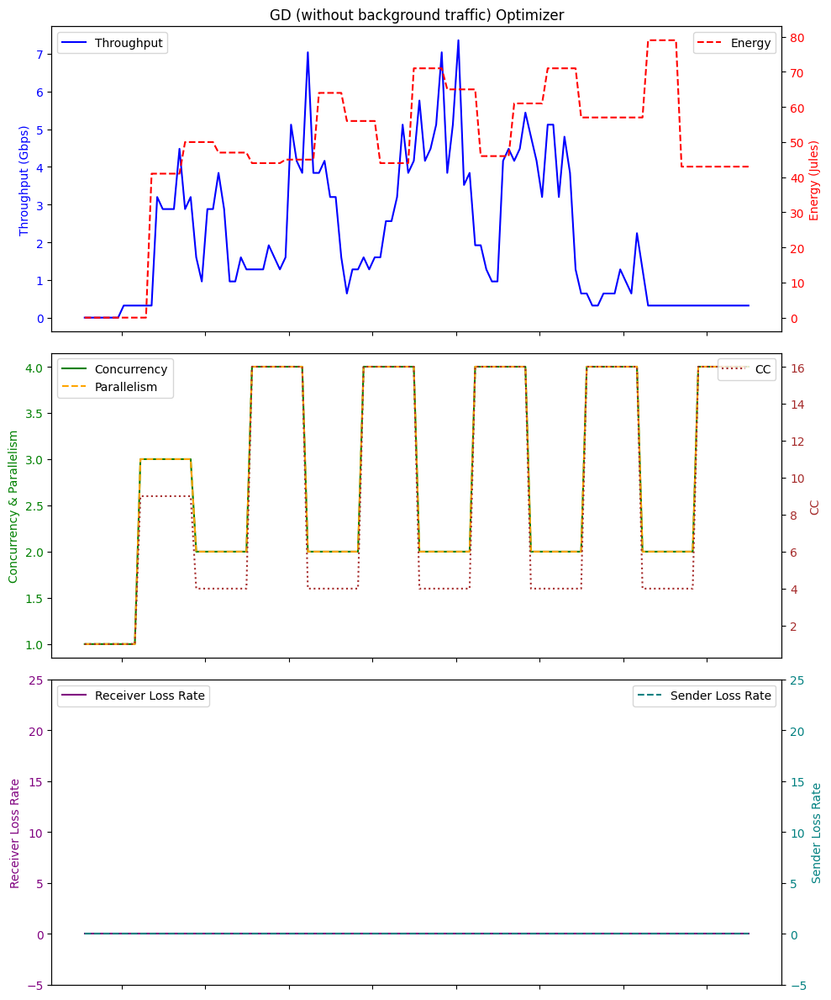

Average Throughput: 2.1413333333333338
Total Energy: 5883.0
Total loss rate: 0.008771160198759046
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 02:01:38.261548         0.0          0.0   1    0.0   0.0   
1   2024-01-26 02:01:39.258797         0.0          0.0   1    0.0   0.0   
2   2024-01-26 02:01:40.257496         0.0          0.0   1    0.0  32.7   
3   2024-01-26 02:01:41.258962         0.0          0.0   1    0.0  32.7   
4   2024-01-26 02:01:42.260873         0.0          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-26 02:09:53.782662         1.6          0.0  36    1.0  32.8   
496 2024-01-26 02:09:54.782741         1.6          0.0  36    1.0  32.7   
497 2024-01-26 02:09:55.783504         1.6          0.0  36    1.0  32.7   
498 2024-01-26 02:09:56.785973         1.6          0.0  36    1.0  32.6   
499 2024-01-26 02:09:57.786598         1.6          0.0  36    1.0

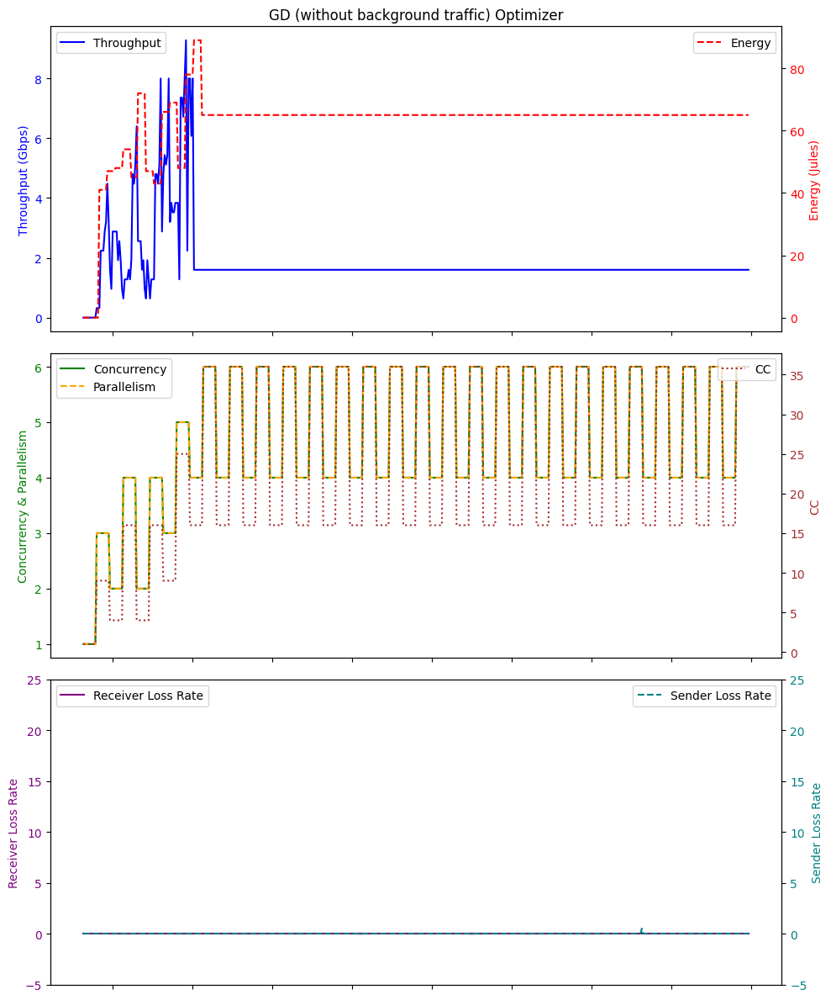

Average Throughput: 1.83488
Total Energy: 31152.0
Total loss rate: 0.5001396530108098
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 03:08:53.983021        0.00          0.0   1    0.0   0.0   
1   2024-01-26 03:08:54.980411        0.00          0.0   1    0.0   0.0   
2   2024-01-26 03:08:55.980092        0.00          0.0   1    0.0  32.7   
3   2024-01-26 03:08:56.980190        0.00          0.0   1    0.0  32.7   
4   2024-01-26 03:08:57.983162        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 03:10:49.097648        0.32          0.0  16    0.0  32.7   
116 2024-01-26 03:10:50.100251        0.32          0.0  16    0.0  32.7   
117 2024-01-26 03:10:51.100191        0.32          0.0  16    0.0  32.7   
118 2024-01-26 03:10:52.100169        0.32          0.0  16    0.0  32.7   
119 2024-01-26 03:10:53.103571        0.32          0.0  16    0.0  32.7   

 

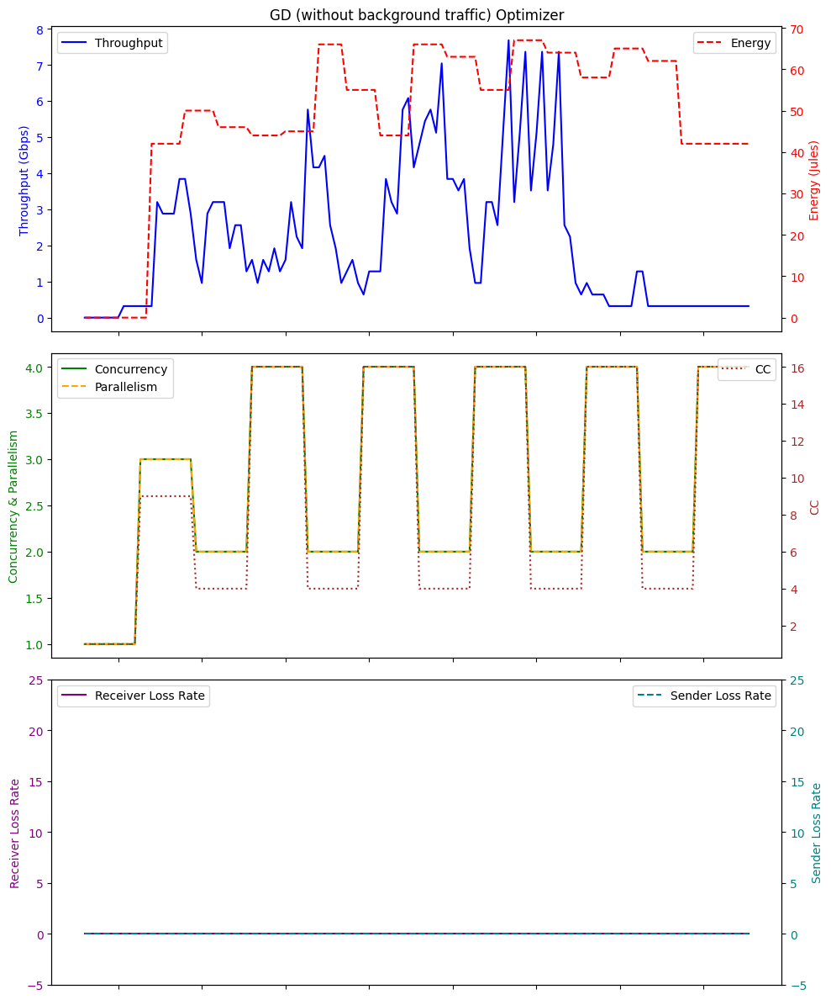

Average Throughput: 2.1600000000000006
Total Energy: 5832.0
Total loss rate: 0.0030849644971754435
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 01:39:48.633116        0.00          0.0   1    0.0   0.0   
1   2024-01-26 01:39:49.630215        0.00          0.0   1    0.0   0.0   
2   2024-01-26 01:39:50.631347        0.00          0.0   1    0.0  32.6   
3   2024-01-26 01:39:51.631448        0.00          0.0   1    0.0  32.7   
4   2024-01-26 01:39:52.634588        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 01:41:43.747524        0.32          0.0  16    0.0  32.7   
116 2024-01-26 01:41:44.748158        0.32          0.0  16    0.0  32.6   
117 2024-01-26 01:41:45.751529        0.32          0.0  16    0.0  32.7   
118 2024-01-26 01:41:46.751011        0.32          0.0  16    0.0  32.7   
119 2024-01-26 01:41:47.751551        0.32          0.0  16    0.

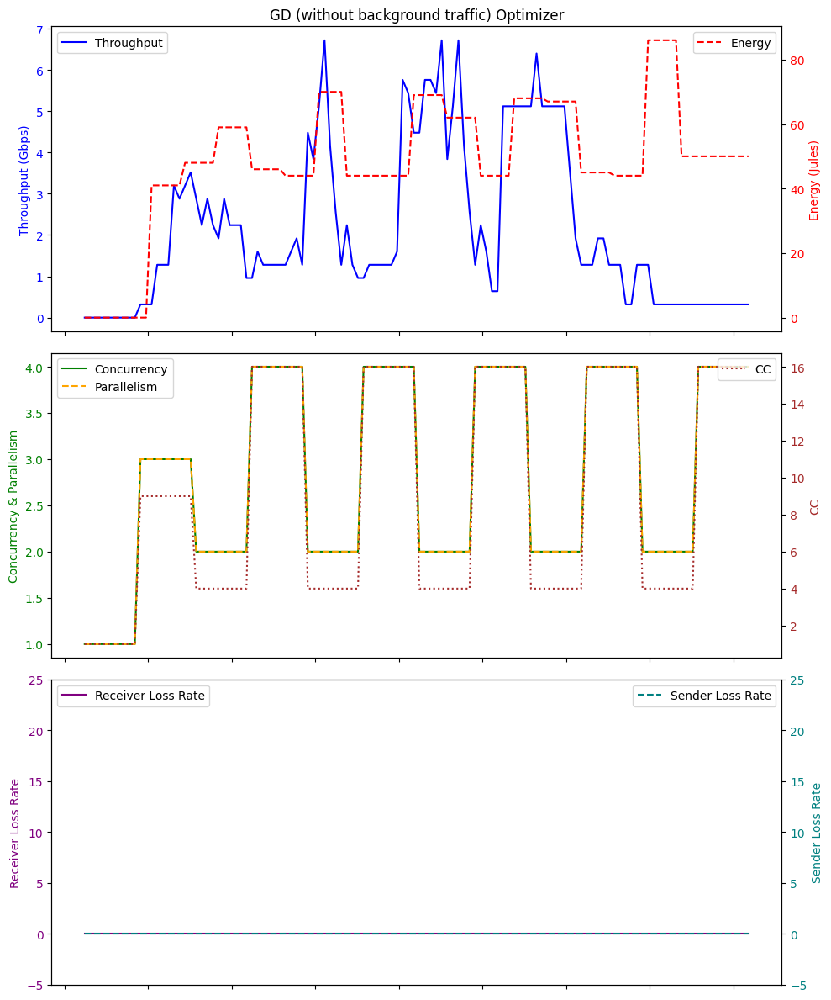

Average Throughput: 2.152
Total Energy: 5866.0
Total loss rate: 0.003271987666894776


In [22]:
# Example usage GD
directory = './logFileDir_simu_wo_bg/GD/'
dfs = process_log_files(directory,"GD_logFile_")

gd_throughput_list=[]
gd_energy_list=[]
gd_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('GD (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    gd_throughput_list.append(average_throughput)
    gd_energy_list.append(total_energy)
    gd_plr_list.append(total_plr)


                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:40:21.013978         0.0          0.0   1    0.0   0.0   
1  2024-01-25 22:40:22.006197         0.0          0.0  49    0.0   0.0   
2  2024-01-25 22:40:23.009183         0.0          0.0  49    0.0  32.6   
3  2024-01-25 22:40:24.009006         0.0          0.0  49    0.0  32.7   
4  2024-01-25 22:40:25.009386         0.0          0.0  49    0.0  34.0   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:41:17.063058         4.8          0.0  36    4.0  32.6   
57 2024-01-25 22:41:18.061207         4.8          0.0  36    4.0  32.6   
58 2024-01-25 22:41:19.064693         4.8          0.0  36    4.0  32.7   
59 2024-01-25 22:41:20.065685         4.8          0.0  36    4.0  32.8   
60 2024-01-25 22:41:21.066108         4.8          0.0  36    4.0  32.9   

    Energy  sender_lr  concurrency  parallelism  
0      0.0        0.0            1            1  

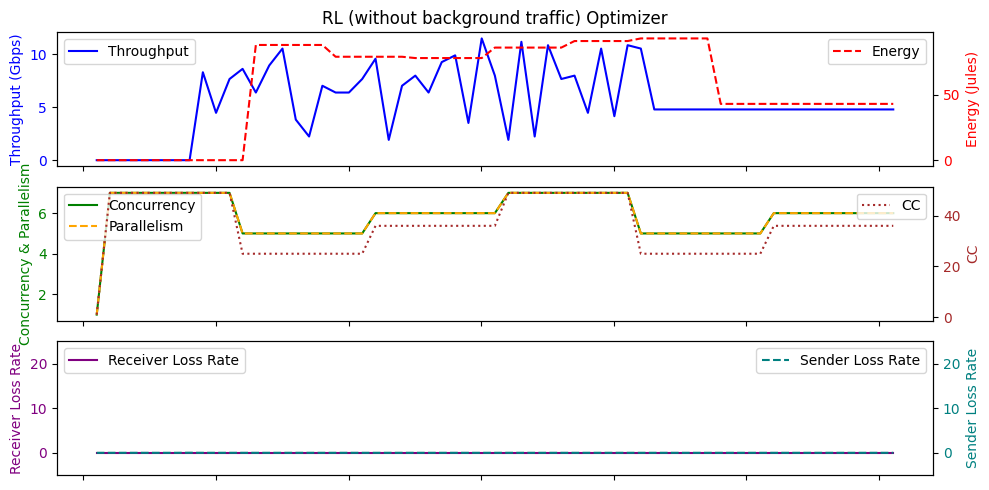

Average Throughput: 5.534426229508198
Total Energy: 3601.0
Total loss rate: 0.020699720819626673
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:25:26.019032        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:25:27.010861        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:25:28.013520        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:25:29.013673        0.00          0.0  49    0.0  32.6   
4  2024-01-25 22:25:30.014606        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:26:22.069163        2.24          0.0  36    2.0  32.9   
57 2024-01-25 22:26:23.069386        2.24          0.0  36    2.0  32.7   
58 2024-01-25 22:26:24.072397        2.24          0.0  36    2.0  32.8   
59 2024-01-25 22:26:25.072347        2.24          0.0  36    2.0  32.8   
60 2024-01-25 22:26:26.072267        2.24          0.0  36    2.0  32.7   

  

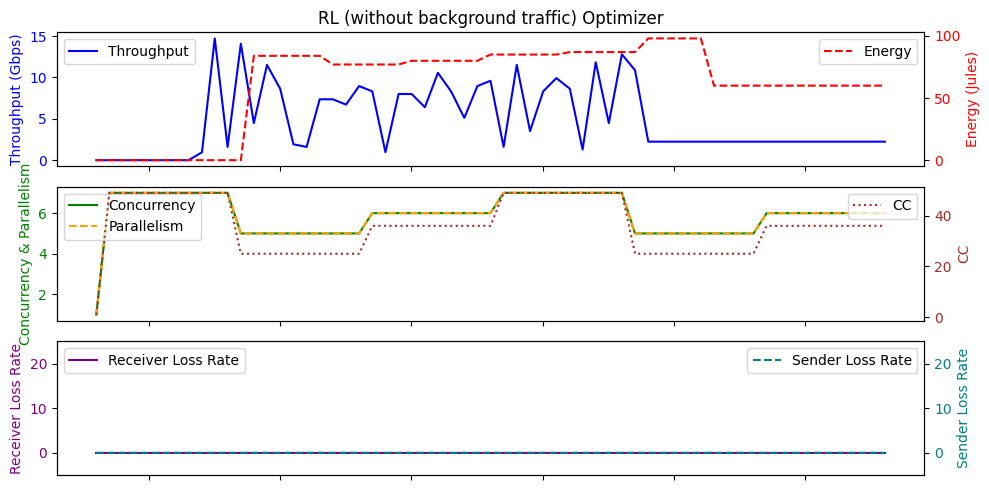

Average Throughput: 4.779016393442625
Total Energy: 3808.0
Total loss rate: 0.001077749465979431
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:02:49.691169        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:02:50.685587        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:02:51.685894        0.00          0.0  49    0.0  32.6   
3  2024-01-25 22:02:52.688530        0.00          0.0  49    0.0  32.7   
4  2024-01-25 22:02:53.688457        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:03:45.740731        0.32          0.0  36    0.0  32.7   
57 2024-01-25 22:03:46.740528        0.32          0.0  36    0.0  32.8   
58 2024-01-25 22:03:47.740669        0.32          0.0  36    0.0  32.7   
59 2024-01-25 22:03:48.744646        0.32          0.0  36    0.0  32.8   
60 2024-01-25 22:03:49.746332        0.32          0.0  36    0.0  32.7   

  

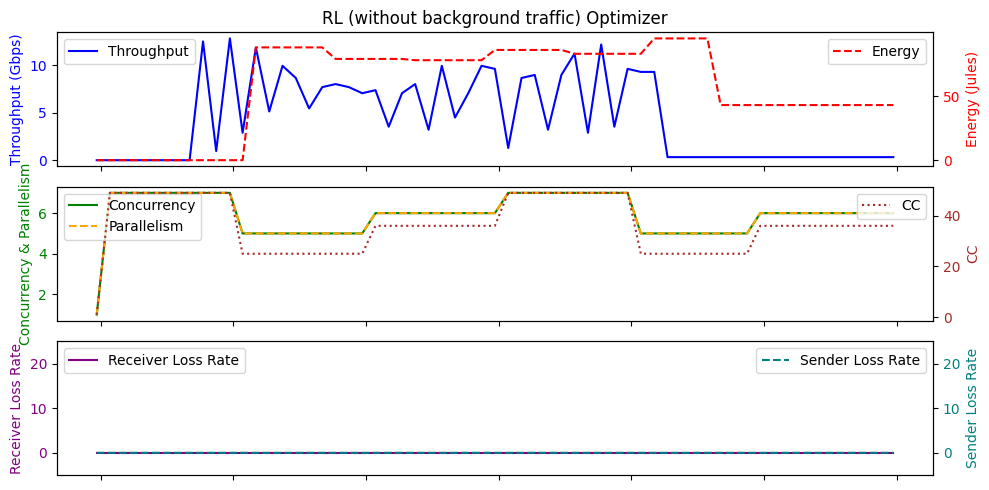

Average Throughput: 4.348852459016393
Total Energy: 3561.0
Total loss rate: 0.005658032350699459
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:55:15.927693        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:55:16.921944        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:55:17.921926        0.00          0.0  49    0.0  32.6   
3  2024-01-25 20:55:18.921705        0.00          0.0  49    0.0  32.7   
4  2024-01-25 20:55:19.925069        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 20:56:11.975411       10.24          0.0  49    9.0  32.7   
57 2024-01-25 20:56:12.975515       10.24          0.0  49    9.0  32.7   
58 2024-01-25 20:56:13.976047       10.24          0.0  49    9.0  32.7   
59 2024-01-25 20:56:14.978592       10.24          0.0  49    9.0  32.7   
60 2024-01-25 20:56:15.978134       10.24          0.0  49    9.0  32.6   

  

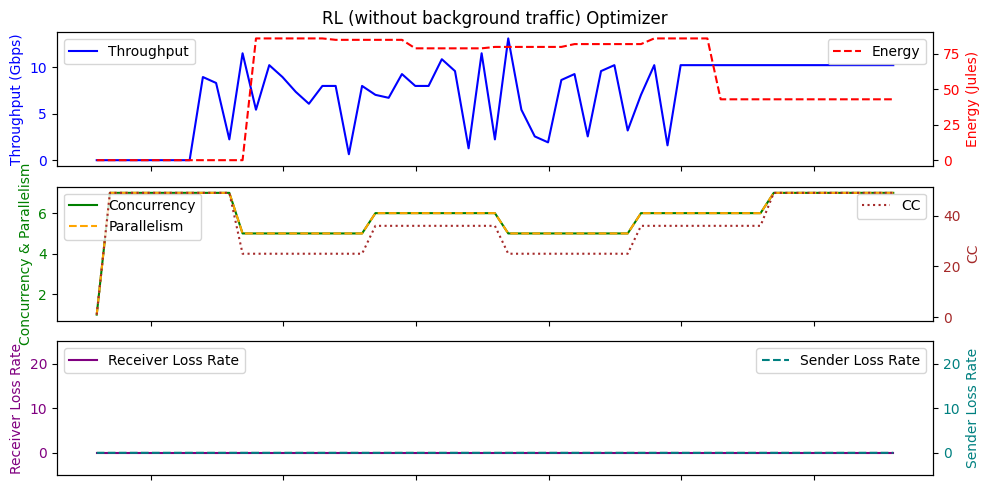

Average Throughput: 7.01377049180328
Total Energy: 3504.0
Total loss rate: 0.001907696182100349
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-25 23:25:46.893621        0.00          0.0   1    0.0   0.0   
1   2024-01-25 23:25:47.887619        0.00          0.0  49    0.0   0.0   
2   2024-01-25 23:25:48.887219        0.00          0.0  49    0.0  32.6   
3   2024-01-25 23:25:49.887554        0.00          0.0  49    0.0  32.7   
4   2024-01-25 23:25:50.890409        0.00          0.0  49    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-25 23:34:02.413159        0.32          0.0  25    0.0  32.6   
496 2024-01-25 23:34:03.413545        0.32          0.0  25    0.0  32.7   
497 2024-01-25 23:34:04.414424        0.32          0.0  25    0.0  32.7   
498 2024-01-25 23:34:05.416603        0.32          0.0  25    0.0  32.7   
499 2024-01-25 23:34:06.416147        0.32          0.0  25    0.0  

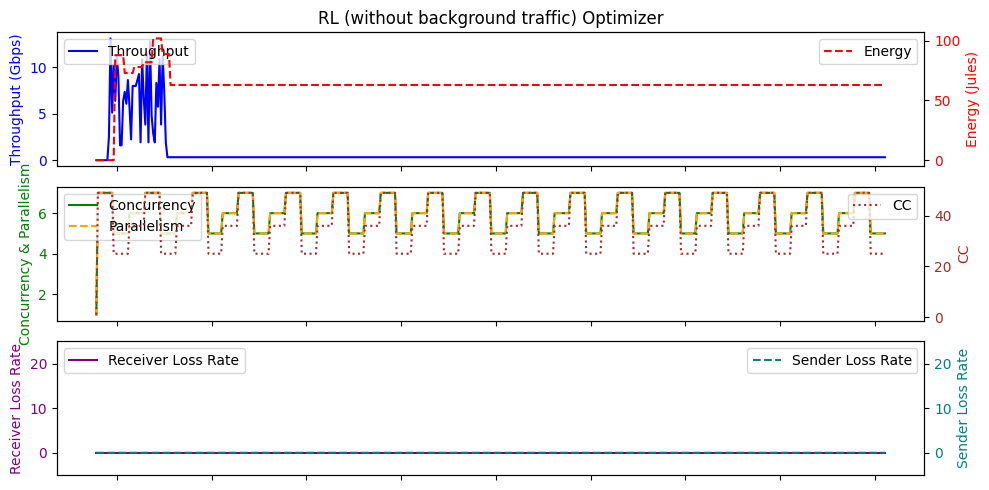

Average Throughput: 0.7865599999999999
Total Energy: 31522.0
Total loss rate: 0.0015124295317759985
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 23:06:18.289768        0.00          0.0   1    0.0   0.0   
1  2024-01-25 23:06:19.285097        0.00          0.0  49    0.0   0.0   
2  2024-01-25 23:06:20.284968        0.00          0.0  49    0.0  32.7   
3  2024-01-25 23:06:21.284999        0.00          0.0  49    0.0  32.8   
4  2024-01-25 23:06:22.285300        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 23:07:14.338279        1.92          0.0  36    2.0  32.6   
57 2024-01-25 23:07:15.340044        1.92          0.0  36    2.0  32.6   
58 2024-01-25 23:07:16.339887        1.92          0.0  36    2.0  32.7   
59 2024-01-25 23:07:17.340497        1.92          0.0  36    2.0  32.7   
60 2024-01-25 23:07:18.341255        1.92          0.0  36    2.0  32.7   


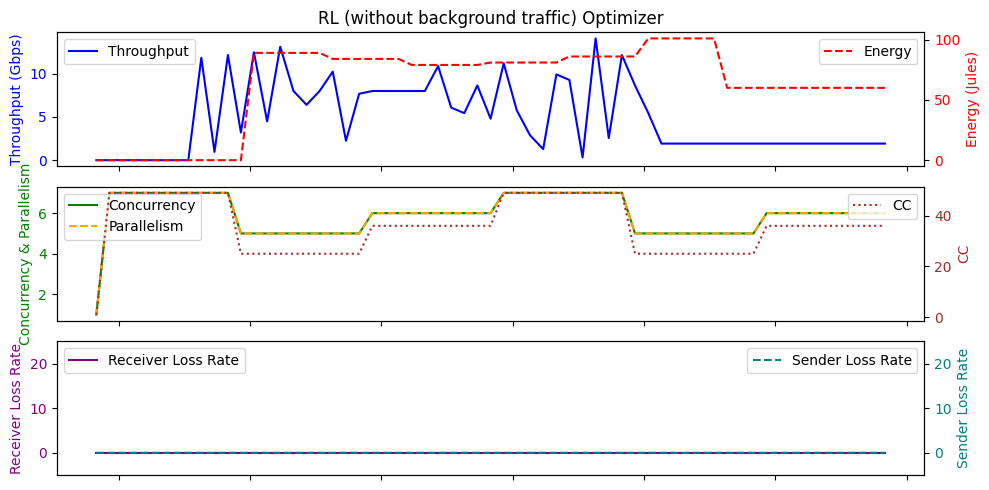

Average Throughput: 4.831475409836067
Total Energy: 3900.0
Total loss rate: 0.01120495815905512
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:22:10.531044        0.00          0.0   1    0.0   0.0   
1  2024-01-25 21:22:11.527987        0.00          0.0  49    0.0   0.0   
2  2024-01-25 21:22:12.528082        0.00          0.0  49    0.0  32.6   
3  2024-01-25 21:22:13.528270        0.00          0.0  49    0.0  32.6   
4  2024-01-25 21:22:14.530935        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:23:06.581417        2.56          0.0  36    2.0  32.6   
57 2024-01-25 21:23:07.582692        2.56          0.0  36    2.0  32.6   
58 2024-01-25 21:23:08.583853        2.56          0.0  36    2.0  32.6   
59 2024-01-25 21:23:09.583734        2.56          0.0  36    2.0  32.6   
60 2024-01-25 21:23:10.587622        2.56          0.0  36    2.0  32.6   

   

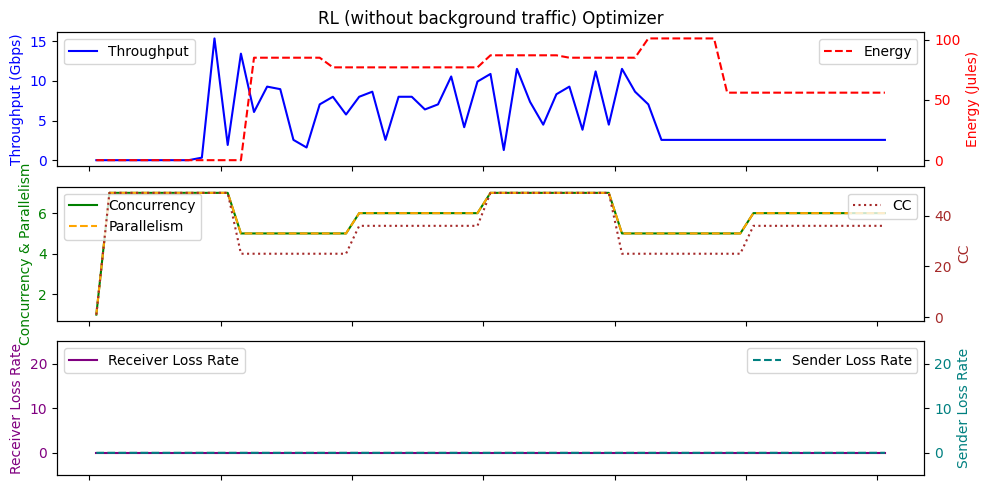

Average Throughput: 4.9101639344262304
Total Energy: 3800.0
Total loss rate: 0.0009139779546719273
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:38:46.339093        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:38:47.333249        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:38:48.333174        0.00          0.0  49    0.0  32.6   
3  2024-01-25 20:38:49.332278        0.00          0.0  49    0.0  32.6   
4  2024-01-25 20:38:50.335235        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 20:39:42.385936        2.56          0.0  25    2.0  32.8   
57 2024-01-25 20:39:43.385613        2.56          0.0  25    2.0  32.7   
58 2024-01-25 20:39:44.385886        2.56          0.0  25    2.0  32.7   
59 2024-01-25 20:39:45.388732        2.56          0.0  25    2.0  32.7   
60 2024-01-25 20:39:46.389006        2.56          0.0  25    2.0  32.8   



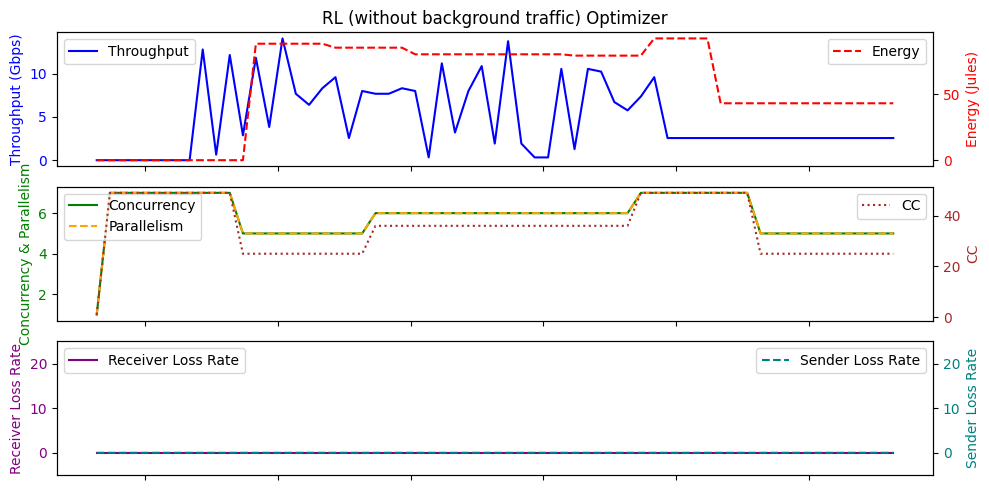

Average Throughput: 4.794754098360657
Total Energy: 3534.0
Total loss rate: 0.0050609746077972355
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 23:48:39.797318        0.00          0.0   1    0.0   0.0   
1  2024-01-25 23:48:40.792605        0.00          0.0  49    0.0   0.0   
2  2024-01-25 23:48:41.793735        0.00          0.0  49    0.0  32.6   
3  2024-01-25 23:48:42.793396        0.00          0.0  49    0.0  32.7   
4  2024-01-25 23:48:43.795452        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-25 23:49:45.855011        0.32          0.0  36    0.0  32.7   
67 2024-01-25 23:49:46.856344        0.32          0.0  36    0.0  32.7   
68 2024-01-25 23:49:47.859873        0.32          0.0  36    0.0  32.7   
69 2024-01-25 23:49:48.858712        0.32          0.0  36    0.0  32.7   
70 2024-01-25 23:49:49.859611        0.32          0.0  36    0.0  32.7   

 

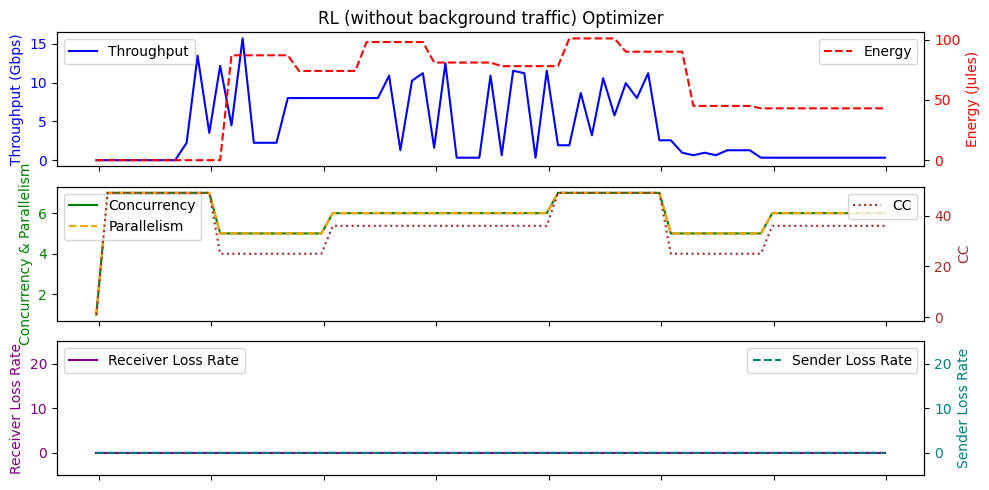

Average Throughput: 4.254647887323943
Total Energy: 4339.0
Total loss rate: 0.0017021884619328636
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:45:55.183376        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:45:56.179370        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:45:57.178601        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:45:58.179116        0.00          0.0  49    0.0  32.7   
4  2024-01-25 22:45:59.179564        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:46:51.230625        0.32          0.0  49    0.0  32.7   
57 2024-01-25 22:46:52.233266        0.32          0.0  49    0.0  32.7   
58 2024-01-25 22:46:53.233644        0.32          0.0  49    0.0  32.7   
59 2024-01-25 22:46:54.233917        0.32          0.0  49    0.0  32.7   
60 2024-01-25 22:46:55.237122        0.32          0.0  49    0.0  32.7   

 

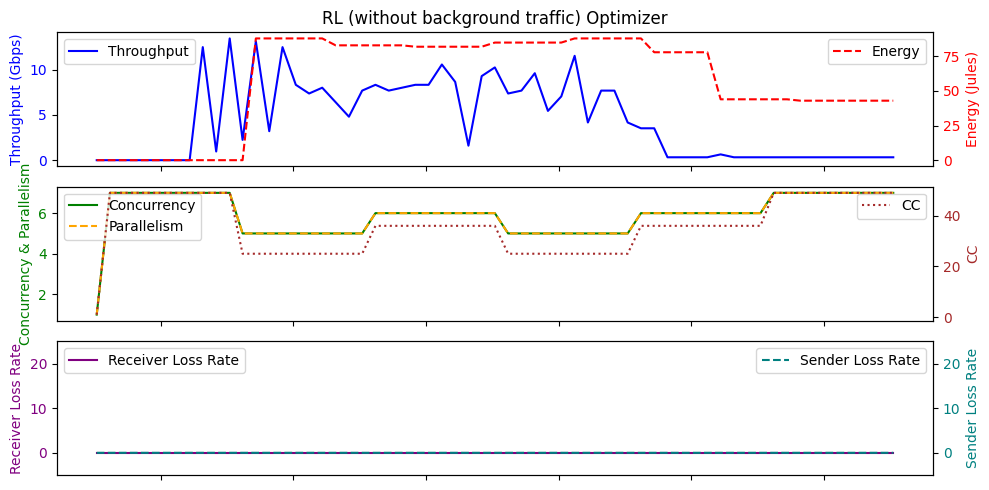

Average Throughput: 4.375081967213114
Total Energy: 3554.0
Total loss rate: 0.00195868877675517
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:51:22.092807        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:51:23.089047        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:51:24.089609        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:51:25.090927        0.00          0.0  49    0.0  32.8   
4  2024-01-25 22:51:26.092067        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:52:18.139492        1.28          0.0  36    1.0  32.7   
57 2024-01-25 22:52:19.143217        1.28          0.0  36    1.0  32.7   
58 2024-01-25 22:52:20.142724        1.28          0.0  36    1.0  32.7   
59 2024-01-25 22:52:21.141768        1.28          0.0  36    1.0  32.7   
60 2024-01-25 22:52:22.145263        1.28          0.0  36    1.0  32.8   

   

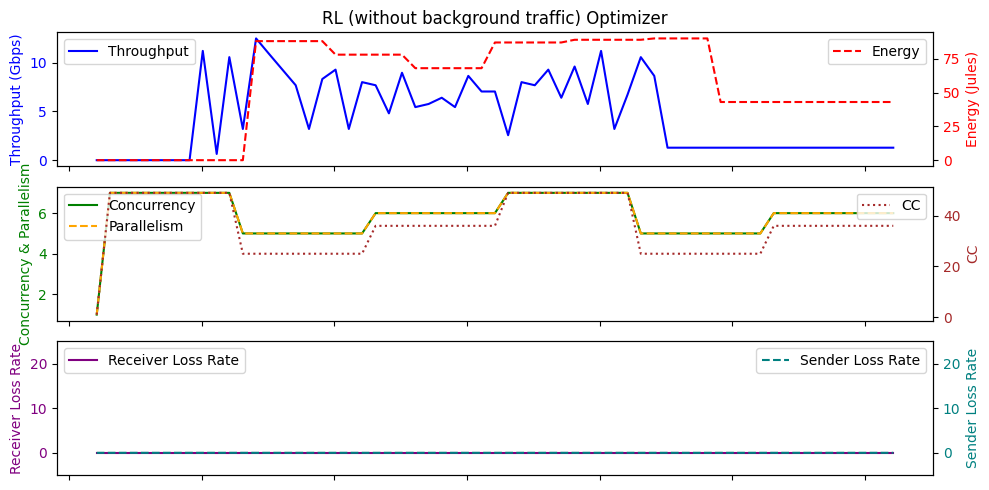

Average Throughput: 4.553442622950818
Total Energy: 3512.0
Total loss rate: 0.001785303460298866
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:17:05.428402        0.00          0.0   1    0.0   0.0   
1  2024-01-25 21:17:06.424823        0.00          0.0  49    0.0   0.0   
2  2024-01-25 21:17:07.425747        0.00          0.0  49    0.0  32.6   
3  2024-01-25 21:17:08.426359        0.00          0.0  49    0.0  32.6   
4  2024-01-25 21:17:09.425784        0.00          0.0  49    0.0  32.5   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:18:01.476315        1.92          0.0  36    2.0  32.8   
57 2024-01-25 21:18:02.478938        1.92          0.0  36    2.0  32.7   
58 2024-01-25 21:18:03.479557        1.92          0.0  36    2.0  32.7   
59 2024-01-25 21:18:04.478990        1.92          0.0  36    2.0  32.7   
60 2024-01-25 21:18:05.480729        1.92          0.0  36    2.0  32.7   

  

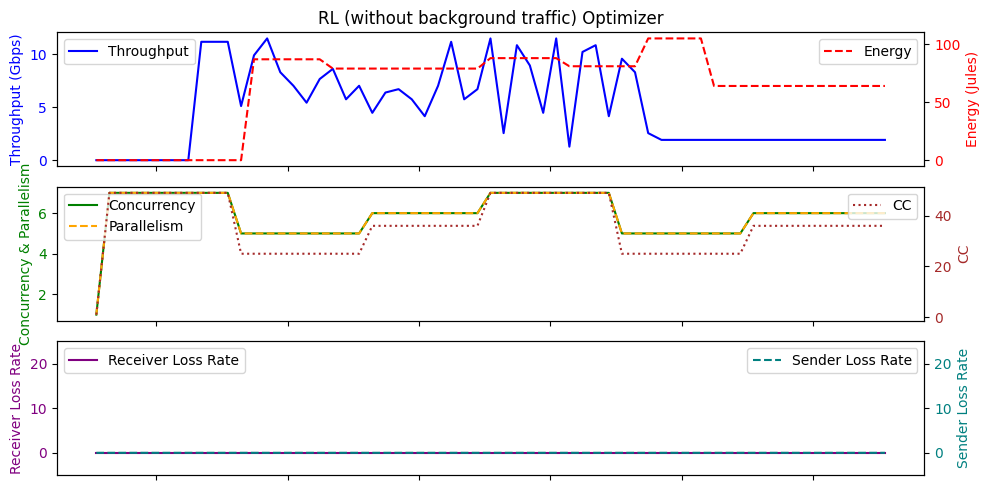

Average Throughput: 4.915409836065575
Total Energy: 3905.0
Total loss rate: 0.006848865482470395
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:43:57.235680        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:43:58.228866        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:43:59.230726        0.00          0.0  49    0.0  32.7   
3  2024-01-25 20:44:00.231559        0.00          0.0  49    0.0  32.7   
4  2024-01-25 20:44:01.234107        0.00          0.0  49    0.0  32.6   
5  2024-01-25 20:44:02.234768        0.00          0.0  49    0.0  32.7   
6  2024-01-25 20:44:03.230574        0.00          0.0  49    0.0  32.6   
7  2024-01-25 20:44:04.236991        0.00          0.0  49    0.0  43.5   
8  2024-01-25 20:44:05.231725       10.56          0.0  49    9.0  41.3   
9  2024-01-25 20:44:06.239554        2.56          0.0  49    2.0  38.8   
10 2024-01-25 20:44:07.236692       12.16          0.0  49   11.0  38.7   
11 

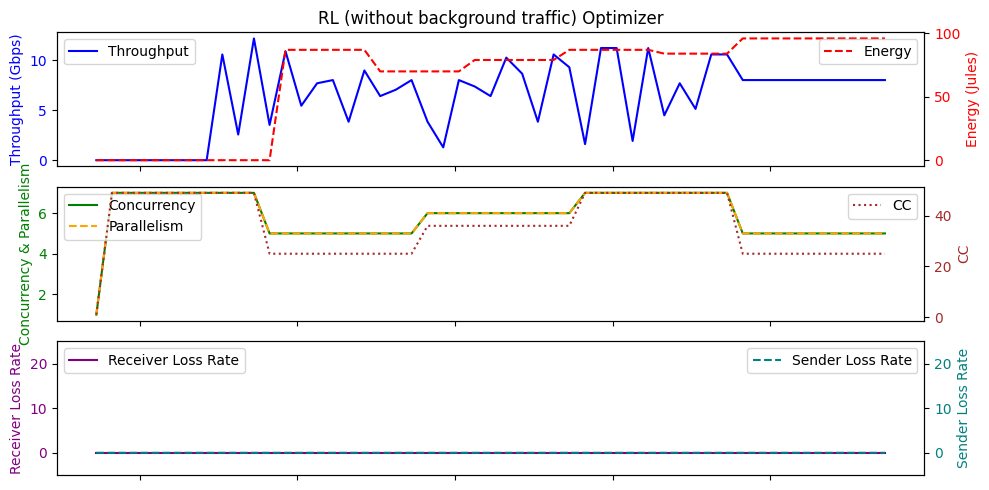

Average Throughput: 6.2745098039215685
Total Energy: 3318.0
Total loss rate: 0.0028920775362856624
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-25 22:12:46.872388        0.00          0.0   1    0.0   0.0   
1   2024-01-25 22:12:47.868546        0.00          0.0  49    0.0   0.0   
2   2024-01-25 22:12:48.868778        0.00          0.0  49    0.0  32.7   
3   2024-01-25 22:12:49.868556        0.00          0.0  49    0.0  32.7   
4   2024-01-25 22:12:50.871202        0.00          0.0  49    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-25 22:21:02.390629        0.64          0.0  25    1.0  32.6   
496 2024-01-25 22:21:03.394859        0.64          0.0  25    1.0  32.6   
497 2024-01-25 22:21:04.396247        0.64          0.0  25    1.0  32.8   
498 2024-01-25 22:21:05.395371        0.64          0.0  25    1.0  32.7   
499 2024-01-25 22:21:06.396489        0.64          0.0  25    1.

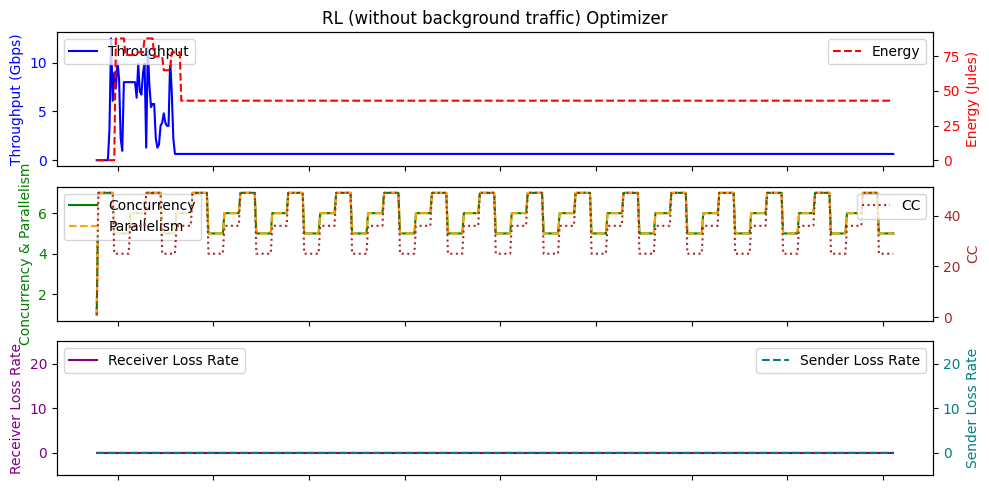

Average Throughput: 1.09312
Total Energy: 22444.0
Total loss rate: 0.0397744394259163
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:33:46.249834        0.00          0.0   1    0.0   0.0   
1  2024-01-25 21:33:47.242842        0.00          0.0  49    0.0   0.0   
2  2024-01-25 21:33:48.244431        0.00          0.0  49    0.0  32.6   
3  2024-01-25 21:33:49.244092        0.00          0.0  49    0.0  32.7   
4  2024-01-25 21:33:50.247069        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:34:42.298420        0.32          0.0  49    0.0  32.6   
57 2024-01-25 21:34:43.298776        0.32          0.0  49    0.0  32.6   
58 2024-01-25 21:34:44.302607        0.32          0.0  49    0.0  32.6   
59 2024-01-25 21:34:45.301572        0.32          0.0  49    0.0  32.7   
60 2024-01-25 21:34:46.299058        0.32          0.0  49    0.0  32.7   

    Energy  s

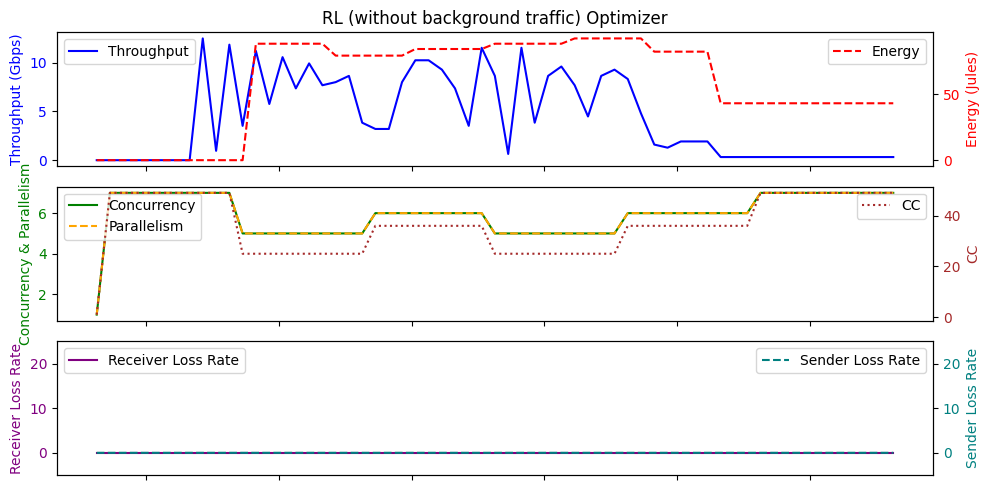

Average Throughput: 4.385573770491803
Total Energy: 3598.0
Total loss rate: 0.0020846869166641605
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:33:52.160139        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:33:53.155531        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:33:54.156695        0.00          0.0  49    0.0  32.7   
3  2024-01-25 20:33:55.157274        0.00          0.0  49    0.0  32.7   
4  2024-01-25 20:33:56.158169        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 20:34:48.210257        7.36          0.0  36    7.0  32.7   
57 2024-01-25 20:34:49.209527        7.36          0.0  36    7.0  32.9   
58 2024-01-25 20:34:50.212321        7.36          0.0  36    7.0  32.8   
59 2024-01-25 20:34:51.214898        7.36          0.0  36    7.0  32.7   
60 2024-01-25 20:34:52.214550        7.36          0.0  36    7.0  32.7   

 

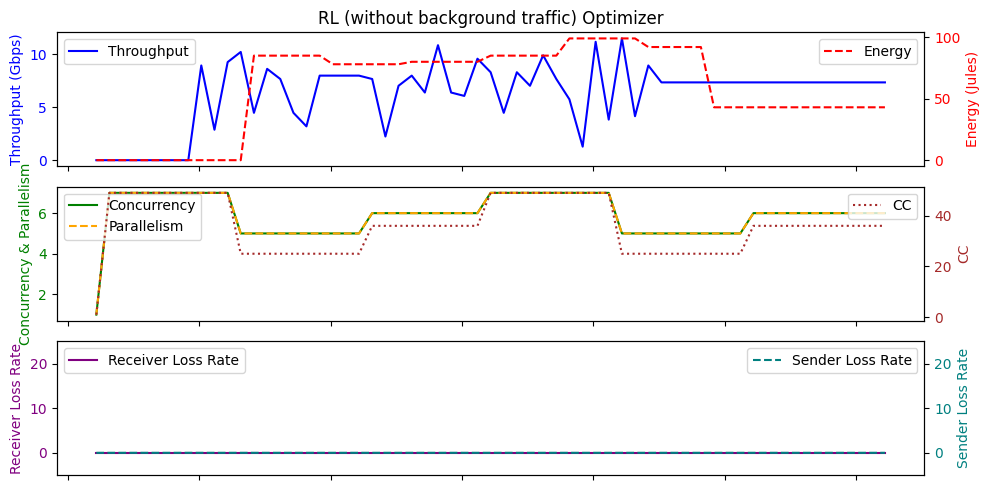

Average Throughput: 6.247868852459018
Total Energy: 3624.0
Total loss rate: 0.005159696594336526
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 23:43:19.198072        0.00          0.0   1    0.0   0.0   
1  2024-01-25 23:43:20.194022        0.00          0.0  49    0.0   0.0   
2  2024-01-25 23:43:21.192912        0.00          0.0  49    0.0  32.9   
3  2024-01-25 23:43:22.194069        0.00          0.0  49    0.0  32.8   
4  2024-01-25 23:43:23.195635        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 23:44:15.249122        0.32          0.0  36    0.0  32.7   
57 2024-01-25 23:44:16.249540        0.32          0.0  36    0.0  32.6   
58 2024-01-25 23:44:17.250666        0.32          0.0  36    0.0  32.7   
59 2024-01-25 23:44:18.250719        0.32          0.0  36    0.0  32.7   
60 2024-01-25 23:44:19.249969        0.32          0.0  36    0.0  32.8   

  

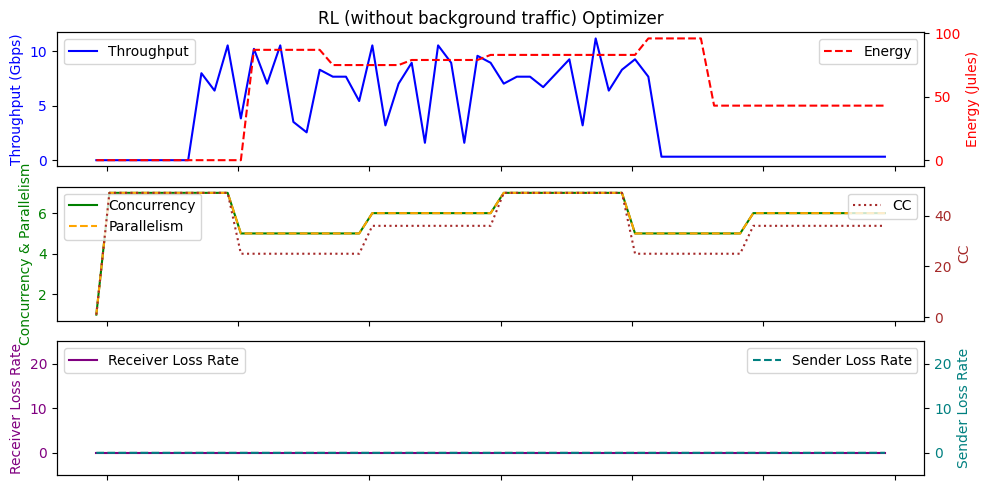

Average Throughput: 4.280655737704917
Total Energy: 3524.0
Total loss rate: 0.008984433692723781
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-25 23:13:11.600910        0.00          0.0   1    0.0   0.0   
1   2024-01-25 23:13:12.599529        0.00          0.0  49    0.0   0.0   
2   2024-01-25 23:13:13.597325        0.00          0.0  49    0.0  32.6   
3   2024-01-25 23:13:14.601265        0.00          0.0  49    0.0  32.7   
4   2024-01-25 23:13:15.602720        0.00          0.0  49    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-25 23:21:27.119340        1.28          0.0  25    1.0  32.7   
496 2024-01-25 23:21:28.120518        1.28          0.0  25    1.0  32.7   
497 2024-01-25 23:21:29.122670        1.28          0.0  25    1.0  32.8   
498 2024-01-25 23:21:30.122860        1.28          0.0  25    1.0  32.7   
499 2024-01-25 23:21:31.123556        1.28          0.0  25    1.0 

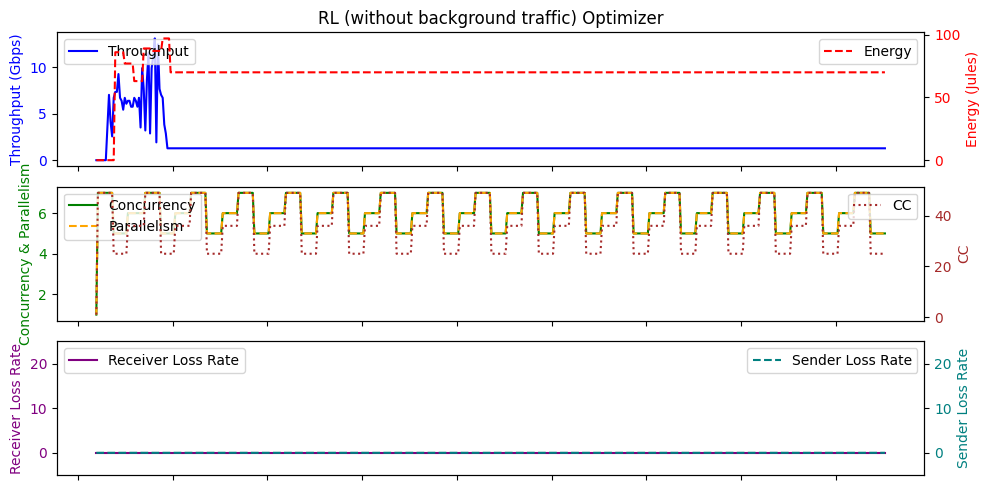

Average Throughput: 1.6716800000000003
Total Energy: 34607.0
Total loss rate: 0.0033250817612497765
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:11:55.090309        0.00          0.0   1    0.0   0.0   
1  2024-01-25 21:11:56.081958        0.00          0.0  49    0.0   0.0   
2  2024-01-25 21:11:57.085305        0.00          0.0  49    0.0  32.6   
3  2024-01-25 21:11:58.085960        0.00          0.0  49    0.0  32.6   
4  2024-01-25 21:11:59.087736        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:12:51.134866        3.52          0.0  49    3.0  32.7   
57 2024-01-25 21:12:52.134956        3.52          0.0  49    3.0  32.7   
58 2024-01-25 21:12:53.138760        3.52          0.0  49    3.0  32.6   
59 2024-01-25 21:12:54.137875        3.52          0.0  49    3.0  32.7   
60 2024-01-25 21:12:55.140341        3.52          0.0  49    3.0  32.7   


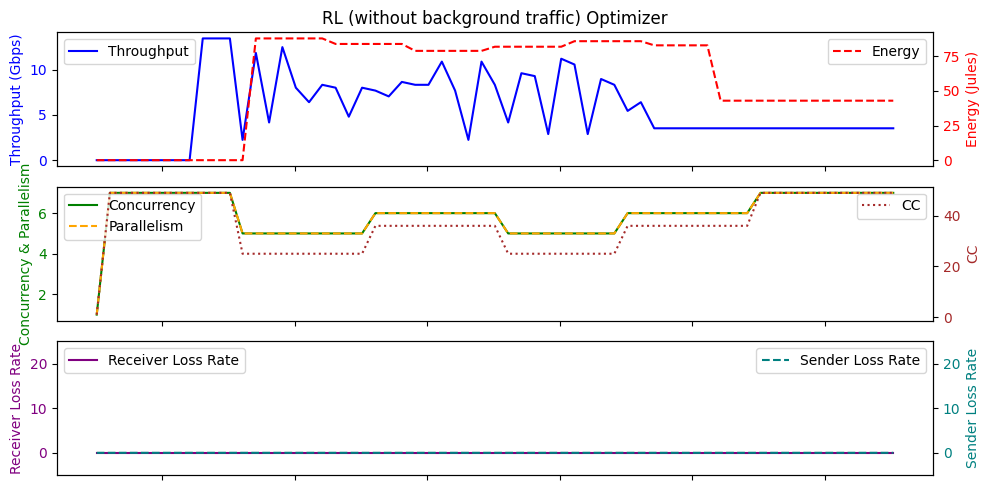

Average Throughput: 5.592131147540981
Total Energy: 3531.0
Total loss rate: 0.0008830139562392764
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:07:51.685771         0.0          0.0   1    0.0   0.0   
1  2024-01-25 22:07:52.680391         0.0          0.0  49    0.0   0.0   
2  2024-01-25 22:07:53.684284         0.0          0.0  49    0.0  32.6   
3  2024-01-25 22:07:54.682864         0.0          0.0  49    0.0  32.6   
4  2024-01-25 22:07:55.685905         0.0          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:08:47.735344        11.2          0.0  25   10.0  32.6   
57 2024-01-25 22:08:48.737517        11.2          0.0  25   10.0  32.6   
58 2024-01-25 22:08:49.738872        11.2          0.0  25   10.0  32.7   
59 2024-01-25 22:08:50.738882        11.2          0.0  25   10.0  32.7   
60 2024-01-25 22:08:51.739409        11.2          0.0  25   10.0  32.7   

 

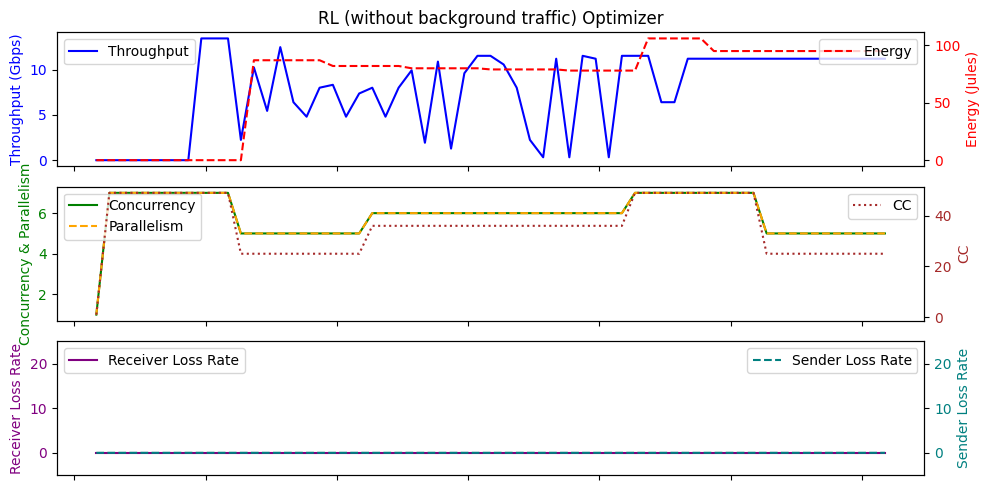

Average Throughput: 7.706229508196721
Total Energy: 4296.0
Total loss rate: 0.00170134151686808
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:35:20.913867        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:35:21.909066        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:35:22.909142        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:35:23.911748        0.00          0.0  49    0.0  32.7   
4  2024-01-25 22:35:24.911408        0.00          0.0  49    0.0  32.8   
5  2024-01-25 22:35:25.911417        0.00          0.0  49    0.0  32.8   
6  2024-01-25 22:35:26.916723        0.00          0.0  49    0.0  32.6   
7  2024-01-25 22:35:27.917963        0.00          0.0  49    0.0  33.1   
8  2024-01-25 22:35:28.916938        8.96          0.0  49    8.0  32.9   
9  2024-01-25 22:35:29.948967        8.64          0.0  49    8.0  33.3   
10 2024-01-25 22:35:30.912384        8.64          0.0  49    0.0  32.7   
11 2

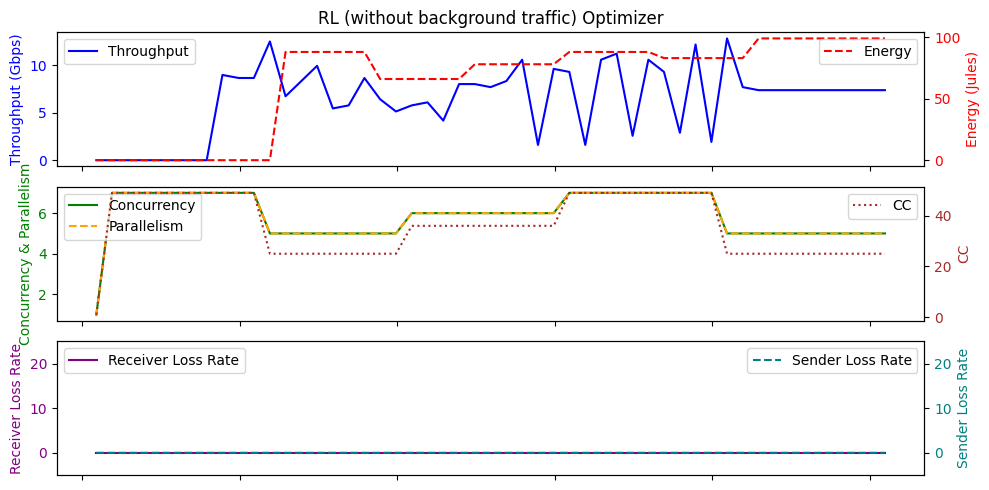

Average Throughput: 6.343529411764707
Total Energy: 3309.0
Total loss rate: 0.0005121149923779732
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:57:59.549700        0.00          0.0   1    0.0   0.0   
1  2024-01-25 21:58:00.541518        0.00          0.0  49    0.0   0.0   
2  2024-01-25 21:58:01.544256        0.00          0.0  49    0.0  32.6   
3  2024-01-25 21:58:02.544512        0.00          0.0  49    0.0  32.6   
4  2024-01-25 21:58:03.544004        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:58:55.593739        1.92          0.0  36    2.0  32.6   
57 2024-01-25 21:58:56.593989        1.92          0.0  36    2.0  32.7   
58 2024-01-25 21:58:57.595078        1.92          0.0  36    2.0  32.6   
59 2024-01-25 21:58:58.597009        1.92          0.0  36    2.0  32.6   
60 2024-01-25 21:58:59.596173        1.92          0.0  36    2.0  32.7   

 

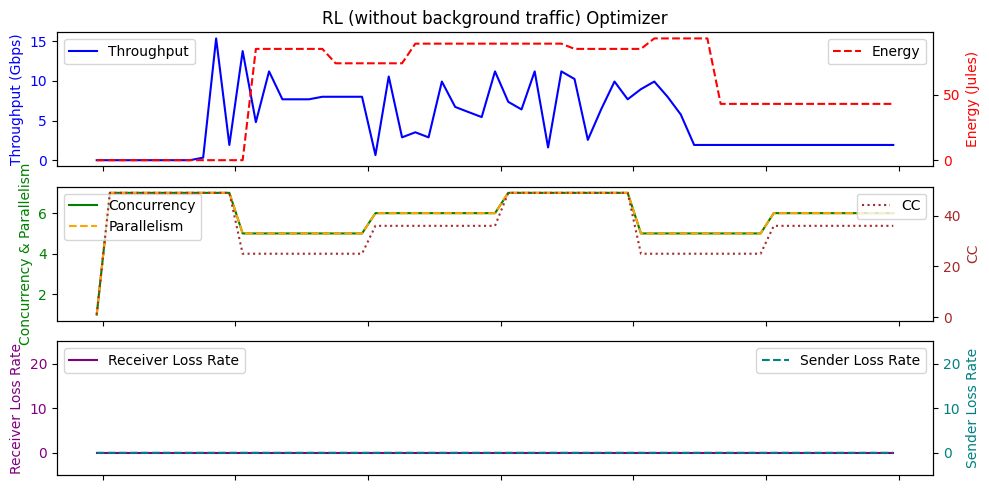

Average Throughput: 4.92065573770492
Total Energy: 3599.0
Total loss rate: 0.0019393723104816438
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:30:15.923485        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:30:16.919049        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:30:17.918087        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:30:18.918887        0.00          0.0  49    0.0  32.7   
4  2024-01-25 22:30:19.921039        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:31:11.972561        0.32          0.0  25    0.0  32.7   
57 2024-01-25 22:31:12.974407        0.32          0.0  25    0.0  32.8   
58 2024-01-25 22:31:13.975676        0.32          0.0  25    0.0  32.6   
59 2024-01-25 22:31:14.977241        0.32          0.0  25    0.0  32.7   
60 2024-01-25 22:31:15.977998        0.32          0.0  25    0.0  32.7   

  

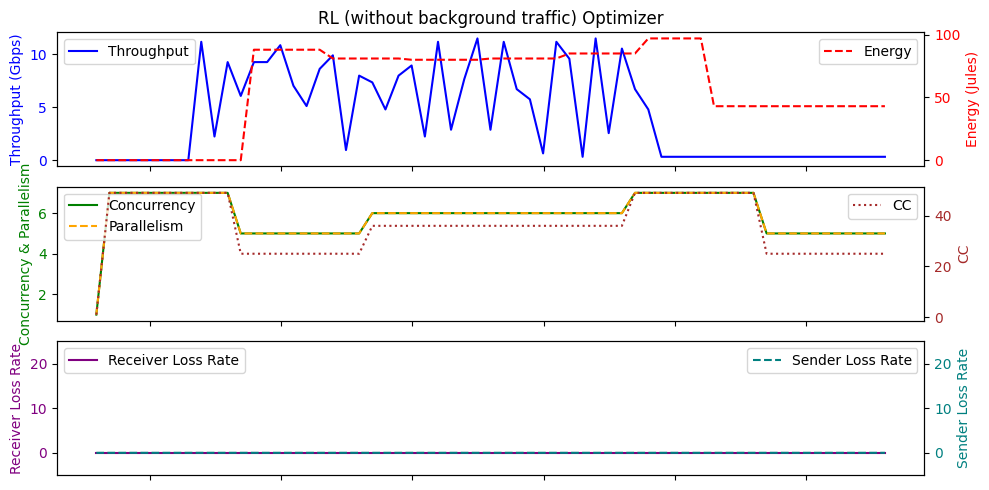

Average Throughput: 4.144262295081966
Total Energy: 3577.0
Total loss rate: 0.0015183855495566828
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:22:07.573709        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:22:08.569136        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:22:09.568390        0.00          0.0  49    0.0  32.6   
3  2024-01-25 20:22:10.568504        0.00          0.0  49    0.0  32.7   
4  2024-01-25 20:22:11.569489        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 20:23:03.621849        5.12          0.0  36    5.0  32.7   
57 2024-01-25 20:23:04.621835        5.12          0.0  36    5.0  32.6   
58 2024-01-25 20:23:05.621262        5.12          0.0  36    5.0  32.6   
59 2024-01-25 20:23:06.623412        5.12          0.0  36    5.0  32.6   
60 2024-01-25 20:23:07.625690        5.12          0.0  36    5.0  32.6   

 

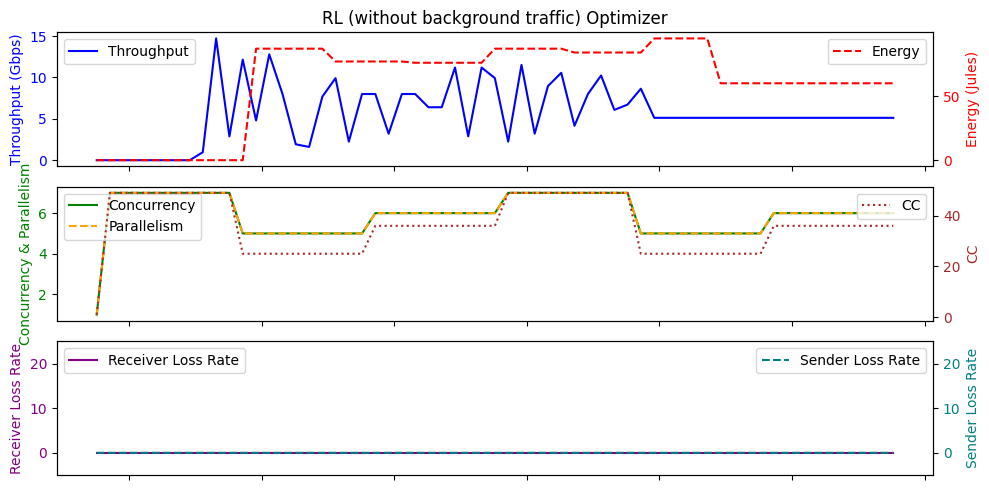

Average Throughput: 5.581639344262295
Total Energy: 3781.0
Total loss rate: 0.0008172058183493851
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 21:00:35.974030         0.0          0.0   1    0.0   0.0   
1  2024-01-25 21:00:36.966997         0.0          0.0  49    0.0   0.0   
2  2024-01-25 21:00:37.967809         0.0          0.0  49    0.0  32.6   
3  2024-01-25 21:00:38.969064         0.0          0.0  49    0.0  32.6   
4  2024-01-25 21:00:39.969354         0.0          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 21:01:32.025630         1.6          0.0  25    1.0  32.6   
57 2024-01-25 21:01:33.023626         1.6          0.0  25    1.0  32.7   
58 2024-01-25 21:01:34.026868         1.6          0.0  25    1.0  32.6   
59 2024-01-25 21:01:35.026547         1.6          0.0  25    1.0  32.8   
60 2024-01-25 21:01:36.027541         1.6          0.0  25    1.0  32.7   

 

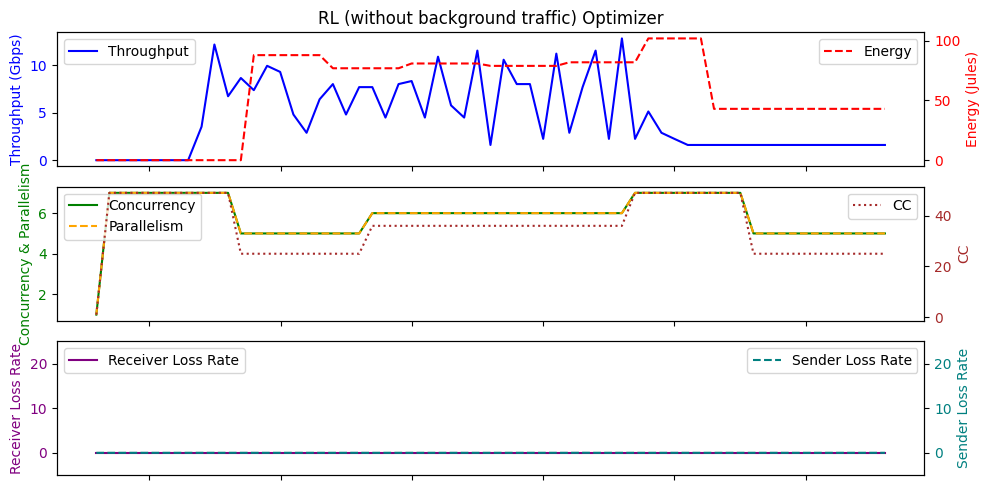

Average Throughput: 4.500983606557379
Total Energy: 3554.0
Total loss rate: 0.01805611762009278
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 20:10:02.426200        0.00          0.0   1    0.0   0.0   
1  2024-01-25 20:10:03.422534        0.00          0.0  49    0.0   0.0   
2  2024-01-25 20:10:04.424441        0.00          0.0  49    0.0  32.6   
3  2024-01-25 20:10:05.424368        0.00          0.0  49    0.0  32.8   
4  2024-01-25 20:10:06.422365        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 20:10:58.475515        2.56          0.0  49    2.0  32.6   
57 2024-01-25 20:10:59.476379        2.56          0.0  49    2.0  32.7   
58 2024-01-25 20:11:00.478998        2.56          0.0  49    2.0  32.6   
59 2024-01-25 20:11:01.479002        2.56          0.0  49    2.0  32.6   
60 2024-01-25 20:11:02.481959        2.56          0.0  49    2.0  32.6   

   

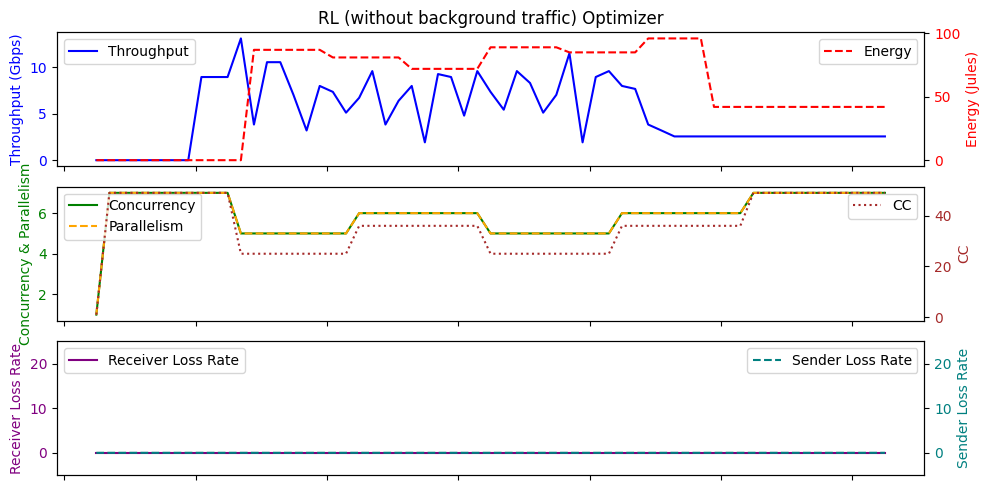

Average Throughput: 5.015081967213115
Total Energy: 3552.0
Total loss rate: 0.0021274733087345158
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 23:01:26.608664        0.00          0.0   1    0.0   0.0   
1  2024-01-25 23:01:27.603097        0.00          0.0  49    0.0   0.0   
2  2024-01-25 23:01:28.602979        0.00          0.0  49    0.0  32.6   
3  2024-01-25 23:01:29.604975        0.00          0.0  49    0.0  32.7   
4  2024-01-25 23:01:30.606149        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 23:02:22.657583        0.32          0.0  25    0.0  32.6   
57 2024-01-25 23:02:23.657355        0.32          0.0  25    0.0  32.7   
58 2024-01-25 23:02:24.659718        0.32          0.0  25    0.0  32.9   
59 2024-01-25 23:02:25.659020        0.32          0.0  25    0.0  32.8   
60 2024-01-25 23:02:26.663047        0.32          0.0  25    0.0  32.6   

 

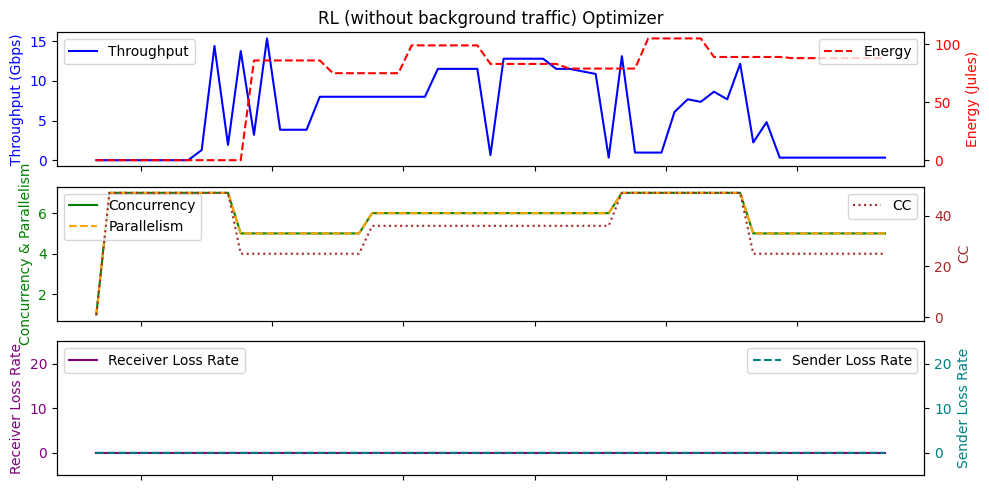

Average Throughput: 5.775737704918033
Total Energy: 4295.0
Total loss rate: 0.002205008507718673
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-25 22:56:22.883736        0.00          0.0   1    0.0   0.0   
1  2024-01-25 22:56:23.878792        0.00          0.0  49    0.0   0.0   
2  2024-01-25 22:56:24.877850        0.00          0.0  49    0.0  32.7   
3  2024-01-25 22:56:25.878925        0.00          0.0  49    0.0  32.7   
4  2024-01-25 22:56:26.881439        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-25 22:57:18.933433        0.96          0.0  36    1.0  32.7   
57 2024-01-25 22:57:19.933135        0.96          0.0  36    1.0  32.7   
58 2024-01-25 22:57:20.934973        0.96          0.0  36    1.0  32.7   
59 2024-01-25 22:57:21.935185        0.96          0.0  36    1.0  32.9   
60 2024-01-25 22:57:22.939799        0.96          0.0  36    1.0  32.8   

  

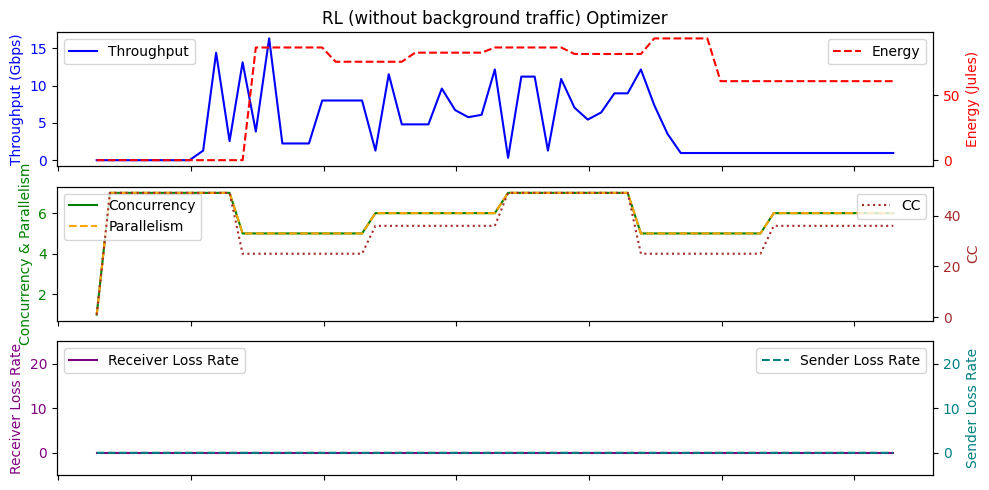

Average Throughput: 4.406557377049179
Total Energy: 3814.0
Total loss rate: 0.001832903617584054
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-25 21:45:31.013411        0.00          0.0   1    0.0   0.0   
1   2024-01-25 21:45:32.009083        0.00          0.0  49    0.0   0.0   
2   2024-01-25 21:45:33.008783        0.00          0.0  49    0.0  32.6   
3   2024-01-25 21:45:34.009667        0.00          0.0  49    0.0  32.7   
4   2024-01-25 21:45:35.012227        0.00          0.0  49    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
495 2024-01-25 21:53:46.531532        0.32          0.0  25    0.0  32.8   
496 2024-01-25 21:53:47.531455        0.32          0.0  25    0.0  32.7   
497 2024-01-25 21:53:48.532363        0.32          0.0  25    0.0  32.7   
498 2024-01-25 21:53:49.534407        0.32          0.0  25    0.0  32.7   
499 2024-01-25 21:53:50.534260        0.32          0.0  25    0.0 

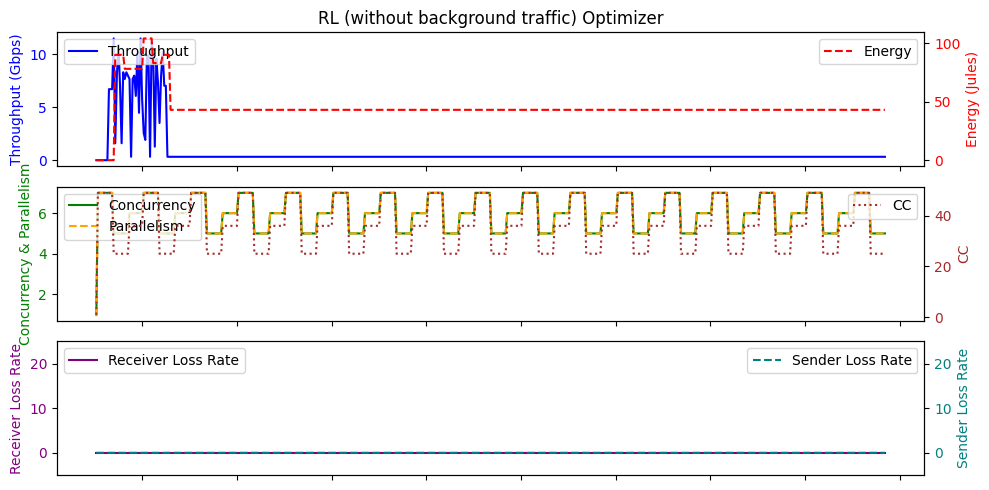

In [ ]:
# Example usage RL
directory = './logFileDir_simu_wo_bg/PPO/'
dfs = process_log_files(directory,"PPO_logFile_")

ppo_throughput_list=[]
ppo_energy_list=[]
ppo_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 5), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    ppo_throughput_list.append(average_throughput)
    ppo_energy_list.append(total_energy)
    ppo_plr_list.append(total_plr)


                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:00:24.320279        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:00:25.315369        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:00:26.318000        0.00          0.0  49    0.0  32.7   
3  2024-01-26 04:00:27.317677        0.00          0.0  49    0.0  32.6   
4  2024-01-26 04:00:28.318611        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:01:20.370866        4.16          0.0  49    4.0  32.9   
57 2024-01-26 04:01:21.373765        4.16          0.0  49    4.0  32.9   
58 2024-01-26 04:01:22.374463        4.16          0.0  49    4.0  32.9   
59 2024-01-26 04:01:23.376725        4.16          0.0  49    4.0  32.8   
60 2024-01-26 04:01:24.378794        4.16          0.0  49    4.0  32.8   

    Energy  sender_lr  concurrency  parallelism  
0      0.0        0.0            7            7  

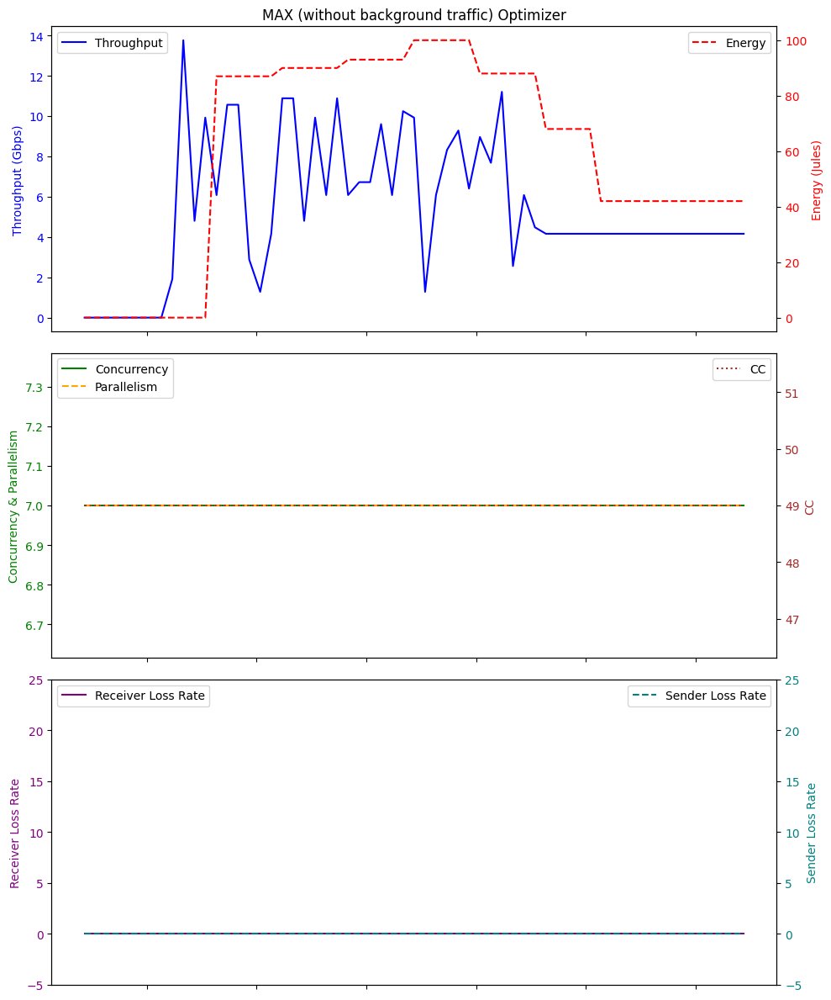

Average Throughput: 5.3455737704918045
Total Energy: 3676.0
Total loss rate: 0.0028524438348143224
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:11:54.588893        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:11:55.587786        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:11:56.587609        0.00          0.0  49    0.0  32.7   
3  2024-01-26 03:11:57.587230        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:11:58.590646        0.00          0.0  49    0.0  32.7   
5  2024-01-26 03:11:59.590878        0.00          0.0  49    0.0  32.6   
6  2024-01-26 03:12:00.621008        0.00          0.0  49    0.0  32.6   
7  2024-01-26 03:12:01.585634        0.00          0.0  49    0.0  32.7   
8  2024-01-26 03:12:02.585990        0.96          0.0  49    1.0  32.8   
9  2024-01-26 03:12:03.598003       14.72          0.0  49   13.0  32.9   
10 2024-01-26 03:12:04.587934        9.92          0.0  49    9.0  36.2   
1

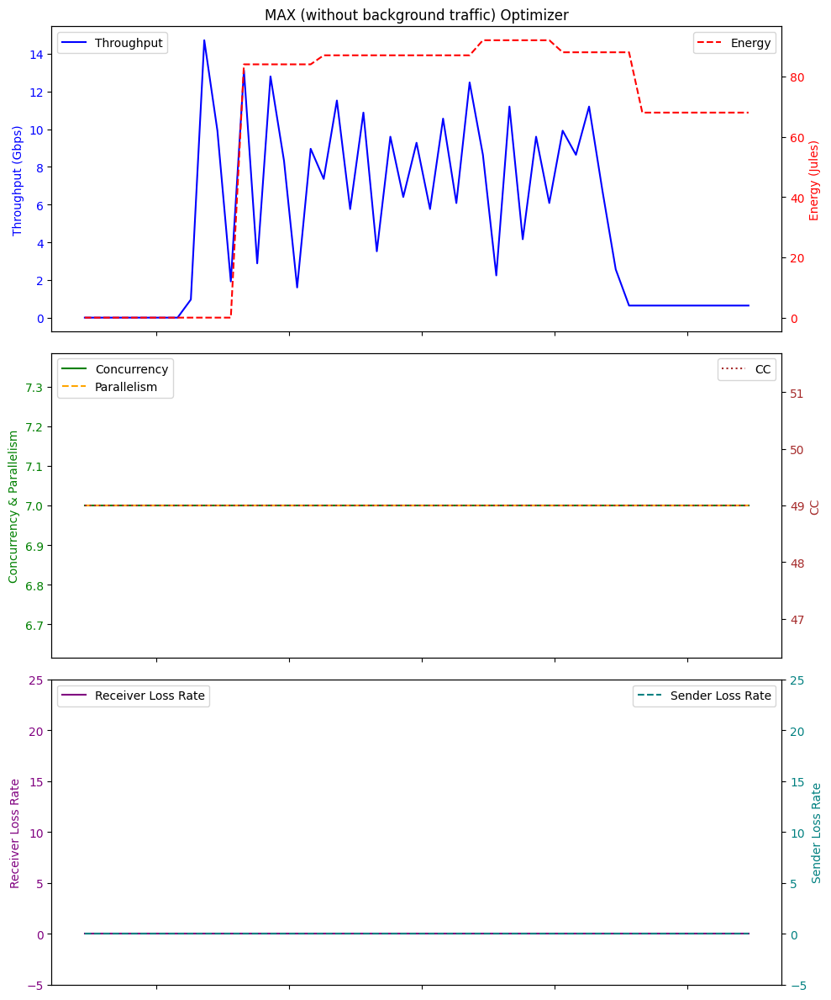

Average Throughput: 5.132549019607843
Total Energy: 3240.0
Total loss rate: 0.0016025695611027965
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:44:52.890087        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:44:53.885684        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:44:54.885666        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:44:55.887491        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:44:56.889220        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:45:48.938098        0.32          0.0  49    0.0  32.7   
57 2024-01-26 03:45:49.937955        0.32          0.0  49    0.0  32.6   
58 2024-01-26 03:45:50.940248        0.32          0.0  49    0.0  32.8   
59 2024-01-26 03:45:51.941739        0.32          0.0  49    0.0  32.8   
60 2024-01-26 03:45:52.941930        0.32          0.0  49    0.0  32.7   

 

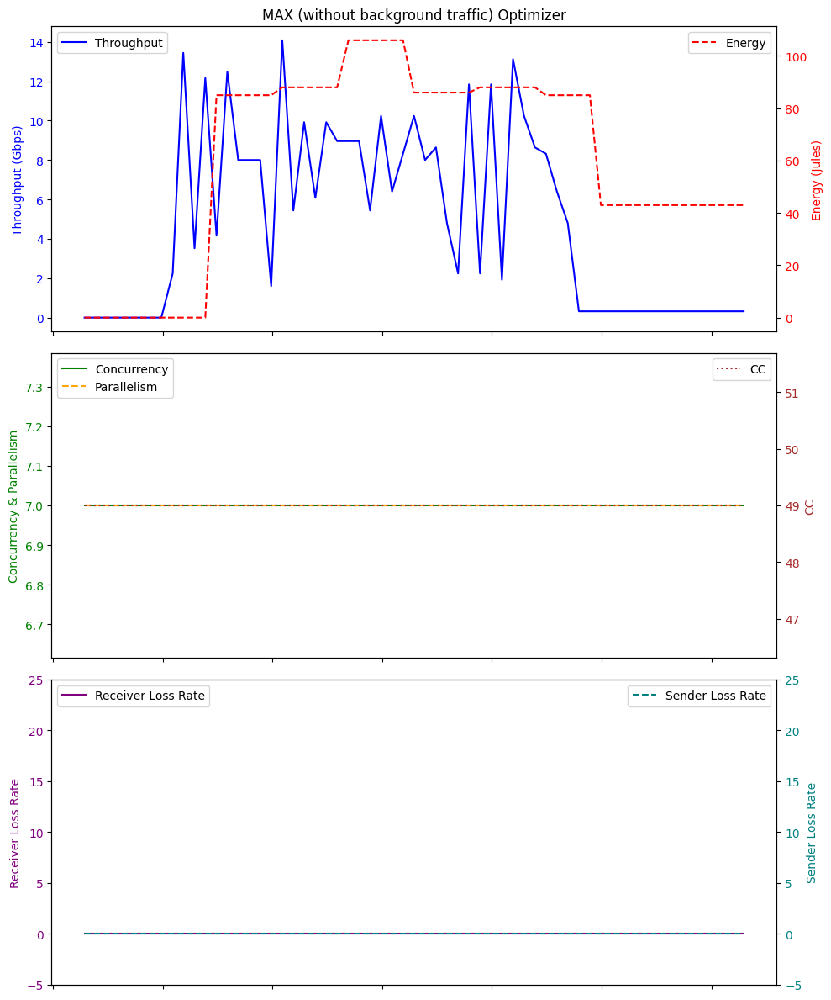

Average Throughput: 4.831475409836065
Total Energy: 3745.0
Total loss rate: 0.001873241362721246
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:54:13.642426        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:54:14.637564        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:54:15.640297        0.00          0.0  49    0.0  32.7   
3  2024-01-26 01:54:16.639966        0.00          0.0  49    0.0  32.6   
4  2024-01-26 01:54:17.640775        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 01:55:09.691415        0.64          0.0  49    1.0  32.7   
57 2024-01-26 01:55:10.692692        0.64          0.0  49    1.0  32.6   
58 2024-01-26 01:55:11.693190        0.64          0.0  49    1.0  32.7   
59 2024-01-26 01:55:12.696563        0.64          0.0  49    1.0  32.7   
60 2024-01-26 01:55:13.696322        0.64          0.0  49    1.0  32.7   

  

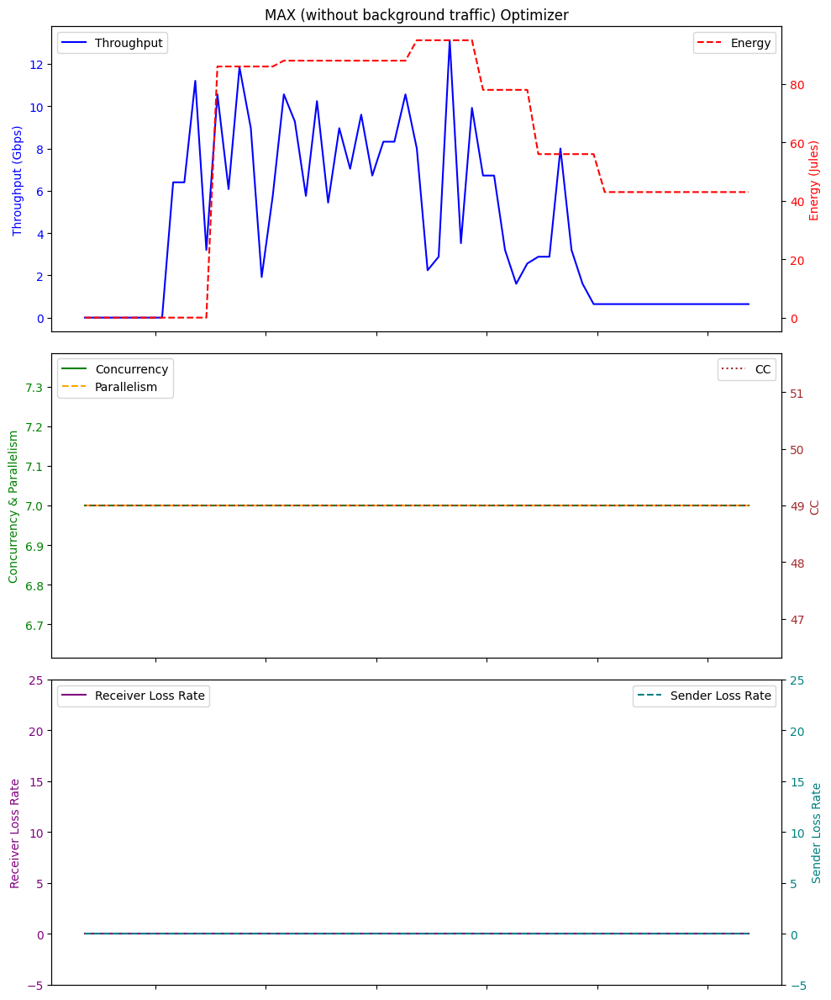

Average Throughput: 4.291147540983605
Total Energy: 3470.0
Total loss rate: 0.016090469622481906
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:55:30.613371        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:55:31.608554        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:55:32.608683        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:55:33.610808        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:55:34.611799        0.00          0.0  49    0.0  32.7   
5  2024-01-26 03:55:35.611145        0.00          0.0  49    0.0  32.7   
6  2024-01-26 03:55:36.605802        0.00          0.0  49    0.0  32.6   
7  2024-01-26 03:55:37.616113        0.00          0.0  49    0.0  33.0   
8  2024-01-26 03:55:38.606353       11.20          0.0  49   10.0  35.7   
9  2024-01-26 03:55:39.639832        0.32          0.0  49    0.0  33.5   
10 2024-01-26 03:55:40.611330       10.88          0.0  49    9.0  33.2   
11 

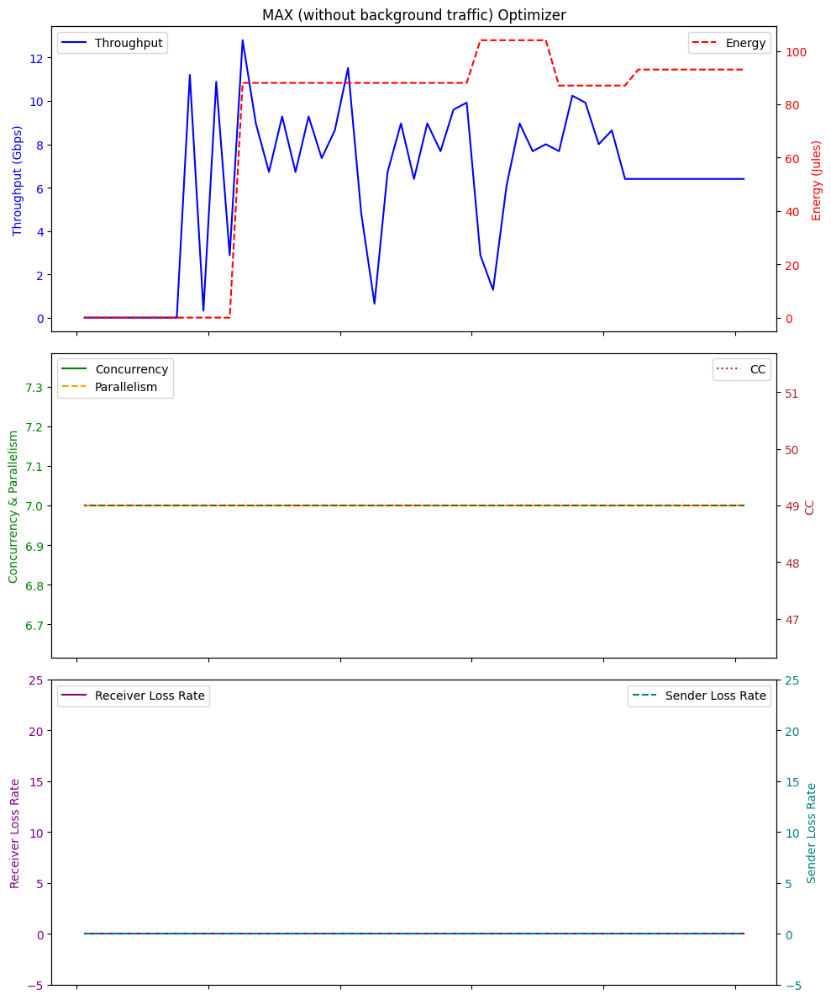

Average Throughput: 6.149019607843136
Total Energy: 3567.0
Total loss rate: 0.002958774807720123
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:56:54.508643        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:56:55.506162        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:56:56.505454        0.00          0.0  49    0.0  32.6   
3  2024-01-26 02:56:57.506573        0.00          0.0  49    0.0  32.6   
4  2024-01-26 02:56:58.508553        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 02:57:50.560516        0.64          0.0  49    1.0  32.6   
57 2024-01-26 02:57:51.561206        0.64          0.0  49    1.0  32.7   
58 2024-01-26 02:57:52.564518        0.64          0.0  49    1.0  32.6   
59 2024-01-26 02:57:53.564855        0.64          0.0  49    1.0  32.8   
60 2024-01-26 02:57:54.565330        0.64          0.0  49    1.0  32.7   

  

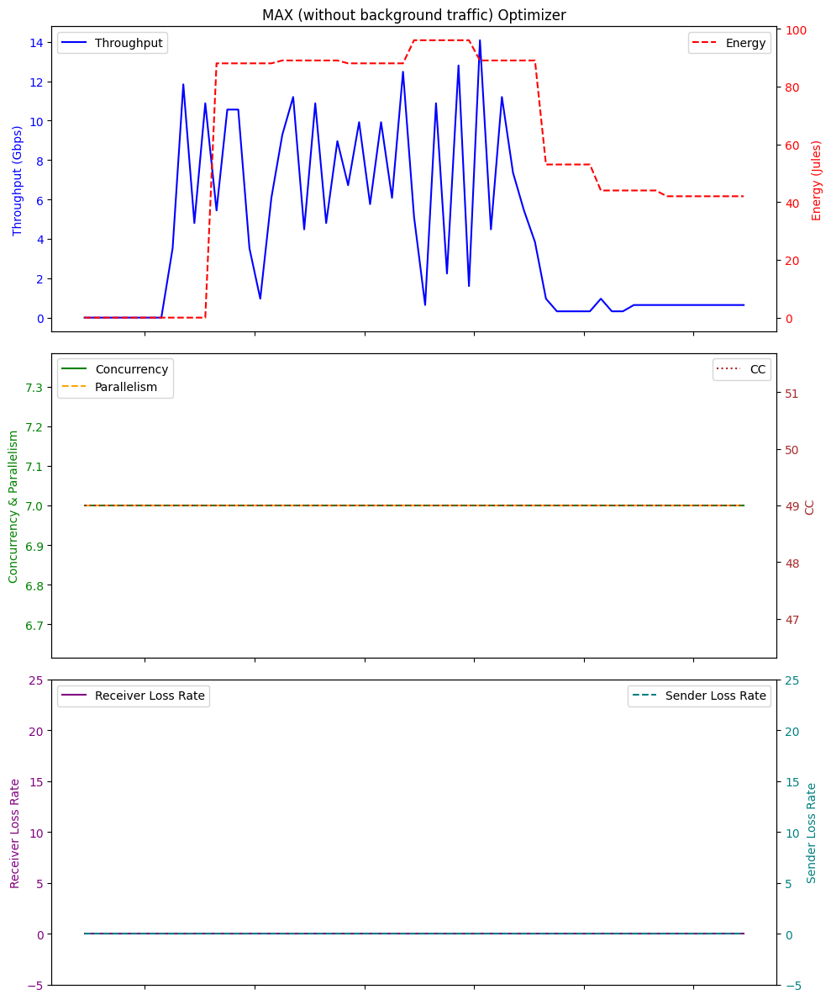

Average Throughput: 4.249180327868851
Total Energy: 3565.0
Total loss rate: 0.003919500452407119
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:21:08.187761        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:21:09.185990        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:21:10.186452        0.00          0.0  49    0.0  32.7   
3  2024-01-26 02:21:11.186187        0.00          0.0  49    0.0  32.7   
4  2024-01-26 02:21:12.188240        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 02:22:04.238127        1.92          0.0  49    2.0  32.6   
57 2024-01-26 02:22:05.238577        1.92          0.0  49    2.0  32.7   
58 2024-01-26 02:22:06.238472        1.92          0.0  49    2.0  32.7   
59 2024-01-26 02:22:07.240832        1.92          0.0  49    2.0  32.6   
60 2024-01-26 02:22:08.241985        1.92          0.0  49    2.0  32.6   

  

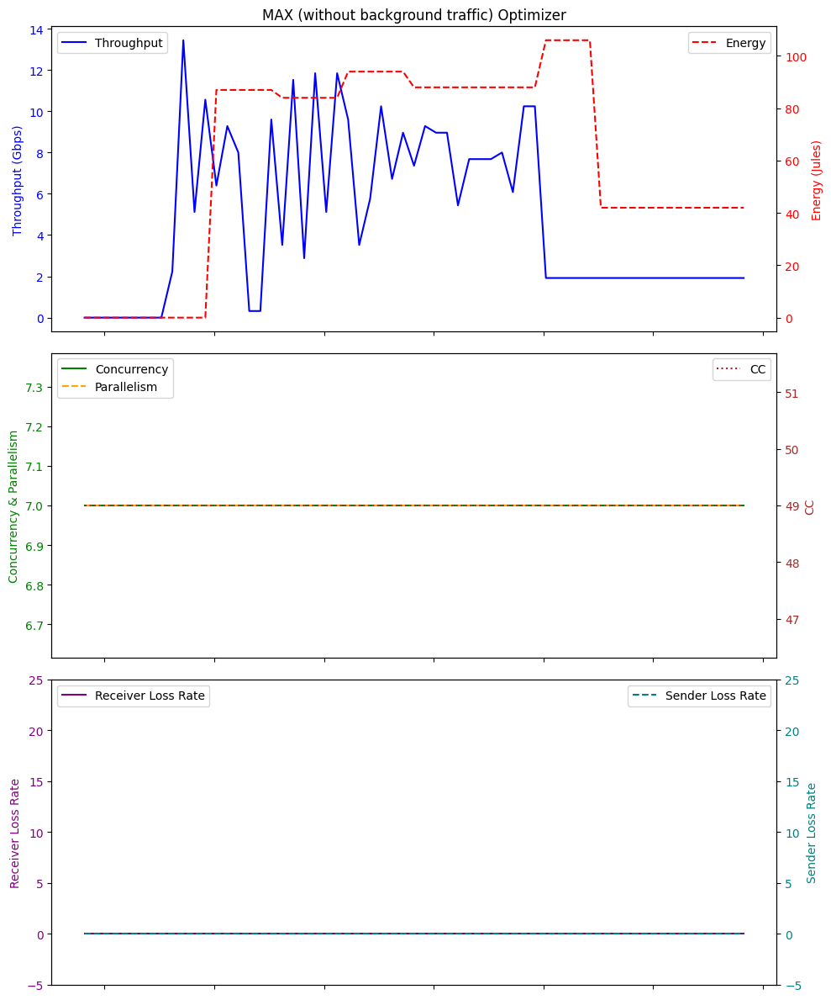

Average Throughput: 4.768524590163937
Total Energy: 3764.0
Total loss rate: 0.0018829793699934973
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:32:49.884767        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:32:50.879402        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:32:51.877292        0.00          0.0  49    0.0  32.7   
3  2024-01-26 01:32:52.881449        0.00          0.0  49    0.0  32.7   
4  2024-01-26 01:32:53.883425        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 01:33:45.931298        0.32          0.0  49    0.0  32.6   
57 2024-01-26 01:33:46.934549        0.32          0.0  49    0.0  32.7   
58 2024-01-26 01:33:47.934026        0.32          0.0  49    0.0  32.7   
59 2024-01-26 01:33:48.934388        0.32          0.0  49    0.0  32.7   
60 2024-01-26 01:33:49.934844        0.32          0.0  49    0.0  32.7   

 

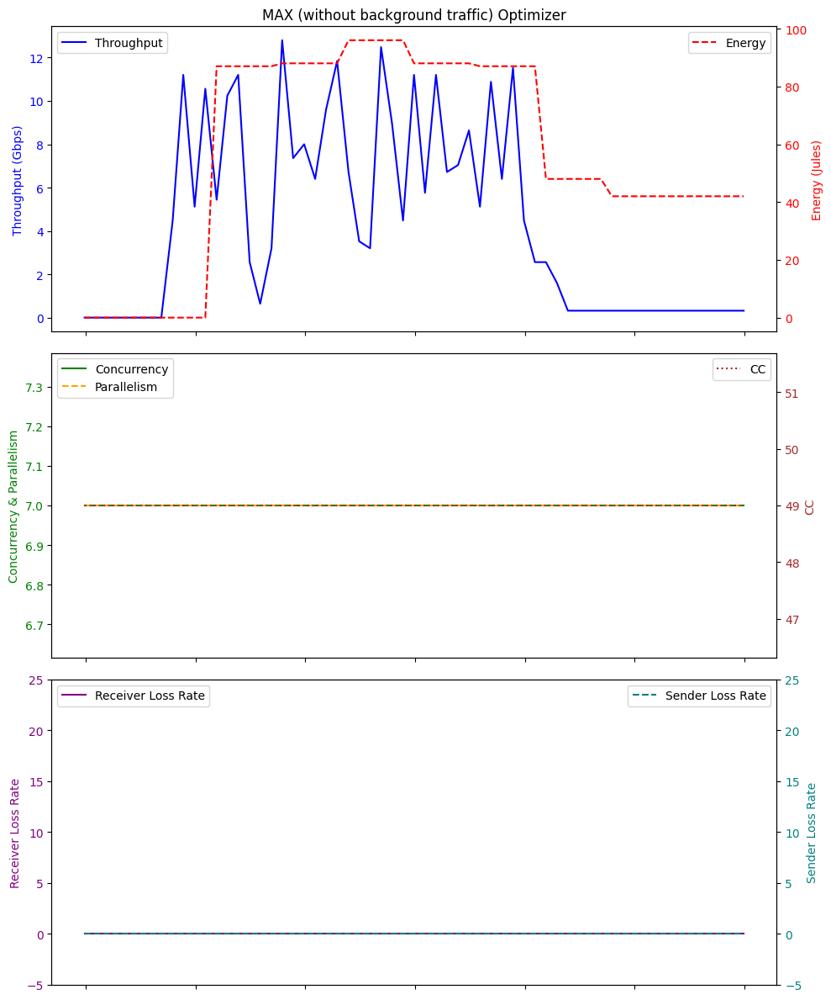

Average Throughput: 4.280655737704917
Total Energy: 3510.0
Total loss rate: 0.0035870658312584574
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:32:43.964084        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:32:44.957979        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:32:45.960966        0.00          0.0  49    0.0  32.6   
3  2024-01-26 02:32:46.958640        0.00          0.0  49    0.0  32.6   
4  2024-01-26 02:32:47.961429        0.00          0.0  49    0.0  32.6   
5  2024-01-26 02:32:48.962997        0.00          0.0  49    0.0  32.6   
6  2024-01-26 02:32:49.955900        0.00          0.0  49    0.0  32.7   
7  2024-01-26 02:32:50.968626        0.00          0.0  49    0.0  32.9   
8  2024-01-26 02:32:51.957615       12.80          0.0  49   11.0  35.9   
9  2024-01-26 02:32:52.971149        0.64          0.0  49    1.0  33.2   
10 2024-01-26 02:32:53.960355       12.80          0.0  49   11.0  38.2   
11

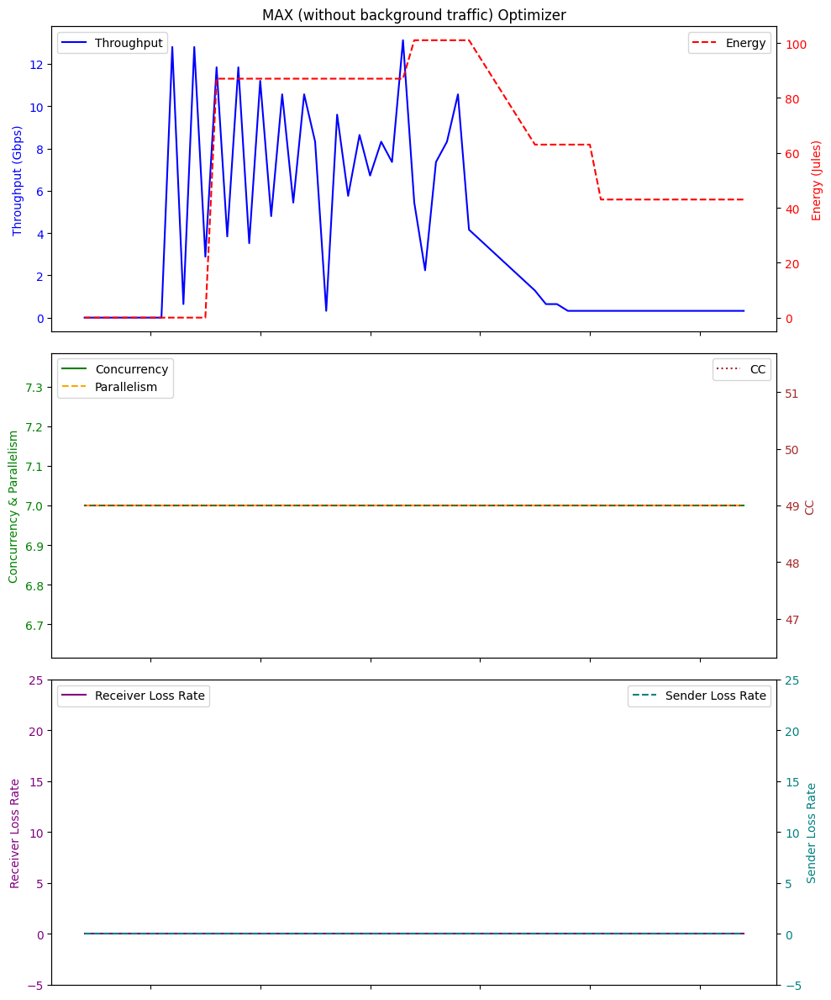

Average Throughput: 3.874285714285714
Total Energy: 3152.0
Total loss rate: 0.0017307428246521963
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:11:02.796213        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:11:03.794301        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:11:04.793963        0.00          0.0  49    0.0  32.7   
3  2024-01-26 02:11:05.794199        0.00          0.0  49    0.0  32.7   
4  2024-01-26 02:11:06.797069        0.00          0.0  49    0.0  32.6   
5  2024-01-26 02:11:07.797181        0.00          0.0  49    0.0  32.6   
6  2024-01-26 02:11:08.791407        0.00          0.0  49    0.0  32.7   
7  2024-01-26 02:11:09.801988        0.00          0.0  49    0.0  33.0   
8  2024-01-26 02:11:10.793246       12.80          0.0  49   11.0  35.9   
9  2024-01-26 02:11:11.807443        0.64          0.0  49    1.0  33.4   
10 2024-01-26 02:11:12.798880       13.44          0.0  49   12.0  36.0   
11

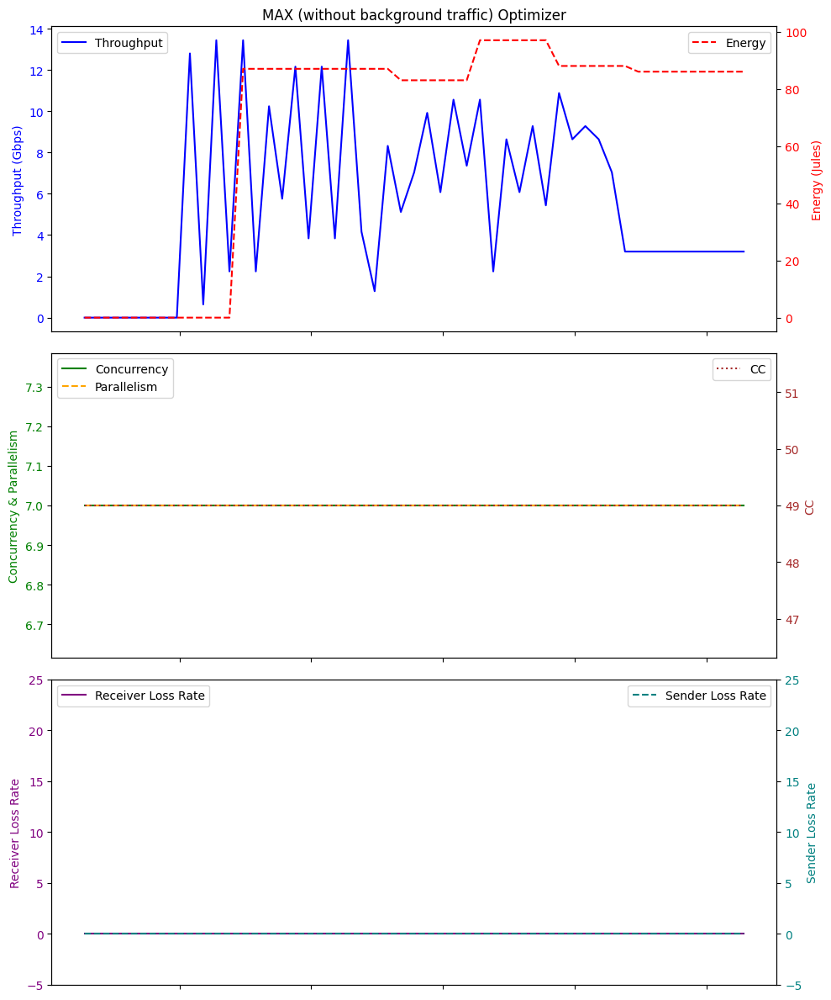

Average Throughput: 5.584313725490197
Total Energy: 3426.0
Total loss rate: 0.002877603806831926
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:01:47.399758        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:01:48.394504        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:01:49.394307        0.00          0.0  49    0.0  32.7   
3  2024-01-26 03:01:50.395533        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:01:51.398805        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:02:43.448712        0.64          0.0  49    1.0  32.7   
57 2024-01-26 03:02:44.448922        0.64          0.0  49    1.0  32.7   
58 2024-01-26 03:02:45.447951        0.64          0.0  49    1.0  32.7   
59 2024-01-26 03:02:46.451119        0.64          0.0  49    1.0  32.7   
60 2024-01-26 03:02:47.450834        0.64          0.0  49    1.0  32.7   

  

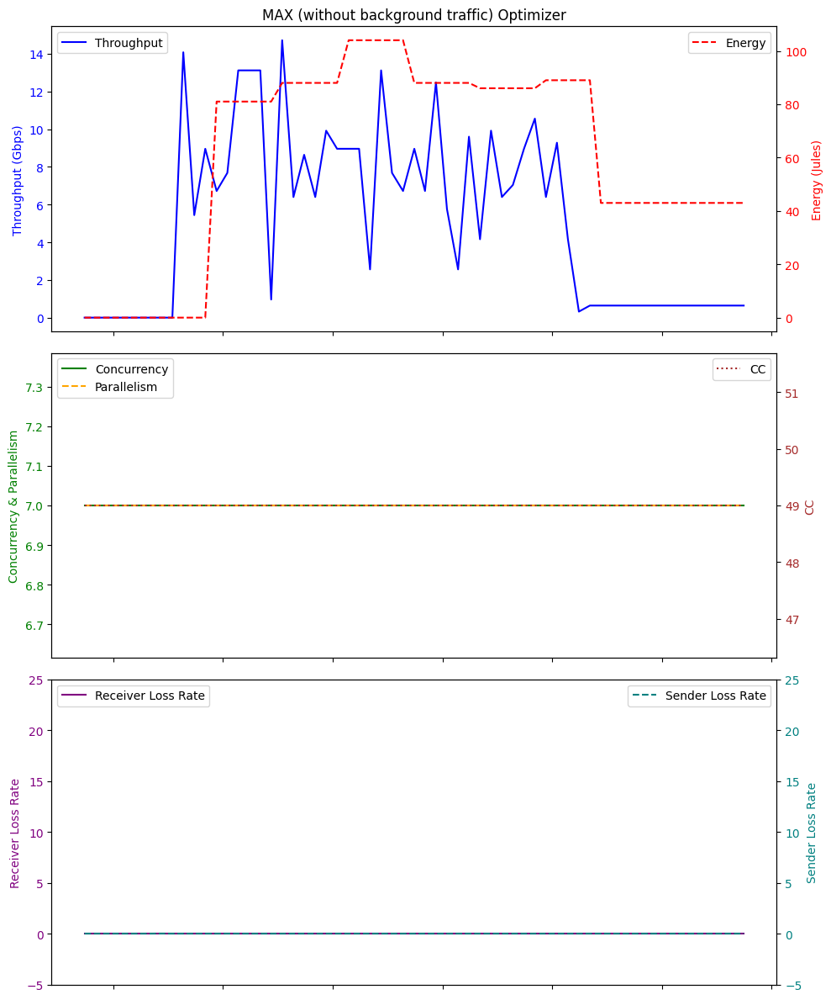

Average Throughput: 5.0675409836065555
Total Energy: 3729.0
Total loss rate: 0.008865880841843782
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:59:33.694360        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:59:34.691159        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:59:35.692947        0.00          0.0  49    0.0  32.6   
3  2024-01-26 01:59:36.693744        0.00          0.0  49    0.0  32.7   
4  2024-01-26 01:59:37.694558        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 02:00:29.748600        2.56          0.0  49    2.0  32.7   
57 2024-01-26 02:00:30.748548        2.56          0.0  49    2.0  32.6   
58 2024-01-26 02:00:31.747977        2.56          0.0  49    2.0  32.7   
59 2024-01-26 02:00:32.751756        2.56          0.0  49    2.0  32.7   
60 2024-01-26 02:00:33.752033        2.56          0.0  49    2.0  32.7   

 

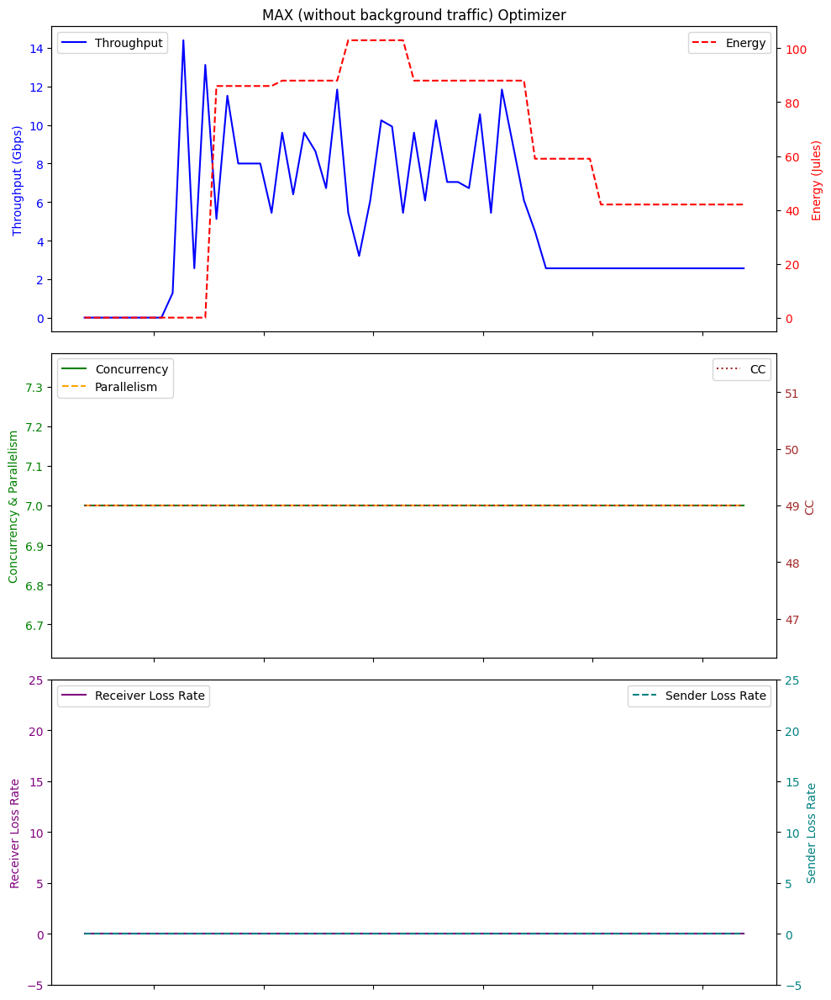

Average Throughput: 5.135737704918033
Total Energy: 3572.0
Total loss rate: 0.00127257137132533
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:39:18.729727        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:39:19.725528        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:39:20.725217        0.00          0.0  49    0.0  32.8   
3  2024-01-26 03:39:21.727260        0.00          0.0  49    0.0  32.7   
4  2024-01-26 03:39:22.730603        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:40:14.783500        0.32          0.0  49    0.0  32.7   
57 2024-01-26 03:40:15.783086        0.32          0.0  49    0.0  32.6   
58 2024-01-26 03:40:16.783186        0.32          0.0  49    0.0  32.8   
59 2024-01-26 03:40:17.783315        0.32          0.0  49    0.0  32.8   
60 2024-01-26 03:40:18.785456        0.32          0.0  49    0.0  32.8   

   

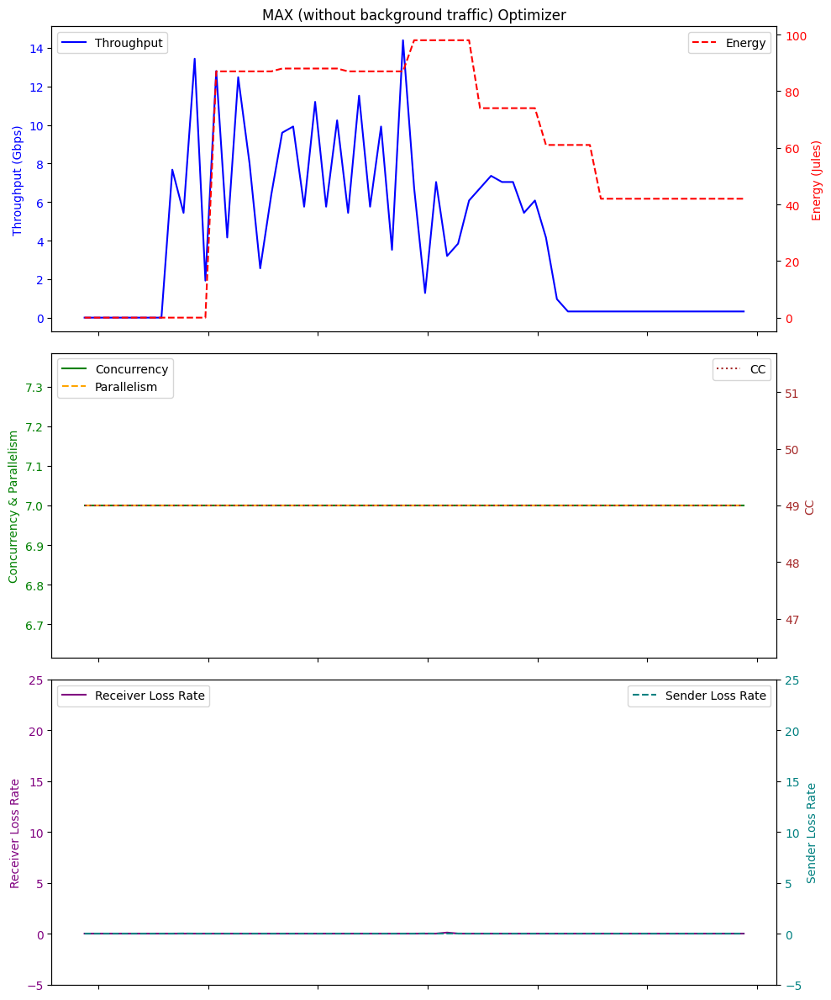

Average Throughput: 4.201967213114754
Total Energy: 3497.0
Total loss rate: 0.03842949362445491
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:34:18.648455        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:34:19.643340        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:34:20.643222        0.00          0.0  49    0.0  32.8   
3  2024-01-26 03:34:21.643270        0.00          0.0  49    0.0  32.9   
4  2024-01-26 03:34:22.646994        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:35:14.696869        0.32          0.0  49    0.0  32.6   
57 2024-01-26 03:35:15.697598        0.32          0.0  49    0.0  32.7   
58 2024-01-26 03:35:16.697315        0.32          0.0  49    0.0  32.7   
59 2024-01-26 03:35:17.697335        0.32          0.0  49    0.0  32.7   
60 2024-01-26 03:35:18.699647        0.32          0.0  49    0.0  32.7   

   

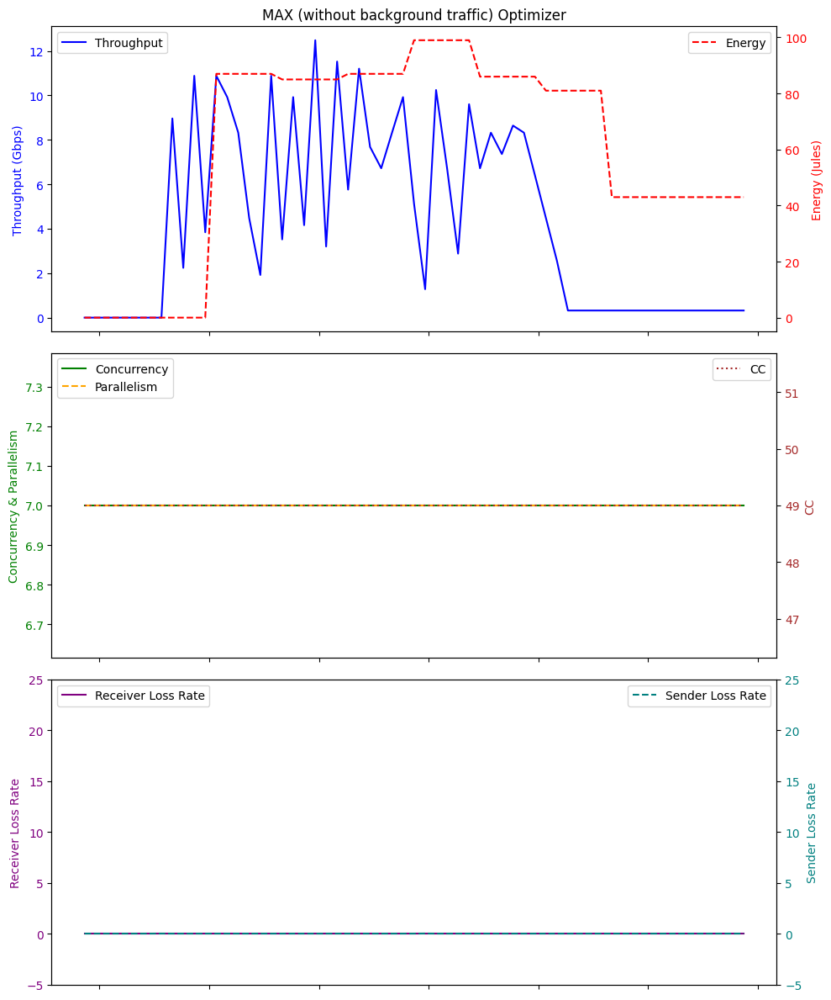

Average Throughput: 4.275409836065573
Total Energy: 3709.0
Total loss rate: 0.014088974117098457
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:47:37.520900        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:47:38.515906        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:47:39.516146        0.00          0.0  49    0.0  32.6   
3  2024-01-26 04:47:40.517341        0.00          0.0  49    0.0  32.8   
4  2024-01-26 04:47:41.518320        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:48:33.569470        2.56          0.0  49    2.0  32.7   
57 2024-01-26 04:48:34.570004        2.56          0.0  49    2.0  32.7   
58 2024-01-26 04:48:35.568786        2.56          0.0  49    2.0  32.8   
59 2024-01-26 04:48:36.570813        2.56          0.0  49    2.0  32.7   
60 2024-01-26 04:48:37.573356        2.56          0.0  49    2.0  32.7   

  

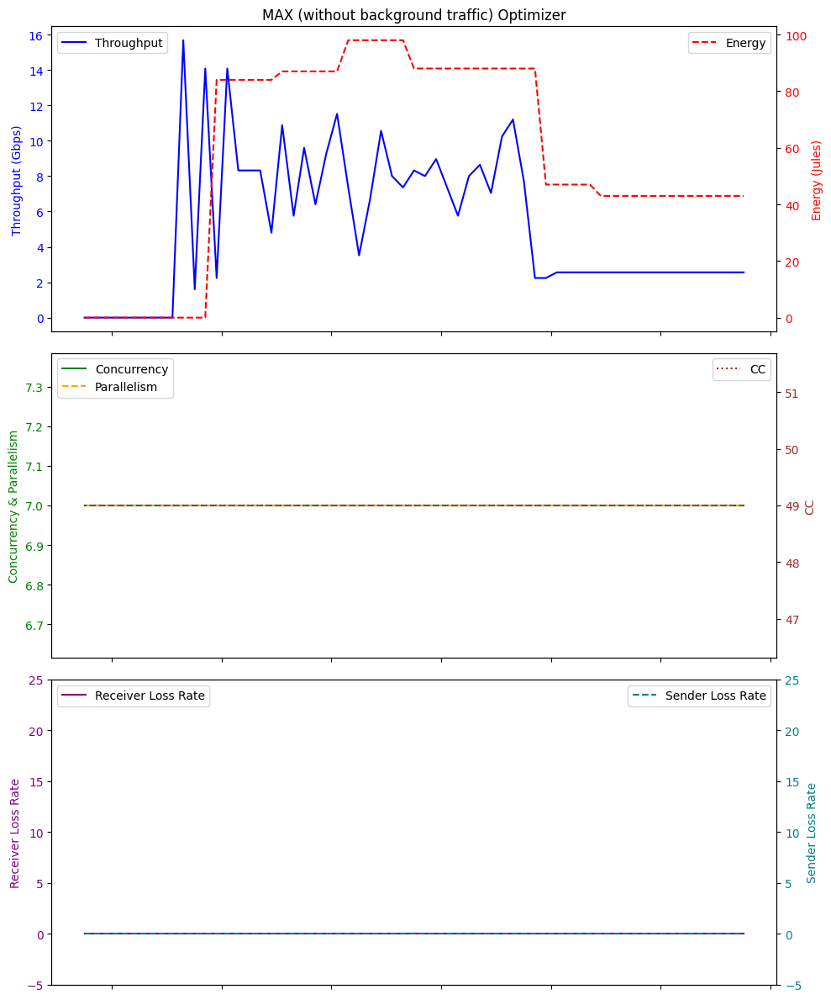

Average Throughput: 5.182950819672132
Total Energy: 3507.0
Total loss rate: 0.011889102518983972
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:05:26.002633        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:05:26.996698        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:05:27.996360        0.00          0.0  49    0.0  32.7   
3  2024-01-26 04:05:29.000240        0.00          0.0  49    0.0  32.6   
4  2024-01-26 04:05:30.002585        0.00          0.0  49    0.0  32.7   
5  2024-01-26 04:05:30.999806        0.00          0.0  49    0.0  32.8   
6  2024-01-26 04:05:32.003747        0.00          0.0  49    0.0  33.1   
7  2024-01-26 04:05:32.996698        0.00          0.0  49    0.0  34.5   
8  2024-01-26 04:05:33.995680        1.28          0.0  49    1.0  32.7   
9  2024-01-26 04:05:34.992847       13.44          0.0  49   12.0  33.0   
10 2024-01-26 04:05:36.007863        9.28          0.0  49    8.0  36.3   
11 

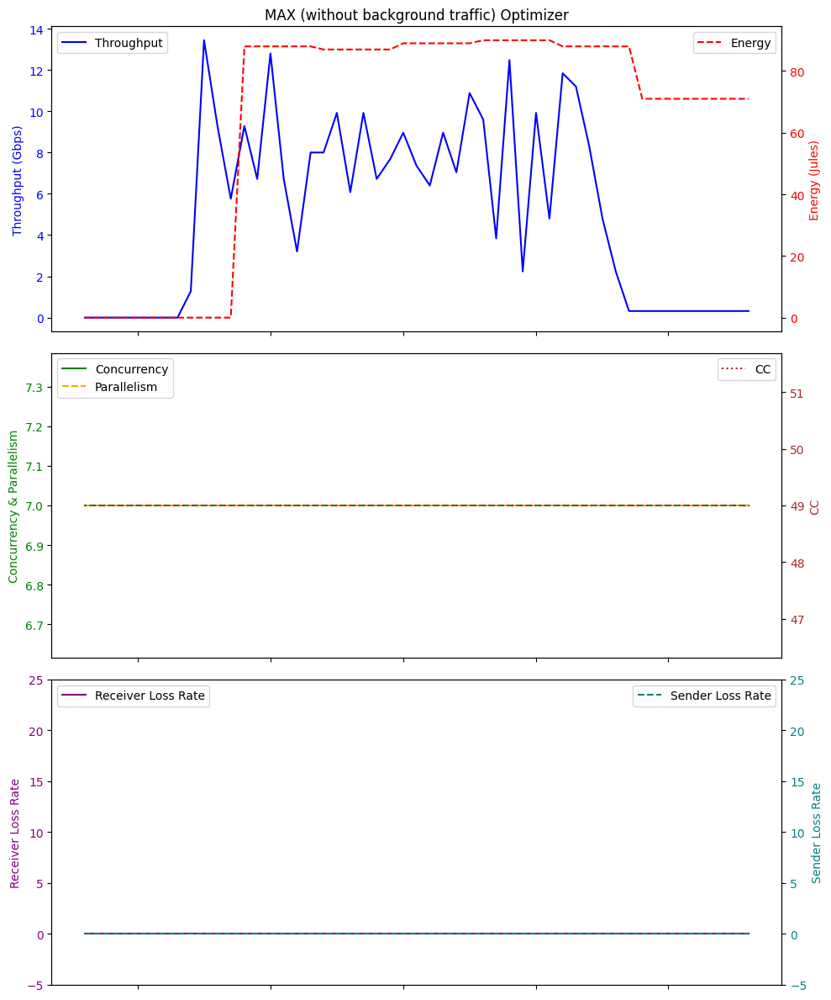

Average Throughput: 5.076078431372549
Total Energy: 3291.0
Total loss rate: 0.01282588675536849
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:16:03.166777        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:16:04.164126        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:16:05.161577        0.00          0.0  49    0.0  32.7   
3  2024-01-26 02:16:06.165970        0.00          0.0  49    0.0  32.7   
4  2024-01-26 02:16:07.165478        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 02:16:59.211587        1.28          0.0  49    1.0  32.7   
57 2024-01-26 02:17:00.215853        1.28          0.0  49    1.0  32.7   
58 2024-01-26 02:17:01.219179        1.28          0.0  49    1.0  32.6   
59 2024-01-26 02:17:02.219765        1.28          0.0  49    1.0  32.6   
60 2024-01-26 02:17:03.219042        1.28          0.0  49    1.0  32.7   

   

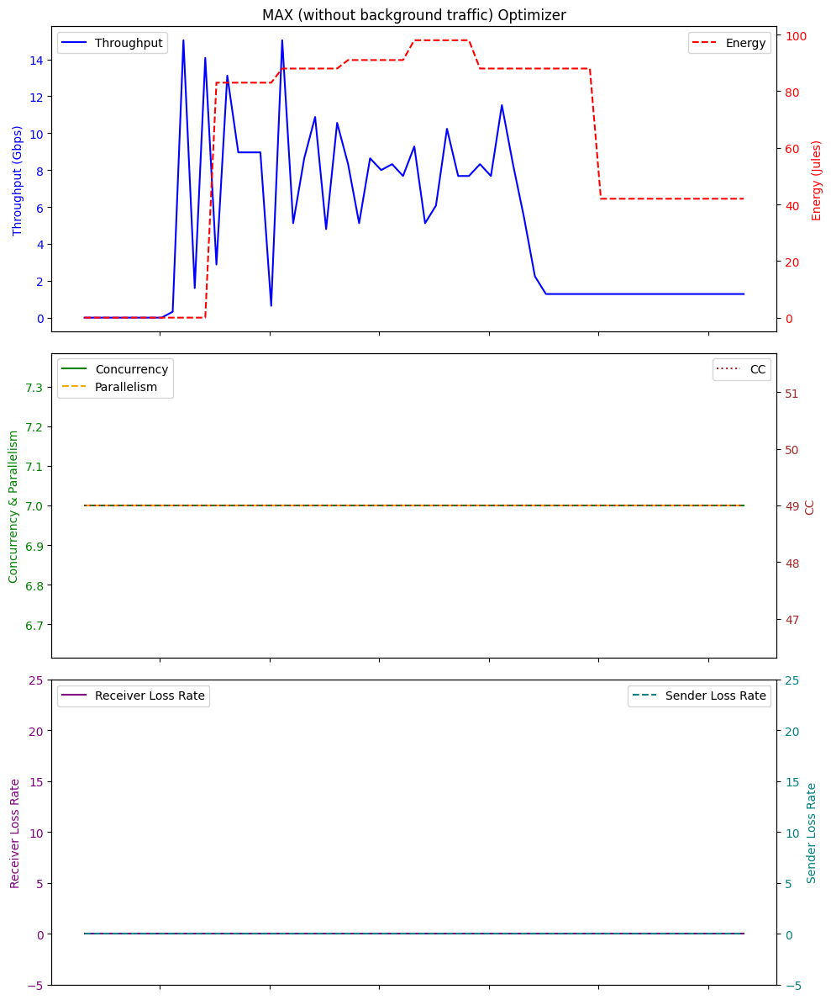

Average Throughput: 4.747540983606556
Total Energy: 3716.0
Total loss rate: 0.00447545572891884
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:24:54.601401        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:24:55.599082        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:24:56.599393        0.00          0.0  49    0.0  32.6   
3  2024-01-26 04:24:57.599841        0.00          0.0  49    0.0  32.6   
4  2024-01-26 04:24:58.601892        0.00          0.0  49    0.0  32.6   
5  2024-01-26 04:24:59.605127        0.00          0.0  49    0.0  32.6   
6  2024-01-26 04:25:00.644747        0.00          0.0  49    0.0  33.5   
7  2024-01-26 04:25:01.612696        0.00          0.0  49    0.0  33.7   
8  2024-01-26 04:25:02.650964        1.28          0.0  49    1.0  32.5   
9  2024-01-26 04:25:03.598859       14.40          0.0  49   13.0  33.3   
10 2024-01-26 04:25:04.601119        2.88          0.0  49    3.0  33.0   
11 2

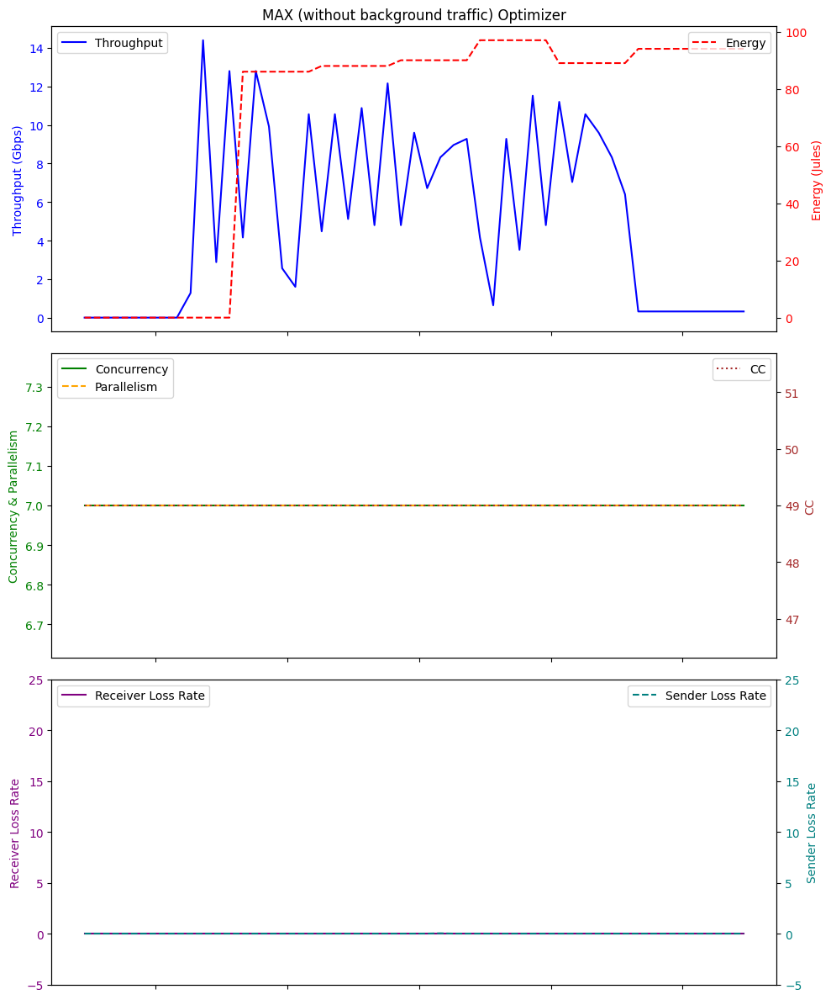

Average Throughput: 5.069803921568628
Total Energy: 3546.0
Total loss rate: 0.032756390680766696
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:50:29.799271        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:50:30.791159        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:50:31.792899        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:50:32.794777        0.00          0.0  49    0.0  33.2   
4  2024-01-26 03:50:33.794864        0.00          0.0  49    0.0  32.6   
5  2024-01-26 03:50:34.794630        0.00          0.0  49    0.0  32.7   
6  2024-01-26 03:50:35.799618        0.00          0.0  49    0.0  32.6   
7  2024-01-26 03:50:36.800295        0.00          0.0  49    0.0  34.4   
8  2024-01-26 03:50:37.799084        8.96          0.0  49    8.0  35.8   
9  2024-01-26 03:50:38.831571        8.96          0.0  49    8.0  34.6   
10 2024-01-26 03:50:39.792460        8.96          0.0  49    0.0  33.2   
11 

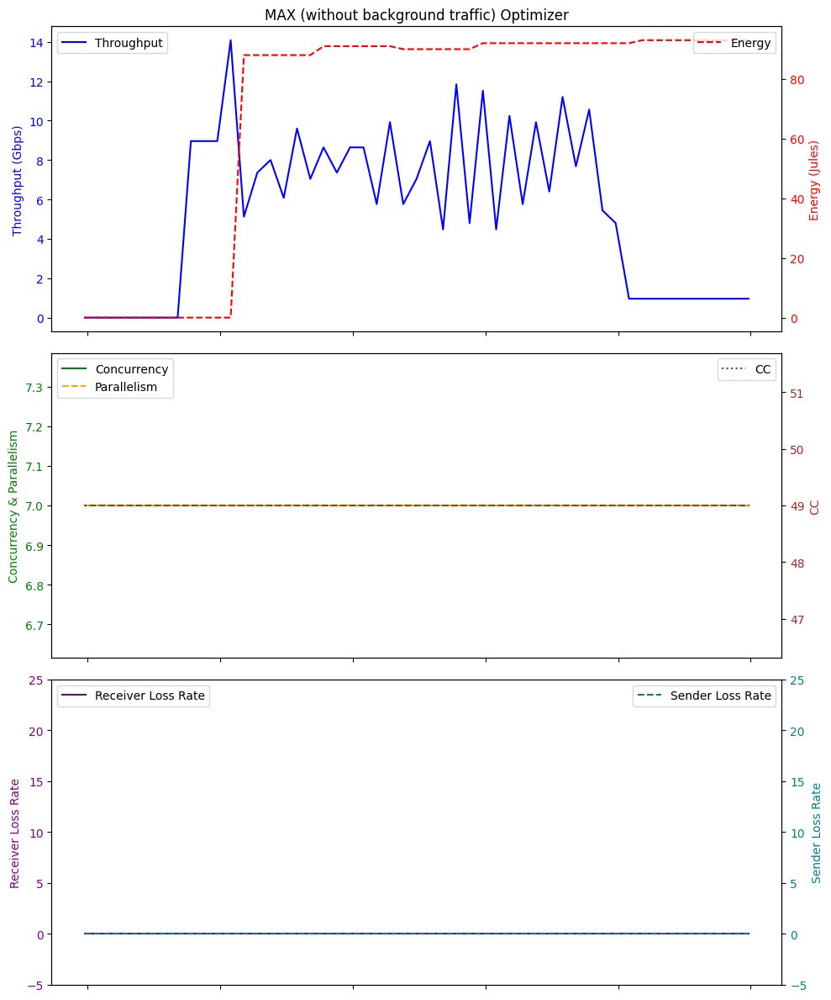

Average Throughput: 5.364705882352941
Total Energy: 3555.0
Total loss rate: 0.003484603570575753
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:37:54.081047        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:37:55.076409        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:37:56.077114        0.00          0.0  49    0.0  32.6   
3  2024-01-26 01:37:57.079561        0.00          0.0  49    0.0  32.6   
4  2024-01-26 01:37:58.079409        0.00          0.0  49    0.0  32.6   
5  2024-01-26 01:37:59.079986        0.00          0.0  49    0.0  32.6   
6  2024-01-26 01:38:00.071314        0.00          0.0  49    0.0  32.5   
7  2024-01-26 01:38:01.084878        0.00          0.0  49    0.0  32.9   
8  2024-01-26 01:38:02.085706        8.64          0.0  49    8.0  34.7   
9  2024-01-26 01:38:03.078680       10.56          0.0  49    9.0  42.2   
10 2024-01-26 01:38:04.079921        0.96          0.0  49    1.0  32.9   
11 

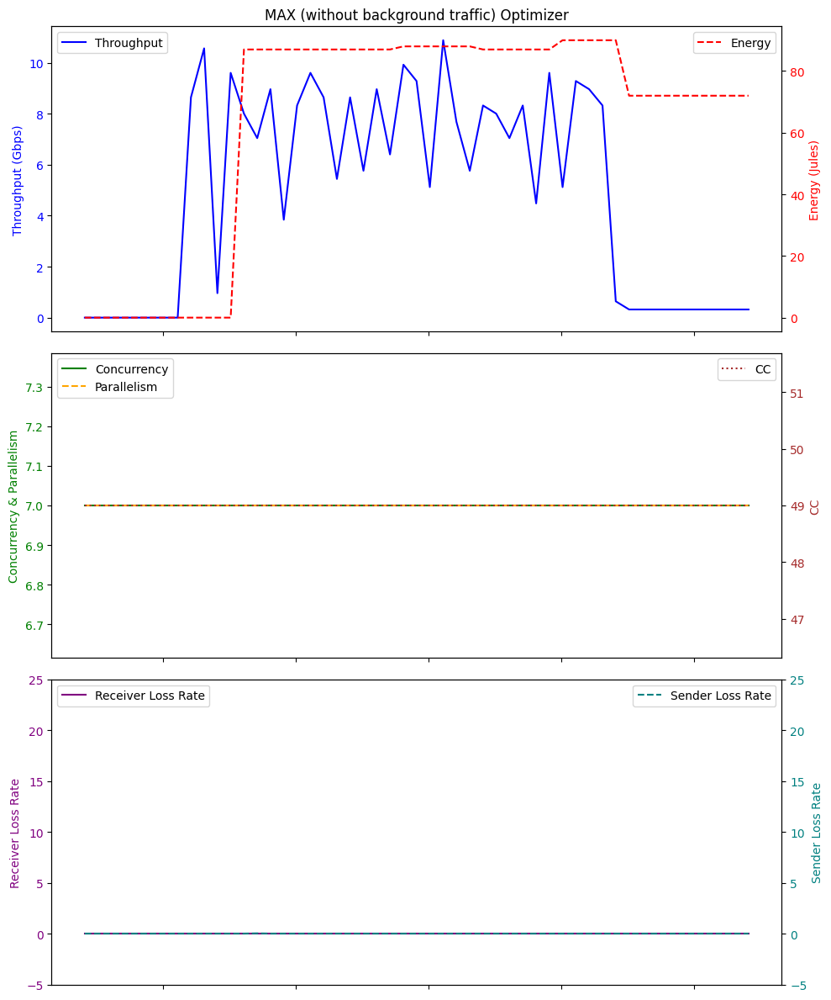

Average Throughput: 4.887843137254902
Total Energy: 3264.0
Total loss rate: 0.025981275442739798
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 02:44:28.749809        0.00          0.0  49    0.0   0.0   
1  2024-01-26 02:44:29.746983        0.00          0.0  49    0.0   0.0   
2  2024-01-26 02:44:30.748025        0.00          0.0  49    0.0  32.6   
3  2024-01-26 02:44:31.747845        0.00          0.0  49    0.0  32.6   
4  2024-01-26 02:44:32.750499        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 02:45:24.802803        1.28          0.0  49    1.0  32.7   
57 2024-01-26 02:45:25.802151        1.28          0.0  49    1.0  32.7   
58 2024-01-26 02:45:26.803180        1.28          0.0  49    1.0  32.7   
59 2024-01-26 02:45:27.805259        1.28          0.0  49    1.0  32.8   
60 2024-01-26 02:45:28.800891        1.28          0.0  49    1.0  32.9   

  

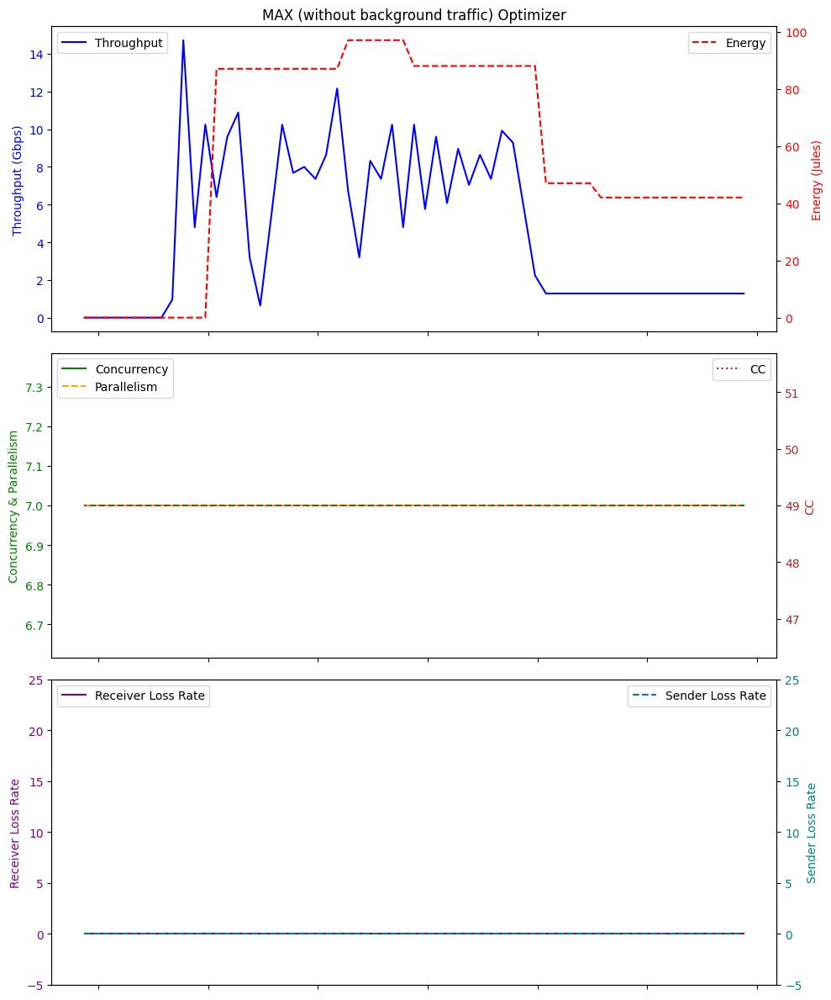

Average Throughput: 4.5377049180327855
Total Energy: 3505.0
Total loss rate: 0.002440610987877392
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:24:23.743731        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:24:24.739619        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:24:25.739070        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:24:26.741140        0.00          0.0  49    0.0  32.6   
4  2024-01-26 03:24:27.742290        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:25:19.791634        2.56          0.0  49    2.0  32.7   
57 2024-01-26 03:25:20.791368        2.56          0.0  49    2.0  32.7   
58 2024-01-26 03:25:21.793694        2.56          0.0  49    2.0  32.7   
59 2024-01-26 03:25:22.795280        2.56          0.0  49    2.0  32.7   
60 2024-01-26 03:25:23.795007        2.56          0.0  49    2.0  32.7   

 

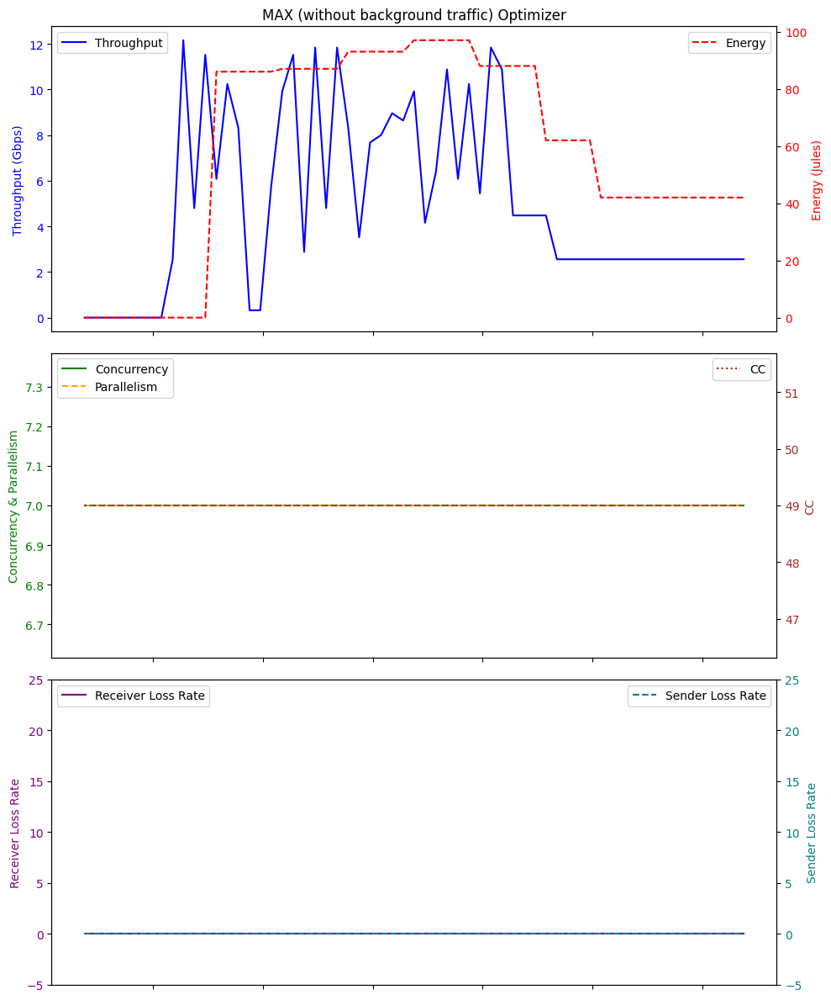

Average Throughput: 4.9154098360655745
Total Energy: 3604.0
Total loss rate: 0.0015355382447040404
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:12:09.232020        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:12:10.230503        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:12:11.231646        0.00          0.0  49    0.0  32.7   
3  2024-01-26 04:12:12.231055        0.00          0.0  49    0.0  32.7   
4  2024-01-26 04:12:13.232159        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:13:05.284332        0.32          0.0  49    0.0  32.7   
57 2024-01-26 04:13:06.284278        0.32          0.0  49    0.0  32.8   
58 2024-01-26 04:13:07.284265        0.32          0.0  49    0.0  32.8   
59 2024-01-26 04:13:08.284891        0.32          0.0  49    0.0  32.6   
60 2024-01-26 04:13:09.286525        0.32          0.0  49    0.0  32.7   



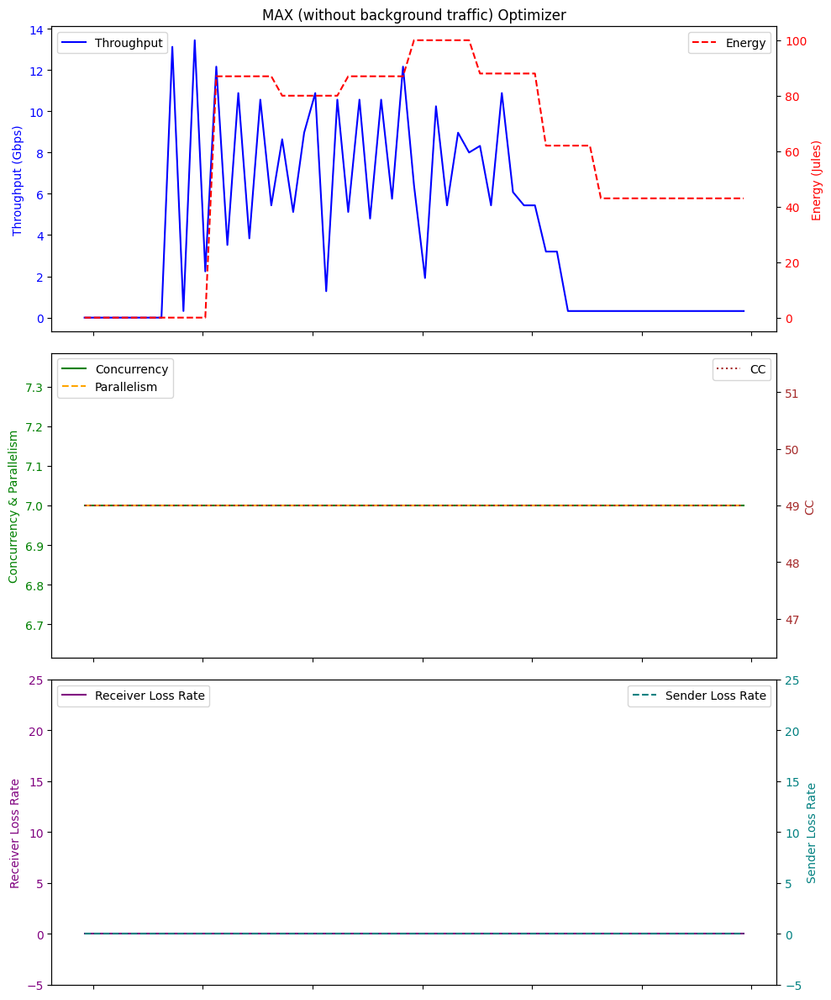

Average Throughput: 4.333114754098361
Total Energy: 3564.0
Total loss rate: 0.0024295445789691847
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:37:19.624871        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:37:20.619600        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:37:21.621794        0.00          0.0  49    0.0  32.8   
3  2024-01-26 04:37:22.622511        0.00          0.0  49    0.0  32.7   
4  2024-01-26 04:37:23.622349        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:38:15.673914        0.32          0.0  49    0.0  32.6   
57 2024-01-26 04:38:16.675972        0.32          0.0  49    0.0  32.6   
58 2024-01-26 04:38:17.676471        0.32          0.0  49    0.0  32.7   
59 2024-01-26 04:38:18.676966        0.32          0.0  49    0.0  32.7   
60 2024-01-26 04:38:19.679558        0.32          0.0  49    0.0  32.7   

 

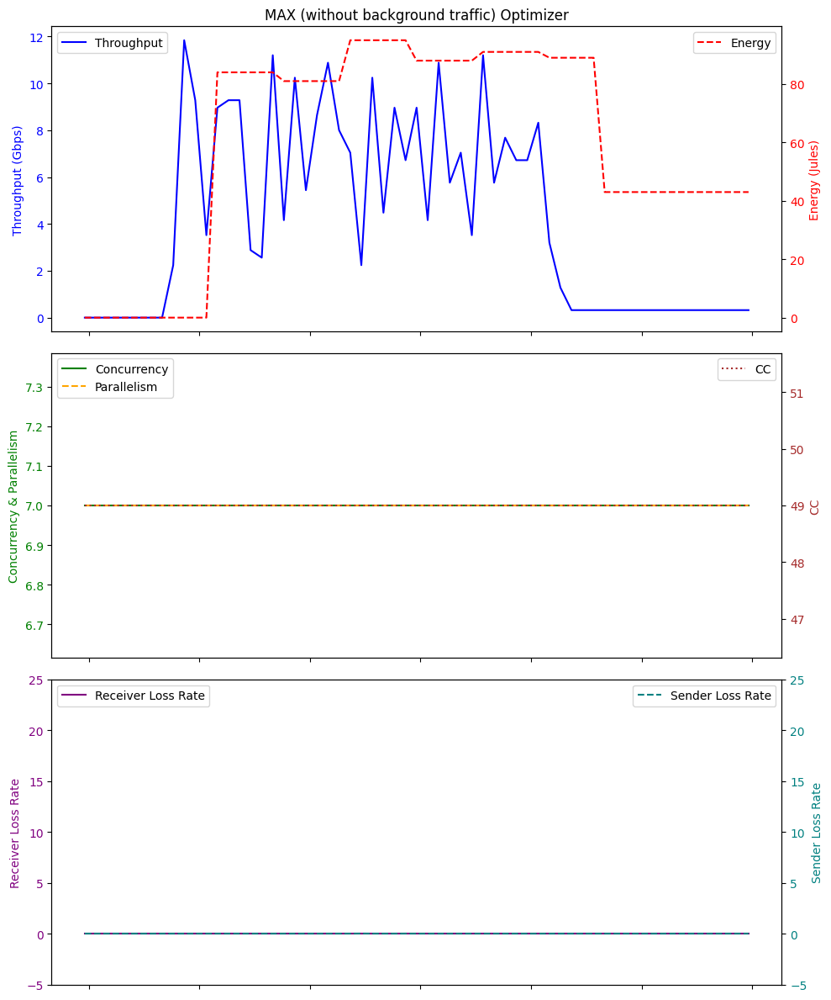

Average Throughput: 4.175737704918032
Total Energy: 3681.0
Total loss rate: 0.00872160020592062
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:29:23.630449        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:29:24.626148        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:29:25.626618        0.00          0.0  49    0.0  32.7   
3  2024-01-26 03:29:26.629204        0.00          0.0  49    0.0  32.6   
4  2024-01-26 03:29:27.628969        0.00          0.0  49    0.0  32.8   
5  2024-01-26 03:29:28.629459        0.00          0.0  49    0.0  32.6   
6  2024-01-26 03:29:29.636154        0.00          0.0  49    0.0  32.6   
7  2024-01-26 03:29:30.638025        0.00          0.0  49    0.0  33.3   
8  2024-01-26 03:29:31.663655        5.76          0.0  49    5.0  35.7   
9  2024-01-26 03:29:32.628635        9.92          0.0  49    9.0  32.9   
10 2024-01-26 03:29:33.674267        6.40          0.0  49    6.0  36.5   
11 2

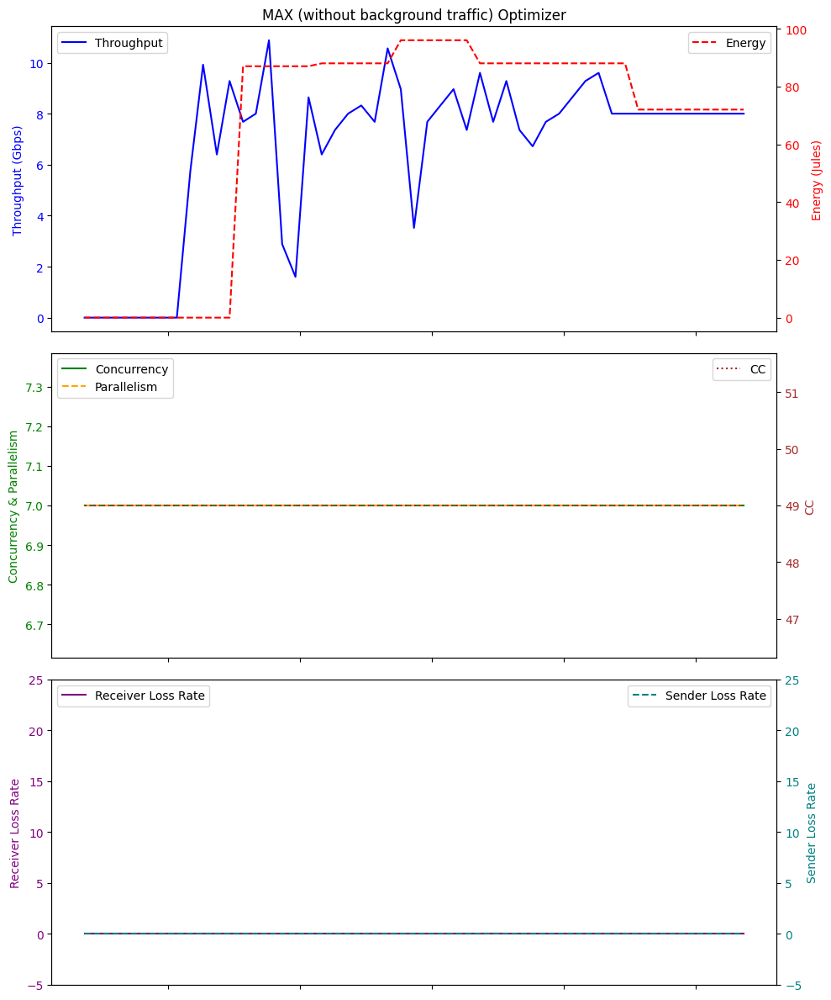

Average Throughput: 6.588235294117647
Total Energy: 3330.0
Total loss rate: 0.009024363212953263
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:42:54.956046        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:42:55.951608        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:42:56.950943        0.00          0.0  49    0.0  32.6   
3  2024-01-26 01:42:57.953315        0.00          0.0  49    0.0  32.6   
4  2024-01-26 01:42:58.953941        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 01:43:51.003303        0.96          0.0  49    1.0  32.7   
57 2024-01-26 01:43:52.004860        0.96          0.0  49    1.0  32.7   
58 2024-01-26 01:43:53.004707        0.96          0.0  49    1.0  32.7   
59 2024-01-26 01:43:54.006012        0.96          0.0  49    1.0  32.8   
60 2024-01-26 01:43:55.008319        0.96          0.0  49    1.0  32.7   

  

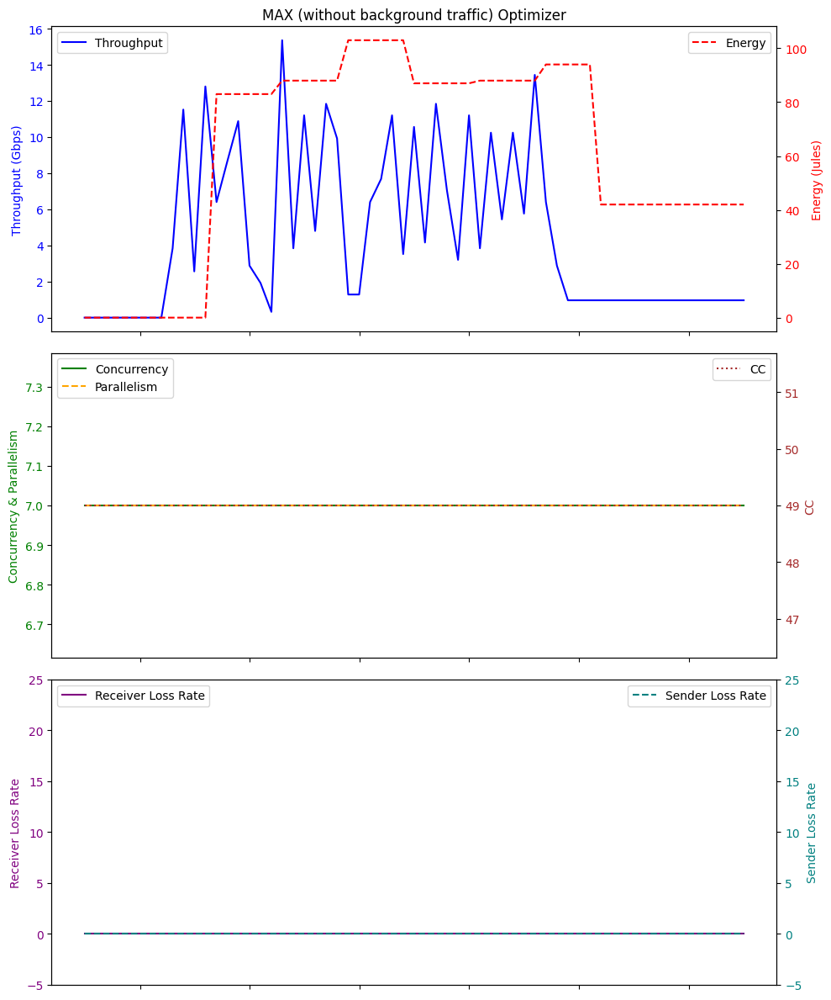

Average Throughput: 4.469508196721311
Total Energy: 3752.0
Total loss rate: 0.004867681127789363
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 03:06:49.415980        0.00          0.0  49    0.0   0.0   
1  2024-01-26 03:06:50.412248        0.00          0.0  49    0.0   0.0   
2  2024-01-26 03:06:51.414710        0.00          0.0  49    0.0  32.6   
3  2024-01-26 03:06:52.414797        0.00          0.0  49    0.0  32.6   
4  2024-01-26 03:06:53.415373        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 03:07:45.465837        0.32          0.0  49    0.0  32.8   
57 2024-01-26 03:07:46.468158        0.32          0.0  49    0.0  32.8   
58 2024-01-26 03:07:47.467895        0.32          0.0  49    0.0  32.7   
59 2024-01-26 03:07:48.468662        0.32          0.0  49    0.0  32.7   
60 2024-01-26 03:07:49.474261        0.32          0.0  49    0.0  32.7   

  

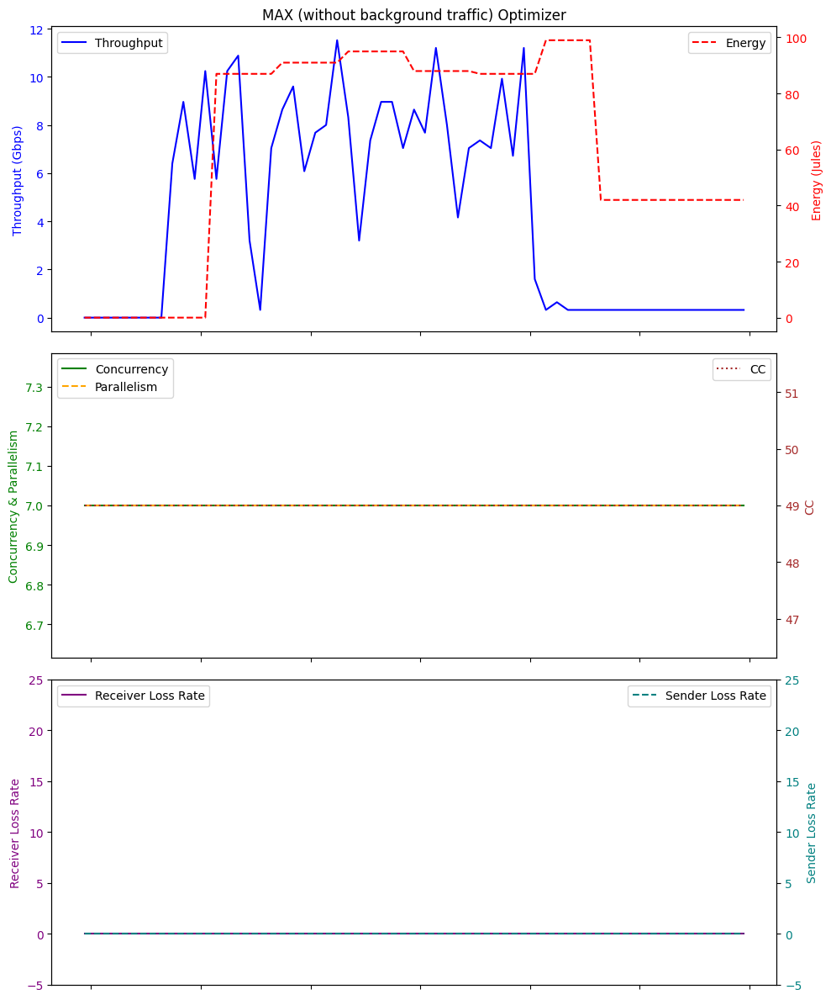

Average Throughput: 4.280655737704917
Total Energy: 3771.0
Total loss rate: 0.006194204748020432
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 01:21:15.296393        0.00          0.0  49    0.0   0.0   
1  2024-01-26 01:21:16.290081        0.00          0.0  49    0.0   0.0   
2  2024-01-26 01:21:17.291367        0.00          0.0  49    0.0  32.6   
3  2024-01-26 01:21:18.292521        0.00          0.0  49    0.0  32.6   
4  2024-01-26 01:21:19.292379        0.00          0.0  49    0.0  32.8   
5  2024-01-26 01:21:20.296411        0.00          0.0  49    0.0  32.7   
6  2024-01-26 01:21:21.311425        0.00          0.0  49    0.0  32.6   
7  2024-01-26 01:21:22.290708        0.00          0.0  49    0.0  33.2   
8  2024-01-26 01:21:23.290581        1.60          0.0  49    1.0  32.6   
9  2024-01-26 01:21:24.309817       12.80          0.0  49   11.0  33.1   
10 2024-01-26 01:21:25.292524       10.24          0.0  49    9.0  38.5   
11 

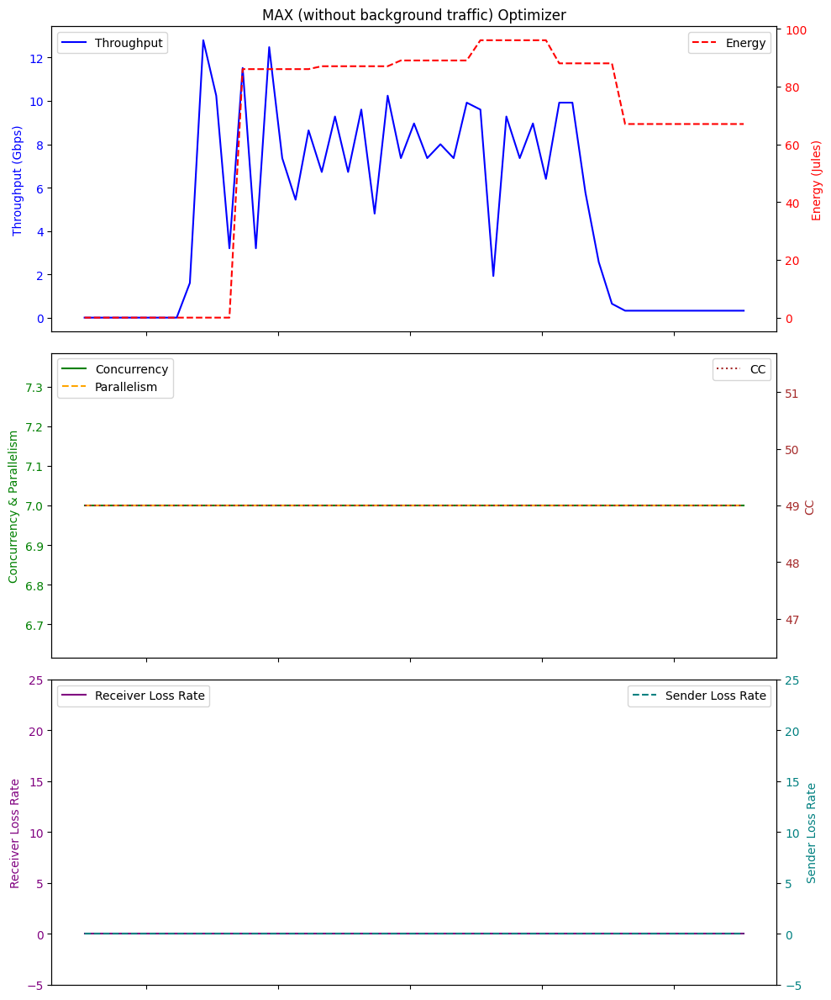

Average Throughput: 4.869019607843137
Total Energy: 3258.0
Total loss rate: 0.0023381264253335182
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:53:13.756922        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:53:14.753123        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:53:15.752704        0.00          0.0  49    0.0  32.7   
3  2024-01-26 04:53:16.752959        0.00          0.0  49    0.0  32.7   
4  2024-01-26 04:53:17.752347        0.00          0.0  49    0.0  32.7   
5  2024-01-26 04:53:18.755257        0.00          0.0  49    0.0  32.7   
6  2024-01-26 04:53:19.748492        0.00          0.0  49    0.0  32.7   
7  2024-01-26 04:53:20.759016        0.00          0.0  49    0.0  32.8   
8  2024-01-26 04:53:21.752059        9.60          0.0  49    8.0  35.4   
9  2024-01-26 04:53:22.752141        3.52          0.0  49    3.0  32.9   
10 2024-01-26 04:53:23.759792        9.60          0.0  49    8.0  33.0   
11

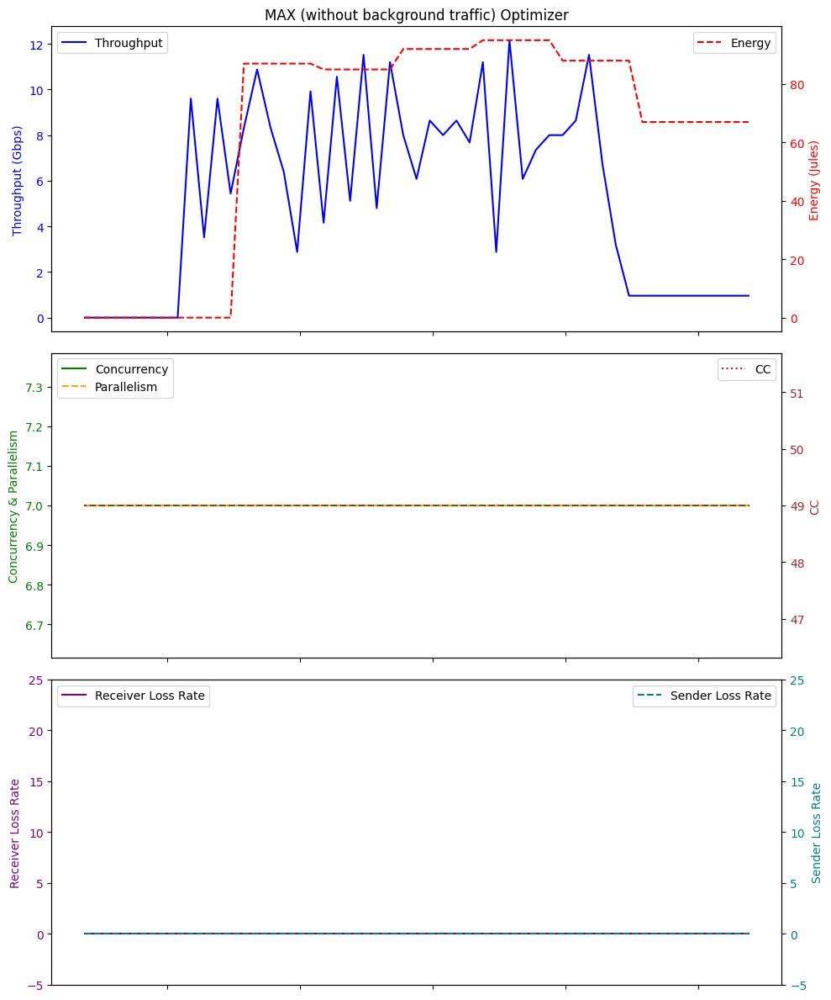

Average Throughput: 5.189019607843136
Total Energy: 3285.0
Total loss rate: 0.018088955389071078
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:42:13.995864        0.00          0.0  49    0.0   0.0   
1  2024-01-26 04:42:14.991059        0.00          0.0  49    0.0   0.0   
2  2024-01-26 04:42:15.990627        0.00          0.0  49    0.0  32.6   
3  2024-01-26 04:42:16.993979        0.00          0.0  49    0.0  32.7   
4  2024-01-26 04:42:17.994514        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:43:10.044999        0.32          0.0  49    0.0  32.6   
57 2024-01-26 04:43:11.045140        0.32          0.0  49    0.0  32.7   
58 2024-01-26 04:43:12.048663        0.32          0.0  49    0.0  32.7   
59 2024-01-26 04:43:13.048560        0.32          0.0  49    0.0  32.7   
60 2024-01-26 04:43:14.048659        0.32          0.0  49    0.0  32.7   

  

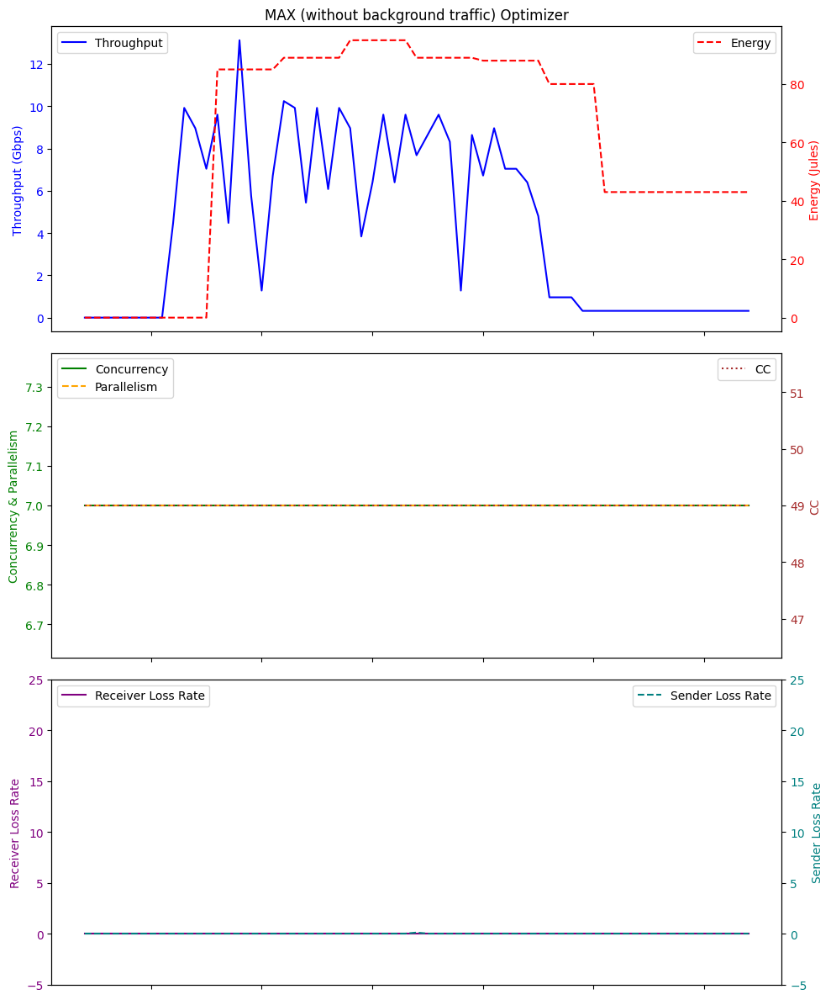

Average Throughput: 4.275409836065574
Total Energy: 3678.0
Total loss rate: 0.10581564658046548


In [24]:
# Example usage MAX
directory = './logFileDir_simu_wo_bg/STATIC/'
dfs = process_log_files(directory,"STATIC_logFile_")

max_throughput_list=[]
max_energy_list=[]
max_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('MAX (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    max_throughput_list.append(average_throughput)
    max_energy_list.append(total_energy)
    max_plr_list.append(total_plr)


In [25]:
result_dictionary={"Throughput":[bo_throughput_list,gd_throughput_list,ppo_throughput_list,max_throughput_list],"Energy":[bo_energy_list,gd_energy_list,ppo_energy_list,max_energy_list],"lossRate":[bo_plr_list,gd_plr_list,ppo_plr_list,max_plr_list]}
print(result_dictionary)

{'Throughput': [[4.5777777777777775, 4.288888888888889, 3.497777777777778, 4.48450704225352, 4.159999999999999, 5.427450980392156, 3.975211267605635, 4.978461538461539, 3.37170731707317, 4.4013114754098375, 4.639999999999998, 3.1024390243902444, 2.6407766990291246, 2.67294117647059, 4.91921568627451, 5.304615384615383, 2.7930434782608695, 3.644444444444444, 4.15609756097561, 4.397419354838712, 5.383529411764706, 3.5695774647887317, 5.51111111111111, 3.180487804878049, 4.855384615384614, 5.232941176470587, 2.834782608695652, 3.724444444444445, 4.886153846153845, 4.227096774193546], [2.3679999999999994, 2.710399999999999, 2.1653333333333338, 2.1360000000000006, 0.76096, 2.1893333333333334, 2.8768000000000007, 2.88, 2.2, 2.623999999999999, 2.8160000000000007, 5.010559999999999, 2.5408, 2.3840000000000003, 0.76224, 2.748800000000001, 2.298666666666667, 1.54304, 2.2426666666666666, 2.3650909090909087, 2.5504, 0.7622399999999999, 2.144, 2.1893333333333334, 2.880000000000001, 1.36252631578947

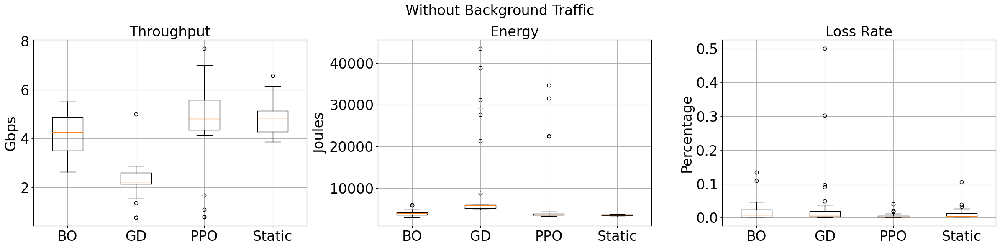

In [26]:
import matplotlib.pyplot as plt

labels = ['BO', 'GD', 'PPO', 'Static']

# Assuming result_dictionary is already defined with the relevant data
# result_dictionary = {...}

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 6))

# Font size for the ticks
tick_font_size = 24  # You can change this value as needed

# Plotting Throughput
axes[0].boxplot(result_dictionary['Throughput'], labels=labels)
axes[0].set_title('Throughput',fontsize=24)
axes[0].set_ylabel('Gbps',fontsize=24)
axes[0].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[0].grid(True)  # Adding grid

# Plotting Energy
axes[1].boxplot(result_dictionary['Energy'], labels=labels)
axes[1].set_title('Energy',fontsize=24)
axes[1].set_ylabel('Joules',fontsize=24)
axes[1].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[1].grid(True)  # Adding grid

# Plotting Loss Rate
axes[2].boxplot(result_dictionary['lossRate'], labels=labels)
axes[2].set_title('Loss Rate',fontsize=24)
axes[2].set_ylabel('Percentage',fontsize=24)
axes[2].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[2].grid(True)  # Adding grid
# axes[2].set_title('Without Background Traffic',fontsize=18)
plt.suptitle('Without Background Traffic',fontsize=tick_font_size)

plt.tight_layout()
plt.show()


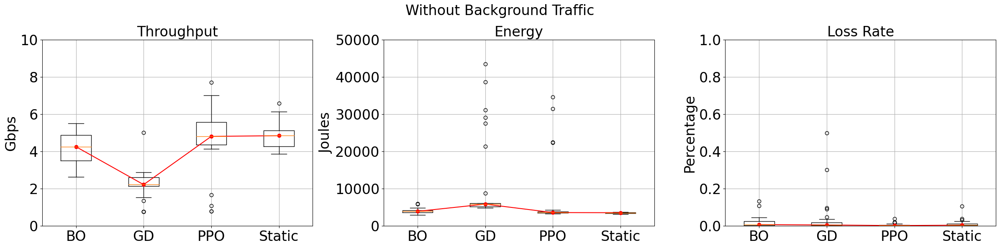

In [27]:
import matplotlib.pyplot as plt
import numpy as np

labels = ['BO', 'GD', 'PPO', 'Static']

# Assuming result_dictionary is already defined with the relevant data
# result_dictionary = {...}

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 6))

# Font size for the ticks
tick_font_size = 24  # You can change this value as needed

# Function to plot boxplot and median line
def plot_with_median_line(ax, data, title, y_label,y_limit=None):
    # Plotting the boxplot
    boxplot = ax.boxplot(data, labels=labels)
    
    # Calculating medians
    medians = [np.median(d) for d in data]
    
    # x-coordinates for the medians
    median_positions = range(1, len(medians) + 1)
    
    # Adding a line plot for medians
    ax.plot(median_positions, medians, color='red', marker='o')  # You can change the color and marker style

    # Setting title, labels, and other properties
    ax.set_title(title, fontsize=24)
    ax.set_ylabel(y_label, fontsize=24)
    ax.tick_params(axis='both', which='major', labelsize=tick_font_size)
    if y_limit:
        ax.set_ylim(y_limit)
    ax.grid(True)

# Plotting Throughput
plot_with_median_line(axes[0], result_dictionary['Throughput'], 'Throughput', 'Gbps',(0,10))

# Plotting Energy
plot_with_median_line(axes[1], result_dictionary['Energy'], 'Energy', 'Joules',(0,50000))

# Plotting Loss Rate
plot_with_median_line(axes[2], result_dictionary['lossRate'], 'Loss Rate', 'Percentage',(0,1))

plt.suptitle('Without Background Traffic', fontsize=tick_font_size)
plt.tight_layout()
plt.show()


# With background Traffic

                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:06:24.307524        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:06:25.299603        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:06:26.302133        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:06:27.304441        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:06:28.303984        0.00          0.0  49    0.0  32.7   
5  2024-01-26 05:06:29.305960        0.00          0.0  49    0.0  32.6   
6  2024-01-26 05:06:30.329249        0.00          0.0  49    0.0  32.7   
7  2024-01-26 05:06:31.328076        0.00          0.0  49    0.0  32.8   
8  2024-01-26 05:06:32.340765        0.64          0.0  49    1.0  32.6   
9  2024-01-26 05:06:33.300765       15.04          0.0  49   13.0  32.9   
10 2024-01-26 05:06:34.342942        2.24          0.0  36    2.0  33.1   
11 2024-01-26 05:06:35.306573       13.44          0.0  36   12.0  32.7   
12 2024-01-26 05:06:36.30

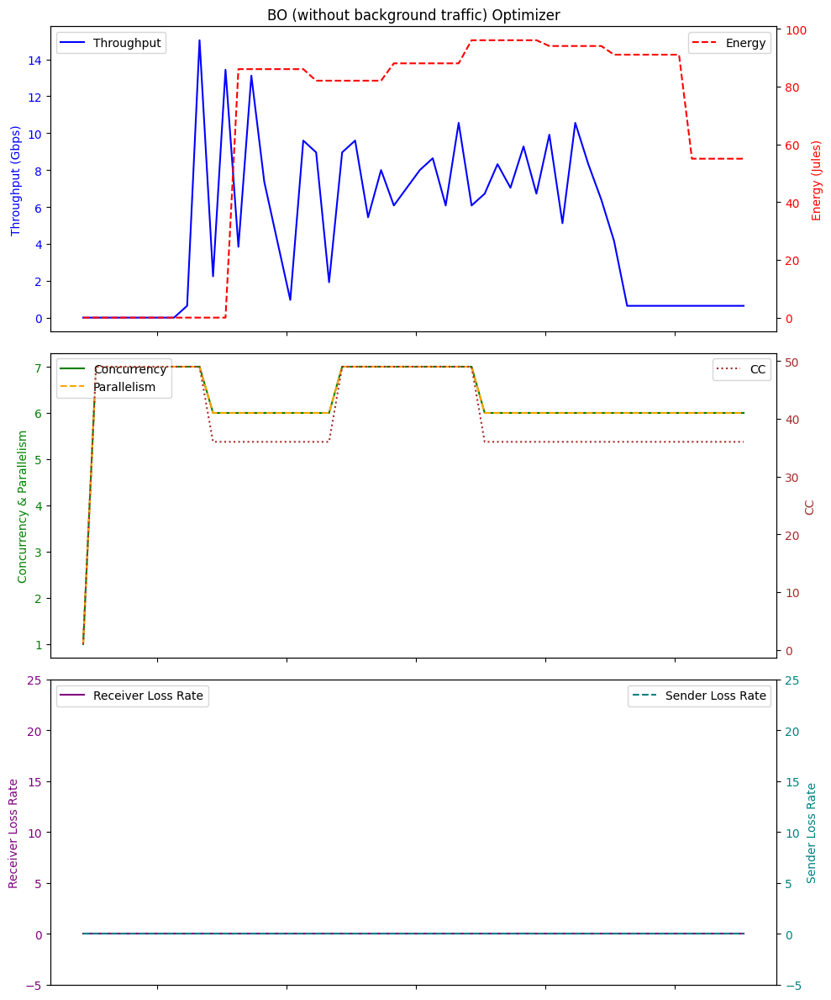

Average Throughput: 4.898461538461538
Total Energy: 3403.0
Total loss rate: 0.015598899578503486
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:43:46.290745        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:43:47.284147        0.00          0.0  64    0.0   0.0   
2  2024-01-26 06:43:48.287657        0.00          0.0  64    0.0  32.7   
3  2024-01-26 06:43:49.276658        0.00          0.0  64    0.0  32.6   
4  2024-01-26 06:43:50.287895        0.00          0.0  64    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 06:44:52.352416        0.32          0.0   4    0.0  32.6   
67 2024-01-26 06:44:53.353389        0.32          0.0   4    0.0  32.6   
68 2024-01-26 06:44:54.355681        0.32          0.0   4    0.0  32.8   
69 2024-01-26 06:44:55.355929        0.32          0.0   4    0.0  32.7   
70 2024-01-26 06:44:56.356247        0.32          0.0   4    0.0  32.6   

  

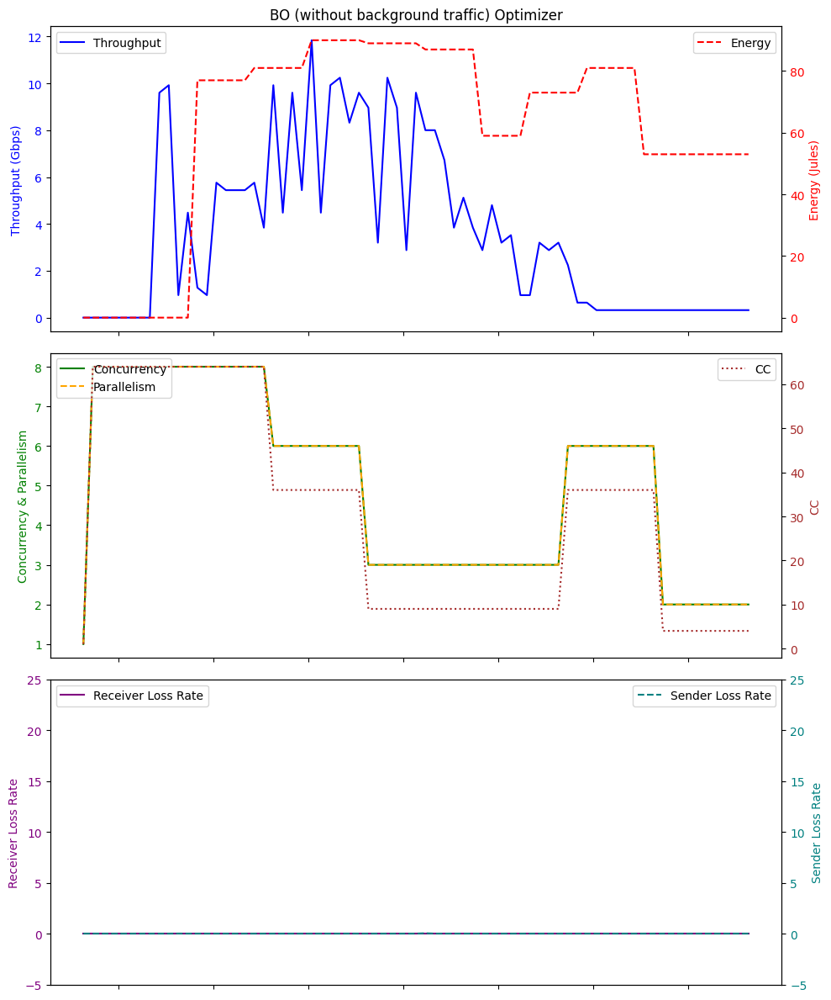

Average Throughput: 3.6146478873239434
Total Energy: 4399.0
Total loss rate: 0.041758755114689905
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:38:25.508735        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:38:26.503559        0.00          0.0  36    0.0   0.0   
2  2024-01-26 07:38:27.504533        0.00          0.0  36    0.0  32.7   
3  2024-01-26 07:38:28.504652        0.00          0.0  36    0.0  32.7   
4  2024-01-26 07:38:29.505123        0.00          0.0  36    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 07:39:42.577696        1.92          0.0   4    2.0  32.8   
78 2024-01-26 07:39:43.577329        1.92          0.0   4    2.0  32.8   
79 2024-01-26 07:39:44.580899        1.92          0.0   4    2.0  32.7   
80 2024-01-26 07:39:45.580975        1.92          0.0   4    2.0  32.7   
81 2024-01-26 07:39:46.578185        1.92          0.0   4    2.0  32.7   

 

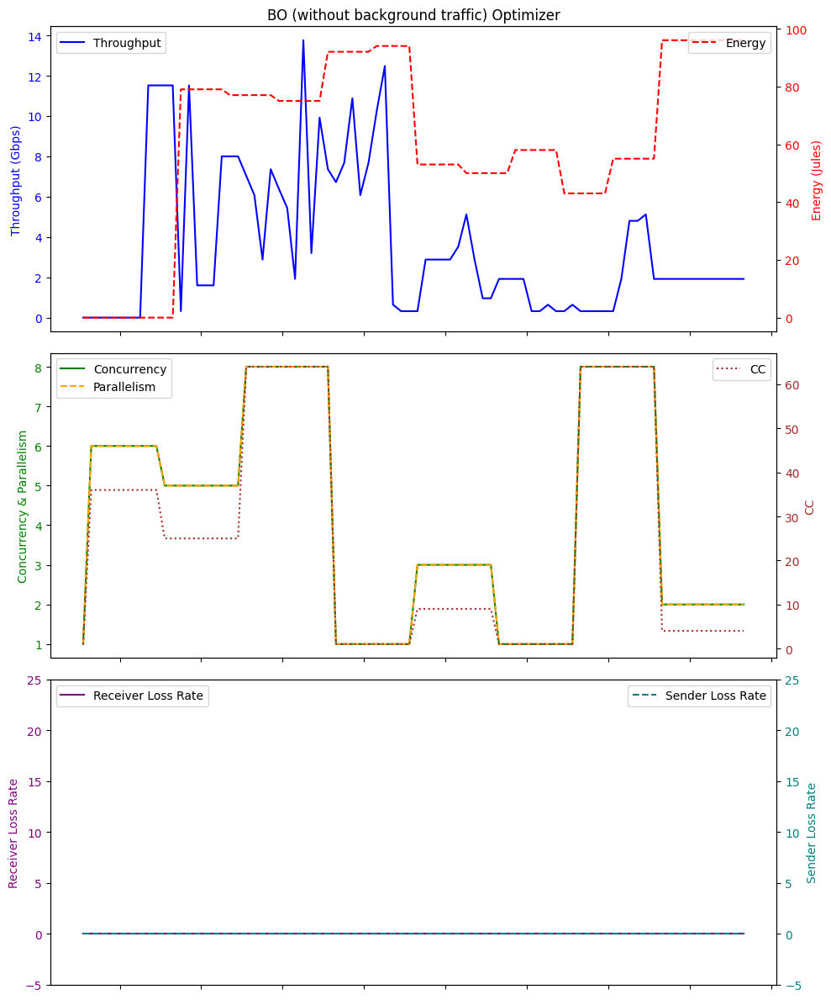

Average Throughput: 3.633170731707318
Total Energy: 5018.0
Total loss rate: 0.0056855899508825615
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:44:53.200906        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:44:54.196929        0.00          0.0   4    0.0   0.0   
2  2024-01-26 05:44:55.198842        0.00          0.0   4    0.0  32.7   
3  2024-01-26 05:44:56.199958        0.00          0.0   4    0.0  32.6   
4  2024-01-26 05:44:57.199727        0.00          0.0   4    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 05:46:00.266043        1.92          0.0  16    2.0  32.7   
68 2024-01-26 05:46:01.264695        1.92          0.0  16    2.0  32.6   
69 2024-01-26 05:46:02.266472        1.92          0.0  16    2.0  32.7   
70 2024-01-26 05:46:03.267826        1.92          0.0  16    2.0  32.6   
71 2024-01-26 05:46:04.260767        1.92          0.0  16    2.0  32.7   

 

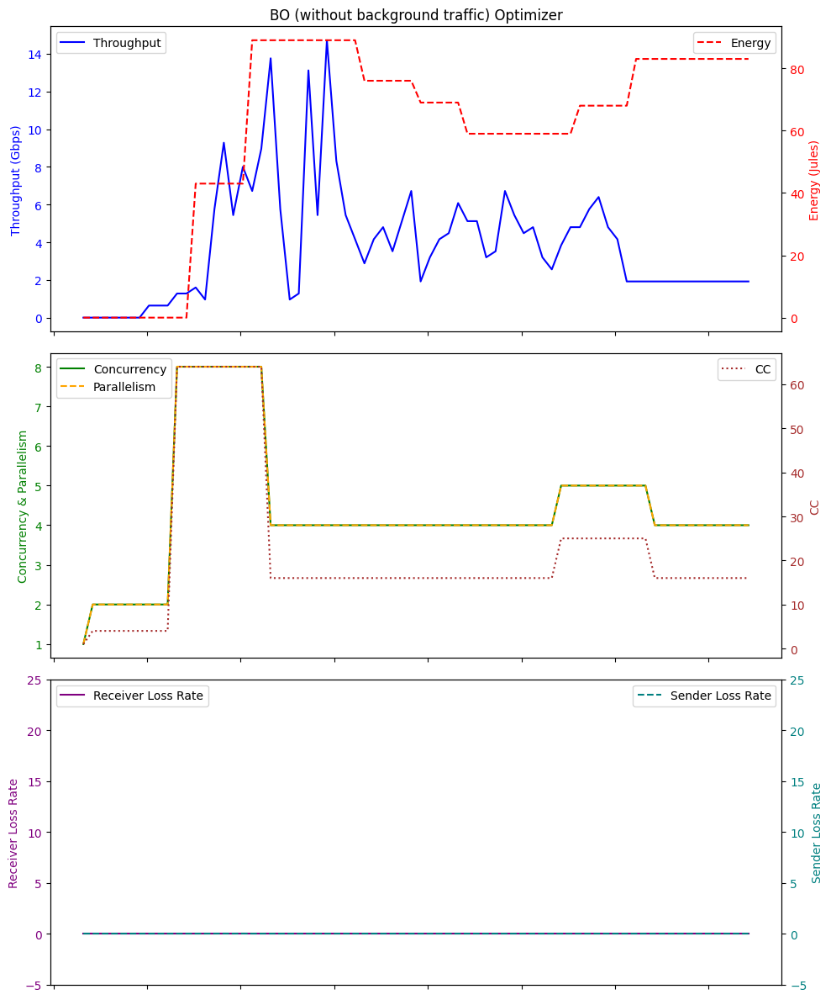

Average Throughput: 3.8444444444444446
Total Energy: 4322.0
Total loss rate: 0.01737223701296185
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:00:00.957799        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:00:01.957165        0.00          0.0  64    0.0   0.0   
2   2024-01-26 05:00:02.956950        0.00          0.0  64    0.0  32.7   
3   2024-01-26 05:00:03.956673        0.00          0.0  64    0.0  32.6   
4   2024-01-26 05:00:04.958310        0.00          0.0  64    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
98  2024-01-26 05:01:39.052682        0.32          0.0  36    0.0  32.8   
99  2024-01-26 05:01:40.054673        0.32          0.0  36    0.0  32.8   
100 2024-01-26 05:01:41.056091        0.32          0.0  36    0.0  32.8   
101 2024-01-26 05:01:42.056080        0.32          0.0  36    0.0  32.8   
102 2024-01-26 05:01:43.052864        0.32          0.0  36    0.0 

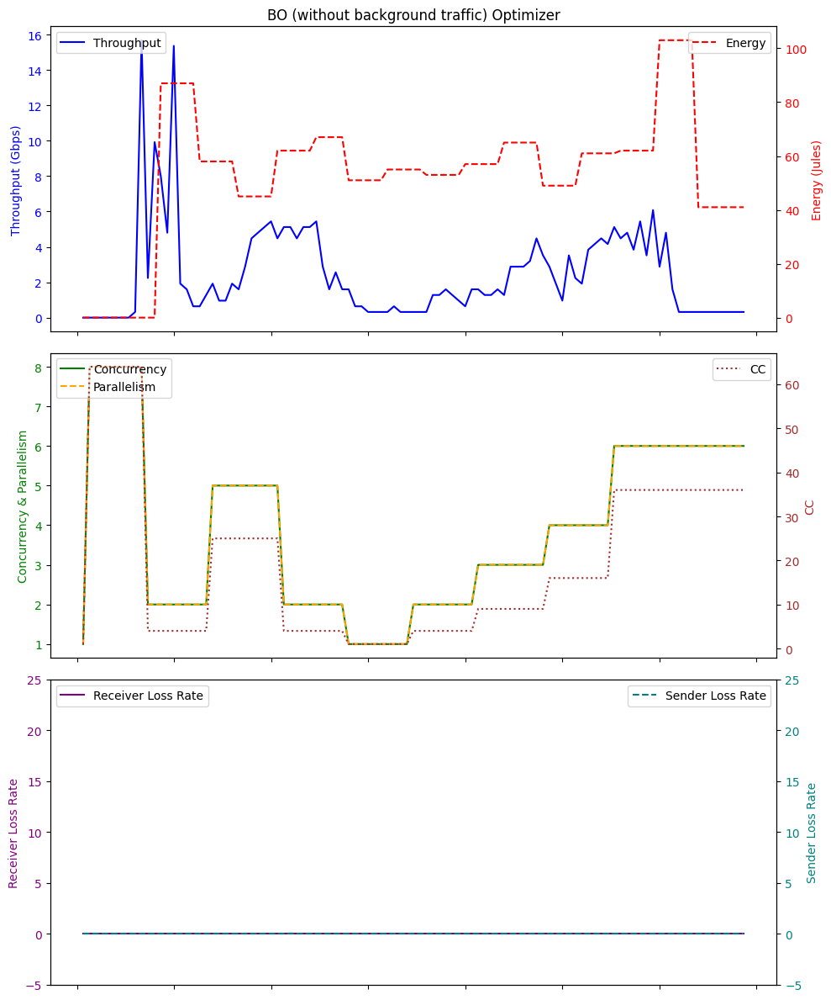

Average Throughput: 2.466796116504854
Total Energy: 5511.0
Total loss rate: 0.022071749931179996
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:22:10.984001        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:22:11.980055        0.00          0.0   4    0.0   0.0   
2  2024-01-26 06:22:12.983501        0.00          0.0   4    0.0  32.7   
3  2024-01-26 06:22:13.982862        0.00          0.0   4    0.0  32.7   
4  2024-01-26 06:22:14.982931        0.00          0.0   4    0.0  32.6   
5  2024-01-26 06:22:15.986107        0.00          0.0   4    0.0  32.7   
6  2024-01-26 06:22:16.987119        0.00          0.0   4    0.0  32.8   
7  2024-01-26 06:22:17.986998        0.64          0.0   4    1.0  32.7   
8  2024-01-26 06:22:18.989738        0.64          0.0   4    1.0  32.8   
9  2024-01-26 06:22:19.990752        0.64          0.0   4    1.0  32.6   
10 2024-01-26 06:22:20.991977        1.28          0.0  36    1.0  32.7   
11 

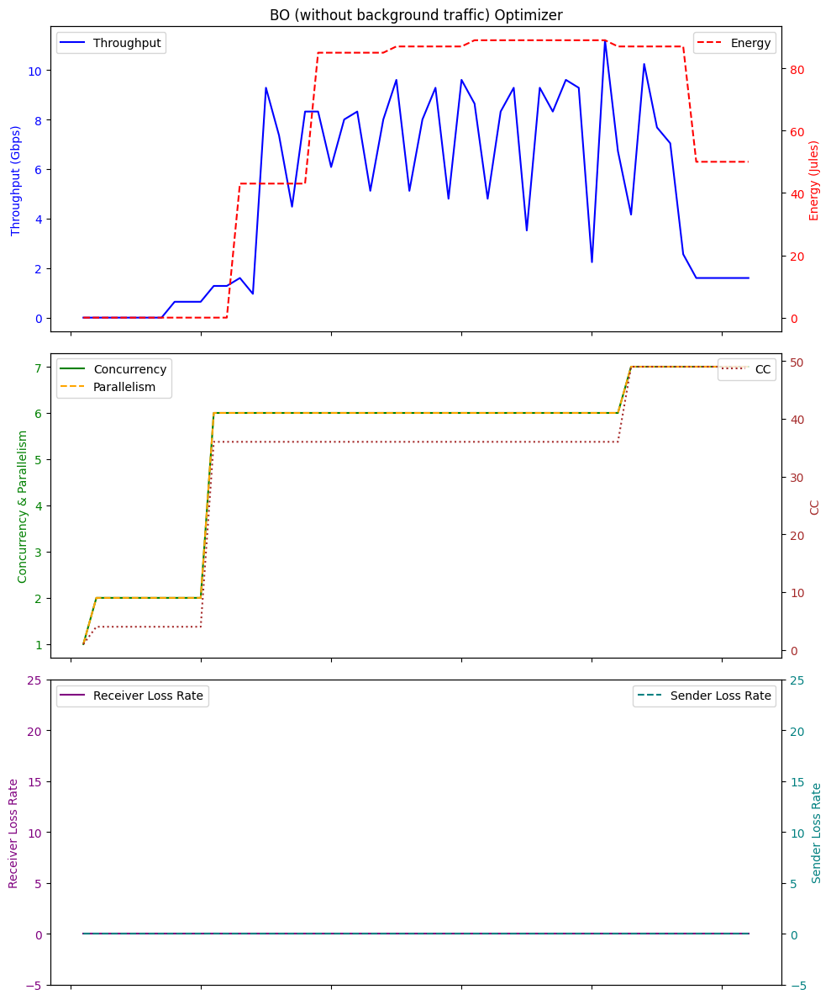

Average Throughput: 4.953846153846153
Total Energy: 3041.0
Total loss rate: 0.008302576668239452
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:48:46.289751        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:48:47.284835        0.00          0.0  64    0.0   0.0   
2   2024-01-26 06:48:48.286921        0.00          0.0  64    0.0  32.7   
3   2024-01-26 06:48:49.287653        0.00          0.0  64    0.0  32.6   
4   2024-01-26 06:48:50.287773        0.00          0.0  64    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
97  2024-01-26 06:50:23.381133        1.28          0.0  25    1.0  32.8   
98  2024-01-26 06:50:24.384461        1.28          0.0  25    1.0  32.8   
99  2024-01-26 06:50:25.384333        1.28          0.0  25    1.0  32.8   
100 2024-01-26 06:50:26.383980        1.28          0.0  25    1.0  32.8   
101 2024-01-26 06:50:27.384991        1.28          0.0  25    1.0 

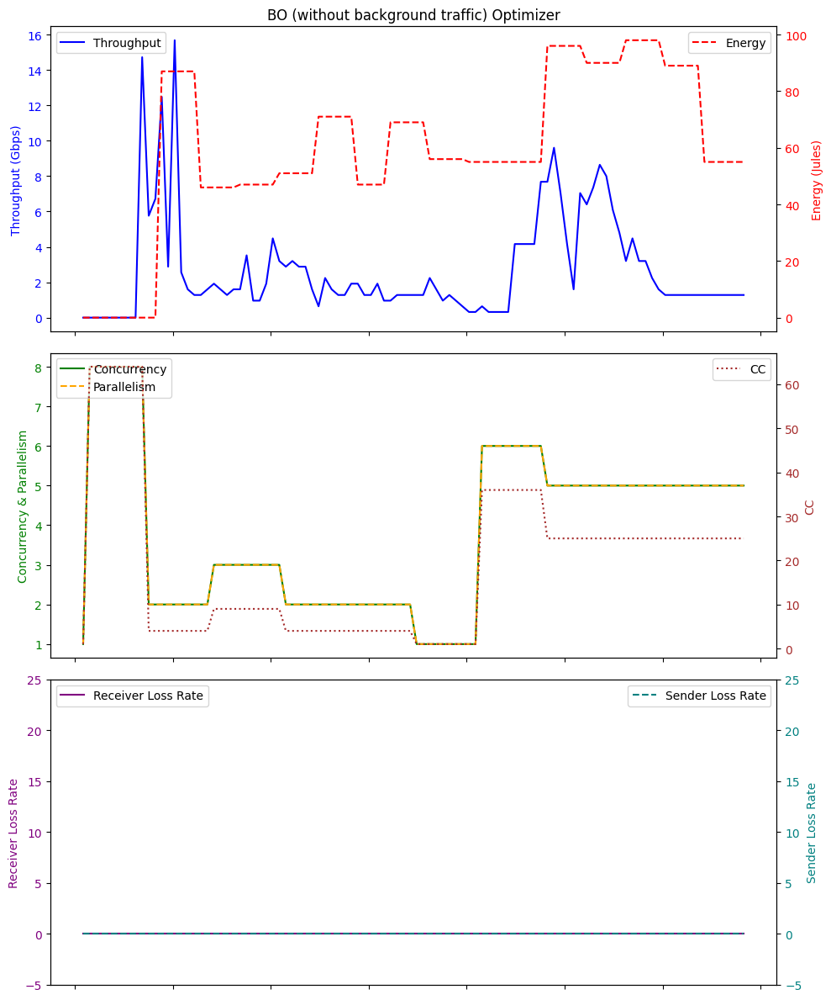

Average Throughput: 2.688627450980391
Total Energy: 6080.0
Total loss rate: 0.00542780002634852
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:59:34.827299        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:59:35.834235        0.00          0.0   9    0.0   0.0   
2   2024-01-26 06:59:36.836292        0.00          0.0   9    0.0  32.7   
3   2024-01-26 06:59:37.837600        0.00          0.0   9    0.0  32.7   
4   2024-01-26 06:59:38.837509        0.00          0.0   9    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
497 2024-01-26 07:07:52.357778        0.32          0.0  64    0.0  32.6   
498 2024-01-26 07:07:53.361370        0.32          0.0  64    0.0  32.8   
499 2024-01-26 07:07:54.363193        0.32          0.0  64    0.0  32.8   
500 2024-01-26 07:07:55.367325        0.32          0.0  64    0.0  32.8   
501 2024-01-26 07:07:56.358694        0.32          0.0  64    0.0  

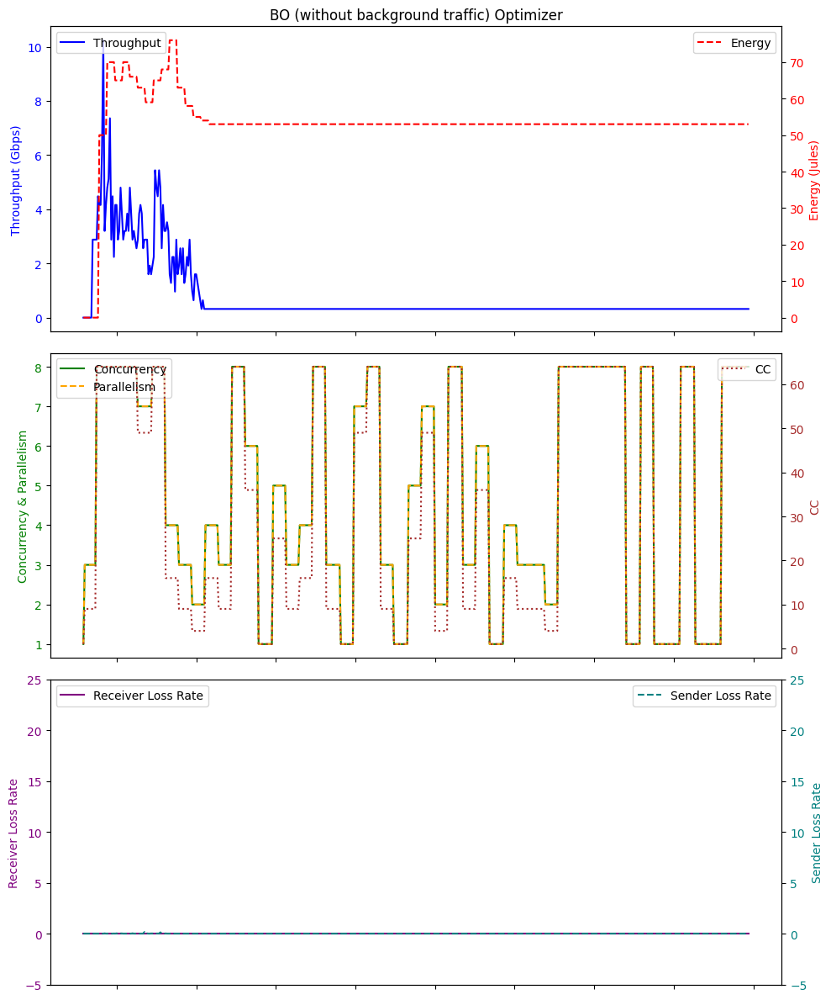

Average Throughput: 0.7719521912350598
Total Energy: 26793.0
Total loss rate: 0.505182625073373
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:12:21.199833        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:12:22.197182        0.00          0.0  16    0.0   0.0   
2  2024-01-26 07:12:23.198487        0.00          0.0  16    0.0  32.8   
3  2024-01-26 07:12:24.198176        0.00          0.0  16    0.0  32.6   
4  2024-01-26 07:12:25.199003        0.00          0.0  16    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 07:13:28.264957        1.28          0.0  64    1.0  32.7   
68 2024-01-26 07:13:29.265235        1.28          0.0  64    1.0  32.6   
69 2024-01-26 07:13:30.264849        1.28          0.0  64    1.0  32.8   
70 2024-01-26 07:13:31.265959        1.28          0.0  64    1.0  32.8   
71 2024-01-26 07:13:32.268982        1.28          0.0  64    1.0  32.8   

   

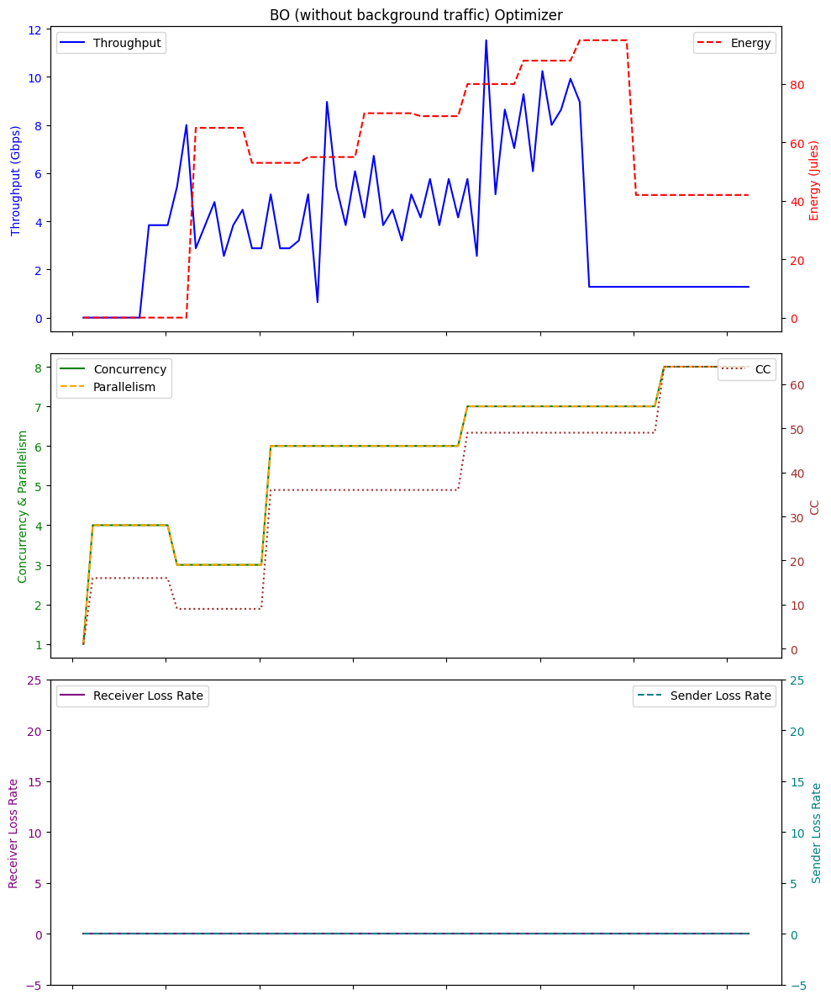

Average Throughput: 3.795555555555556
Total Energy: 3927.0
Total loss rate: 0.0017282874186803662
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:23:07.212271        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:23:08.206191        0.00          0.0  25    0.0   0.0   
2  2024-01-26 07:23:09.205939        0.00          0.0  25    0.0  32.6   
3  2024-01-26 07:23:10.208951        0.00          0.0  25    0.0  32.6   
4  2024-01-26 07:23:11.209028        0.00          0.0  25    0.0  32.6   
5  2024-01-26 07:23:12.210493        0.00          0.0  25    0.0  32.7   
6  2024-01-26 07:23:13.215327        0.00          0.0  25    0.0  32.8   
7  2024-01-26 07:23:14.213877        4.48          0.0  25    4.0  33.6   
8  2024-01-26 07:23:15.214530        4.80          0.0  25    4.0  32.7   
9  2024-01-26 07:23:16.217641        3.84          0.0  25    3.0  33.3   
10 2024-01-26 07:23:17.218495        6.08          0.0  49    5.0  34.1   
11

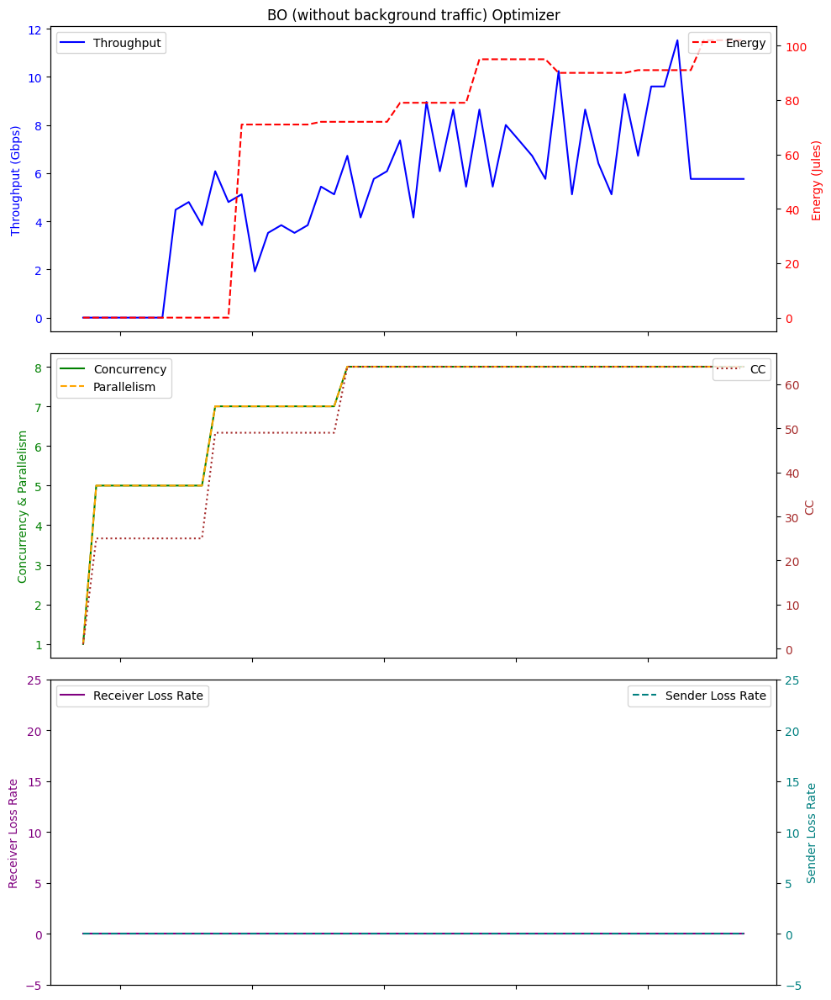

Average Throughput: 5.345882352941176
Total Energy: 3305.0
Total loss rate: 0.010537865767890946
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:32:17.159450        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:32:18.157979        0.00          0.0   9    0.0   0.0   
2  2024-01-26 06:32:19.157910        0.00          0.0   9    0.0  32.7   
3  2024-01-26 06:32:20.158250        0.00          0.0   9    0.0  32.7   
4  2024-01-26 06:32:21.157549        0.00          0.0   9    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 06:33:34.233393        2.24          0.0  36    2.0  32.7   
78 2024-01-26 06:33:35.235889        2.24          0.0  36    2.0  32.8   
79 2024-01-26 06:33:36.238903        2.24          0.0  36    2.0  32.8   
80 2024-01-26 06:33:37.239178        2.24          0.0  36    2.0  32.8   
81 2024-01-26 06:33:38.238897        2.24          0.0  36    2.0  32.8   

  

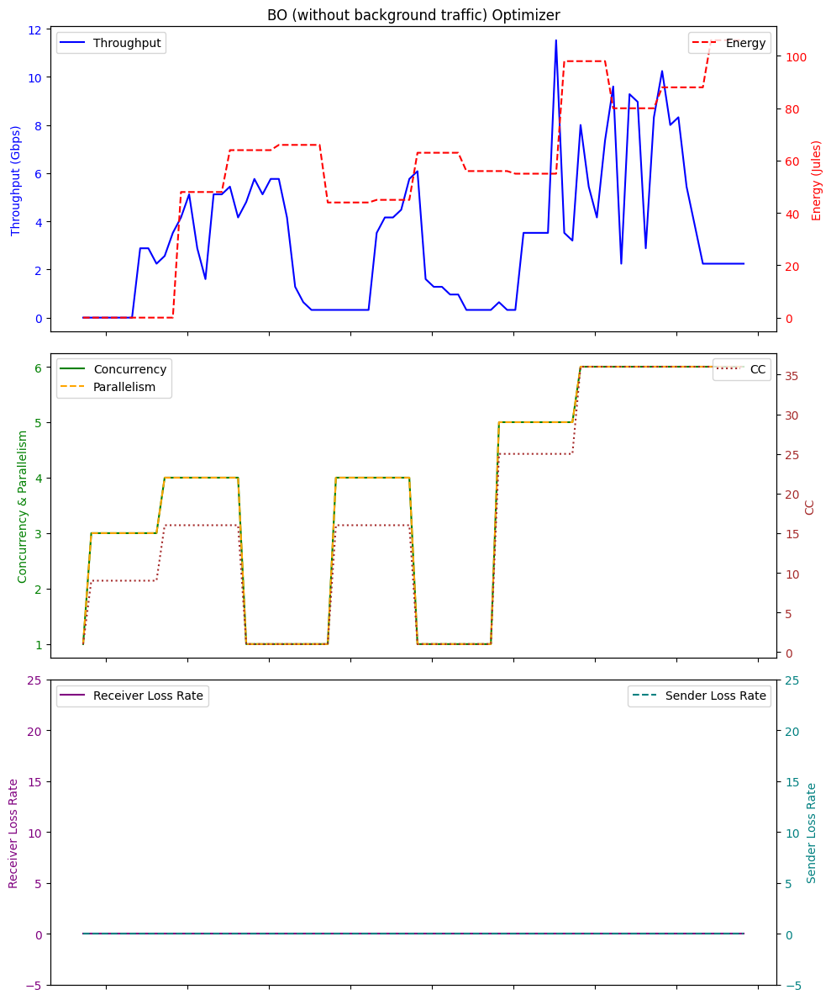

Average Throughput: 3.2702439024390246
Total Energy: 4727.0
Total loss rate: 0.003990512094177807
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:28:39.794335        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:28:40.790024        0.00          0.0  25    0.0   0.0   
2  2024-01-26 05:28:41.790202        0.00          0.0  25    0.0  32.6   
3  2024-01-26 05:28:42.793128        0.00          0.0  25    0.0  32.6   
4  2024-01-26 05:28:43.793931        0.00          0.0  25    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
87 2024-01-26 05:30:06.877529        9.92          0.0  25    9.0  32.6   
88 2024-01-26 05:30:07.878898        9.92          0.0  25    9.0  32.7   
89 2024-01-26 05:30:08.877927        9.92          0.0  25    9.0  32.6   
90 2024-01-26 05:30:09.878373        9.92          0.0  25    9.0  32.7   
91 2024-01-26 05:30:10.881647        9.92          0.0  25    9.0  32.8   

 

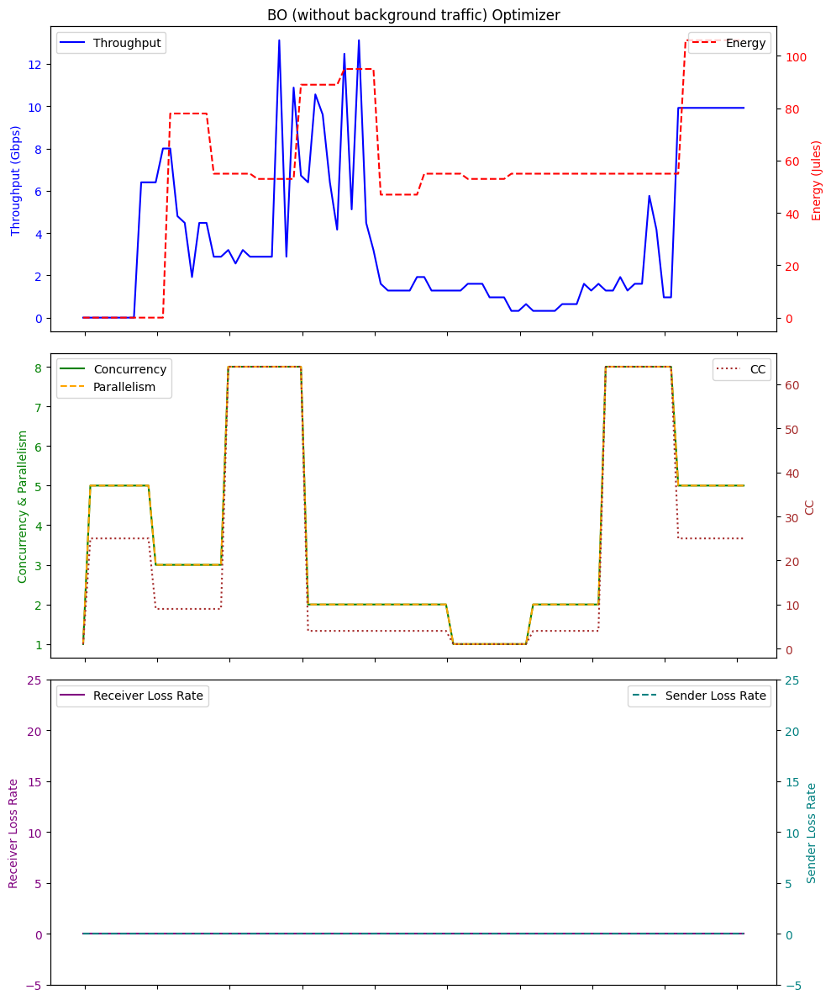

Average Throughput: 3.7426086956521742
Total Energy: 5329.0
Total loss rate: 0.01646628857538219
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:39:43.040830        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:39:44.033200        0.00          0.0   4    0.0   0.0   
2  2024-01-26 05:39:45.037127        0.00          0.0   4    0.0  32.7   
3  2024-01-26 05:39:46.038013        0.00          0.0   4    0.0  32.7   
4  2024-01-26 05:39:47.036659        0.00          0.0   4    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 05:41:00.117173        0.96          0.0  64    1.0  32.7   
78 2024-01-26 05:41:01.120352        0.96          0.0  64    1.0  32.7   
79 2024-01-26 05:41:02.121595        0.96          0.0  64    1.0  32.7   
80 2024-01-26 05:41:03.120797        0.96          0.0  64    1.0  32.8   
81 2024-01-26 05:41:04.127591        0.96          0.0  64    1.0  32.7   

  

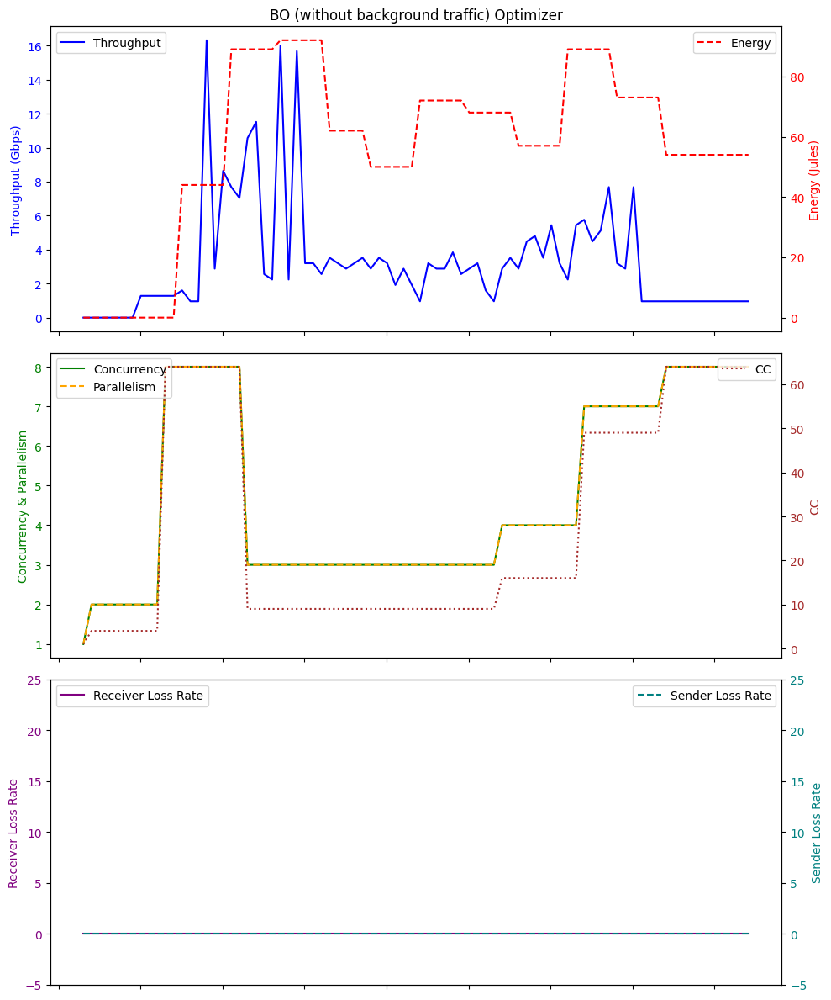

Average Throughput: 3.274146341463414
Total Energy: 4708.0
Total loss rate: 0.007669806657647154
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:17:55.997973        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:17:56.994061        0.00          0.0  36    0.0   0.0   
2  2024-01-26 05:17:57.994994        0.00          0.0  36    0.0  32.7   
3  2024-01-26 05:17:58.994941        0.00          0.0  36    0.0  32.6   
4  2024-01-26 05:17:59.996880        0.00          0.0  36    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
77 2024-01-26 05:19:13.071698        0.32          0.0  64    0.0  32.7   
78 2024-01-26 05:19:14.071455        0.32          0.0  64    0.0  32.8   
79 2024-01-26 05:19:15.074505        0.32          0.0  64    0.0  32.7   
80 2024-01-26 05:19:16.074558        0.32          0.0  64    0.0  32.7   
81 2024-01-26 05:19:17.074724        0.32          0.0  64    0.0  32.7   

  

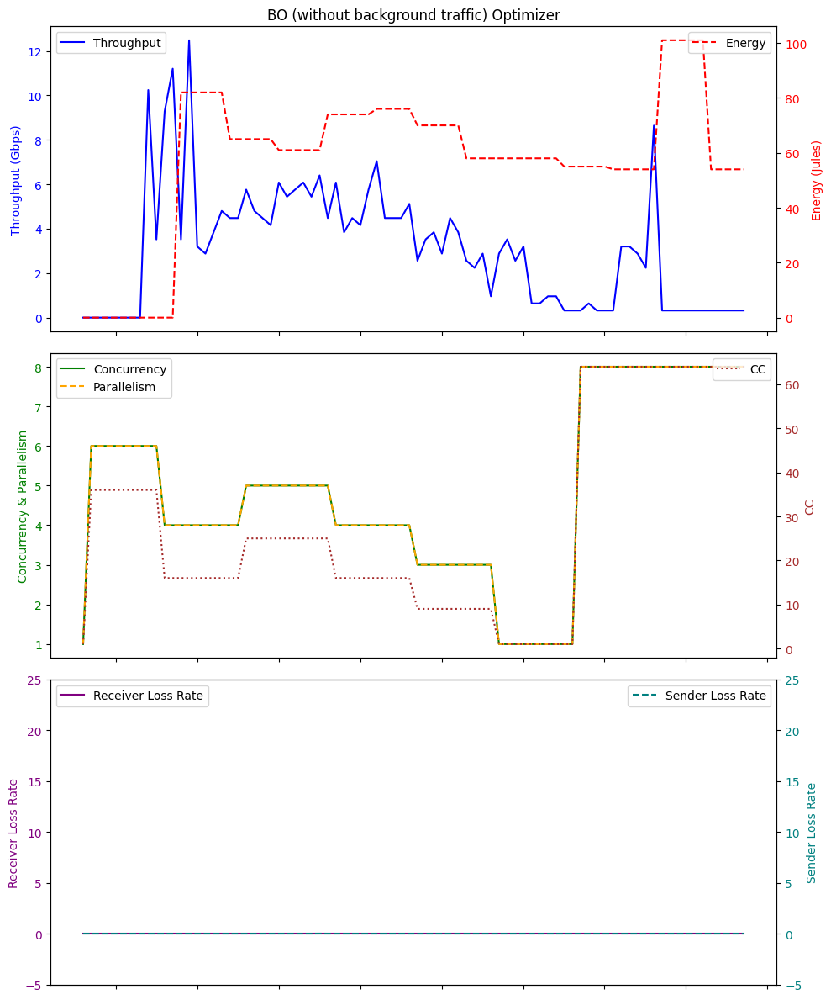

Average Throughput: 3.0985365853658533
Total Energy: 4718.0
Total loss rate: 0.00538760550030417
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:34:22.114268        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:34:23.109730        0.00          0.0   1    0.0   0.0   
2  2024-01-26 05:34:24.110663        0.00          0.0   1    0.0  32.7   
3  2024-01-26 05:34:25.113625        0.00          0.0   1    0.0  32.7   
4  2024-01-26 05:34:26.113344        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 05:35:28.176791        0.64          0.0  64    1.0  32.7   
67 2024-01-26 05:35:29.178447        0.64          0.0  64    1.0  32.6   
68 2024-01-26 05:35:30.178593        0.64          0.0  64    1.0  32.6   
69 2024-01-26 05:35:31.179056        0.64          0.0  64    1.0  32.6   
70 2024-01-26 05:35:32.181706        0.64          0.0  64    1.0  32.6   

  

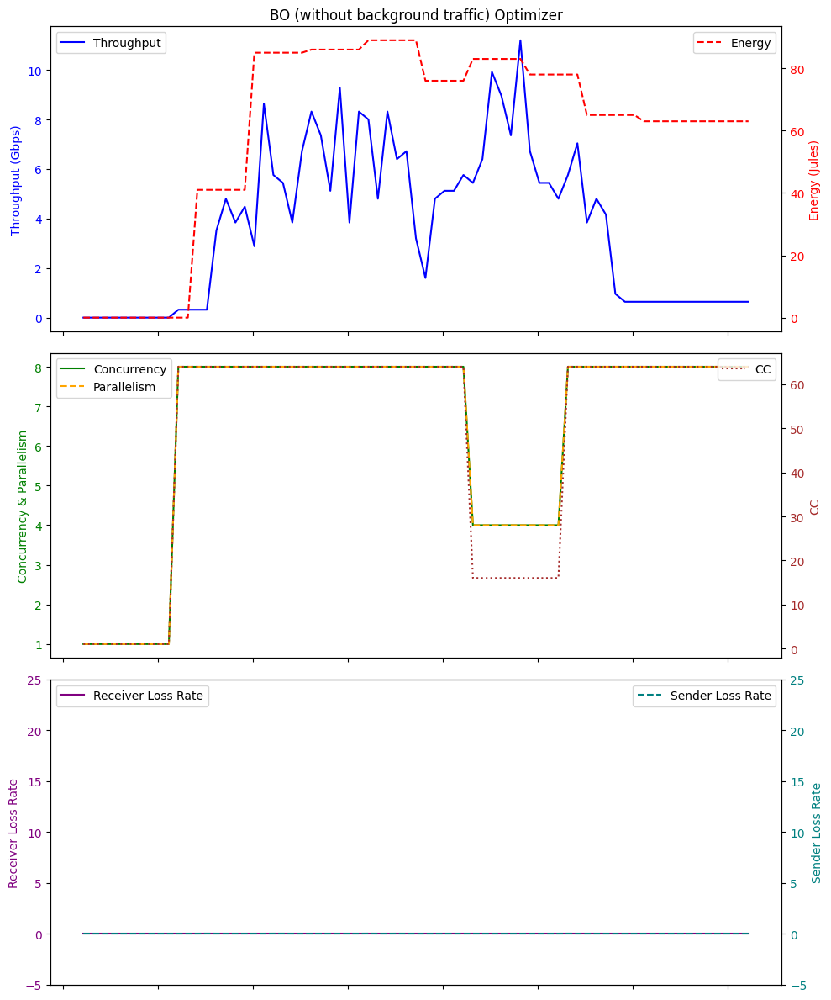

Average Throughput: 3.668732394366196
Total Energy: 4298.0
Total loss rate: 0.02061655601076582
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:11:50.268756        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:11:51.264521        0.00          0.0  36    0.0   0.0   
2   2024-01-26 05:11:52.267820        0.00          0.0  36    0.0  32.8   
3   2024-01-26 05:11:53.267806        0.00          0.0  36    0.0  32.7   
4   2024-01-26 05:11:54.267824        0.00          0.0  36    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
108 2024-01-26 05:13:38.374838        0.64          0.0  36    1.0  32.7   
109 2024-01-26 05:13:39.376194        0.64          0.0  36    1.0  32.8   
110 2024-01-26 05:13:40.381020        0.64          0.0  36    1.0  32.7   
111 2024-01-26 05:13:41.379567        0.64          0.0  36    1.0  32.8   
112 2024-01-26 05:13:42.380419        0.64          0.0  36    1.0  

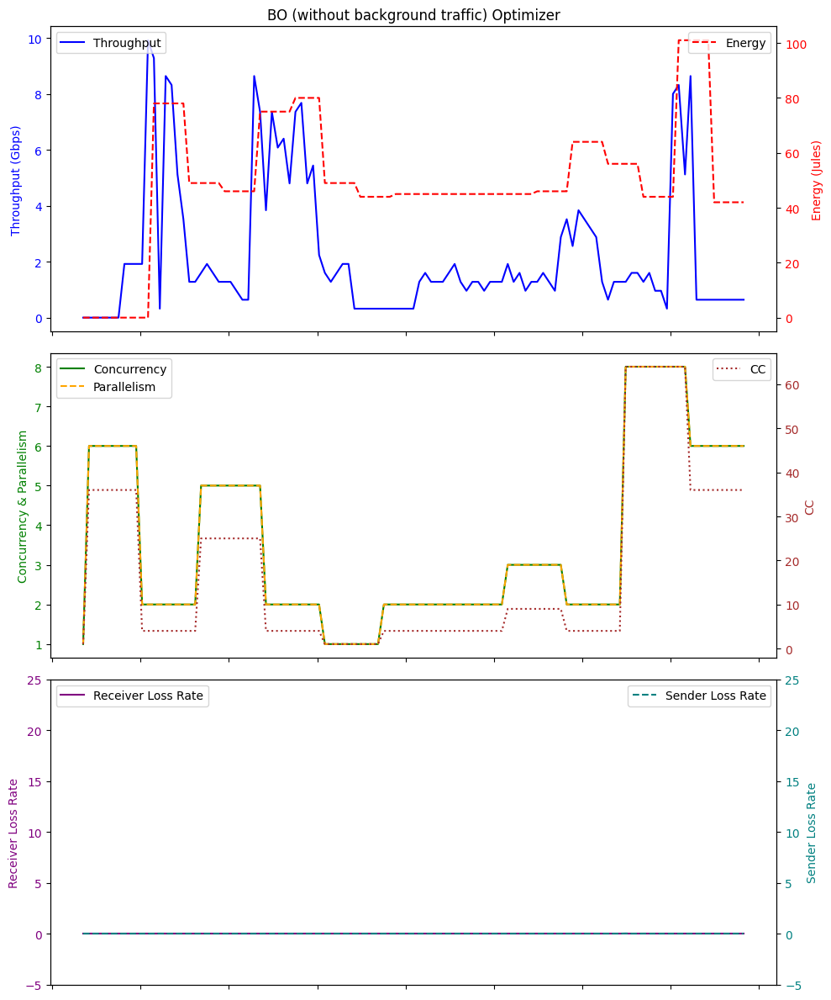

Average Throughput: 2.254159292035398
Total Energy: 5644.0
Total loss rate: 0.02386553674791385
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:55:50.899331        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:55:51.893415        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:55:52.893433        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:55:53.894120        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:55:54.896787        0.00          0.0  49    0.0  32.6   
5  2024-01-26 05:55:55.896060        0.00          0.0  49    0.0  32.6   
6  2024-01-26 05:55:56.899078        0.00          0.0  49    0.0  32.6   
7  2024-01-26 05:55:57.903358        0.00          0.0  49    0.0  40.0   
8  2024-01-26 05:55:58.903491        8.00          0.0  49    7.0  37.2   
9  2024-01-26 05:55:59.902868        8.64          0.0  49    8.0  37.4   
10 2024-01-26 05:56:00.910270        3.84          0.0  36    3.0  32.7   
11 2

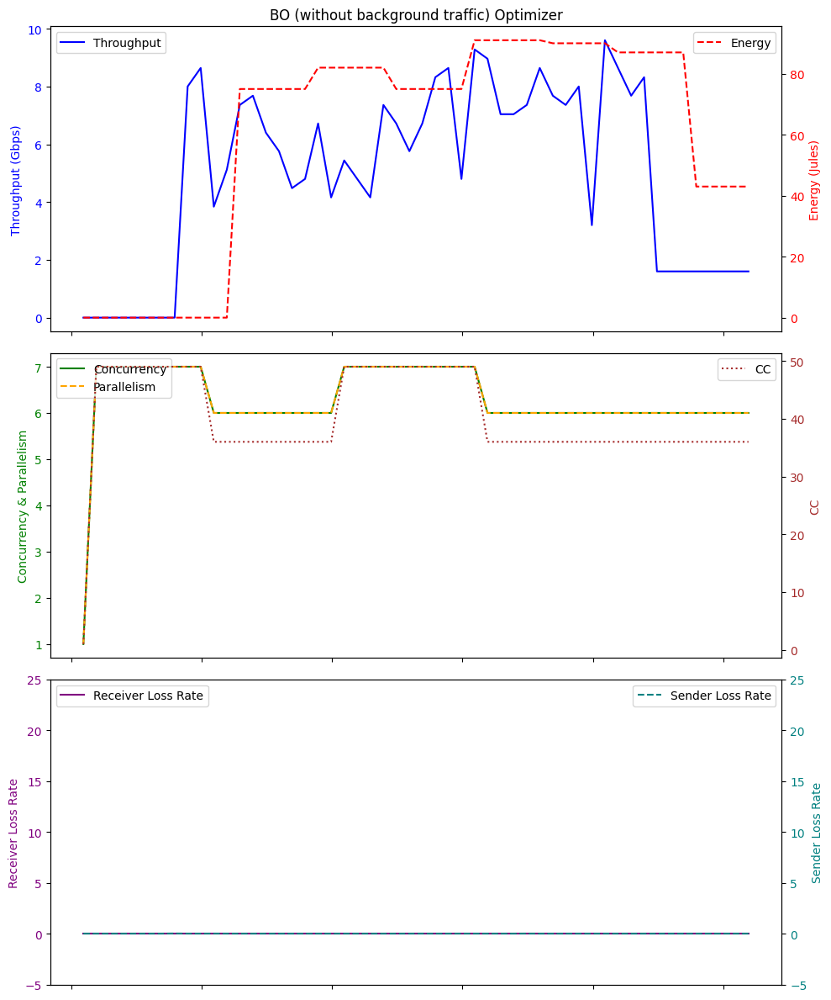

Average Throughput: 4.947692307692307
Total Energy: 3125.0
Total loss rate: 0.019992511233543328
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:10:47.878547        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:10:48.873819        0.00          0.0   9    0.0   0.0   
2  2024-01-26 06:10:49.876923        0.00          0.0   9    0.0  32.6   
3  2024-01-26 06:10:50.877211        0.00          0.0   9    0.0  32.7   
4  2024-01-26 06:10:51.876760        0.00          0.0   9    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 06:11:54.940596        0.32          0.0   9    0.0  32.8   
68 2024-01-26 06:11:55.941577        0.32          0.0   9    0.0  32.8   
69 2024-01-26 06:11:56.943321        0.32          0.0   9    0.0  32.9   
70 2024-01-26 06:11:57.942935        0.32          0.0   9    0.0  32.7   
71 2024-01-26 06:11:58.943976        0.32          0.0   9    0.0  32.7   

  

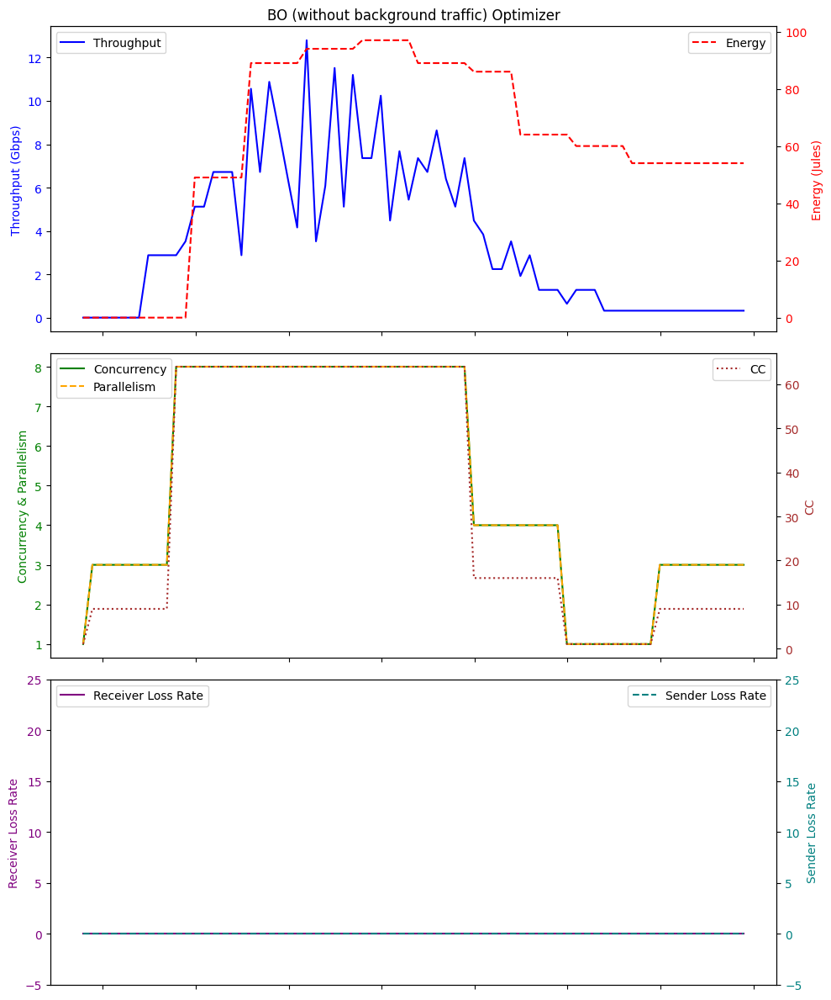

Average Throughput: 3.6755555555555555
Total Energy: 4384.0
Total loss rate: 0.023906019036582418
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:00:46.375002         0.0          0.0   1    0.0   0.0   
1  2024-01-26 06:00:47.371661         0.0          0.0   4    0.0   0.0   
2  2024-01-26 06:00:48.374700         0.0          0.0   4    0.0  32.8   
3  2024-01-26 06:00:49.374635         0.0          0.0   4    0.0  32.7   
4  2024-01-26 06:00:50.374060         0.0          0.0   4    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
68 2024-01-26 06:01:54.439129         1.6          0.0  64    1.0  32.8   
69 2024-01-26 06:01:55.439103         1.6          0.0  64    1.0  32.8   
70 2024-01-26 06:01:56.438657         1.6          0.0  64    1.0  32.8   
71 2024-01-26 06:01:57.441777         1.6          0.0  64    1.0  32.7   
72 2024-01-26 06:01:58.439264         1.6          0.0  64    1.0  32.7   

 

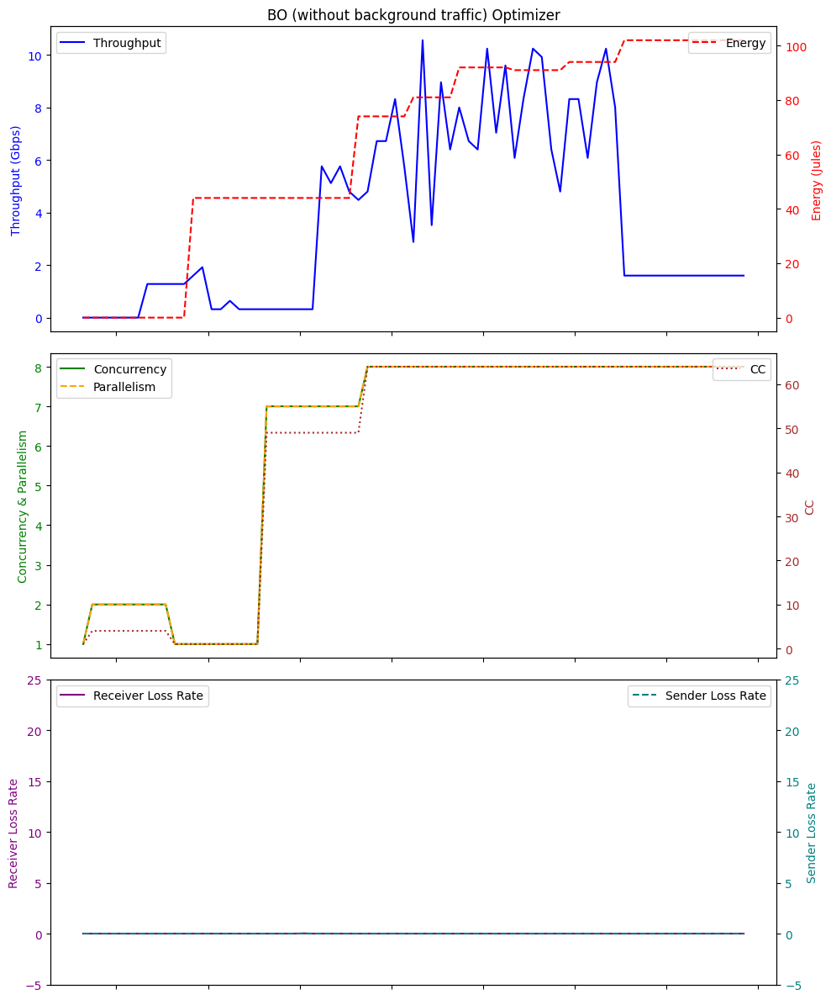

Average Throughput: 3.708493150684932
Total Energy: 4731.0
Total loss rate: 0.019564137901743613
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:23:31.637286        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:23:32.630467        0.00          0.0   4    0.0   0.0   
2  2024-01-26 05:23:33.631802        0.00          0.0   4    0.0  32.6   
3  2024-01-26 05:23:34.634155        0.00          0.0   4    0.0  32.6   
4  2024-01-26 05:23:35.633868        0.00          0.0   4    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 05:24:38.697324        3.84          0.0  64    3.0  32.6   
68 2024-01-26 05:24:39.702773        3.84          0.0  64    3.0  32.7   
69 2024-01-26 05:24:40.701140        3.84          0.0  64    3.0  32.7   
70 2024-01-26 05:24:41.700103        3.84          0.0  64    3.0  32.6   
71 2024-01-26 05:24:42.701383        3.84          0.0  64    3.0  32.6   

  

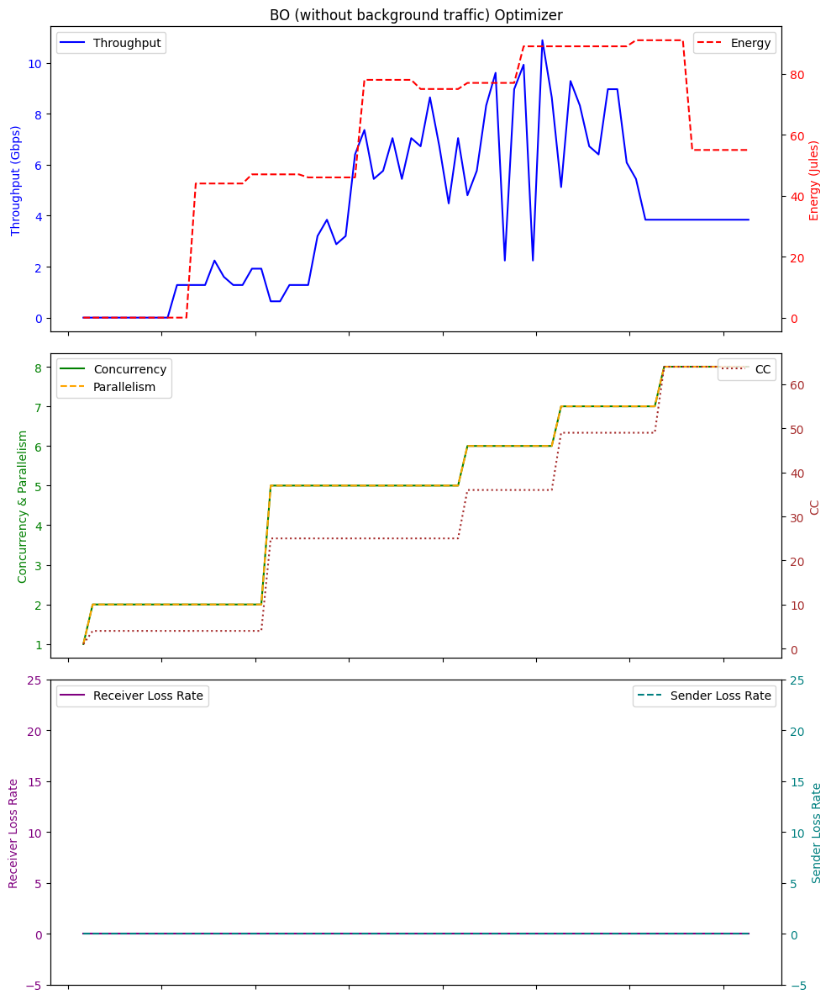

Average Throughput: 4.0888888888888895
Total Energy: 4126.0
Total loss rate: 0.002796072301772829
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:17:26.054897        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:17:27.050654        0.00          0.0  64    0.0   0.0   
2  2024-01-26 07:17:28.052265        0.00          0.0  64    0.0  32.7   
3  2024-01-26 07:17:29.054870        0.00          0.0  64    0.0  32.7   
4  2024-01-26 07:17:30.056583        0.00          0.0  64    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
88 2024-01-26 07:18:54.140404        0.32          0.0  16    0.0  32.7   
89 2024-01-26 07:18:55.140749        0.32          0.0  16    0.0  32.6   
90 2024-01-26 07:18:56.144088        0.32          0.0  16    0.0  32.6   
91 2024-01-26 07:18:57.143957        0.32          0.0  16    0.0  32.6   
92 2024-01-26 07:18:58.158088        0.32          0.0  16    0.0  32.7   

 

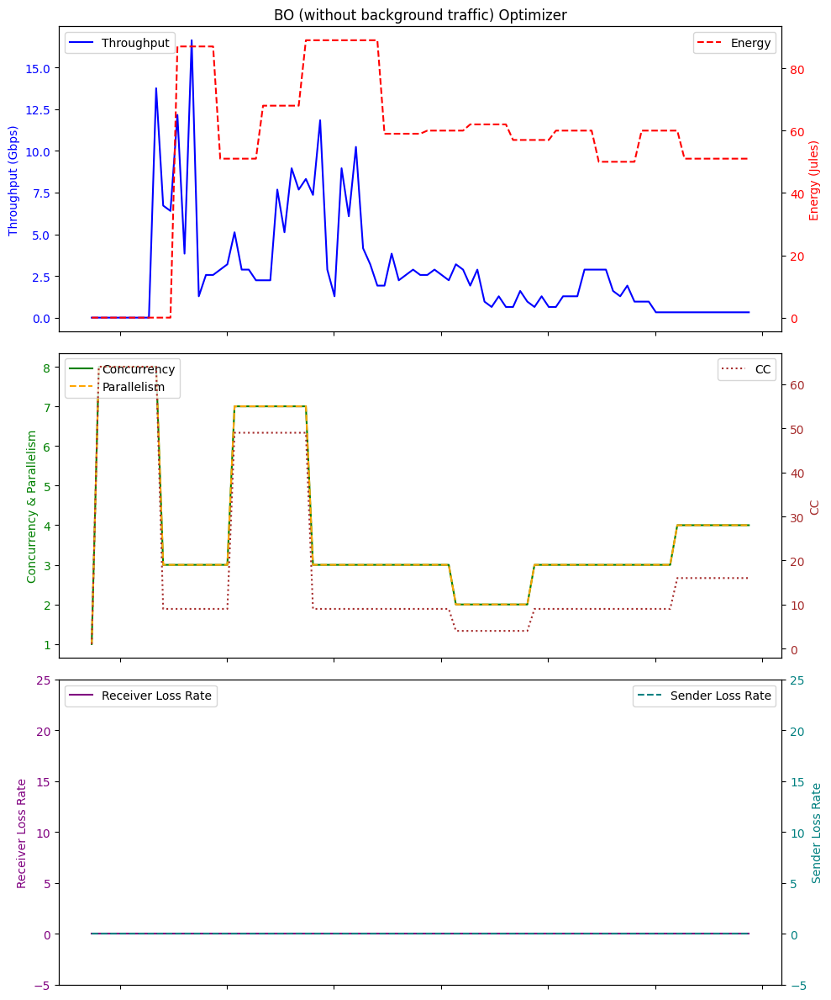

Average Throughput: 2.7939784946236554
Total Energy: 5173.0
Total loss rate: 0.011122658769601005
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:05:57.436998        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:05:58.432792        0.00          0.0   9    0.0   0.0   
2  2024-01-26 06:05:59.434395        0.00          0.0   9    0.0  32.8   
3  2024-01-26 06:06:00.435854        0.00          0.0   9    0.0  32.7   
4  2024-01-26 06:06:01.435881        0.00          0.0   9    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 06:06:54.490838        0.96          0.0  36    1.0  32.6   
58 2024-01-26 06:06:55.491140        0.96          0.0  36    1.0  32.6   
59 2024-01-26 06:06:56.494270        0.96          0.0  36    1.0  32.6   
60 2024-01-26 06:06:57.496415        0.96          0.0  36    1.0  32.7   
61 2024-01-26 06:06:58.497319        0.96          0.0  36    1.0  32.6   

 

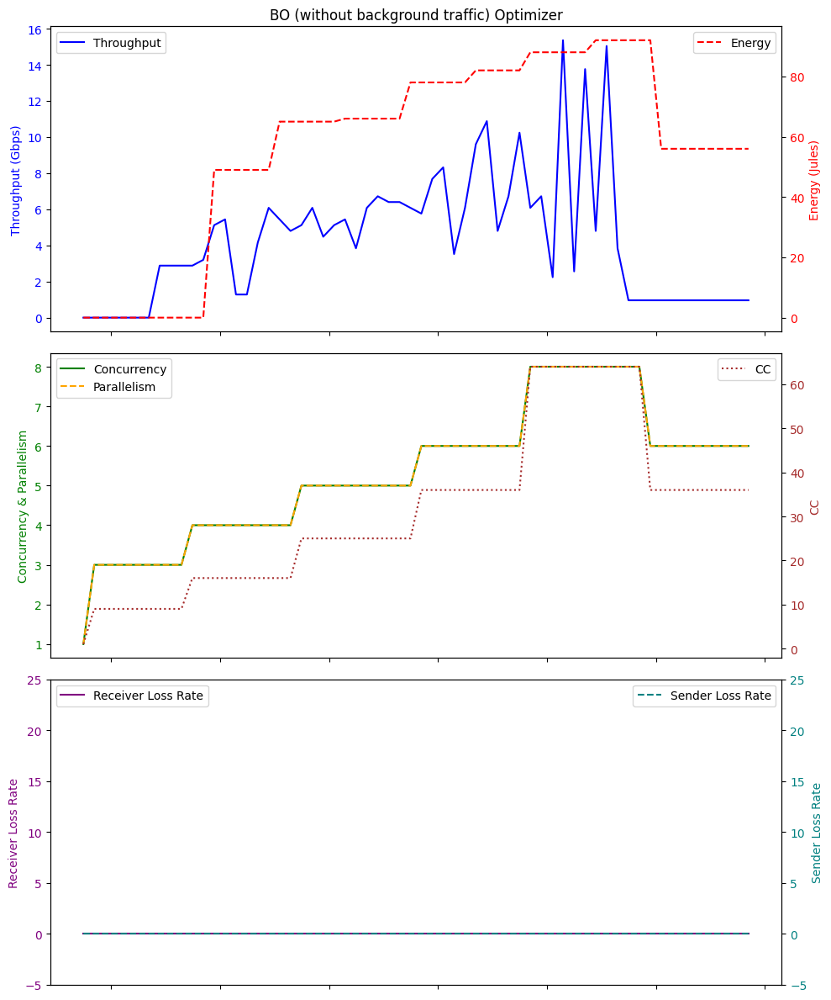

Average Throughput: 4.283870967741934
Total Energy: 3542.0
Total loss rate: 0.003300537254257433
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:54:39.019441        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:54:40.015333        0.00          0.0  36    0.0   0.0   
2  2024-01-26 06:54:41.016745        0.00          0.0  36    0.0  32.7   
3  2024-01-26 06:54:42.017903        0.00          0.0  36    0.0  32.7   
4  2024-01-26 06:54:43.018765        0.00          0.0  36    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 06:55:36.072224        0.32          0.0  16    0.0  32.7   
58 2024-01-26 06:55:37.072260        0.32          0.0  16    0.0  32.7   
59 2024-01-26 06:55:38.075737        0.32          0.0  16    0.0  32.8   
60 2024-01-26 06:55:39.075985        0.32          0.0  16    0.0  32.7   
61 2024-01-26 06:55:40.073804        0.32          0.0  16    0.0  32.7   

  

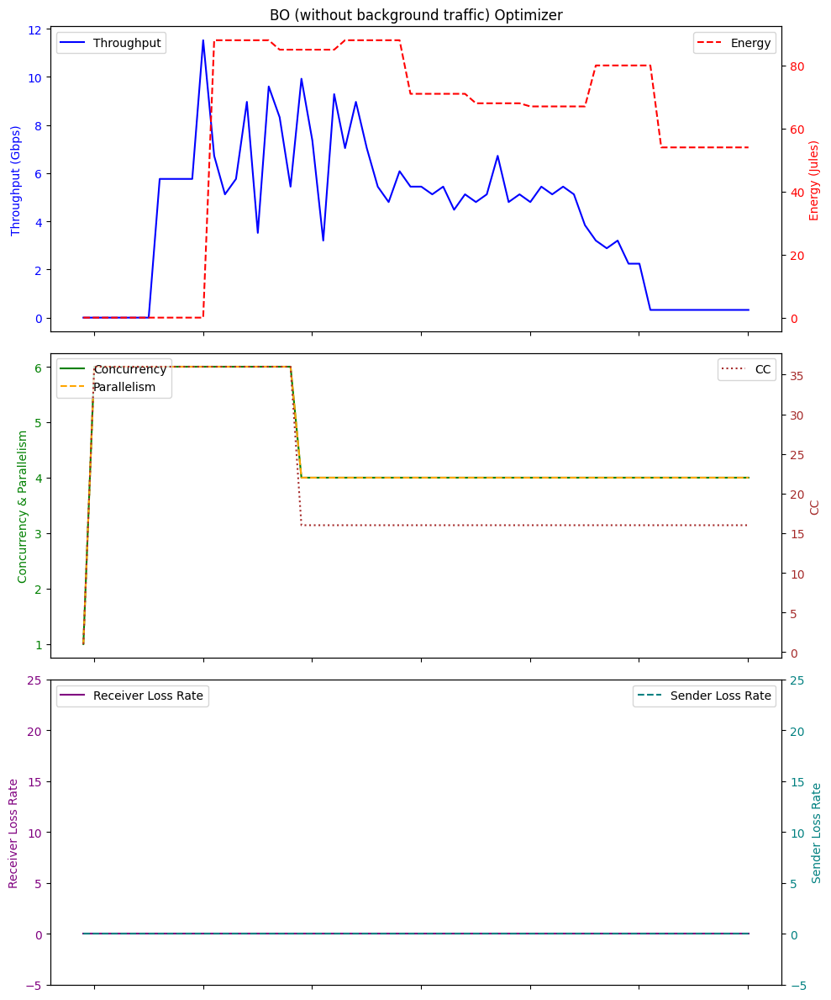

Average Throughput: 4.216774193548387
Total Energy: 3700.0
Total loss rate: 0.009810779208788511
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:16:08.615391        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:16:09.611530        0.00          0.0  36    0.0   0.0   
2   2024-01-26 06:16:10.614624        0.00          0.0  36    0.0  32.7   
3   2024-01-26 06:16:11.617018        0.00          0.0  36    0.0  32.7   
4   2024-01-26 06:16:12.615224        0.00          0.0  36    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
97  2024-01-26 06:17:45.711602        0.32          0.0  64    0.0  32.7   
98  2024-01-26 06:17:46.713386        0.32          0.0  64    0.0  32.7   
99  2024-01-26 06:17:47.714350        0.32          0.0  64    0.0  32.7   
100 2024-01-26 06:17:48.714483        0.32          0.0  64    0.0  32.7   
101 2024-01-26 06:17:49.716027        0.32          0.0  64    0.0 

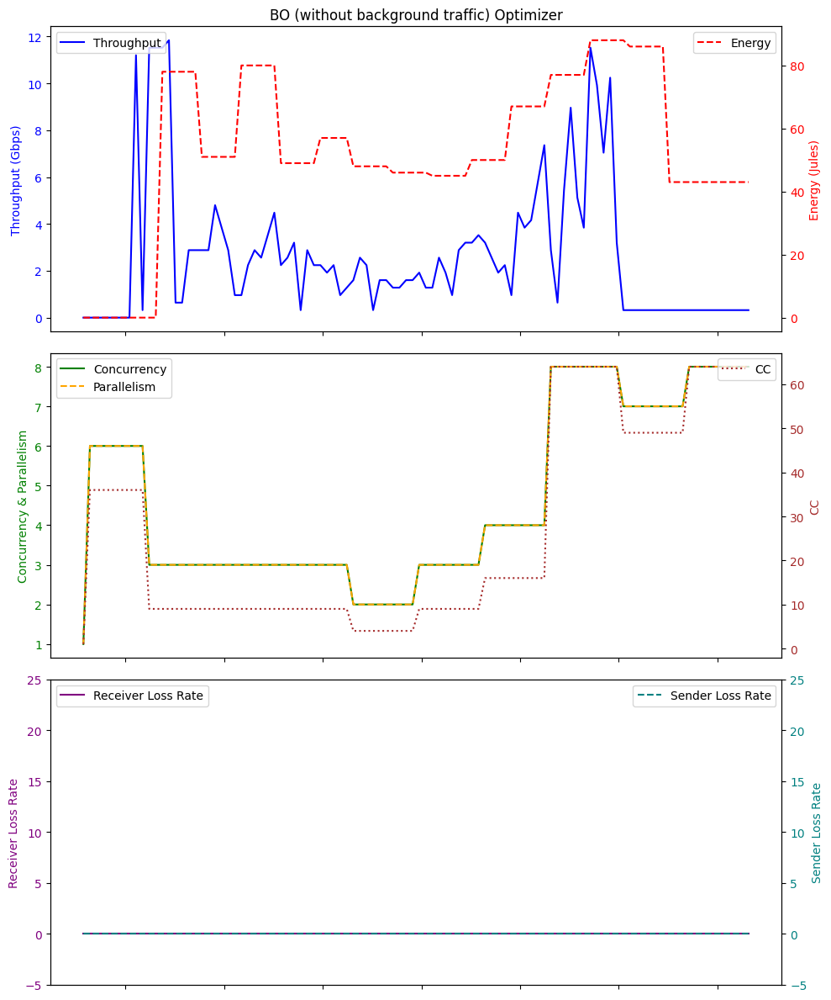

Average Throughput: 2.6666666666666665
Total Energy: 5434.0
Total loss rate: 0.0031367332386524867
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:28:06.923137        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:28:07.917990        0.00          0.0  16    0.0   0.0   
2  2024-01-26 07:28:08.921288        0.00          0.0  16    0.0  32.6   
3  2024-01-26 07:28:09.923107        0.00          0.0  16    0.0  32.7   
4  2024-01-26 07:28:10.921195        0.00          0.0  16    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 07:29:13.983826        1.92          0.0  64    2.0  32.8   
68 2024-01-26 07:29:14.984920        1.92          0.0  64    2.0  32.8   
69 2024-01-26 07:29:15.987282        1.92          0.0  64    2.0  32.7   
70 2024-01-26 07:29:16.987673        1.92          0.0  64    2.0  32.7   
71 2024-01-26 07:29:17.988529        1.92          0.0  64    2.0  32.8   



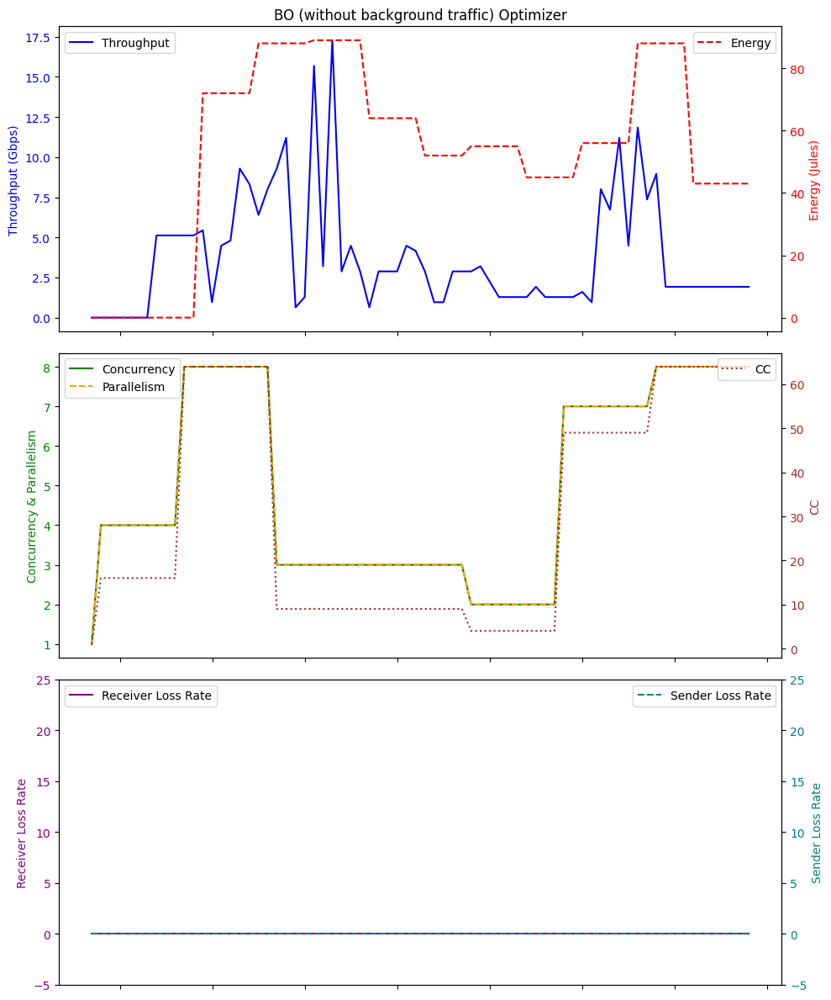

Average Throughput: 3.768888888888889
Total Energy: 3903.0
Total loss rate: 0.006719899804863844
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:50:03.633127         0.0          0.0   1    0.0   0.0   
1  2024-01-26 05:50:04.629689         0.0          0.0  36    0.0   0.0   
2  2024-01-26 05:50:05.629193         0.0          0.0  36    0.0  32.6   
3  2024-01-26 05:50:06.631994         0.0          0.0  36    0.0  32.6   
4  2024-01-26 05:50:07.631983         0.0          0.0  36    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
67 2024-01-26 05:51:10.697080         1.6          0.0  16    1.0  32.7   
68 2024-01-26 05:51:11.698264         1.6          0.0  16    1.0  32.7   
69 2024-01-26 05:51:12.700066         1.6          0.0  16    1.0  32.7   
70 2024-01-26 05:51:13.700048         1.6          0.0  16    1.0  32.7   
71 2024-01-26 05:51:14.692917         1.6          0.0  16    1.0  32.6   

  

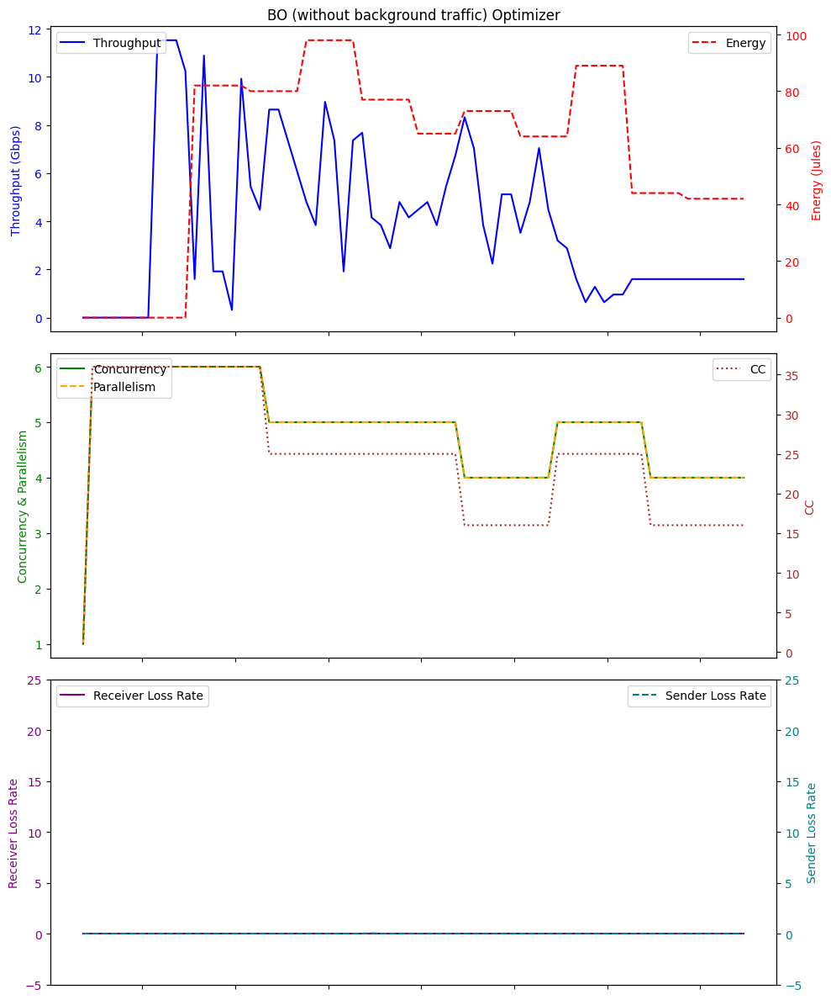

Average Throughput: 3.9377777777777783
Total Energy: 4261.0
Total loss rate: 0.03989089814545065
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 07:43:37.769121        0.00          0.0   1    0.0   0.0   
1   2024-01-26 07:43:38.764762        0.00          0.0   9    0.0   0.0   
2   2024-01-26 07:43:39.764451        0.00          0.0   9    0.0  32.6   
3   2024-01-26 07:43:40.767081        0.00          0.0   9    0.0  32.8   
4   2024-01-26 07:43:41.768114        0.00          0.0   9    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
97  2024-01-26 07:45:14.861269        0.32          0.0  25    0.0  32.8   
98  2024-01-26 07:45:15.863684        0.32          0.0  25    0.0  32.7   
99  2024-01-26 07:45:16.864492        0.32          0.0  25    0.0  32.7   
100 2024-01-26 07:45:17.864544        0.32          0.0  25    0.0  32.7   
101 2024-01-26 07:45:18.866303        0.32          0.0  25    0.0 

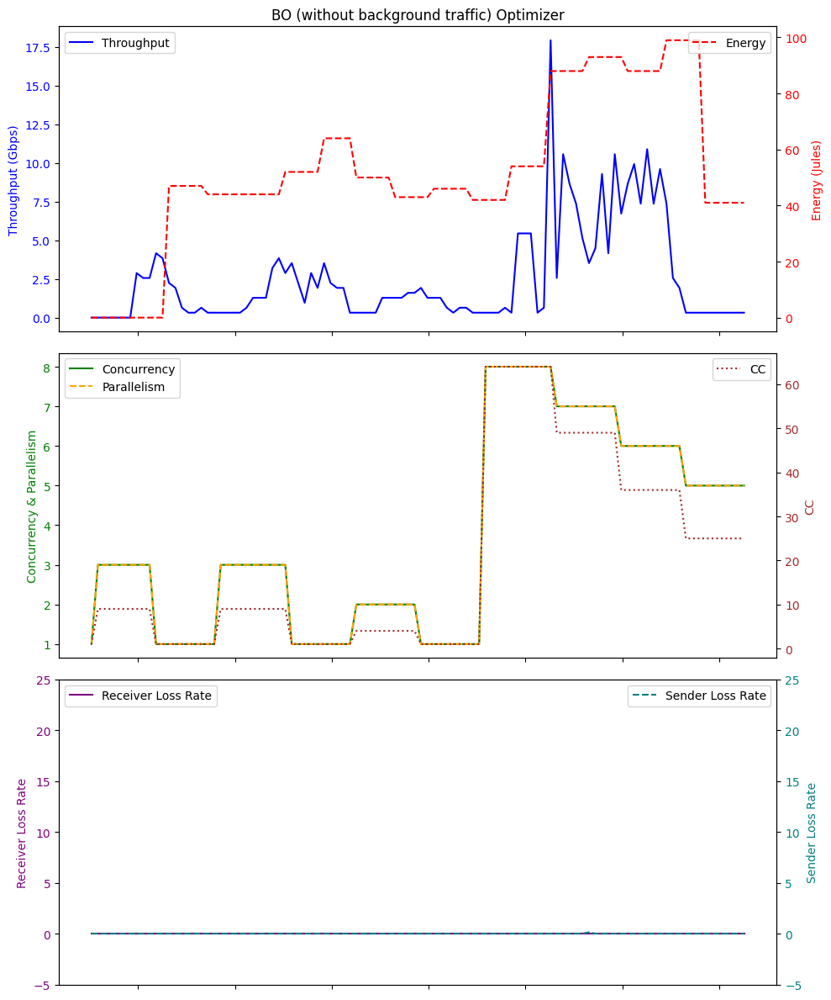

Average Throughput: 2.5192156862745096
Total Energy: 5347.0
Total loss rate: 0.13654811544288414
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:33:19.299271        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:33:20.294854        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:33:21.296194        0.00          0.0  49    0.0  32.9   
3  2024-01-26 07:33:22.298219        0.00          0.0  49    0.0  32.8   
4  2024-01-26 07:33:23.297911        0.00          0.0  49    0.0  32.6   
5  2024-01-26 07:33:24.298182        0.00          0.0  49    0.0  32.8   
6  2024-01-26 07:33:25.303605        0.00          0.0  49    0.0  32.8   
7  2024-01-26 07:33:26.303641        0.00          0.0  49    0.0  32.6   
8  2024-01-26 07:33:27.307200        6.40          0.0  49    6.0  33.0   
9  2024-01-26 07:33:28.293900        7.04          0.0  49    6.0  32.8   
10 2024-01-26 07:33:29.298043        7.04          0.0  64    6.0  38.1   
11 

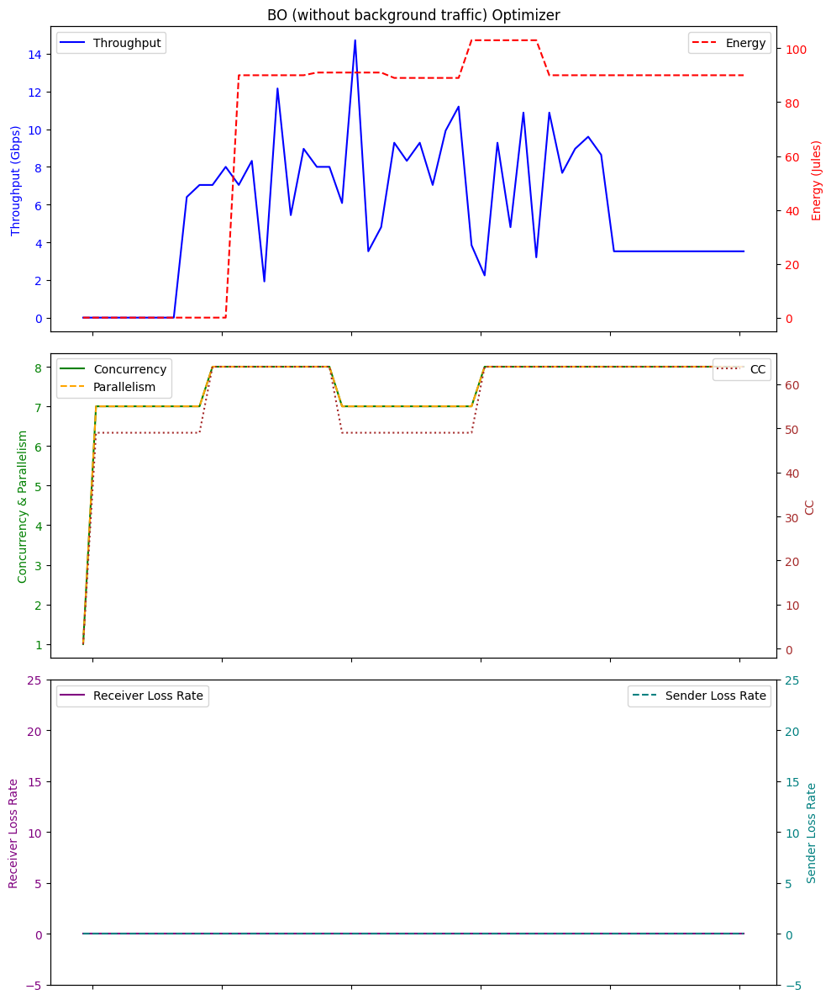

Average Throughput: 5.599999999999999
Total Energy: 3678.0
Total loss rate: 0.0083460061644219
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:37:45.432422        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:37:46.425077        0.00          0.0  64    0.0   0.0   
2   2024-01-26 06:37:47.425976        0.00          0.0  64    0.0  32.7   
3   2024-01-26 06:37:48.428752        0.00          0.0  64    0.0  32.6   
4   2024-01-26 06:37:49.430074        0.00          0.0  64    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
97  2024-01-26 06:39:22.520634        0.96          0.0  16    1.0  32.7   
98  2024-01-26 06:39:23.524522        0.96          0.0  16    1.0  32.7   
99  2024-01-26 06:39:24.524006        0.96          0.0  16    1.0  32.7   
100 2024-01-26 06:39:25.526990        0.96          0.0  16    1.0  32.7   
101 2024-01-26 06:39:26.526296        0.96          0.0  16    1.0  3

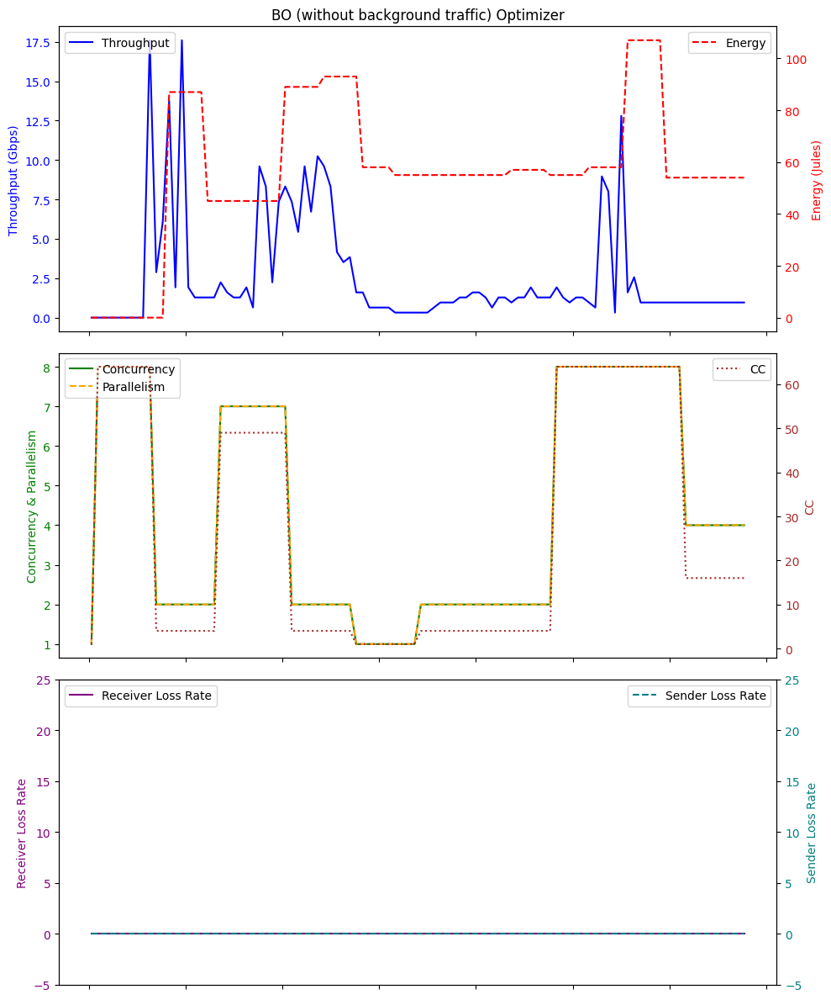

Average Throughput: 2.647843137254901
Total Energy: 5798.0
Total loss rate: 0.004439334550692097
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:27:16.260213        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:27:17.256411        0.00          0.0  25    0.0   0.0   
2  2024-01-26 06:27:18.256010        0.00          0.0  25    0.0  32.7   
3  2024-01-26 06:27:19.258604        0.00          0.0  25    0.0  32.7   
4  2024-01-26 06:27:20.259262        0.00          0.0  25    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
57 2024-01-26 06:28:13.312230        0.64          0.0  36    1.0  32.7   
58 2024-01-26 06:28:14.309439        0.64          0.0  36    1.0  32.6   
59 2024-01-26 06:28:15.312485        0.64          0.0  36    1.0  32.7   
60 2024-01-26 06:28:16.313871        0.64          0.0  36    1.0  32.7   
61 2024-01-26 06:28:17.313607        0.64          0.0  36    1.0  32.7   

  

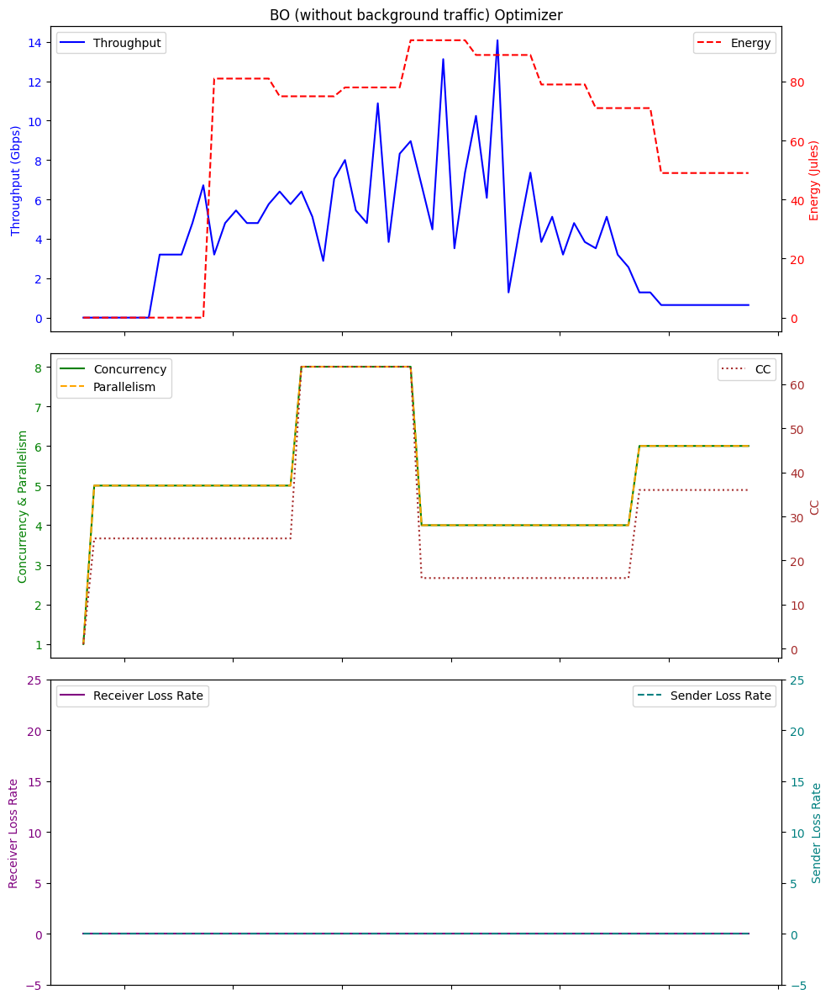

Average Throughput: 4.129032258064515
Total Energy: 3764.0
Total loss rate: 0.014235102742043752


In [11]:
# Example usage BO
directory = './logFileDir_simu_w_bg/BO/'
dfs = process_log_files(directory,"BO_logFile_")

bo_throughput_list=[]
bo_energy_list=[]
bo_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('BO (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
#     plt.savefig('withBT.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    bo_throughput_list.append(average_throughput)
    bo_energy_list.append(total_energy)
    bo_plr_list.append(total_plr)


                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:52:36.766229        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:52:37.762705        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:52:38.763519        0.00          0.0   1    0.0  32.7   
3   2024-01-26 06:52:39.765088        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:52:40.765614        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 06:54:31.881212        0.32          0.0  16    0.0  32.6   
116 2024-01-26 06:54:32.880848        0.32          0.0  16    0.0  32.7   
117 2024-01-26 06:54:33.881530        0.32          0.0  16    0.0  32.6   
118 2024-01-26 06:54:34.884110        0.32          0.0  16    0.0  32.7   
119 2024-01-26 06:54:35.885566        0.32          0.0  16    0.0  32.7   

     Energy  sender_lr  concurrency  parallelism  
0       0.0        0.0            1 

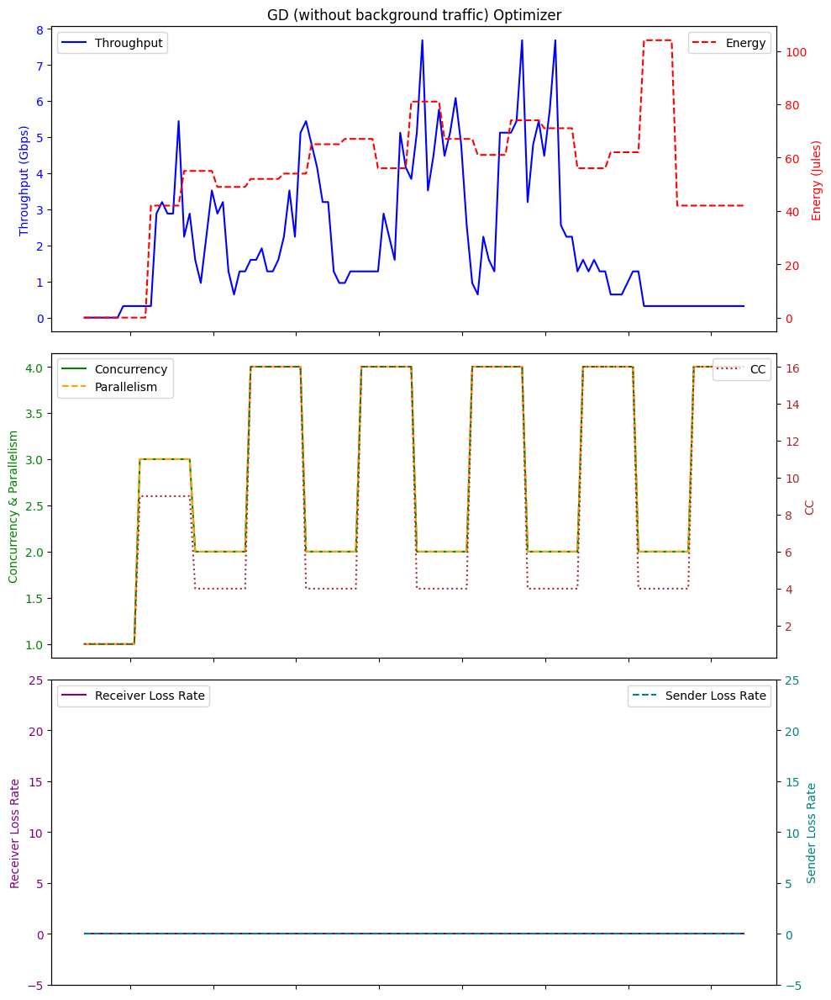

Average Throughput: 2.1679999999999997
Total Energy: 6588.0
Total loss rate: 0.0005969444190999284
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:30:34.915358         0.0          0.0   1    0.0   0.0   
1  2024-01-26 06:30:35.912201         0.0          0.0   1    0.0   0.0   
2  2024-01-26 06:30:36.911695         0.0          0.0   1    0.0  32.6   
3  2024-01-26 06:30:37.915170         0.0          0.0   1    0.0  32.6   
4  2024-01-26 06:30:38.914936         0.0          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 06:32:10.011364         1.6          0.0  25    1.0  32.6   
96 2024-01-26 06:32:11.009725         1.6          0.0  25    1.0  32.8   
97 2024-01-26 06:32:12.011929         1.6          0.0  25    1.0  32.6   
98 2024-01-26 06:32:13.012227         1.6          0.0  25    1.0  32.6   
99 2024-01-26 06:32:14.012004         1.6          0.0  25    1.0  32.7   



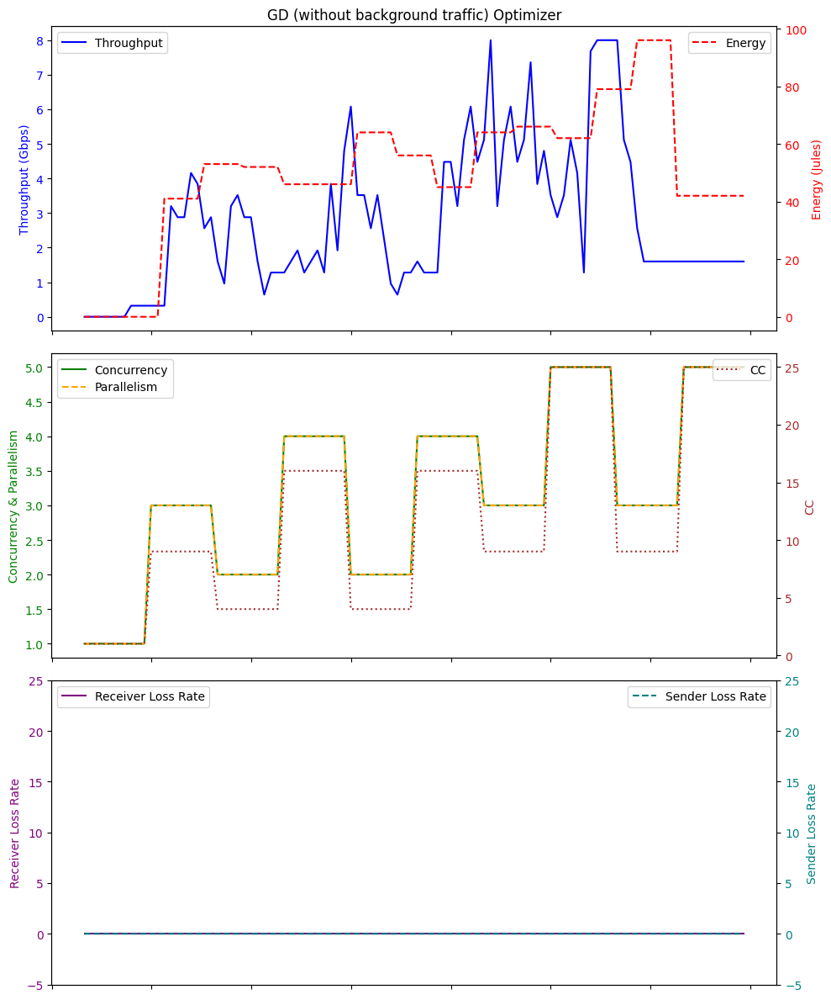

Average Throughput: 2.7552000000000008
Total Energy: 5036.0
Total loss rate: 0.01083840774434653
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:09:58.026321        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:09:59.022360        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:10:00.025513        0.00          0.0   1    0.0  32.6   
3   2024-01-26 05:10:01.025182        0.00          0.0   1    0.0  32.7   
4   2024-01-26 05:10:02.025485        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 05:11:43.131532        0.32          0.0   4    0.0  32.8   
106 2024-01-26 05:11:44.133981        0.32          0.0   4    0.0  32.7   
107 2024-01-26 05:11:45.135343        0.32          0.0   4    0.0  32.7   
108 2024-01-26 05:11:46.134888        0.32          0.0   4    0.0  32.6   
109 2024-01-26 05:11:47.138074        0.32          0.0   4    0.0 

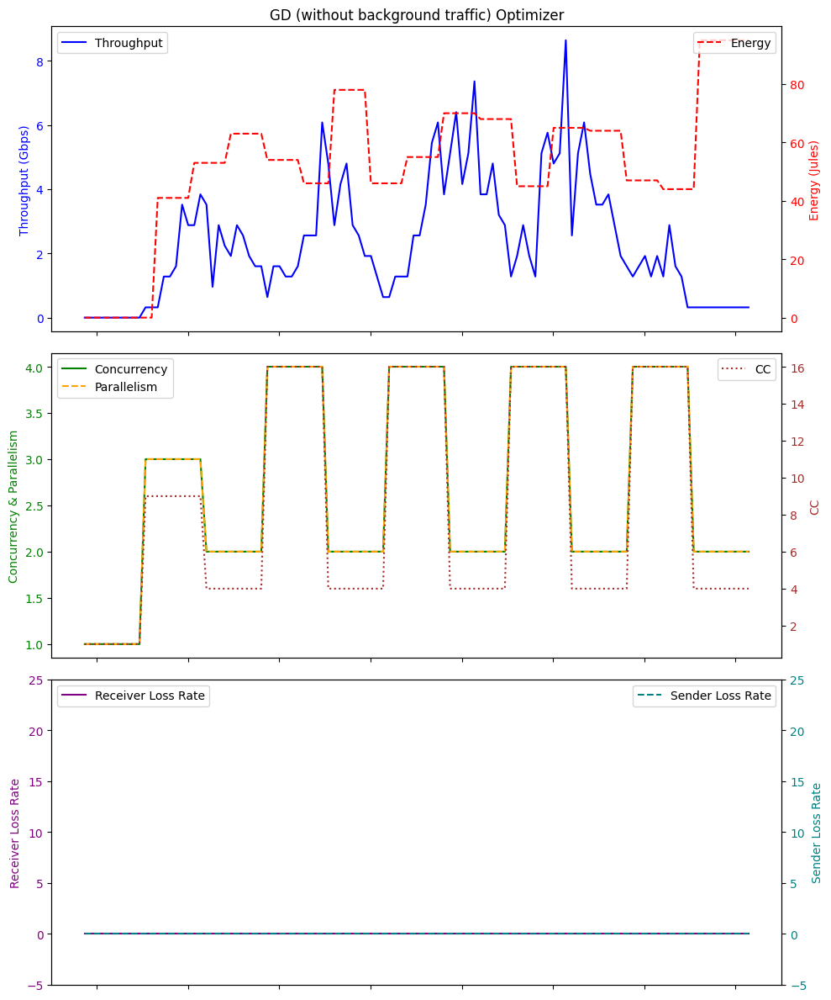

Average Throughput: 2.3447272727272725
Total Energy: 5843.0
Total loss rate: 0.003609654978209251
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:15:53.758205        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:15:54.753352        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:15:55.753007        0.00          0.0   1    0.0  32.7   
3   2024-01-26 05:15:56.753832        0.00          0.0   1    0.0  32.7   
4   2024-01-26 05:15:57.756221        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 05:17:48.871728        0.32          0.0  16    0.0  32.7   
116 2024-01-26 05:17:49.871594        0.32          0.0  16    0.0  32.7   
117 2024-01-26 05:17:50.873723        0.32          0.0  16    0.0  32.7   
118 2024-01-26 05:17:51.874809        0.32          0.0  16    0.0  32.5   
119 2024-01-26 05:17:52.875859        0.32          0.0  16    0.0

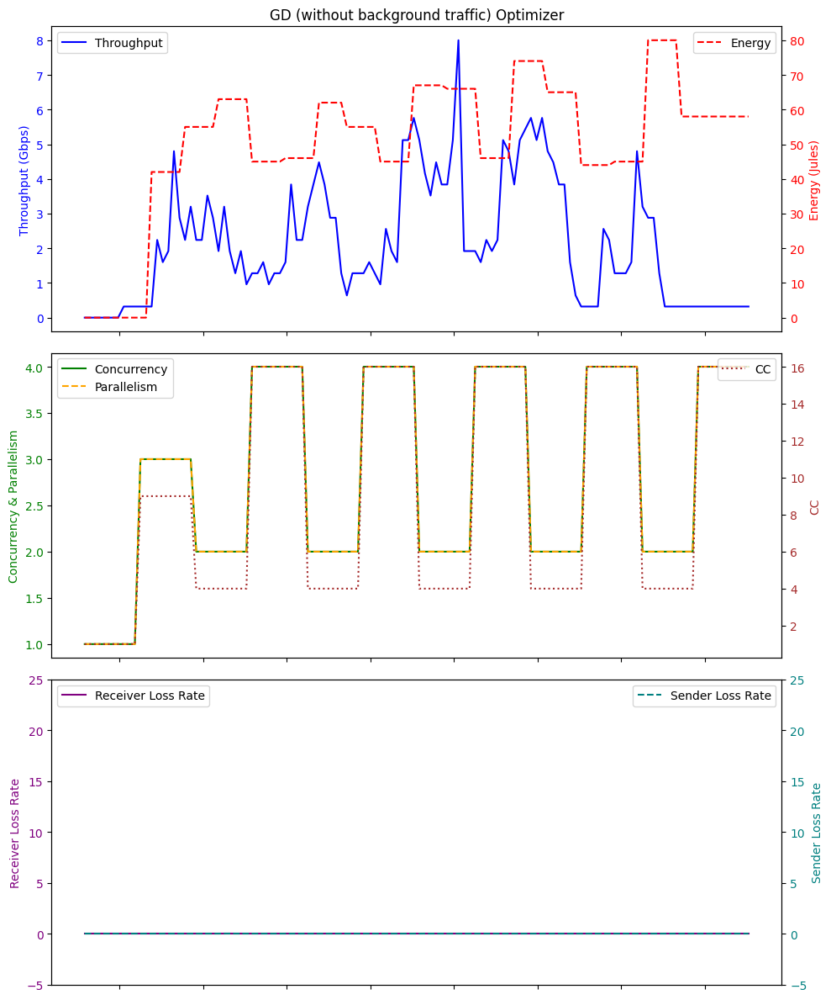

Average Throughput: 2.1413333333333338
Total Energy: 6092.0
Total loss rate: 0.013409092224749968
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 07:10:08.955119        0.00          0.0   1    0.0   0.0   
1   2024-01-26 07:10:09.948477        0.00          0.0   1    0.0   0.0   
2   2024-01-26 07:10:10.948583        0.00          0.0   1    0.0  32.7   
3   2024-01-26 07:10:11.951241        0.00          0.0   1    0.0  32.7   
4   2024-01-26 07:10:12.952232        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
125 2024-01-26 07:12:14.080230        0.32          0.0   4    0.0  32.6   
126 2024-01-26 07:12:15.082823        0.32          0.0   4    0.0  32.6   
127 2024-01-26 07:12:16.083144        0.32          0.0   4    0.0  32.6   
128 2024-01-26 07:12:17.083696        0.32          0.0   4    0.0  32.8   
129 2024-01-26 07:12:18.084609        0.32          0.0   4    0.0

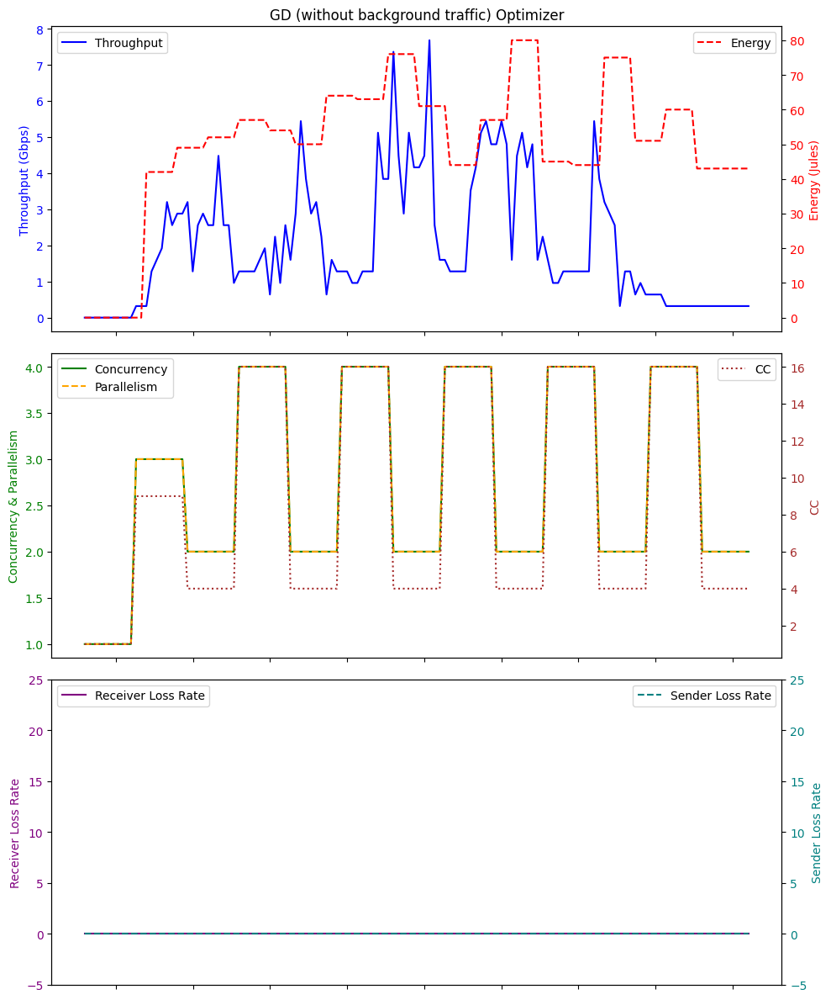

Average Throughput: 1.9963076923076921
Total Energy: 6563.0
Total loss rate: 0.010158900933866542
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:15:39.955593        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:15:40.951579        0.00          0.0   1    0.0   0.0   
2  2024-01-26 07:15:41.951440        0.00          0.0   1    0.0  32.7   
3  2024-01-26 07:15:42.952190        0.00          0.0   1    0.0  32.6   
4  2024-01-26 07:15:43.952139        0.00          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 07:17:15.049270        0.32          0.0  36    0.0  32.7   
96 2024-01-26 07:17:16.050518        0.32          0.0  36    0.0  32.7   
97 2024-01-26 07:17:17.050299        0.32          0.0  36    0.0  32.8   
98 2024-01-26 07:17:18.053514        0.32          0.0  36    0.0  32.7   
99 2024-01-26 07:17:19.053582        0.32          0.0  36    0.0  32.8   

 

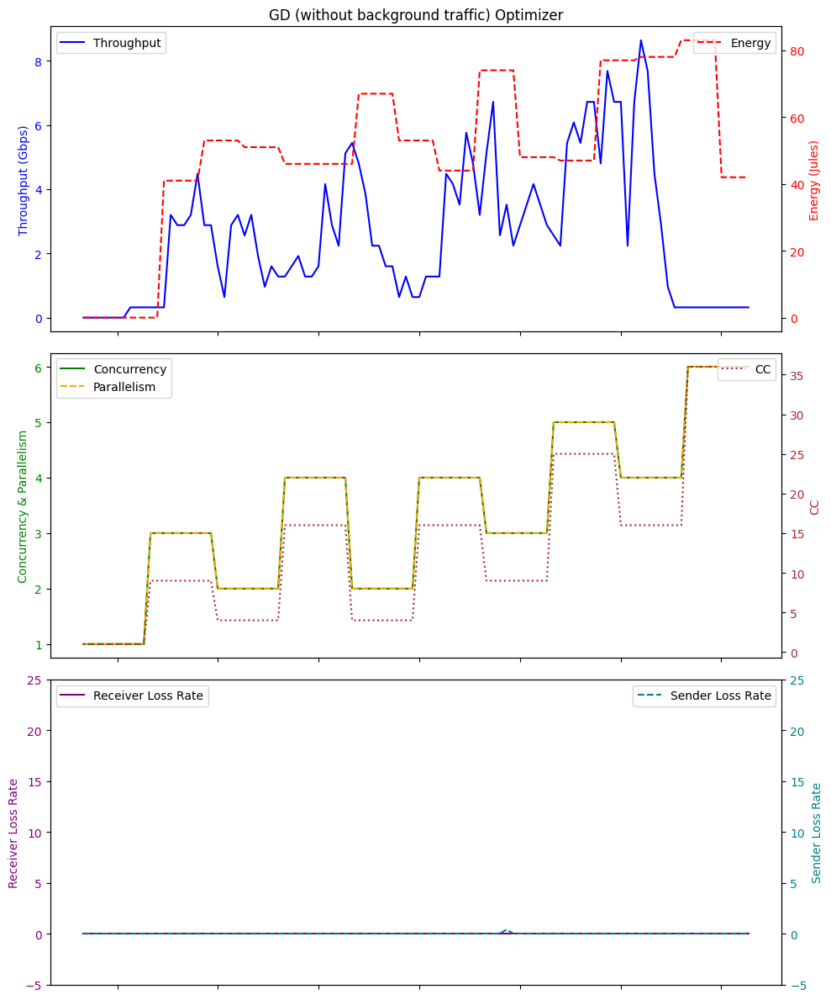

Average Throughput: 2.5791999999999997
Total Energy: 5012.0
Total loss rate: 0.4131436847814557
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:09:05.630038        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:09:06.627857        0.00          0.0   1    0.0   0.0   
2  2024-01-26 06:09:07.625865        0.00          0.0   1    0.0  32.6   
3  2024-01-26 06:09:08.627029        0.00          0.0   1    0.0  32.6   
4  2024-01-26 06:09:09.628968        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 06:10:40.724538        0.96          0.0  25    1.0  32.7   
96 2024-01-26 06:10:41.726143        0.96          0.0  25    1.0  32.7   
97 2024-01-26 06:10:42.726758        0.96          0.0  25    1.0  32.7   
98 2024-01-26 06:10:43.726400        0.96          0.0  25    1.0  32.7   
99 2024-01-26 06:10:44.729921        0.96          0.0  25    1.0  32.6   

   

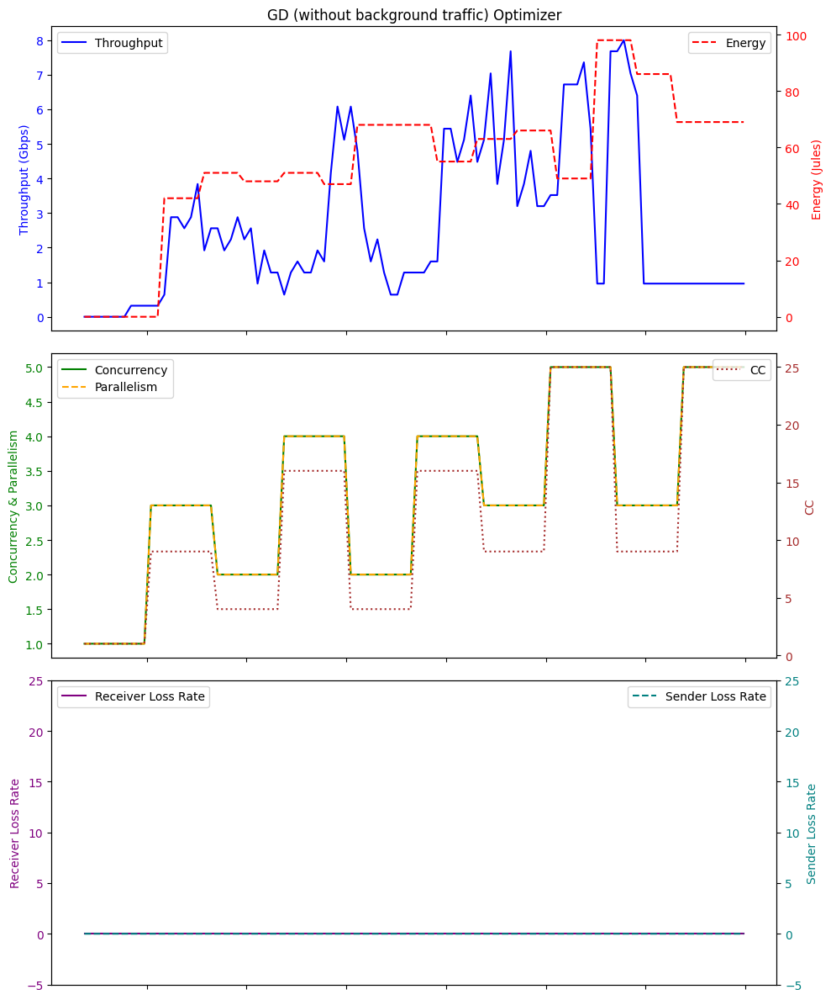

Average Throughput: 2.6719999999999993
Total Energy: 5464.0
Total loss rate: 0.003463717187251949
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 07:21:04.954670        0.00          0.0   1    0.0   0.0   
1   2024-01-26 07:21:05.951241        0.00          0.0   1    0.0   0.0   
2   2024-01-26 07:21:06.953803        0.00          0.0   1    0.0  32.7   
3   2024-01-26 07:21:07.953832        0.00          0.0   1    0.0  32.7   
4   2024-01-26 07:21:08.953940        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 07:23:00.076608        0.32          0.0  16    0.0  32.8   
116 2024-01-26 07:23:01.072666        0.32          0.0  16    0.0  32.6   
117 2024-01-26 07:23:02.075316        0.32          0.0  16    0.0  32.7   
118 2024-01-26 07:23:03.076134        0.32          0.0  16    0.0  32.6   
119 2024-01-26 07:23:04.076021        0.32          0.0  16    0.0

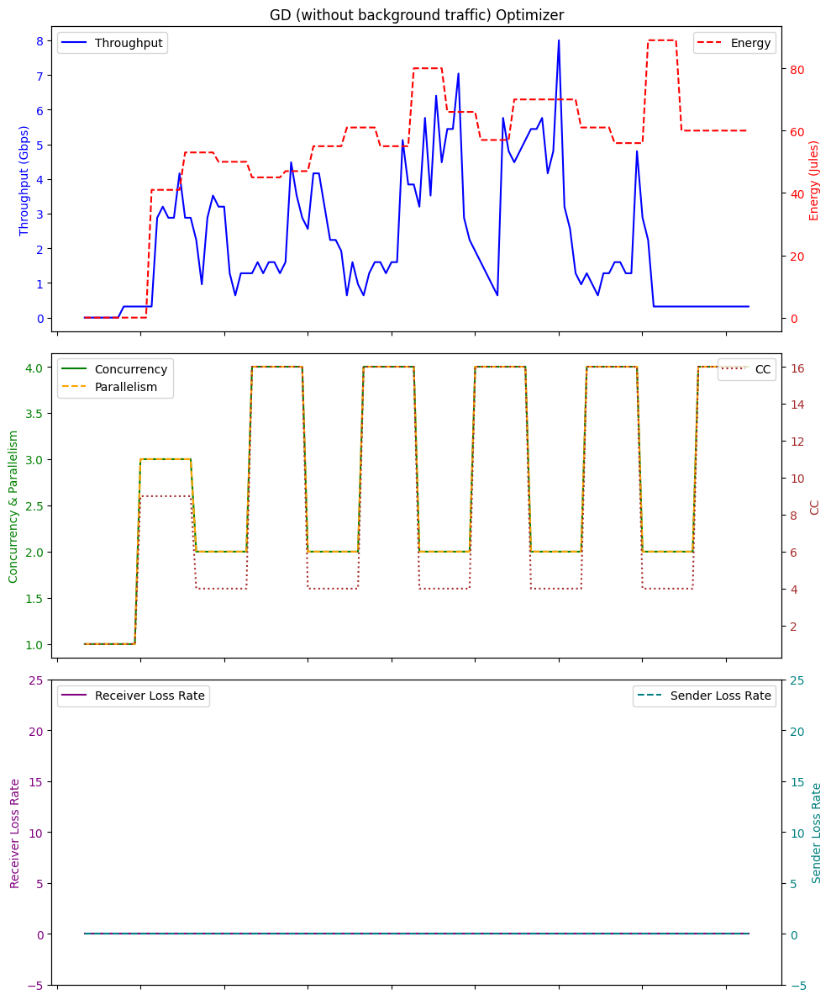

Average Throughput: 2.146666666666667
Total Energy: 6469.0
Total loss rate: 0.0062054643057500684
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:41:55.528115        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:41:56.527943        0.00          0.0   1    0.0   0.0   
2  2024-01-26 07:41:57.529416        0.00          0.0   1    0.0  32.7   
3  2024-01-26 07:41:58.530857        0.00          0.0   1    0.0  32.6   
4  2024-01-26 07:41:59.530866        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 07:43:30.627663        7.36          0.0  25    7.0  32.7   
96 2024-01-26 07:43:31.627755        7.36          0.0  25    7.0  32.7   
97 2024-01-26 07:43:32.627282        7.36          0.0  25    7.0  32.6   
98 2024-01-26 07:43:33.629793        7.36          0.0  25    7.0  32.8   
99 2024-01-26 07:43:34.632028        7.36          0.0  25    7.0  32.8   

 

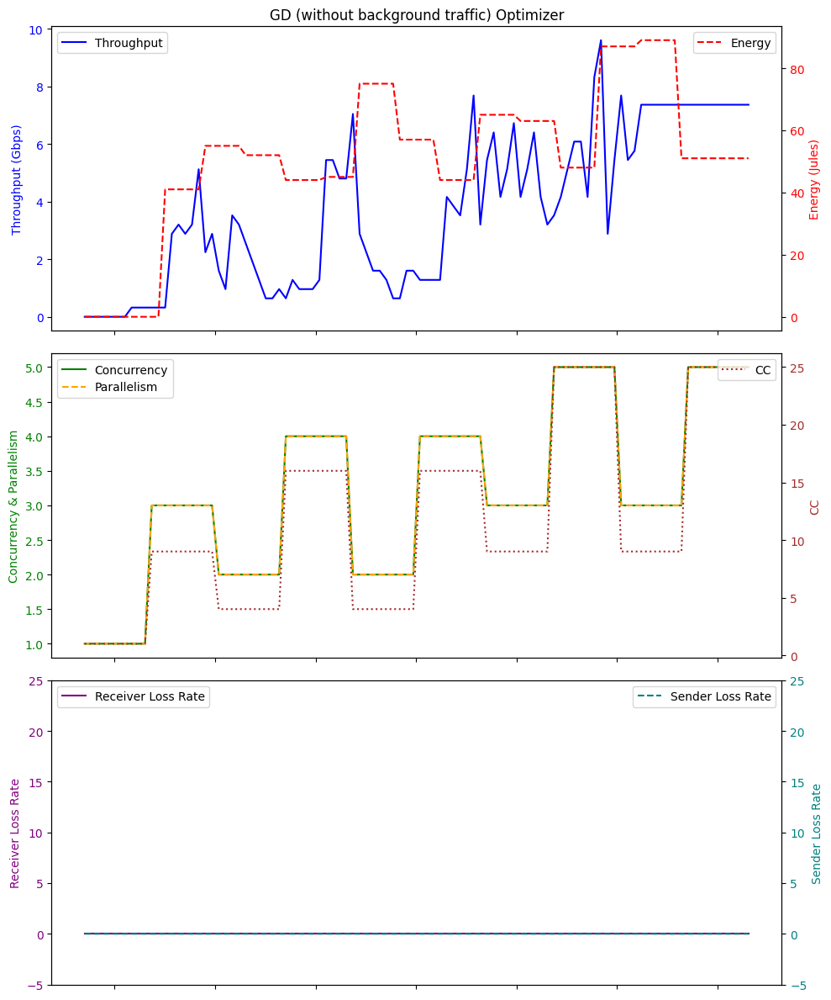

Average Throughput: 3.721600000000001
Total Energy: 5106.0
Total loss rate: 0.008840962658808104
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:04:32.065255        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:04:33.059310        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:04:34.059684        0.00          0.0   1    0.0  32.6   
3   2024-01-26 05:04:35.064224        0.00          0.0   1    0.0  32.6   
4   2024-01-26 05:04:36.063879        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 05:06:17.164788        0.96          0.0   4    1.0  32.7   
106 2024-01-26 05:06:18.166401        0.96          0.0   4    1.0  32.9   
107 2024-01-26 05:06:19.166014        0.96          0.0   4    1.0  32.7   
108 2024-01-26 05:06:20.165941        0.96          0.0   4    1.0  32.8   
109 2024-01-26 05:06:21.170121        0.96          0.0   4    1.0 

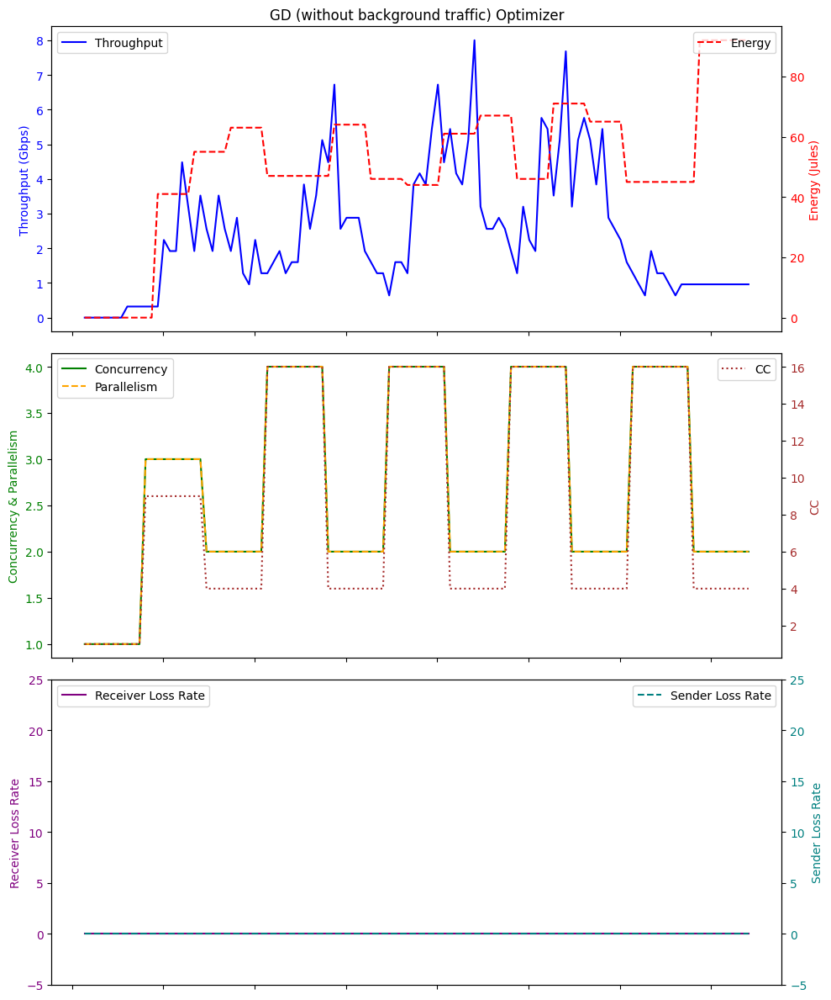

Average Throughput: 2.4116363636363625
Total Energy: 5623.0
Total loss rate: 0.0040436630138181075
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:32:18.466061        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:32:19.462708        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:32:20.465199        0.00          0.0   1    0.0  32.7   
3   2024-01-26 05:32:21.464880        0.00          0.0   1    0.0  32.8   
4   2024-01-26 05:32:22.466897        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 05:34:13.583264        0.32          0.0  16    0.0  32.7   
116 2024-01-26 05:34:14.587619        0.32          0.0  16    0.0  32.7   
117 2024-01-26 05:34:15.585243        0.32          0.0  16    0.0  32.6   
118 2024-01-26 05:34:16.586891        0.32          0.0  16    0.0  32.8   
119 2024-01-26 05:34:17.587199        0.32          0.0  16    0.

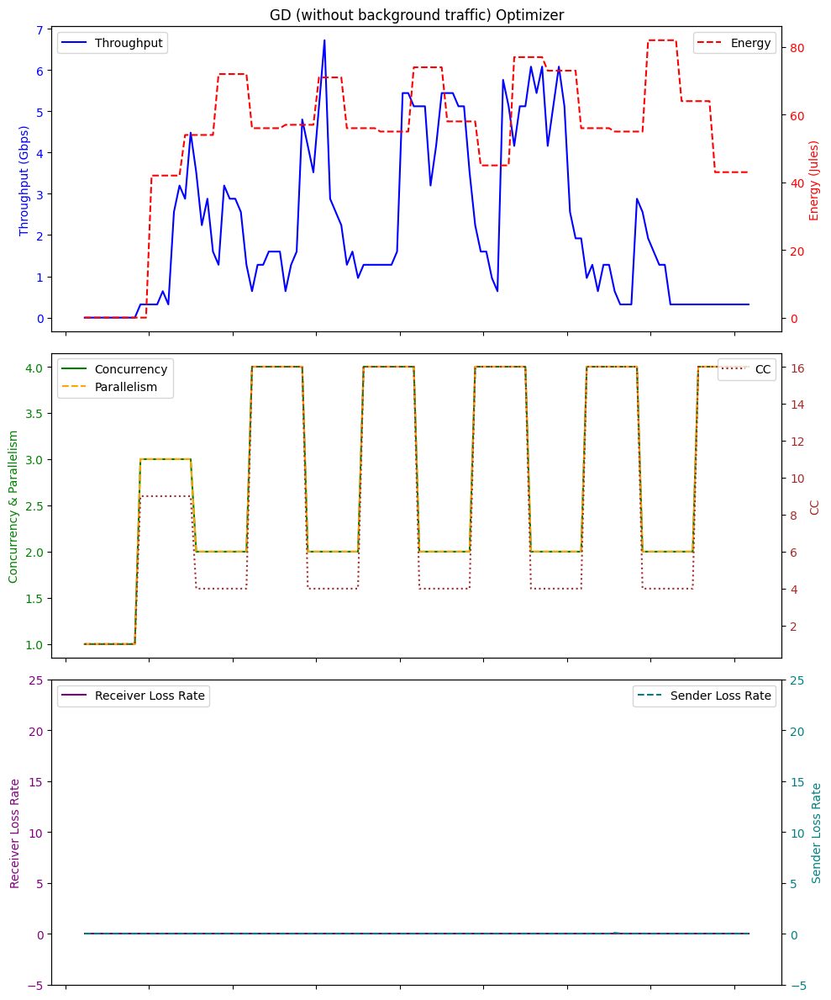

Average Throughput: 2.168
Total Energy: 6512.0
Total loss rate: 0.09255983950666594
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:41:44.039021        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:41:45.034677        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:41:46.034581        0.00          0.0   1    0.0  32.7   
3   2024-01-26 06:41:47.036448        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:41:48.037388        0.00          0.0   1    0.0  32.8   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 06:43:39.155044        0.64          0.0  16    1.0  32.7   
116 2024-01-26 06:43:40.154860        0.64          0.0  16    1.0  32.7   
117 2024-01-26 06:43:41.156265        0.64          0.0  16    1.0  32.7   
118 2024-01-26 06:43:42.157995        0.64          0.0  16    1.0  32.7   
119 2024-01-26 06:43:43.158562        0.64          0.0  16    1.0  32.7   

   

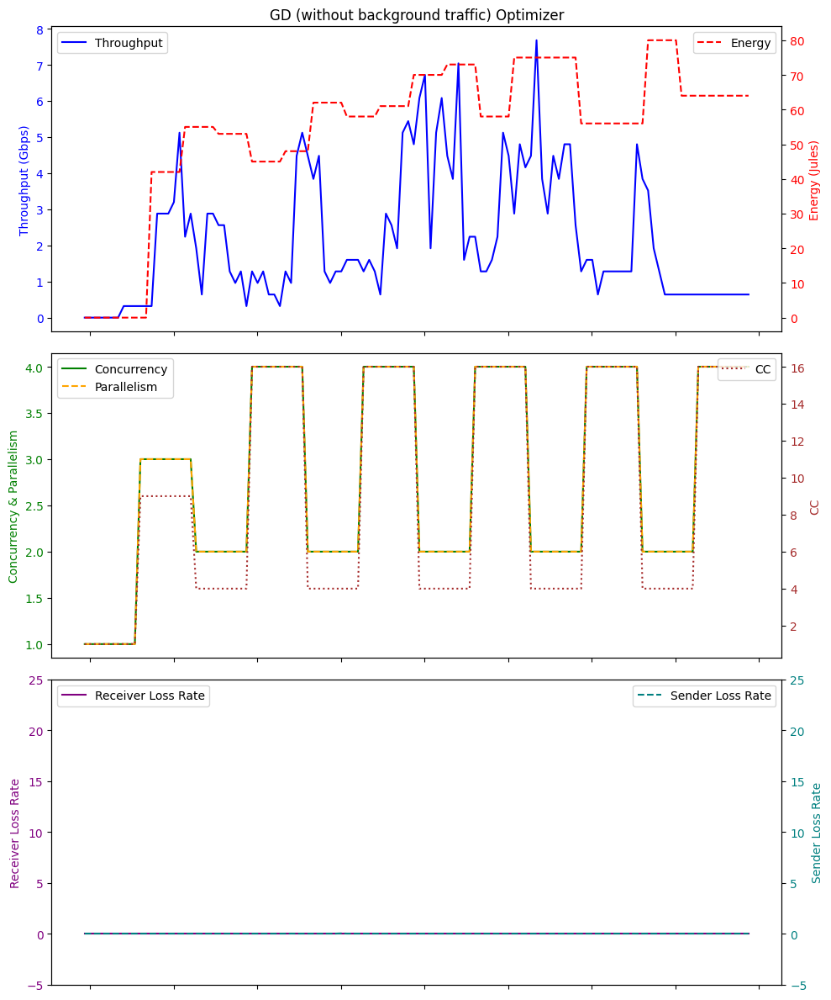

Average Throughput: 2.176
Total Energy: 6586.0
Total loss rate: 0.029833753974740237
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:57:49.475698        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:57:50.473463        0.00          0.0   1    0.0   0.0   
2  2024-01-26 06:57:51.474203        0.00          0.0   1    0.0  32.7   
3  2024-01-26 06:57:52.474157        0.00          0.0   1    0.0  32.8   
4  2024-01-26 06:57:53.476185        0.00          0.0   1    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 06:59:24.571647        0.32          0.0  36    0.0  32.8   
96 2024-01-26 06:59:25.573152        0.32          0.0  36    0.0  32.7   
97 2024-01-26 06:59:26.573428        0.32          0.0  36    0.0  32.9   
98 2024-01-26 06:59:27.574086        0.32          0.0  36    0.0  32.7   
99 2024-01-26 06:59:28.576897        0.32          0.0  36    0.0  32.6   

    Energy  se

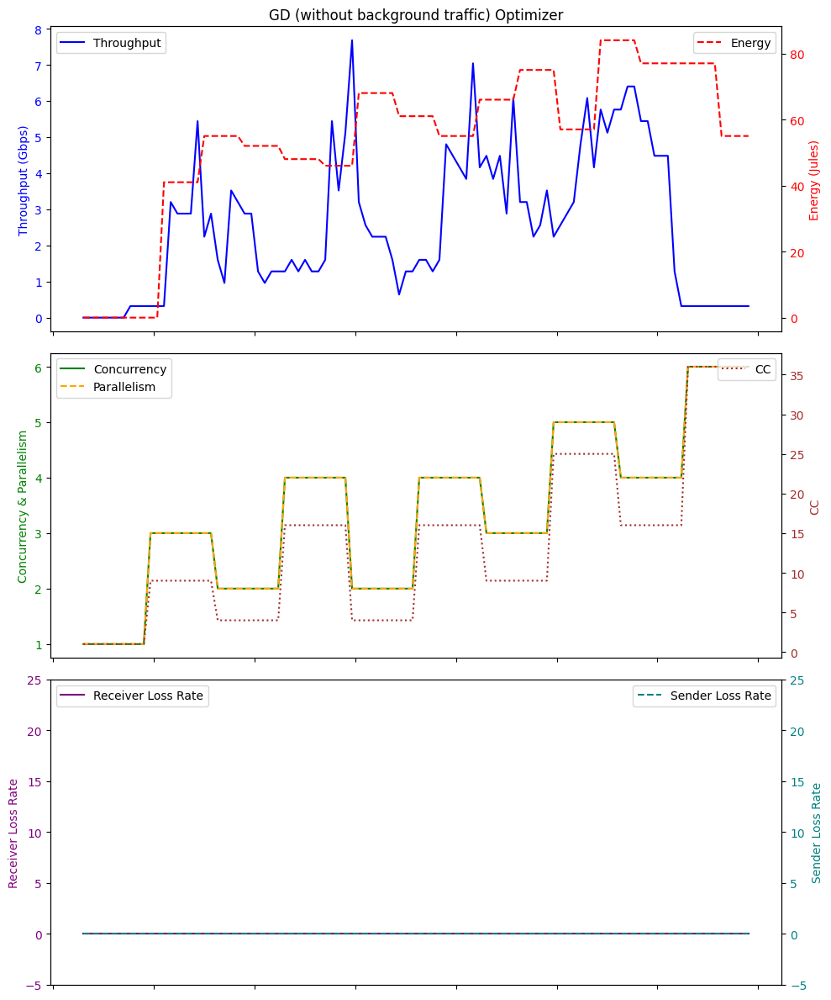

Average Throughput: 2.5439999999999996
Total Energy: 5401.0
Total loss rate: 0.0016070891541477535
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:47:04.047593        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:47:05.045407        0.00          0.0   1    0.0   0.0   
2  2024-01-26 06:47:06.044788        0.00          0.0   1    0.0  32.6   
3  2024-01-26 06:47:07.044866        0.00          0.0   1    0.0  32.7   
4  2024-01-26 06:47:08.048912        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 06:48:39.142468        0.32          0.0  25    0.0  32.9   
96 2024-01-26 06:48:40.142702        0.32          0.0  25    0.0  32.7   
97 2024-01-26 06:48:41.143778        0.32          0.0  25    0.0  32.8   
98 2024-01-26 06:48:42.145491        0.32          0.0  25    0.0  32.8   
99 2024-01-26 06:48:43.145043        0.32          0.0  25    0.0  32.8   



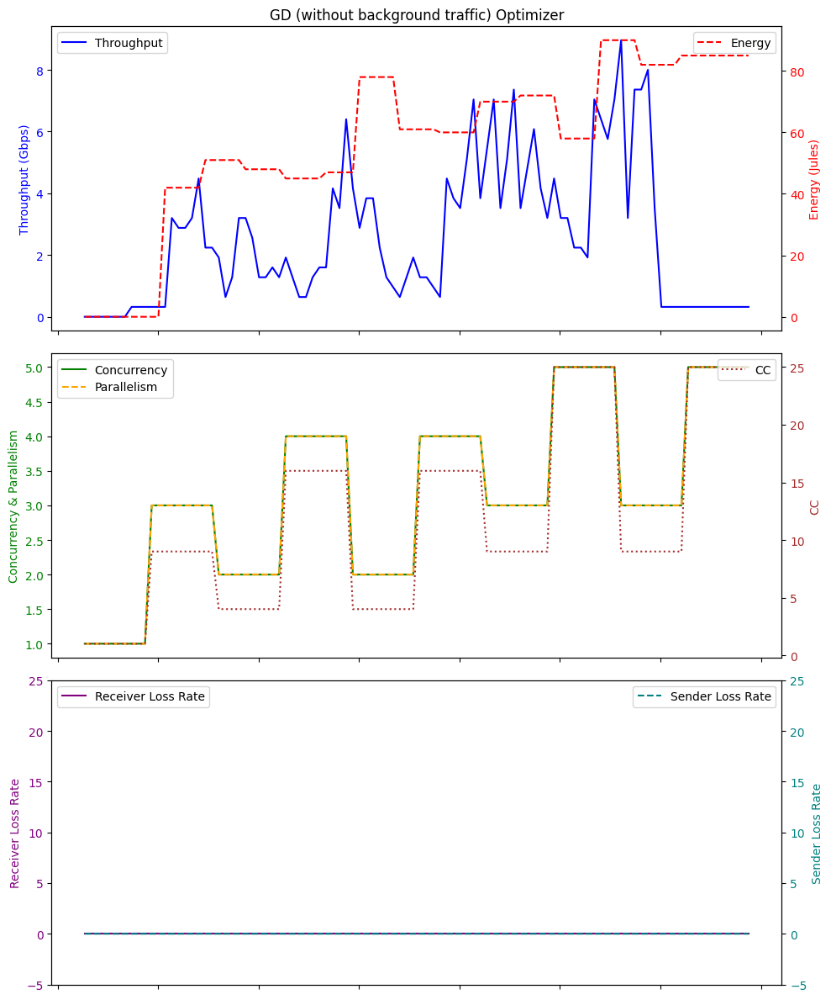

Average Throughput: 2.5599999999999996
Total Energy: 5712.0
Total loss rate: 0.0033993450957722194
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 07:31:17.051568        0.00          0.0   1    0.0   0.0   
1   2024-01-26 07:31:18.047560        0.00          0.0   1    0.0   0.0   
2   2024-01-26 07:31:19.051168        0.00          0.0   1    0.0  32.7   
3   2024-01-26 07:31:20.050828        0.00          0.0   1    0.0  32.8   
4   2024-01-26 07:31:21.054000        0.00          0.0   1    0.0  32.8   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 07:33:12.166542        0.96          0.0  16    1.0  32.7   
116 2024-01-26 07:33:13.168675        0.96          0.0  16    1.0  32.7   
117 2024-01-26 07:33:14.168249        0.96          0.0  16    1.0  32.7   
118 2024-01-26 07:33:15.170180        0.96          0.0  16    1.0  32.7   
119 2024-01-26 07:33:16.170306        0.96          0.0  16    1.

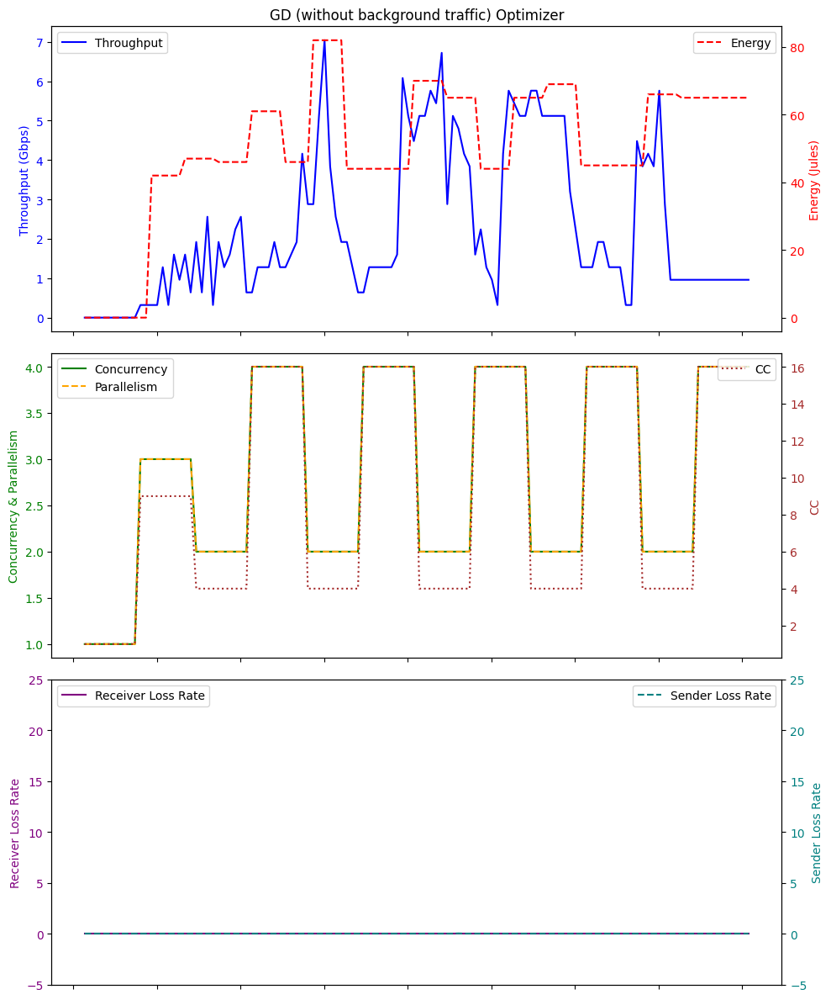

Average Throughput: 2.245333333333334
Total Energy: 6085.0
Total loss rate: 0.021772074973558504
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:37:50.791087        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:37:51.787818        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:37:52.789515        0.00          0.0   1    0.0  32.7   
3   2024-01-26 05:37:53.789445        0.00          0.0   1    0.0  32.6   
4   2024-01-26 05:37:54.790682        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 05:39:35.895220        0.96          0.0   4    1.0  32.8   
106 2024-01-26 05:39:36.896922        0.96          0.0   4    1.0  32.7   
107 2024-01-26 05:39:37.899322        0.96          0.0   4    1.0  32.8   
108 2024-01-26 05:39:38.898535        0.96          0.0   4    1.0  32.7   
109 2024-01-26 05:39:39.899926        0.96          0.0   4    1.0 

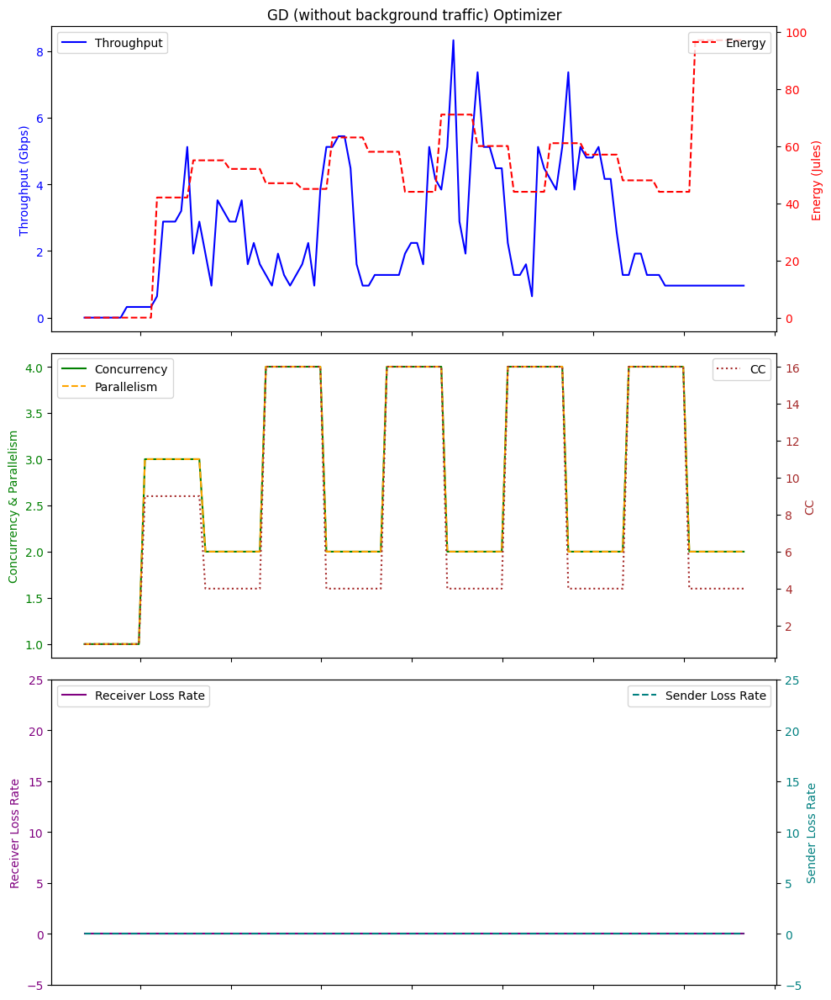

Average Throughput: 2.4232727272727264
Total Energy: 5574.0
Total loss rate: 0.0020614325022471425
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 04:58:08.731692        0.00          0.0   1    0.0   0.0   
1   2024-01-26 04:58:09.725950        0.00          0.0   1    0.0   0.0   
2   2024-01-26 04:58:10.727565        0.00          0.0   1    0.0  32.6   
3   2024-01-26 04:58:11.729200        0.00          0.0   1    0.0  32.7   
4   2024-01-26 04:58:12.729216        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 04:59:53.836124        0.96          0.0   9    1.0  32.7   
106 2024-01-26 04:59:54.836086        0.96          0.0   9    1.0  32.8   
107 2024-01-26 04:59:55.838644        0.96          0.0   9    1.0  32.7   
108 2024-01-26 04:59:56.839664        0.96          0.0   9    1.0  32.7   
109 2024-01-26 04:59:57.840167        0.96          0.0   9    1.

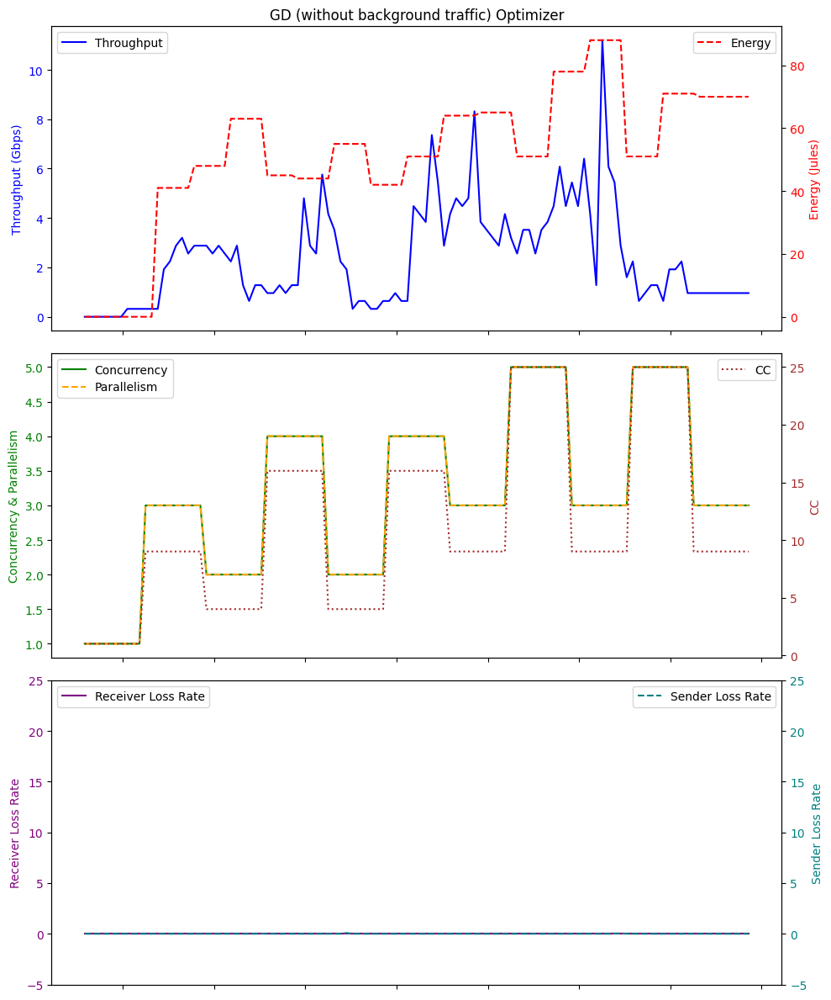

Average Throughput: 2.399999999999999
Total Energy: 5727.0
Total loss rate: 0.18318722392188594
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:48:01.379922        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:48:02.376206        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:48:03.378720        0.00          0.0   1    0.0  32.7   
3   2024-01-26 05:48:04.379527        0.00          0.0   1    0.0  32.6   
4   2024-01-26 05:48:05.379178        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 05:49:56.496922        0.64          0.0  16    1.0  32.6   
116 2024-01-26 05:49:57.496821        0.64          0.0  16    1.0  32.7   
117 2024-01-26 05:49:58.500096        0.64          0.0  16    1.0  32.7   
118 2024-01-26 05:49:59.501934        0.64          0.0  16    1.0  32.7   
119 2024-01-26 05:50:00.500317        0.64          0.0  16    1.0  

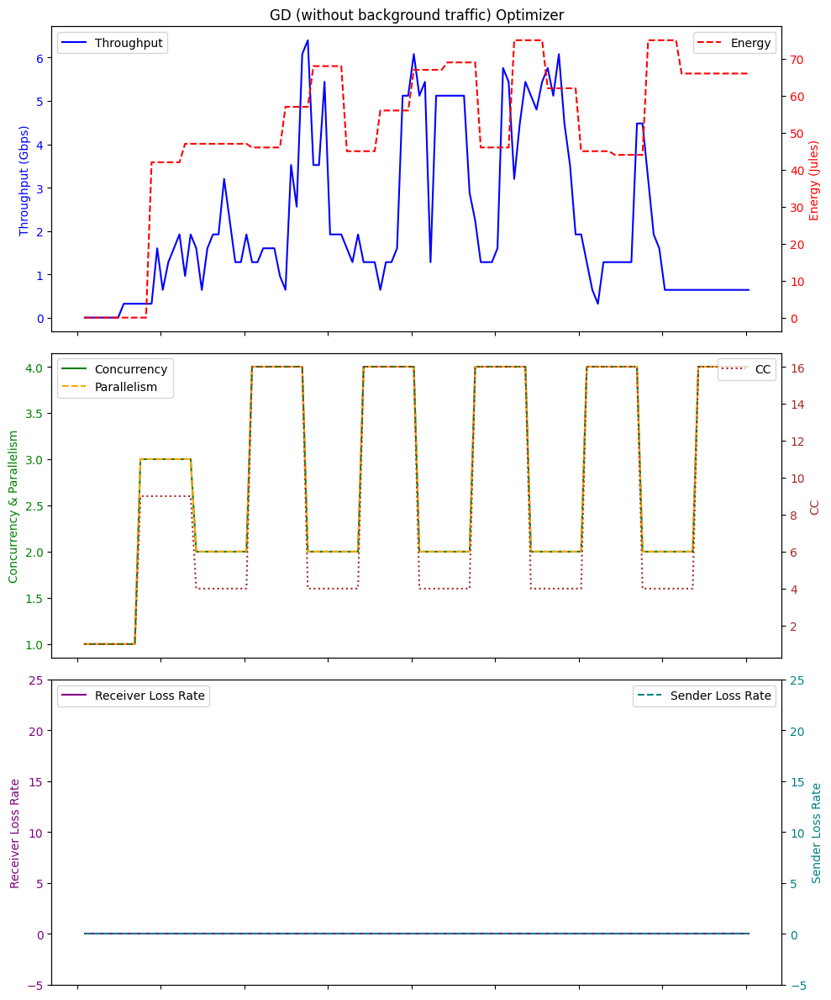

Average Throughput: 2.186666666666667
Total Energy: 6147.0
Total loss rate: 0.007840511886169877
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 07:26:14.666624        0.00          0.0   1    0.0   0.0   
1   2024-01-26 07:26:15.672750        0.00          0.0   1    0.0   0.0   
2   2024-01-26 07:26:16.672333        0.00          0.0   1    0.0  32.6   
3   2024-01-26 07:26:17.674316        0.00          0.0   1    0.0  32.9   
4   2024-01-26 07:26:18.675154        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 07:27:59.782176        0.96          0.0   4    1.0  32.7   
106 2024-01-26 07:28:00.784310        0.96          0.0   4    1.0  32.7   
107 2024-01-26 07:28:01.785830        0.96          0.0   4    1.0  32.7   
108 2024-01-26 07:28:02.785968        0.96          0.0   4    1.0  32.6   
109 2024-01-26 07:28:03.788911        0.96          0.0   4    1.0 

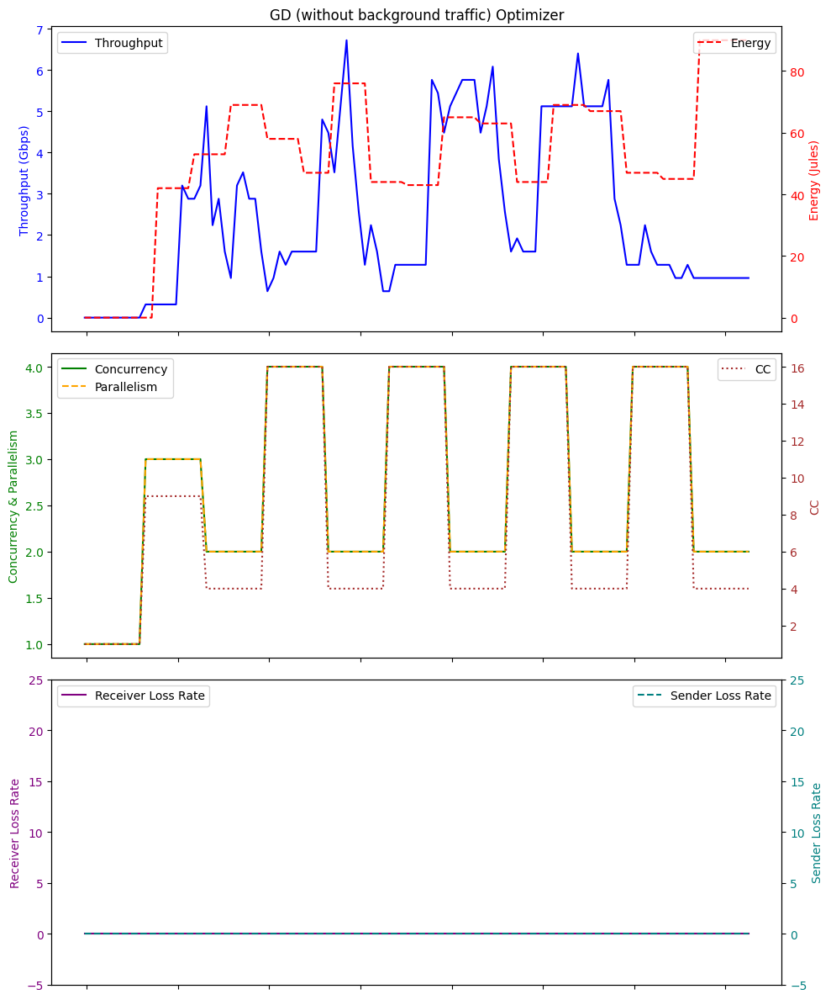

Average Throughput: 2.4145454545454537
Total Energy: 5755.0
Total loss rate: 0.005061412747991734
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:43:10.951939         0.0          0.0   1    0.0   0.0   
1  2024-01-26 05:43:11.947306         0.0          0.0   1    0.0   0.0   
2  2024-01-26 05:43:12.949217         0.0          0.0   1    0.0  32.7   
3  2024-01-26 05:43:13.950428         0.0          0.0   1    0.0  32.6   
4  2024-01-26 05:43:14.951030         0.0          0.0   1    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 05:44:46.047013         1.6          0.0  36    1.0  32.7   
96 2024-01-26 05:44:47.047485         1.6          0.0  36    1.0  32.6   
97 2024-01-26 05:44:48.046830         1.6          0.0  36    1.0  32.7   
98 2024-01-26 05:44:49.049186         1.6          0.0  36    1.0  32.8   
99 2024-01-26 05:44:50.050398         1.6          0.0  36    1.0  32.8   

 

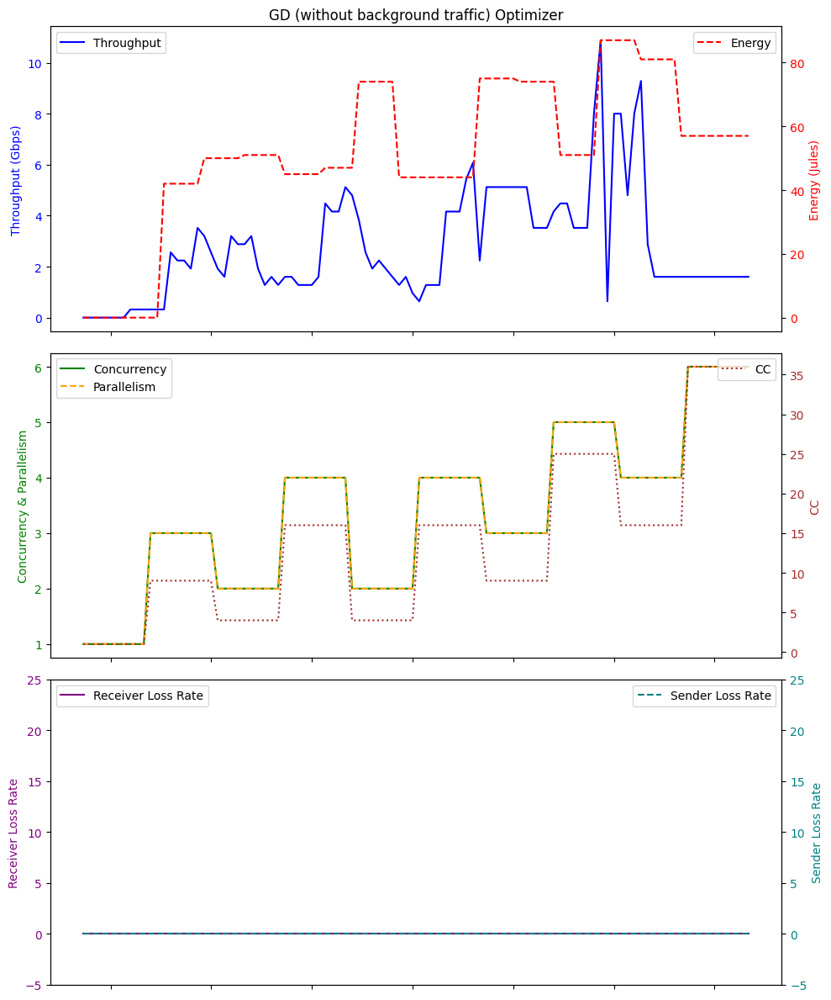

Average Throughput: 2.7648000000000015
Total Energy: 5170.0
Total loss rate: 0.02971768072378568
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:03:55.184666        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:03:56.180348        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:03:57.183473        0.00          0.0   1    0.0  32.6   
3   2024-01-26 06:03:58.183547        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:03:59.183447        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 06:05:50.299862        0.32          0.0  16    0.0  32.7   
116 2024-01-26 06:05:51.299890        0.32          0.0  16    0.0  32.7   
117 2024-01-26 06:05:52.301505        0.32          0.0  16    0.0  32.8   
118 2024-01-26 06:05:53.303050        0.32          0.0  16    0.0  32.7   
119 2024-01-26 06:05:54.302693        0.32          0.0  16    0.0 

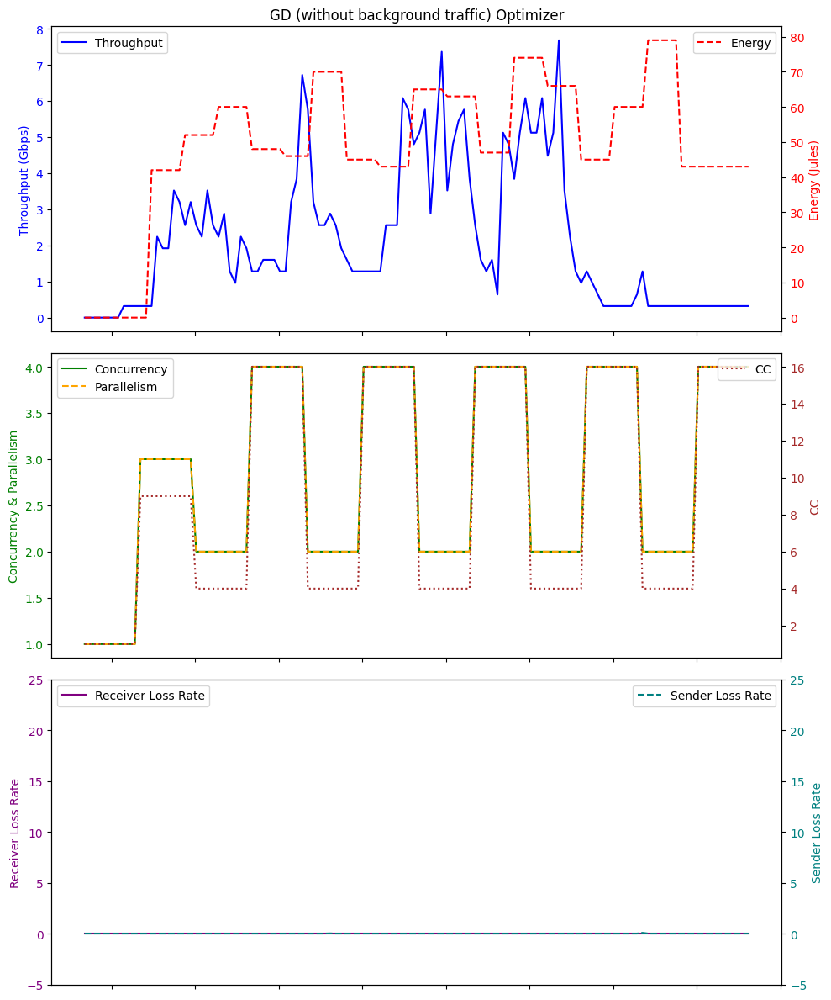

Average Throughput: 2.152
Total Energy: 5943.0
Total loss rate: 0.09015473863275132
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:36:40.262643        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:36:41.260151        0.00          0.0   1    0.0   0.0   
2  2024-01-26 07:36:42.258428        0.00          0.0   1    0.0  32.6   
3  2024-01-26 07:36:43.260551        0.00          0.0   1    0.0  32.6   
4  2024-01-26 07:36:44.263349        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 07:38:15.355147        0.64          0.0  25    1.0  32.7   
96 2024-01-26 07:38:16.355614        0.64          0.0  25    1.0  32.6   
97 2024-01-26 07:38:17.358234        0.64          0.0  25    1.0  32.7   
98 2024-01-26 07:38:18.359131        0.64          0.0  25    1.0  32.7   
99 2024-01-26 07:38:19.359159        0.64          0.0  25    1.0  32.7   

    Energy  sen

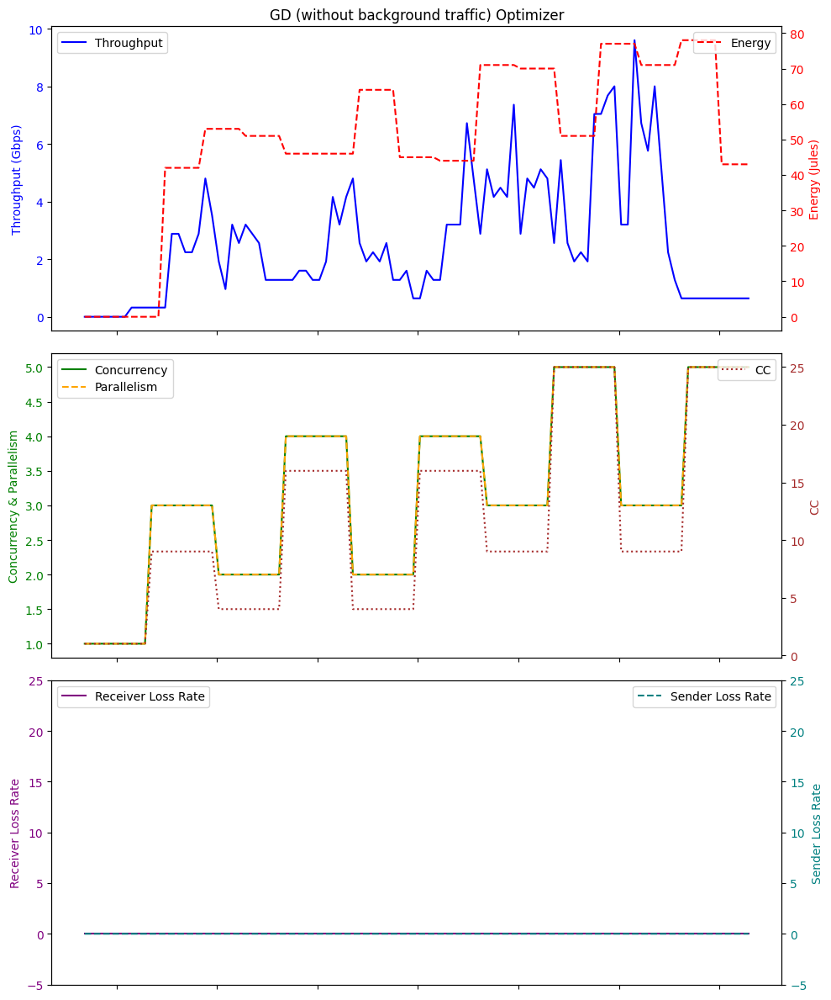

Average Throughput: 2.6175999999999995
Total Energy: 5023.0
Total loss rate: 0.010500441020470978
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:53:48.646746        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:53:49.642678        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:53:50.644173        0.00          0.0   1    0.0  32.7   
3   2024-01-26 05:53:51.645648        0.00          0.0   1    0.0  32.7   
4   2024-01-26 05:53:52.645499        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 05:55:43.759931        1.28          0.0  16    1.0  32.6   
116 2024-01-26 05:55:44.759316        1.28          0.0  16    1.0  32.7   
117 2024-01-26 05:55:45.760153        1.28          0.0  16    1.0  32.7   
118 2024-01-26 05:55:46.762476        1.28          0.0  16    1.0  32.7   
119 2024-01-26 05:55:47.762290        1.28          0.0  16    1.0

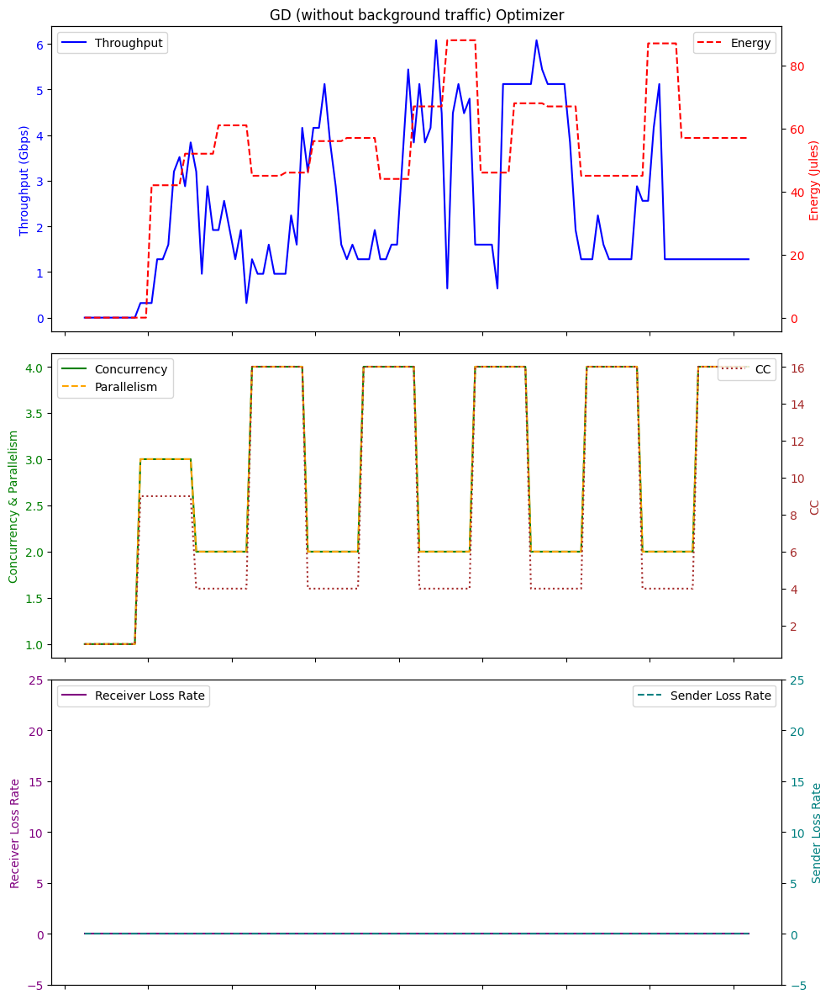

Average Throughput: 2.298666666666667
Total Energy: 6191.0
Total loss rate: 0.014660750061315614
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:58:54.128000        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:58:55.127303        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:58:56.126684        0.00          0.0   1    0.0  32.6   
3   2024-01-26 05:58:57.127750        0.00          0.0   1    0.0  32.7   
4   2024-01-26 05:58:58.127213        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 06:00:39.232665        0.96          0.0   4    1.0  32.7   
106 2024-01-26 06:00:40.232714        0.96          0.0   4    1.0  32.7   
107 2024-01-26 06:00:41.234633        0.96          0.0   4    1.0  32.7   
108 2024-01-26 06:00:42.235215        0.96          0.0   4    1.0  32.7   
109 2024-01-26 06:00:43.235529        0.96          0.0   4    1.0 

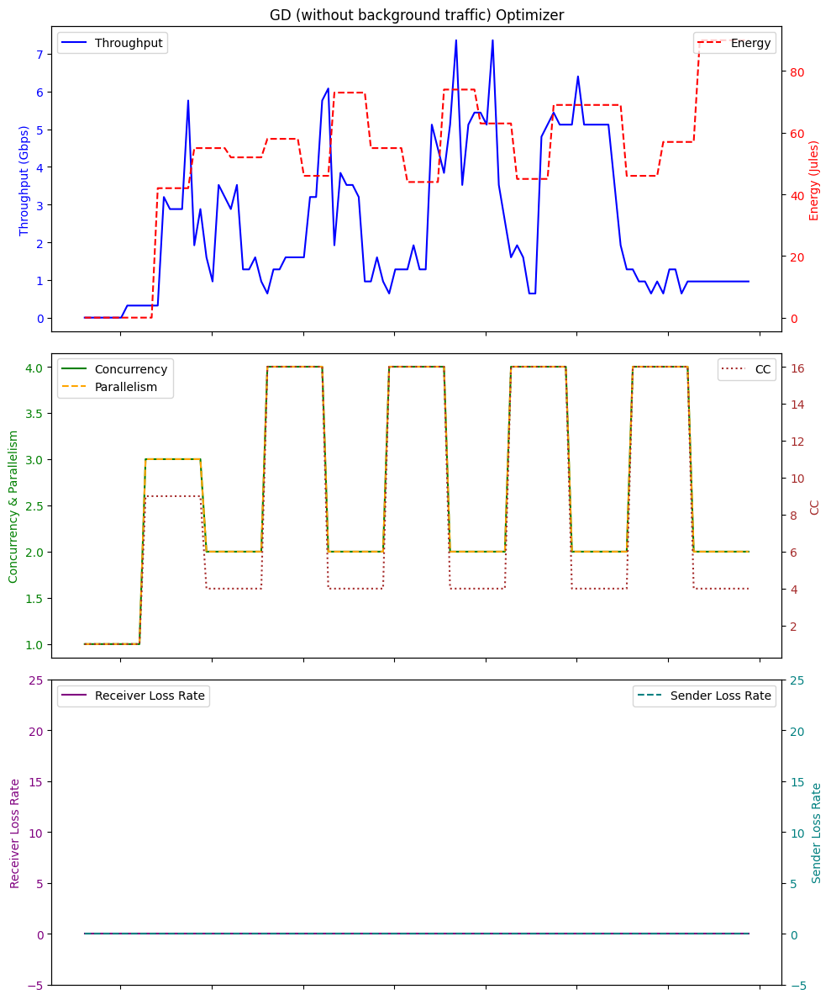

Average Throughput: 2.376727272727272
Total Energy: 5852.0
Total loss rate: 0.007874323561141035
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:26:53.641144        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:26:54.635704        0.00          0.0   1    0.0   0.0   
2  2024-01-26 05:26:55.636508        0.00          0.0   1    0.0  32.7   
3  2024-01-26 05:26:56.638402        0.00          0.0   1    0.0  32.6   
4  2024-01-26 05:26:57.638788        0.00          0.0   1    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
95 2024-01-26 05:28:28.735258        0.64          0.0  25    1.0  32.6   
96 2024-01-26 05:28:29.737208        0.64          0.0  25    1.0  32.7   
97 2024-01-26 05:28:30.738511        0.64          0.0  25    1.0  32.7   
98 2024-01-26 05:28:31.738195        0.64          0.0  25    1.0  32.7   
99 2024-01-26 05:28:32.739348        0.64          0.0  25    1.0  32.7   

  

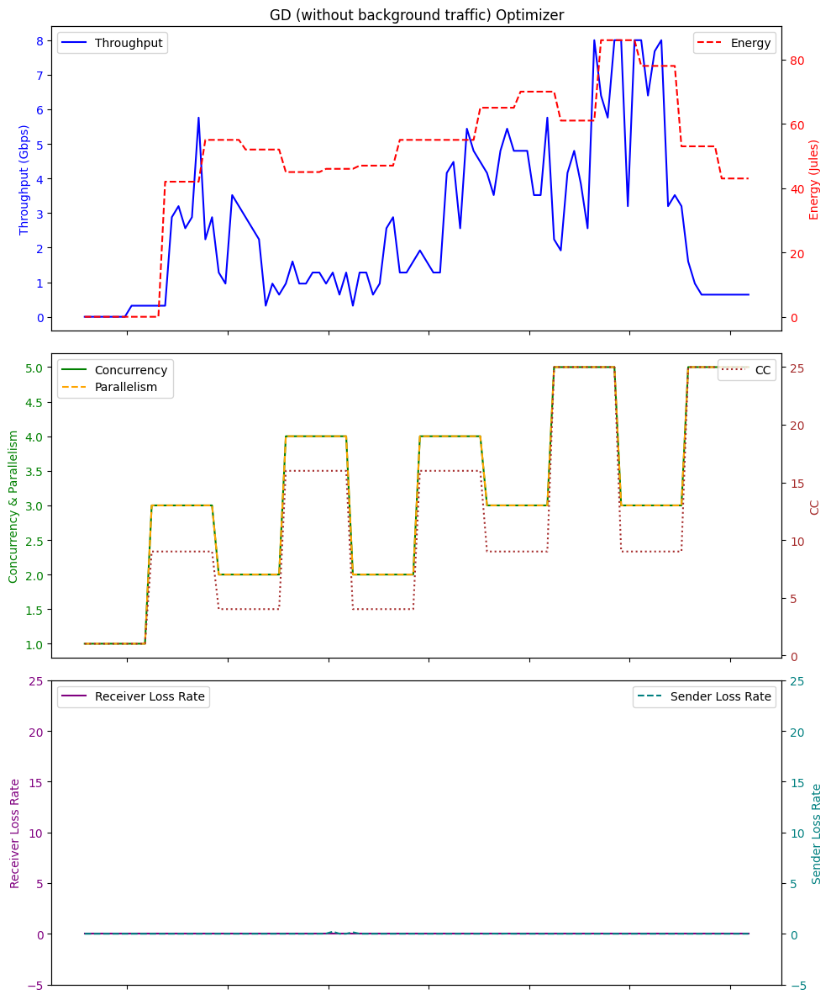

Average Throughput: 2.5983999999999994
Total Energy: 5029.0
Total loss rate: 0.3950915709170667
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:14:06.364642        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:14:07.360769        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:14:08.361407        0.00          0.0   1    0.0  32.6   
3   2024-01-26 06:14:09.360058        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:14:10.363744        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 06:16:01.480906        0.96          0.0  16    1.0  32.7   
116 2024-01-26 06:16:02.481831        0.96          0.0  16    1.0  32.7   
117 2024-01-26 06:16:03.481639        0.96          0.0  16    1.0  32.7   
118 2024-01-26 06:16:04.481452        0.96          0.0  16    1.0  32.8   
119 2024-01-26 06:16:05.484712        0.96          0.0  16    1.0  

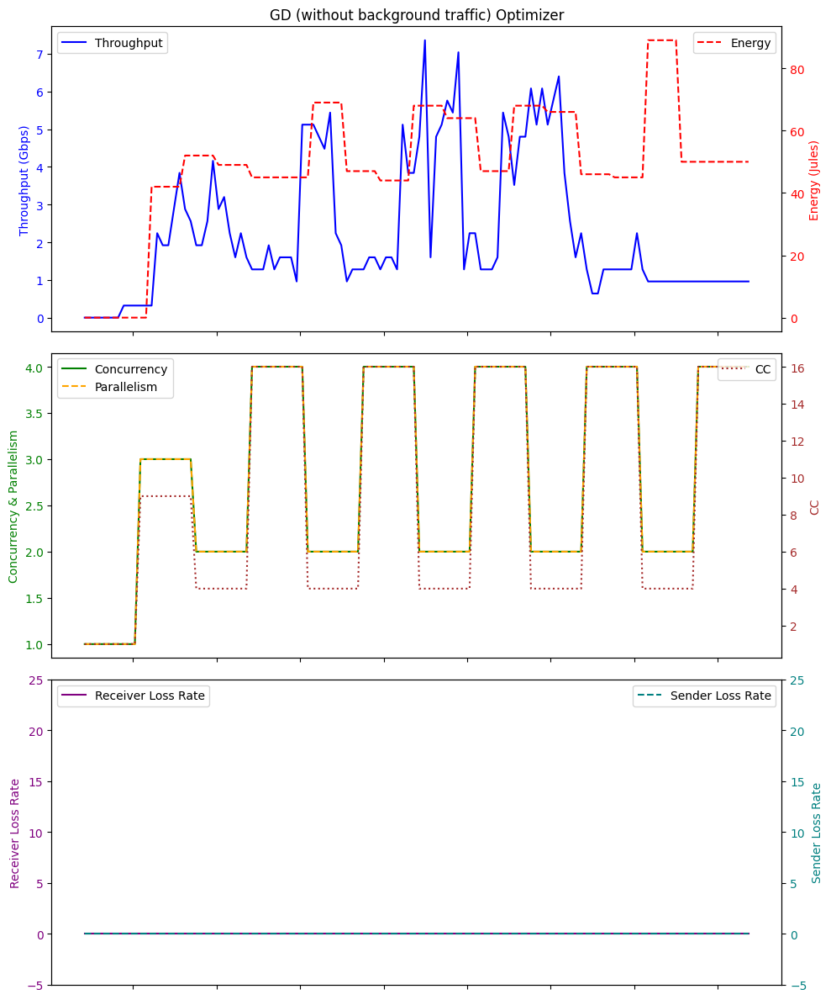

Average Throughput: 2.2613333333333334
Total Energy: 5921.0
Total loss rate: 0.008308824423756824
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:25:14.012841        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:25:15.009980        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:25:16.013656        0.00          0.0   1    0.0  32.6   
3   2024-01-26 06:25:17.011769        0.00          0.0   1    0.0  32.6   
4   2024-01-26 06:25:18.012537        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 06:27:09.132533        0.64          0.0  16    1.0  32.6   
116 2024-01-26 06:27:10.132117        0.64          0.0  16    1.0  32.6   
117 2024-01-26 06:27:11.134802        0.64          0.0  16    1.0  32.7   
118 2024-01-26 06:27:12.134991        0.64          0.0  16    1.0  32.7   
119 2024-01-26 06:27:13.135528        0.64          0.0  16    1.0

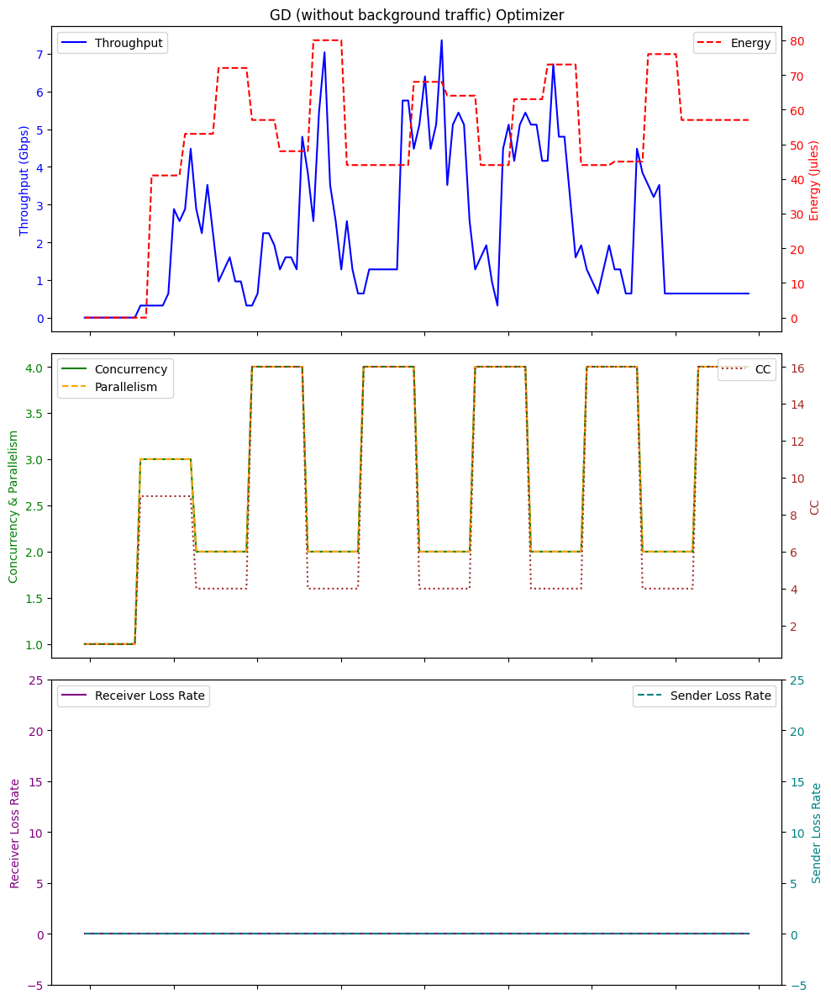

Average Throughput: 2.216
Total Energy: 6180.0
Total loss rate: 0.005143926877306797
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:35:52.835322        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:35:53.830892        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:35:54.831027        0.00          0.0   1    0.0  32.7   
3   2024-01-26 06:35:55.833937        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:35:56.833827        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
105 2024-01-26 06:37:37.938982        0.32          0.0   4    0.0  32.8   
106 2024-01-26 06:37:38.937868        0.32          0.0   4    0.0  32.8   
107 2024-01-26 06:37:39.939984        0.32          0.0   4    0.0  32.8   
108 2024-01-26 06:37:40.941248        0.32          0.0   4    0.0  32.7   
109 2024-01-26 06:37:41.940314        0.32          0.0   4    0.0  32.7   

  

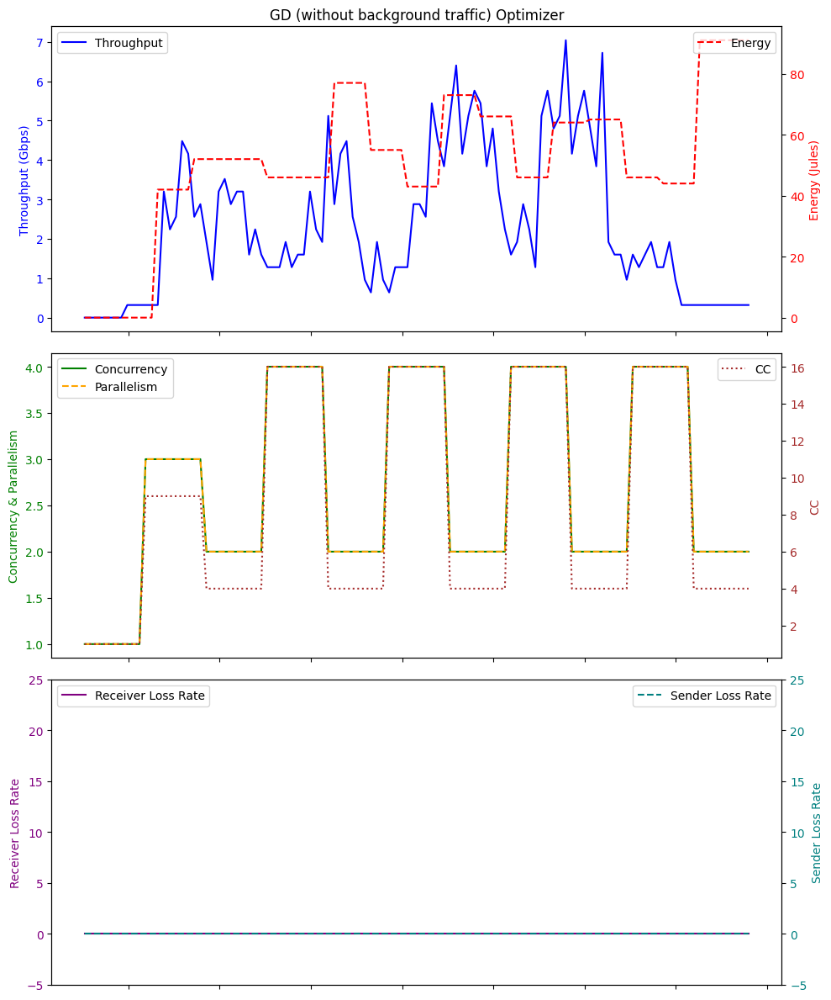

Average Throughput: 2.3098181818181818
Total Energy: 5675.0
Total loss rate: 0.006871730999694563
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 05:21:29.383524        0.00          0.0   1    0.0   0.0   
1   2024-01-26 05:21:30.380961        0.00          0.0   1    0.0   0.0   
2   2024-01-26 05:21:31.381745        0.00          0.0   1    0.0  32.6   
3   2024-01-26 05:21:32.382069        0.00          0.0   1    0.0  32.8   
4   2024-01-26 05:21:33.384481        0.00          0.0   1    0.0  32.7   
..                         ...         ...          ...  ..    ...   ...   
115 2024-01-26 05:23:24.498686        0.32          0.0  16    0.0  32.6   
116 2024-01-26 05:23:25.501112        0.32          0.0  16    0.0  32.7   
117 2024-01-26 05:23:26.501232        0.32          0.0  16    0.0  32.6   
118 2024-01-26 05:23:27.503745        0.32          0.0  16    0.0  32.6   
119 2024-01-26 05:23:28.503634        0.32          0.0  16    0.0

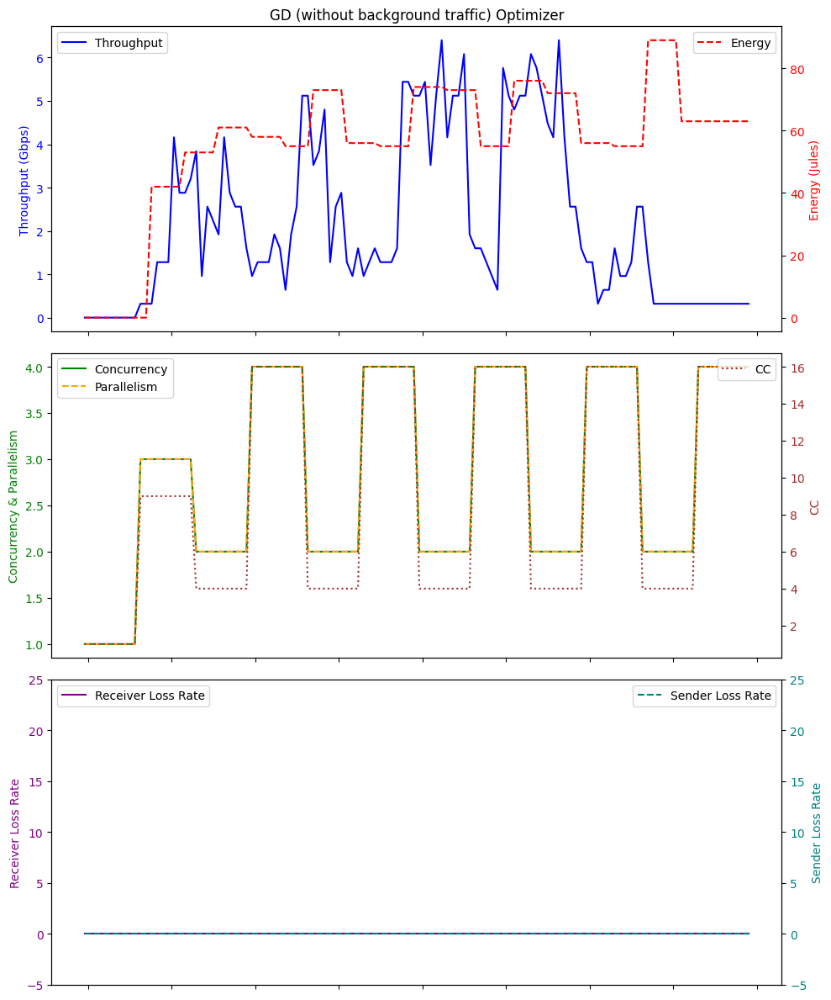

Average Throughput: 2.1573333333333333
Total Energy: 6782.0
Total loss rate: 0.014887545519553498
                          Time  Throughput  receiver_lr  CC  Score   RTT  \
0   2024-01-26 06:19:58.741126        0.00          0.0   1    0.0   0.0   
1   2024-01-26 06:19:59.738027        0.00          0.0   1    0.0   0.0   
2   2024-01-26 06:20:00.740016        0.00          0.0   1    0.0  32.6   
3   2024-01-26 06:20:01.739493        0.00          0.0   1    0.0  32.7   
4   2024-01-26 06:20:02.742664        0.00          0.0   1    0.0  32.6   
..                         ...         ...          ...  ..    ...   ...   
125 2024-01-26 06:22:03.871816        0.32          0.0   4    0.0  32.7   
126 2024-01-26 06:22:04.874483        0.32          0.0   4    0.0  32.7   
127 2024-01-26 06:22:05.872882        0.32          0.0   4    0.0  32.6   
128 2024-01-26 06:22:06.874951        0.32          0.0   4    0.0  32.8   
129 2024-01-26 06:22:07.874500        0.32          0.0   4    0.0

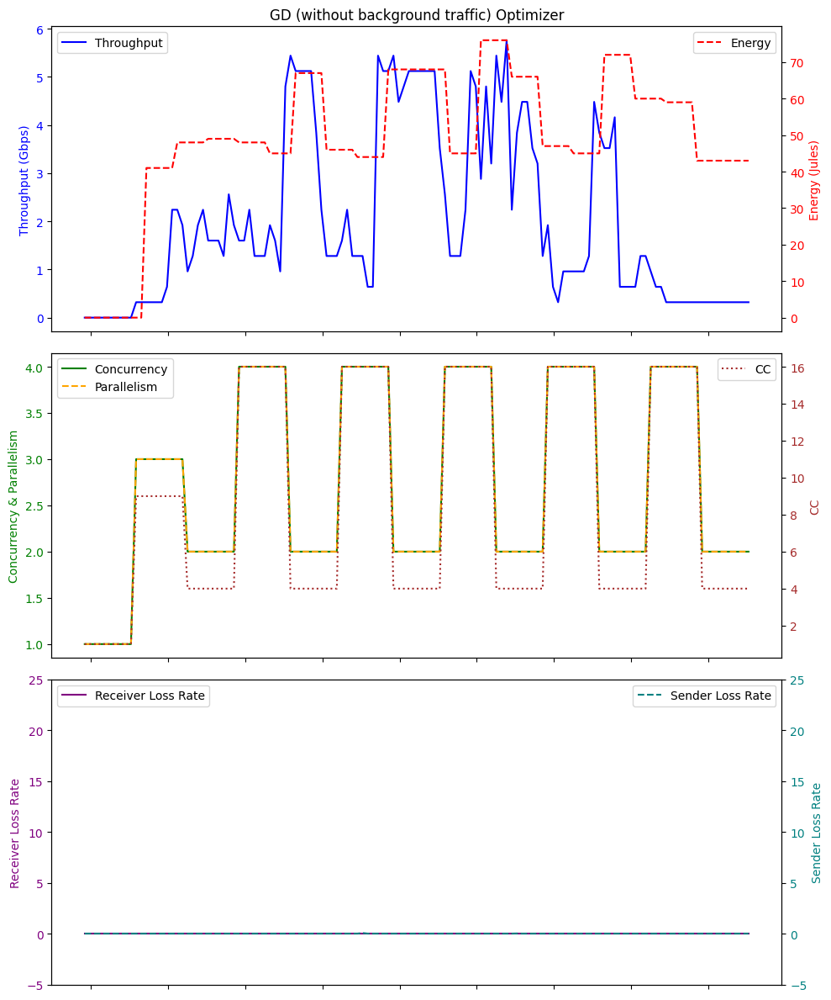

Average Throughput: 2.025846153846154
Total Energy: 6392.0
Total loss rate: 0.06916340440437434


In [12]:
# Example usage GD
directory = './logFileDir_simu_w_bg/GD/'
dfs = process_log_files(directory,"GD_logFile_")

gd_throughput_list=[]
gd_energy_list=[]
gd_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('GD (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    gd_throughput_list.append(average_throughput)
    gd_energy_list.append(total_energy)
    gd_plr_list.append(total_plr)


                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:08:55.732915        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:08:56.729055        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:08:57.727000        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:08:58.731422        0.00          0.0  49    0.0  32.8   
4  2024-01-26 05:08:59.730044        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:09:51.784628        0.96          0.0  36    1.0  32.8   
57 2024-01-26 05:09:52.784390        0.96          0.0  36    1.0  32.9   
58 2024-01-26 05:09:53.787272        0.96          0.0  36    1.0  32.7   
59 2024-01-26 05:09:54.787011        0.96          0.0  36    1.0  32.7   
60 2024-01-26 05:09:55.790490        0.96          0.0  36    1.0  32.7   

    Energy  sender_lr  concurrency  parallelism  
0      0.0        0.0            1            1  

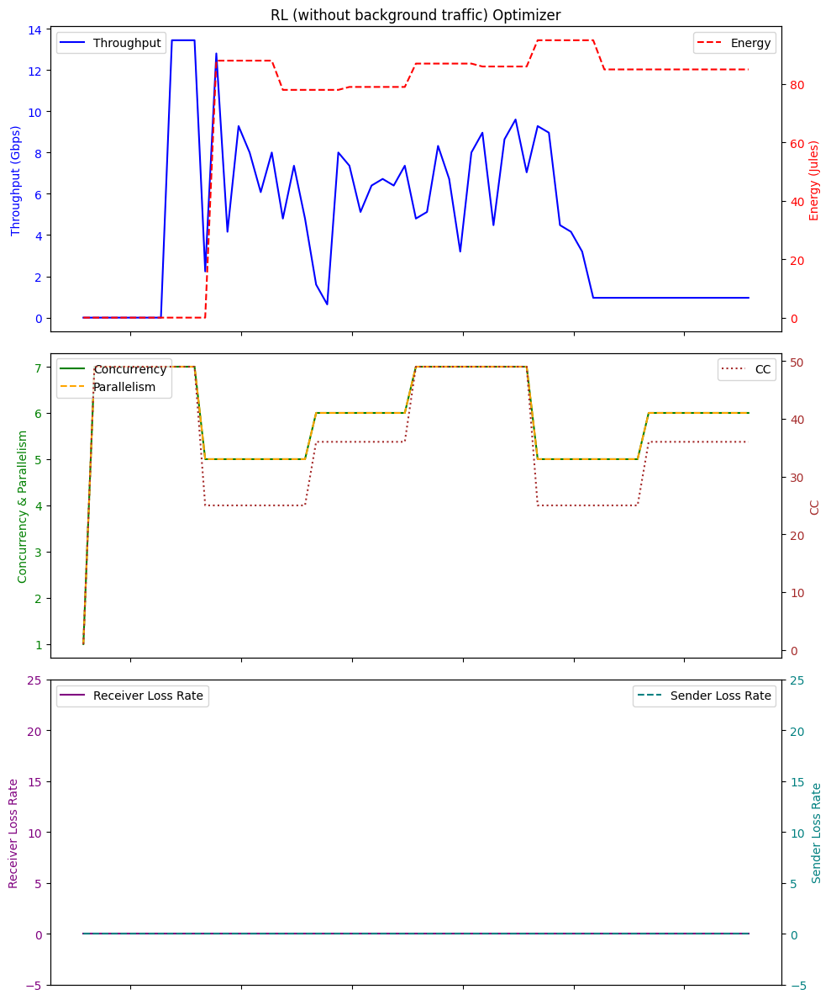

Average Throughput: 4.5377049180327855
Total Energy: 4182.0
Total loss rate: 0.010135492267227405
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:46:59.099466        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:47:00.093259        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:47:01.092762        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:47:02.094434        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:47:03.096951        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:47:55.150079        2.88          0.0  49    3.0  33.1   
57 2024-01-26 05:47:56.148898        2.88          0.0  49    3.0  32.6   
58 2024-01-26 05:47:57.149766        2.88          0.0  49    3.0  32.6   
59 2024-01-26 05:47:58.152226        2.88          0.0  49    3.0  32.7   
60 2024-01-26 05:47:59.153708        2.88          0.0  49    3.0  32.8   

 

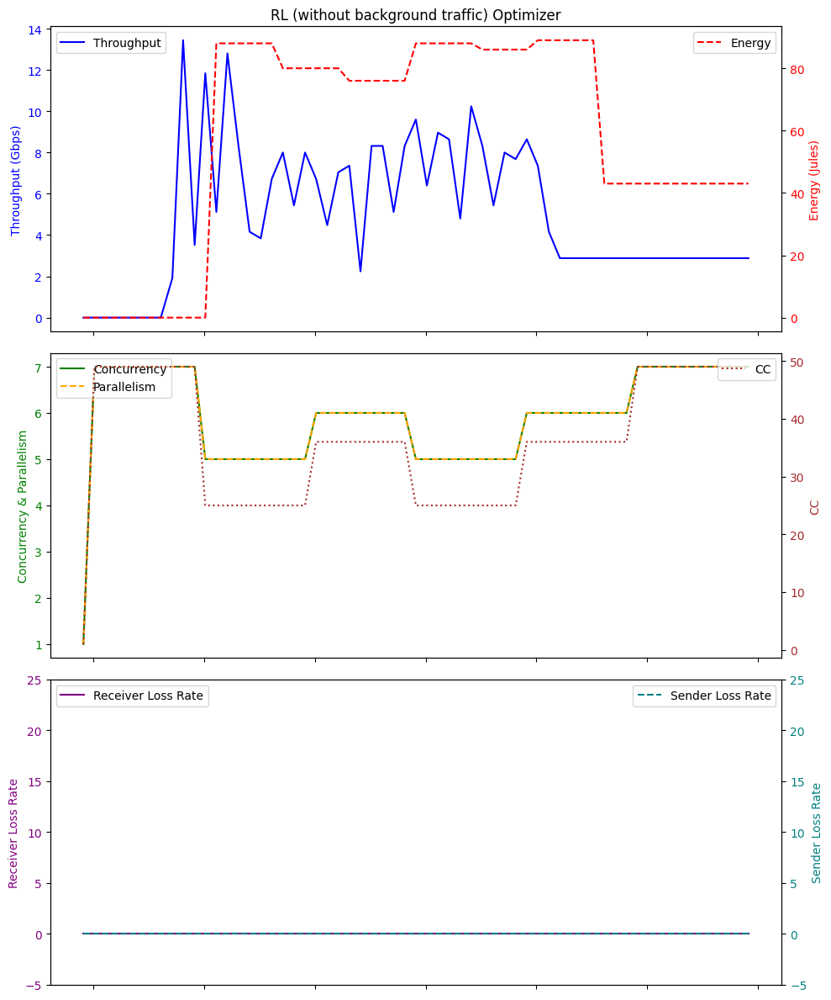

Average Throughput: 4.9363934426229505
Total Energy: 3558.0
Total loss rate: 0.012258872589072756
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:40:31.757789        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:40:32.753728        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:40:33.753806        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:40:34.753983        0.00          0.0  49    0.0  32.6   
4  2024-01-26 06:40:35.756796        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 06:41:37.818126        0.32          0.0  49    0.0  32.6   
67 2024-01-26 06:41:38.822382        0.32          0.0  49    0.0  32.6   
68 2024-01-26 06:41:39.820257        0.32          0.0  49    0.0  32.7   
69 2024-01-26 06:41:40.821387        0.32          0.0  49    0.0  32.8   
70 2024-01-26 06:41:41.823208        0.32          0.0  49    0.0  32.7   

 

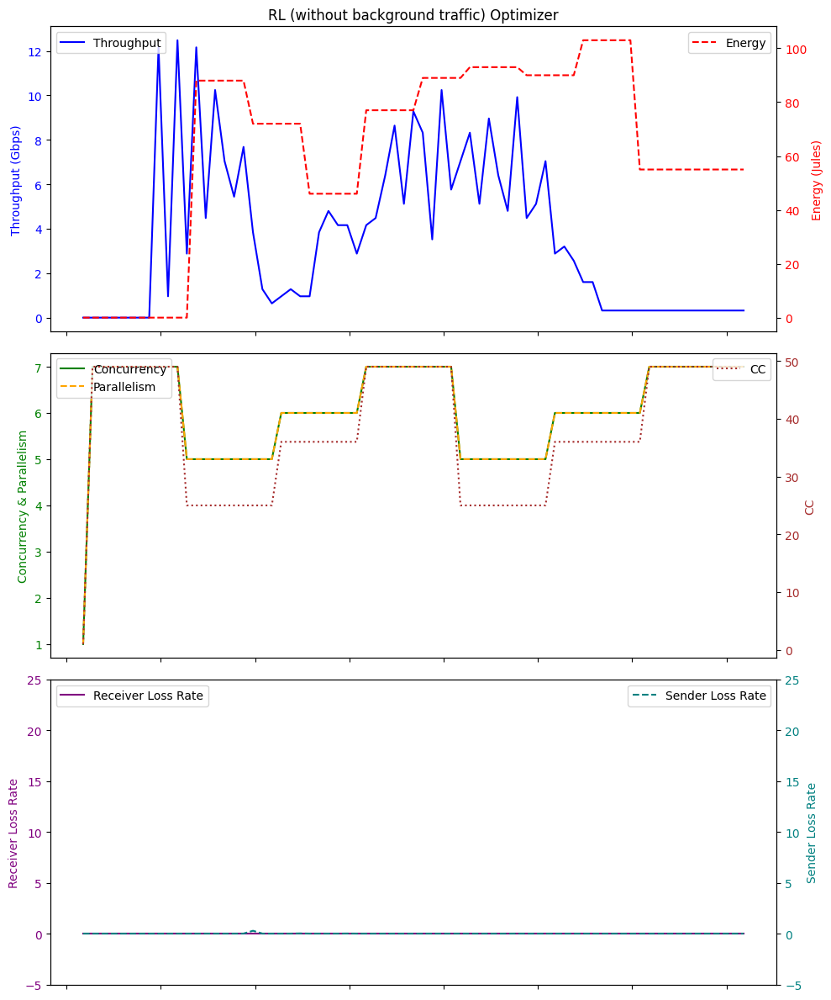

Average Throughput: 3.5966197183098587
Total Energy: 4519.0
Total loss rate: 0.3125723486743542
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:30:14.770102        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:30:15.767846        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:30:16.769250        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:30:17.768135        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:30:18.769633        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:31:10.820783        0.32          0.0  49    0.0  32.7   
57 2024-01-26 07:31:11.820777        0.32          0.0  49    0.0  32.8   
58 2024-01-26 07:31:12.823344        0.32          0.0  49    0.0  32.8   
59 2024-01-26 07:31:13.823436        0.32          0.0  49    0.0  32.7   
60 2024-01-26 07:31:14.826608        0.32          0.0  49    0.0  32.7   

   

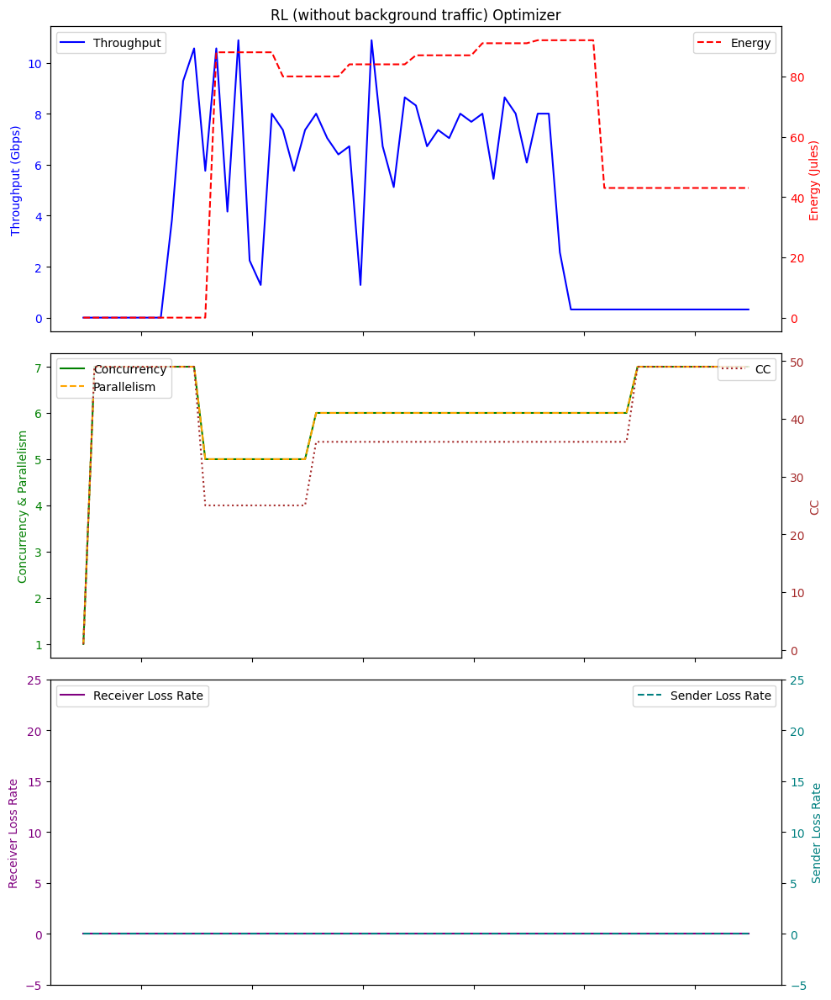

Average Throughput: 4.149508196721311
Total Energy: 3643.0
Total loss rate: 0.01180971027321671
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:34:48.370904        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:34:49.365321        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:34:50.368252        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:34:51.367453        0.00          0.0  49    0.0  32.6   
4  2024-01-26 06:34:52.368479        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:35:44.421301        1.92          0.0  36    2.0  32.7   
57 2024-01-26 06:35:45.421292        1.92          0.0  36    2.0  32.6   
58 2024-01-26 06:35:46.421248        1.92          0.0  36    2.0  32.7   
59 2024-01-26 06:35:47.421317        1.92          0.0  36    2.0  32.7   
60 2024-01-26 06:35:48.424640        1.92          0.0  36    2.0  32.8   

   

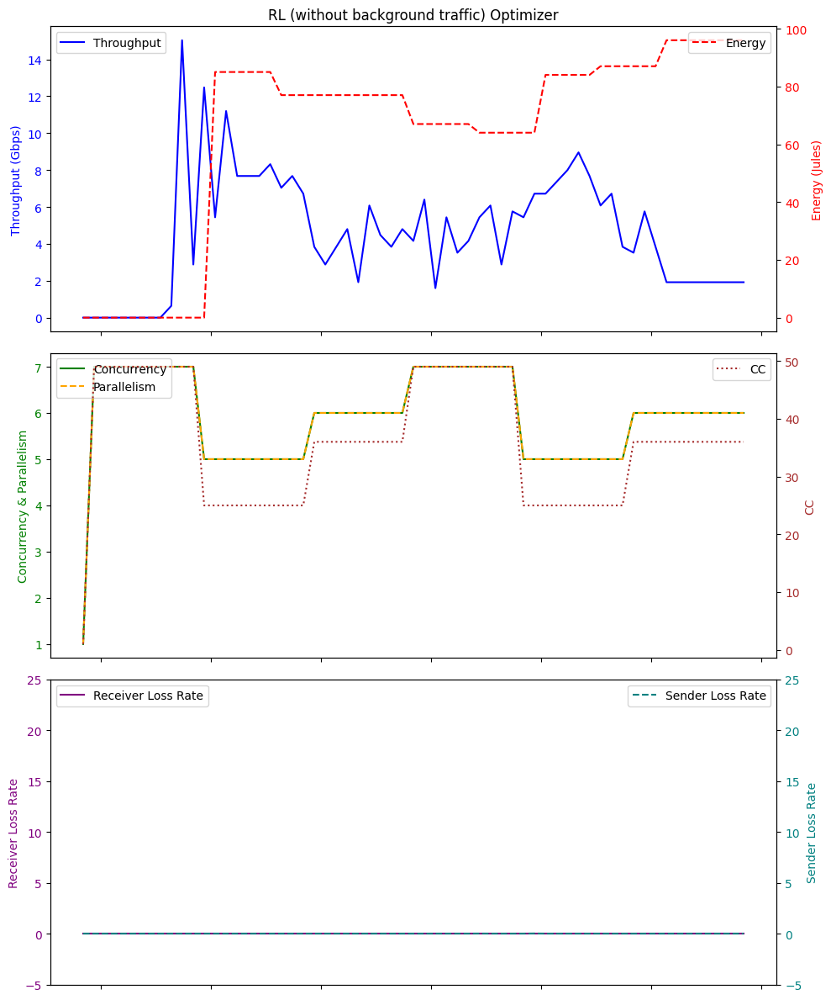

Average Throughput: 4.56393442622951
Total Energy: 3930.0
Total loss rate: 0.020179922469517147
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:31:16.168353        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:31:17.169101        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:31:18.169307        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:31:19.170719        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:31:20.172259        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:32:12.222643        1.28          0.0  36    1.0  32.6   
57 2024-01-26 05:32:13.223268        1.28          0.0  36    1.0  32.6   
58 2024-01-26 05:32:14.225500        1.28          0.0  36    1.0  32.6   
59 2024-01-26 05:32:15.225540        1.28          0.0  36    1.0  32.7   
60 2024-01-26 05:32:16.226673        1.28          0.0  36    1.0  32.7   

   

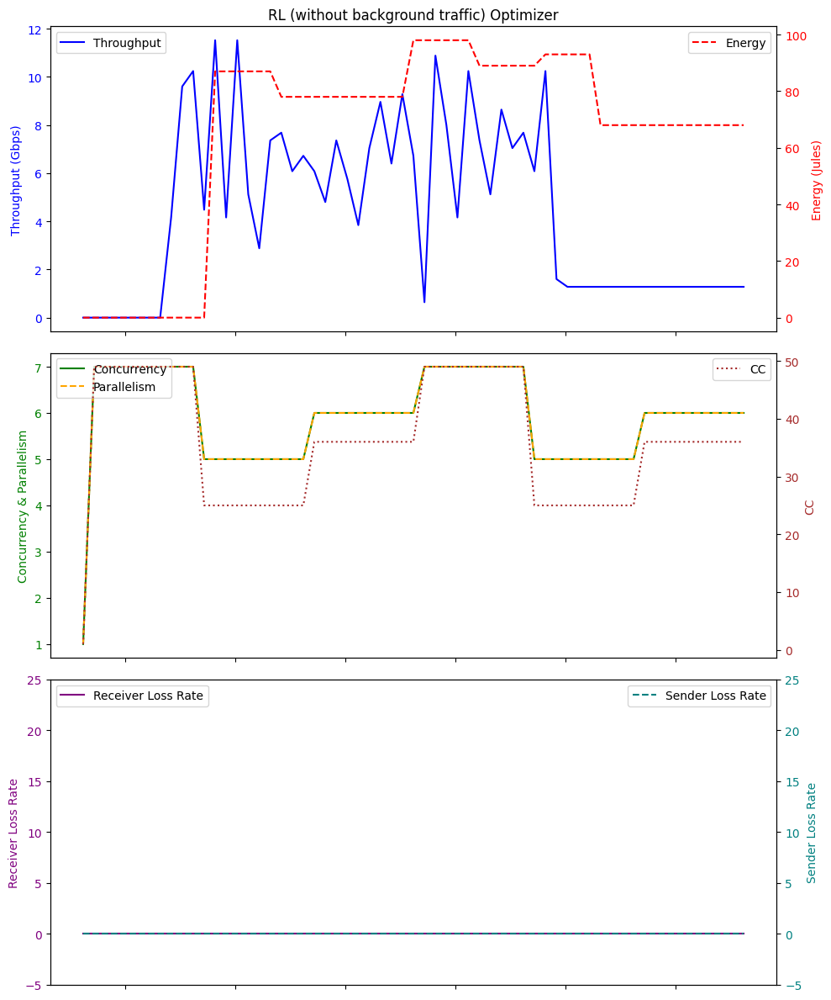

Average Throughput: 4.380327868852457
Total Energy: 3997.0
Total loss rate: 0.011343606836717406
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:14:37.679521        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:14:38.676644        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:14:39.678072        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:14:40.678529        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:14:41.679270        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:15:33.731679        1.92          0.0  36    2.0  32.6   
57 2024-01-26 07:15:34.732332        1.92          0.0  36    2.0  32.7   
58 2024-01-26 07:15:35.734329        1.92          0.0  36    2.0  32.7   
59 2024-01-26 07:15:36.734420        1.92          0.0  36    2.0  32.7   
60 2024-01-26 07:15:37.729984        1.92          0.0  36    2.0  32.7   

  

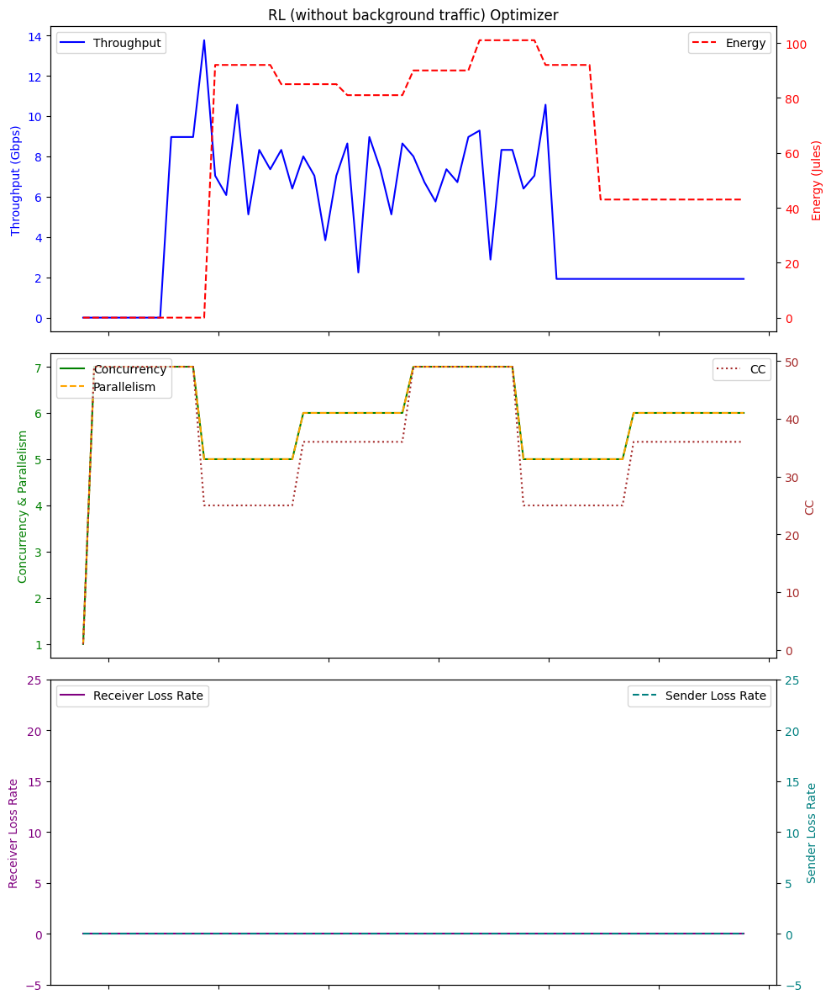

Average Throughput: 4.878688524590165
Total Energy: 3756.0
Total loss rate: 0.014926169515955224
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:14:51.450509        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:14:52.449083        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:14:53.449403        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:14:54.450062        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:14:55.451941        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:15:47.498500        0.32          0.0  36    0.0  32.8   
57 2024-01-26 05:15:48.500987        0.32          0.0  36    0.0  32.6   
58 2024-01-26 05:15:49.502723        0.32          0.0  36    0.0  32.6   
59 2024-01-26 05:15:50.503632        0.32          0.0  36    0.0  32.8   
60 2024-01-26 05:15:51.505838        0.32          0.0  36    0.0  32.6   

  

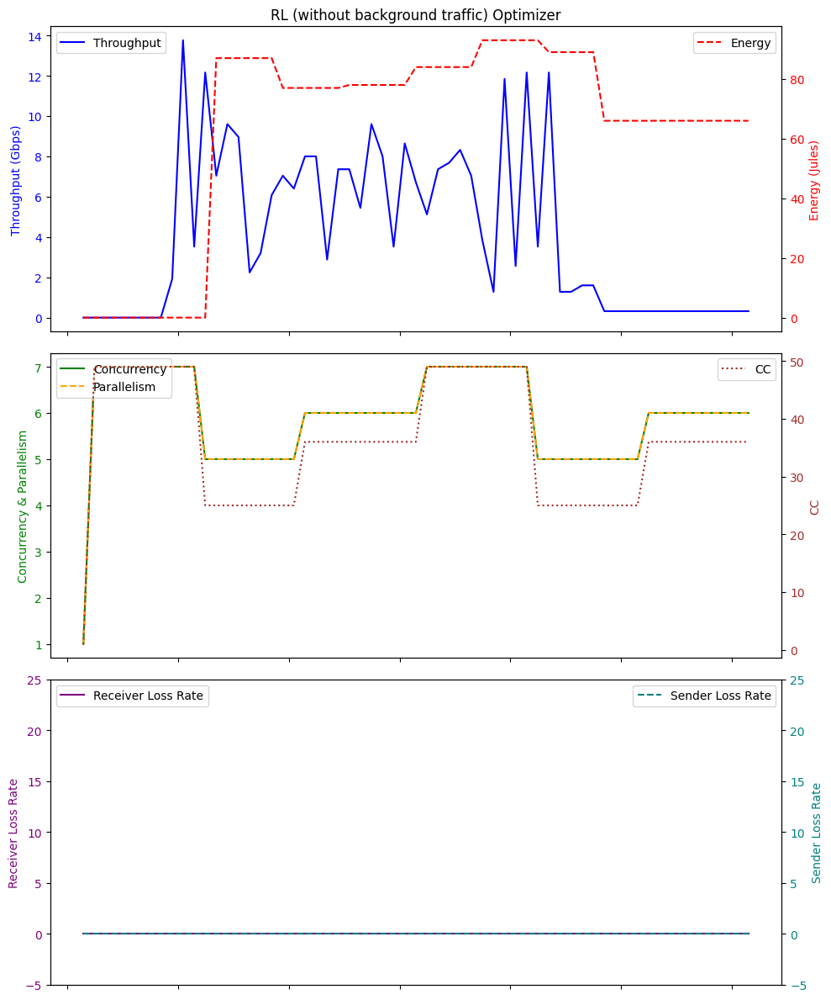

Average Throughput: 4.107540983606557
Total Energy: 3883.0
Total loss rate: 0.007938209142398539
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:25:51.342262        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:25:52.339718        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:25:53.339257        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:25:54.340974        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:25:55.341209        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:26:47.392040        0.32          0.0  25    0.0  32.6   
57 2024-01-26 05:26:48.393399        0.32          0.0  25    0.0  32.7   
58 2024-01-26 05:26:49.393902        0.32          0.0  25    0.0  32.8   
59 2024-01-26 05:26:50.395792        0.32          0.0  25    0.0  32.6   
60 2024-01-26 05:26:51.396598        0.32          0.0  25    0.0  32.7   

  

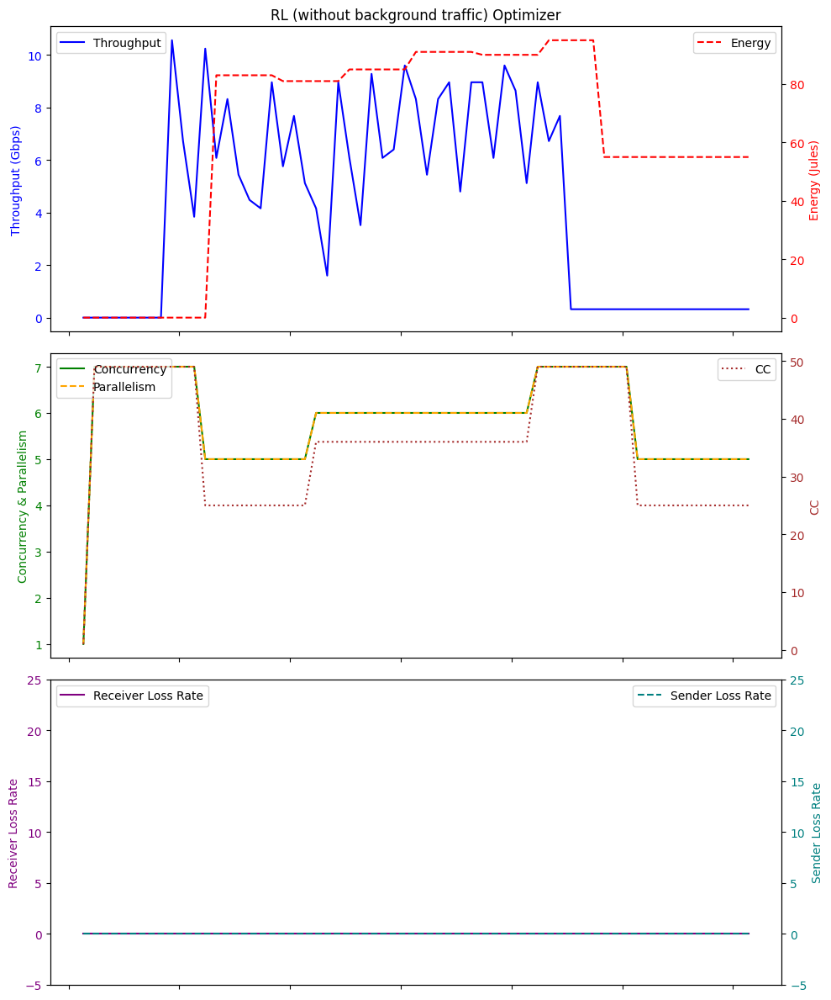

Average Throughput: 4.180983606557376
Total Energy: 3825.0
Total loss rate: 0.011901802505138686
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:02:52.903431        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:02:53.897559        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:02:54.897390        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:02:55.900193        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:02:56.900297        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:03:48.952296        1.28          0.0  36    1.0  32.7   
57 2024-01-26 06:03:49.953462        1.28          0.0  36    1.0  32.7   
58 2024-01-26 06:03:50.955948        1.28          0.0  36    1.0  32.8   
59 2024-01-26 06:03:51.958303        1.28          0.0  36    1.0  32.7   
60 2024-01-26 06:03:52.956187        1.28          0.0  36    1.0  32.8   

  

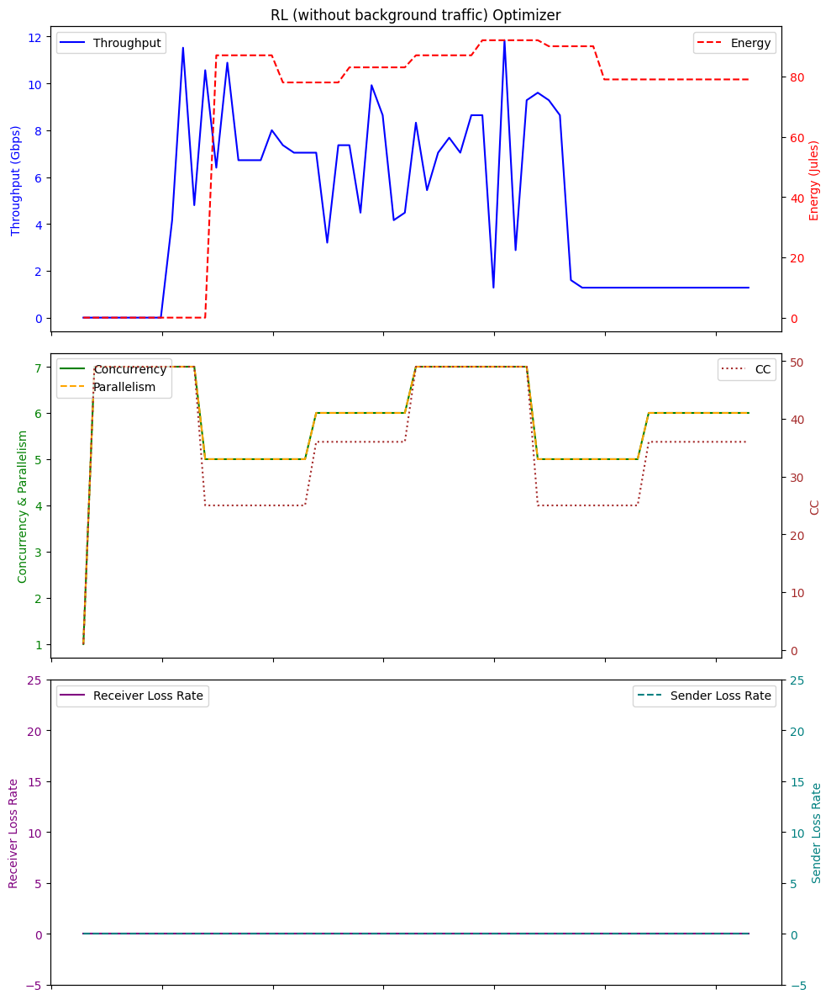

Average Throughput: 4.626885245901637
Total Energy: 4118.0
Total loss rate: 0.012799266679600145
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:13:04.062385        0.00     0.000000   1    0.0   0.0   
1  2024-01-26 06:13:05.057044        0.00     0.000000  49    0.0   0.0   
2  2024-01-26 06:13:06.057183        0.00     0.000000  49    0.0  32.7   
3  2024-01-26 06:13:07.059373        0.00     0.000000  49    0.0  32.6   
4  2024-01-26 06:13:08.060049        0.00     0.000000  49    0.0  32.6   
5  2024-01-26 06:13:09.060745        0.00     0.000000  49    0.0  32.7   
6  2024-01-26 06:13:10.056059        0.00     0.000000  49    0.0  32.5   
7  2024-01-26 06:13:11.069399        0.00     0.000000  49    0.0  33.0   
8  2024-01-26 06:13:12.057918       11.84     0.000000  49   10.0  35.1   
9  2024-01-26 06:13:13.073262        1.60     0.000000  49    1.0  32.9   
10 2024-01-26 06:13:14.093298       12.80     0.000000  49   11.0  38.6   
11 

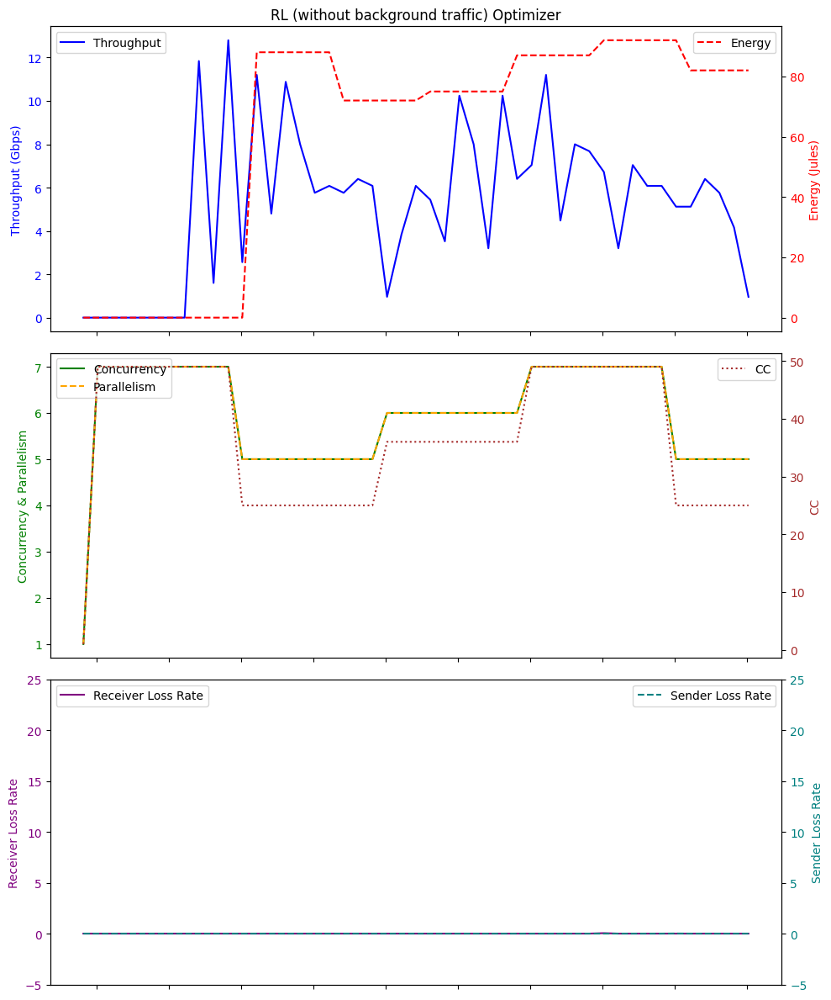

Average Throughput: 5.24936170212766
Total Energy: 2894.0
Total loss rate: 0.01582551465926855
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:24:11.733220        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:24:12.728992        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:24:13.728369        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:24:14.729096        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:24:15.731296        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:25:07.779878        4.48          0.0  36    4.0  32.6   
57 2024-01-26 06:25:08.780700        4.48          0.0  36    4.0  32.6   
58 2024-01-26 06:25:09.782695        4.48          0.0  36    4.0  32.6   
59 2024-01-26 06:25:10.782839        4.48          0.0  36    4.0  32.7   
60 2024-01-26 06:25:11.787043        4.48          0.0  36    4.0  32.6   

    

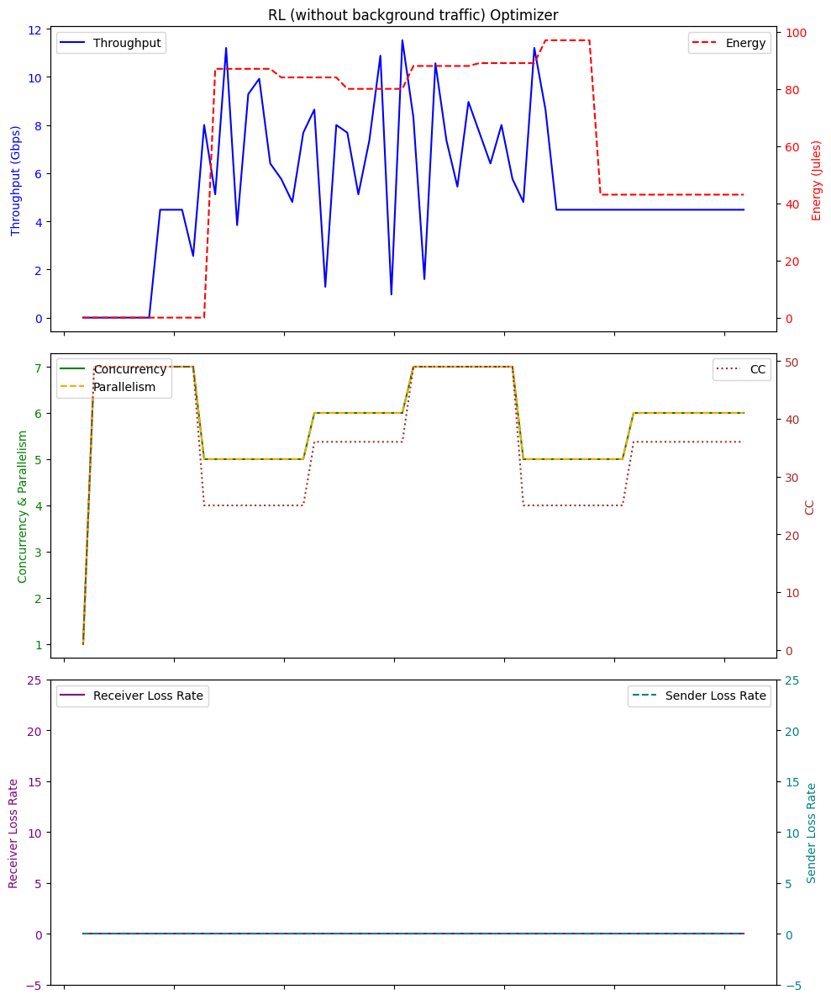

Average Throughput: 5.324590163934428
Total Energy: 3655.0
Total loss rate: 0.005899853557012516
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:08:03.340708         0.0          0.0   1    0.0   0.0   
1  2024-01-26 06:08:04.338158         0.0          0.0  49    0.0   0.0   
2  2024-01-26 06:08:05.339923         0.0          0.0  49    0.0  32.7   
3  2024-01-26 06:08:06.338448         0.0          0.0  49    0.0  32.6   
4  2024-01-26 06:08:07.341833         0.0          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:08:59.391917         1.6          0.0  49    1.0  32.6   
57 2024-01-26 06:09:00.391958         1.6          0.0  49    1.0  32.7   
58 2024-01-26 06:09:01.394317         1.6          0.0  49    1.0  32.8   
59 2024-01-26 06:09:02.394972         1.6          0.0  49    1.0  32.6   
60 2024-01-26 06:09:03.398168         1.6          0.0  49    1.0  32.7   

  

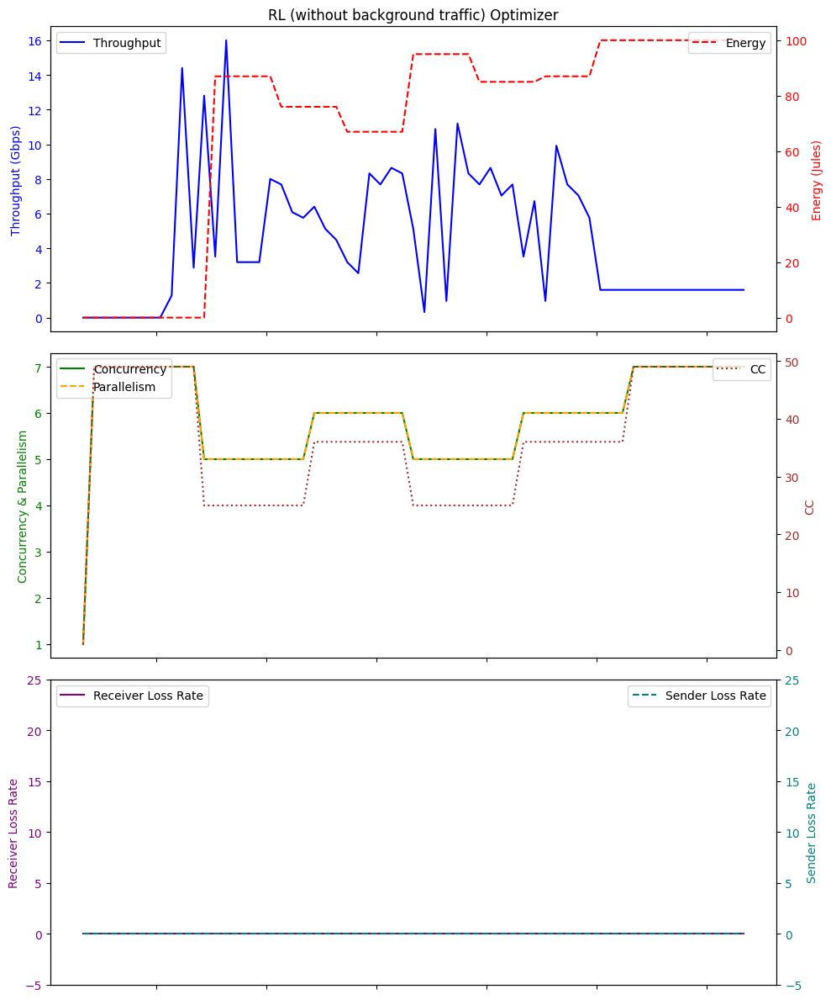

Average Throughput: 4.500983606557379
Total Energy: 4295.0
Total loss rate: 0.00721789623410083
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:52:36.346818        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:52:37.345186        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:52:38.345934        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:52:39.346915        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:52:40.349610        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 05:53:42.410872        0.32          0.0  49    0.0  32.8   
67 2024-01-26 05:53:43.410621        0.32          0.0  49    0.0  32.8   
68 2024-01-26 05:53:44.413813        0.32          0.0  49    0.0  32.7   
69 2024-01-26 05:53:45.414072        0.32          0.0  49    0.0  32.8   
70 2024-01-26 05:53:46.408954        0.32          0.0  49    0.0  32.8   

   

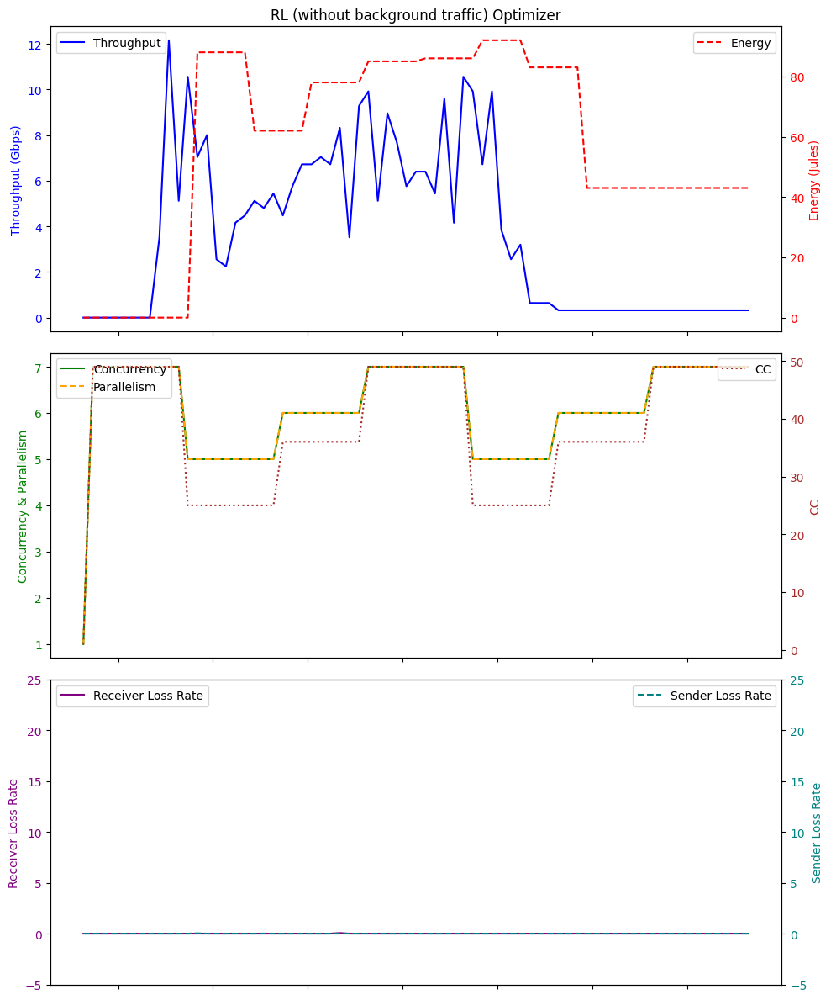

Average Throughput: 3.6416901408450695
Total Energy: 4126.0
Total loss rate: 0.042204740110130826
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:18:56.444371        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:18:57.448448        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:18:58.447730        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:18:59.450616        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:19:00.450882        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:19:52.504230        0.32          0.0  36    0.0  32.7   
57 2024-01-26 06:19:53.504186        0.32          0.0  36    0.0  32.7   
58 2024-01-26 06:19:54.506468        0.32          0.0  36    0.0  32.7   
59 2024-01-26 06:19:55.507780        0.32          0.0  36    0.0  32.8   
60 2024-01-26 06:19:56.508028        0.32          0.0  36    0.0  32.6   

 

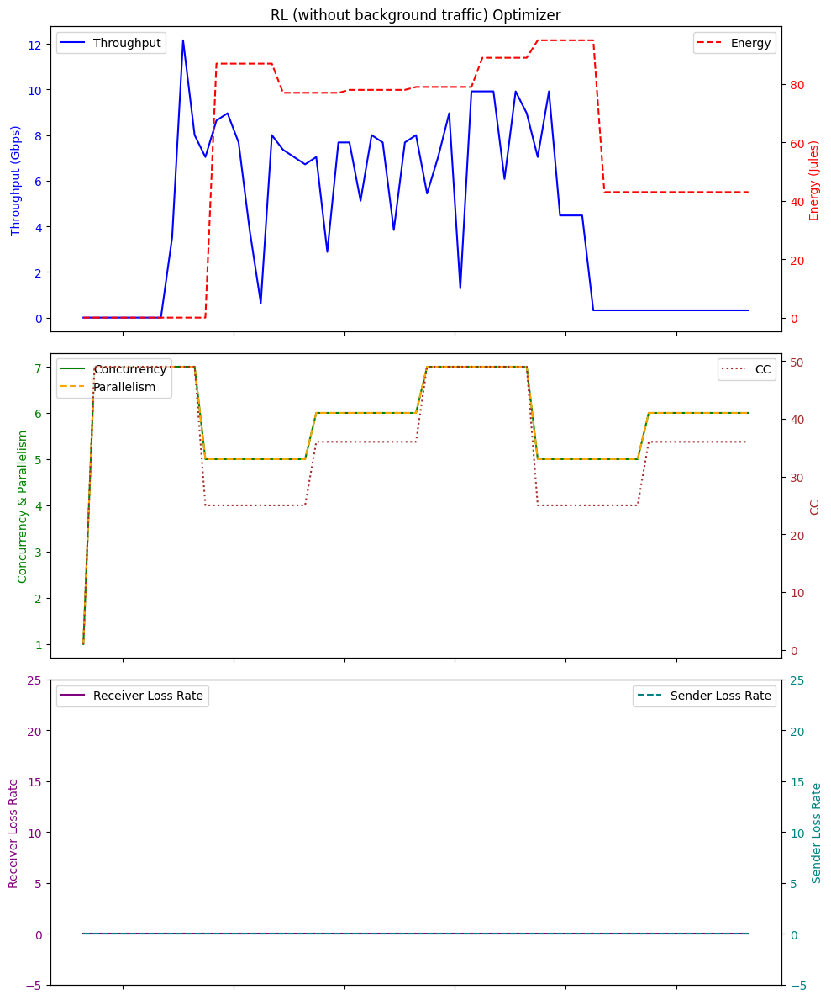

Average Throughput: 4.390819672131147
Total Energy: 3543.0
Total loss rate: 0.005821699091957692
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:36:47.077296        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:36:48.073131        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:36:49.072355        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:36:50.074418        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:36:51.073261        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:37:43.126117        0.96          0.0  36    1.0  32.6   
57 2024-01-26 05:37:44.130141        0.96          0.0  36    1.0  32.7   
58 2024-01-26 05:37:45.130391        0.96          0.0  36    1.0  32.7   
59 2024-01-26 05:37:46.130160        0.96          0.0  36    1.0  32.7   
60 2024-01-26 05:37:47.132597        0.96          0.0  36    1.0  32.7   

  

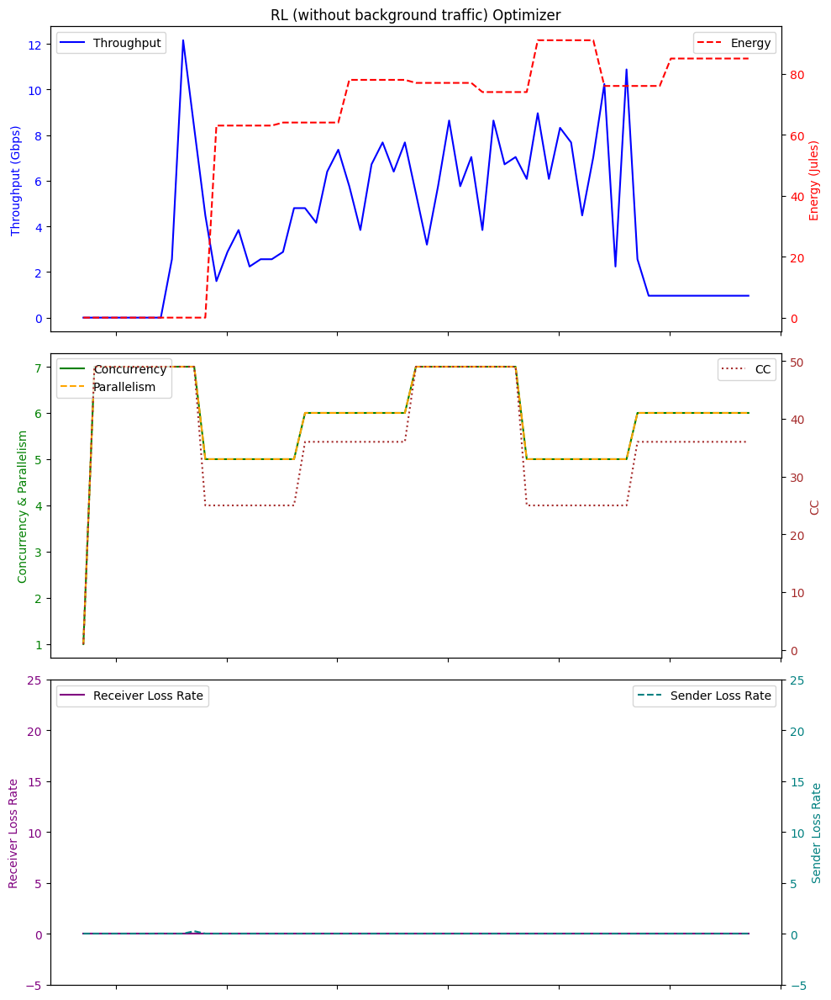

Average Throughput: 4.228196721311475
Total Energy: 3744.0
Total loss rate: 0.24963739725601644
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:46:01.787904        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:46:02.781323        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:46:03.783851        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:46:04.786432        0.00          0.0  49    0.0  32.6   
4  2024-01-26 06:46:05.784465        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:46:57.839307        1.28          0.0  36    1.0  32.6   
57 2024-01-26 06:46:58.839437        1.28          0.0  36    1.0  32.7   
58 2024-01-26 06:46:59.840766        1.28          0.0  36    1.0  32.7   
59 2024-01-26 06:47:00.843275        1.28          0.0  36    1.0  32.7   
60 2024-01-26 06:47:01.844006        1.28          0.0  36    1.0  32.7   

   

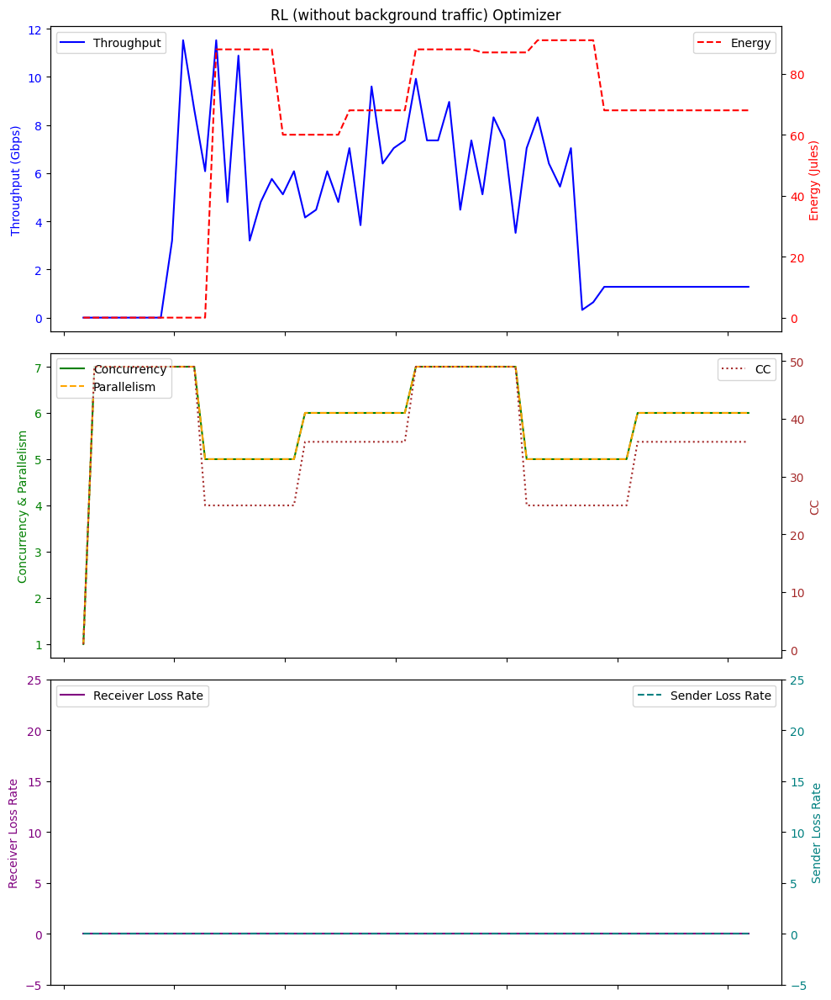

Average Throughput: 4.348852459016391
Total Energy: 3757.0
Total loss rate: 0.027171306412618487
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:35:17.775658        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:35:18.771372        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:35:19.772643        0.00          0.0  49    0.0  32.6   
3  2024-01-26 07:35:20.773056        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:35:21.774585        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
76 2024-01-26 07:36:33.848906        0.64          0.0  25    1.0  34.0   
77 2024-01-26 07:36:34.851232        0.64          0.0  25    1.0  32.7   
78 2024-01-26 07:36:35.851700        0.64          0.0  25    1.0  32.7   
79 2024-01-26 07:36:36.852391        0.64          0.0  25    1.0  32.8   
80 2024-01-26 07:36:37.853708        0.64          0.0  25    1.0  32.7   

  

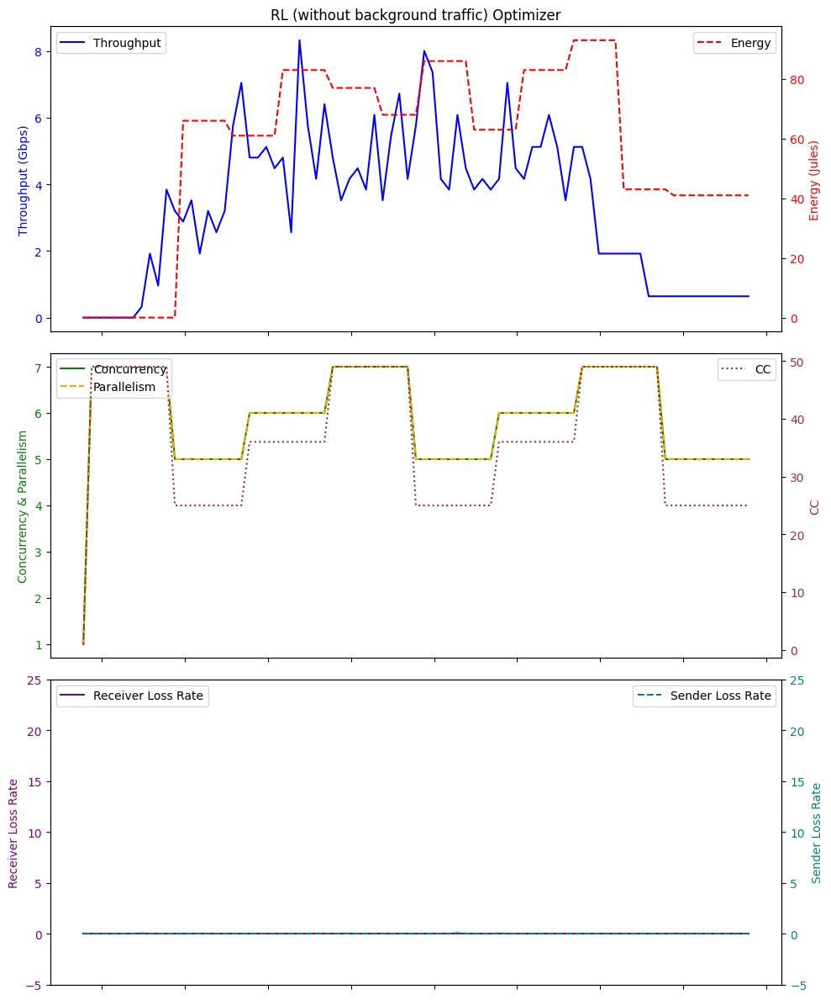

Average Throughput: 3.318518518518519
Total Energy: 4680.0
Total loss rate: 0.13612723568116242
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:57:51.841300        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:57:52.840109        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:57:53.840954        0.00          0.0  49    0.0  32.8   
3  2024-01-26 05:57:54.842681        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:57:55.841782        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:58:47.895925        1.28          0.0  36    1.0  32.7   
57 2024-01-26 05:58:48.897443        1.28          0.0  36    1.0  32.7   
58 2024-01-26 05:58:49.898227        1.28          0.0  36    1.0  32.7   
59 2024-01-26 05:58:50.898181        1.28          0.0  36    1.0  32.8   
60 2024-01-26 05:58:51.900842        1.28          0.0  36    1.0  32.7   

   

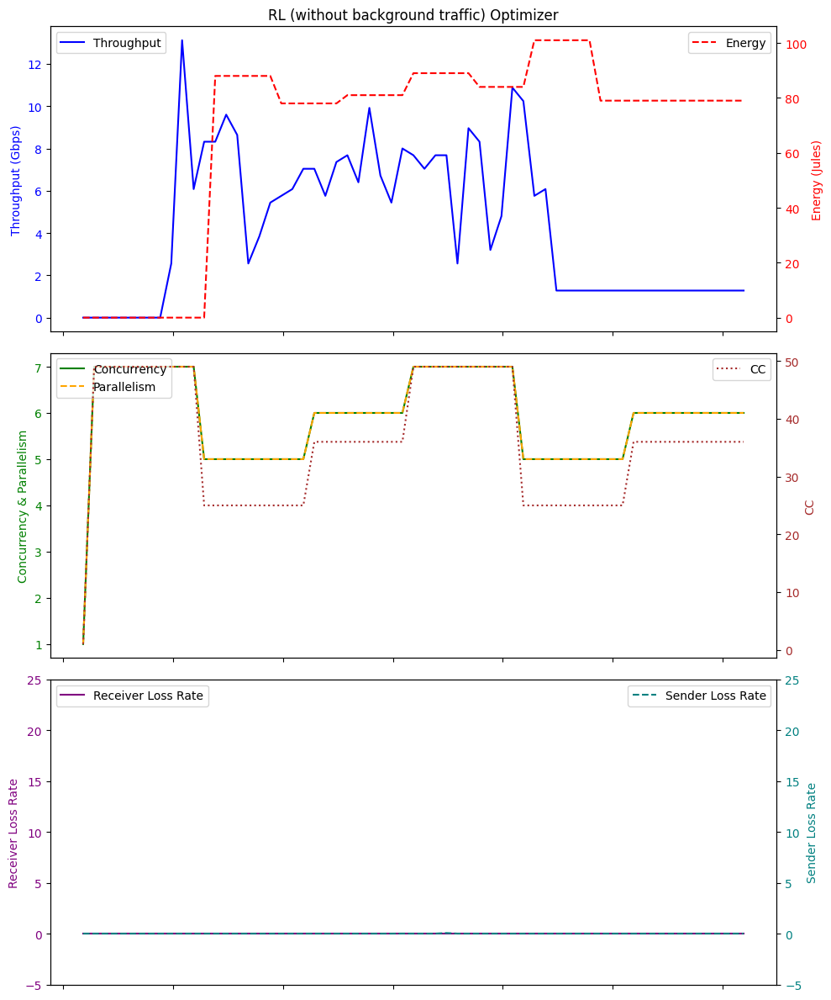

Average Throughput: 4.354098360655736
Total Energy: 4148.0
Total loss rate: 0.06492898266012753
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:29:22.613787        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:29:23.608526        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:29:24.609803        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:29:25.611533        0.00          0.0  49    0.0  32.6   
4  2024-01-26 06:29:26.611024        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 06:30:28.674606        0.32          0.0  49    0.0  32.7   
67 2024-01-26 06:30:29.675534        0.32          0.0  49    0.0  32.7   
68 2024-01-26 06:30:30.678514        0.32          0.0  49    0.0  32.8   
69 2024-01-26 06:30:31.678151        0.32          0.0  49    0.0  32.7   
70 2024-01-26 06:30:32.676502        0.32          0.0  49    0.0  32.7   

   

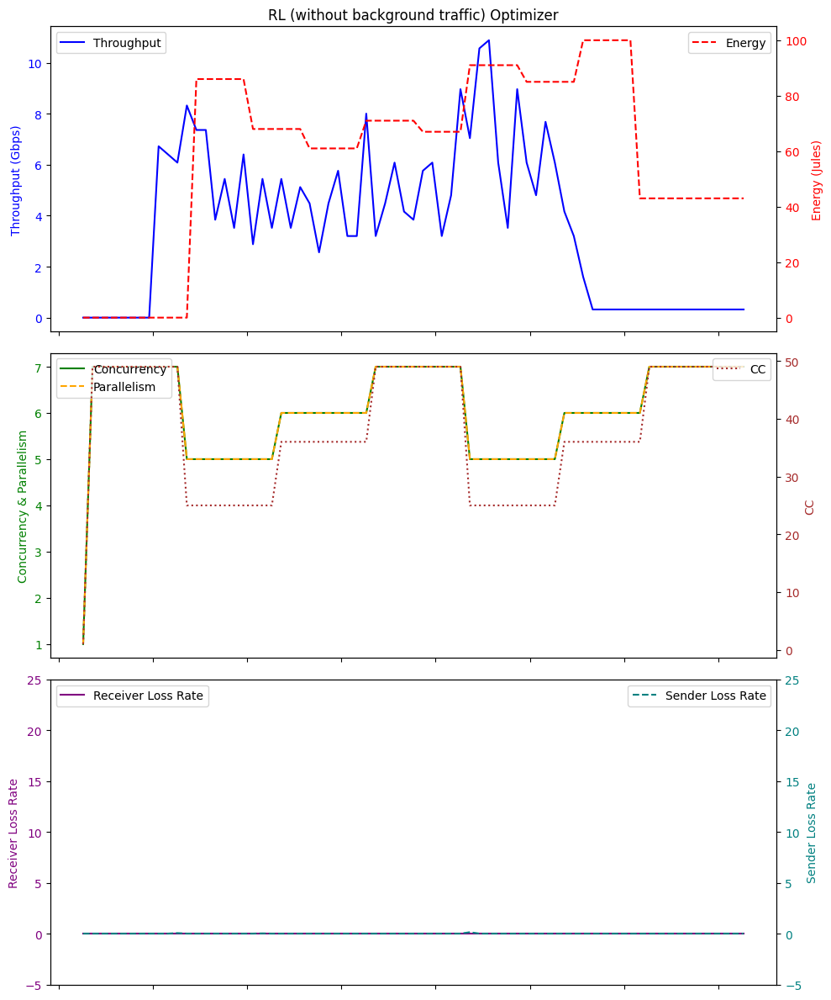

Average Throughput: 3.6011267605633797
Total Energy: 4223.0
Total loss rate: 0.20481339675348606
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:56:44.898439        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:56:45.895438        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:56:46.895823        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:56:47.895917        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:56:48.896066        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:57:40.950214        0.32          0.0  25    0.0  32.8   
57 2024-01-26 06:57:41.951897        0.32          0.0  25    0.0  32.7   
58 2024-01-26 06:57:42.954133        0.32          0.0  25    0.0  32.8   
59 2024-01-26 06:57:43.954001        0.32          0.0  25    0.0  32.7   
60 2024-01-26 06:57:44.955069        0.32          0.0  25    0.0  32.8   

  

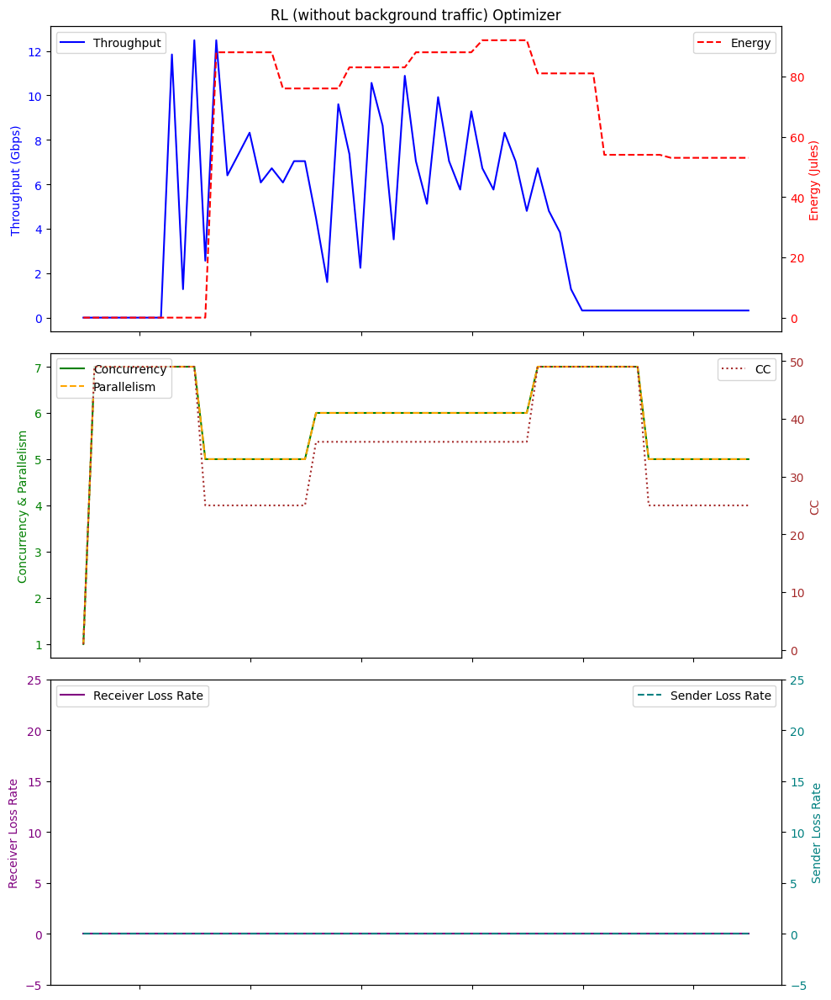

Average Throughput: 4.149508196721311
Total Energy: 3704.0
Total loss rate: 0.006337262763166958
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:09:04.703185        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:09:05.695898        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:09:06.697172        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:09:07.698674        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:09:08.698448        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:10:00.751941        0.32          0.0  49    0.0  32.6   
57 2024-01-26 07:10:01.753588        0.32          0.0  49    0.0  32.7   
58 2024-01-26 07:10:02.753302        0.32          0.0  49    0.0  32.8   
59 2024-01-26 07:10:03.754465        0.32          0.0  49    0.0  32.7   
60 2024-01-26 07:10:04.760396        0.32          0.0  49    0.0  32.6   

  

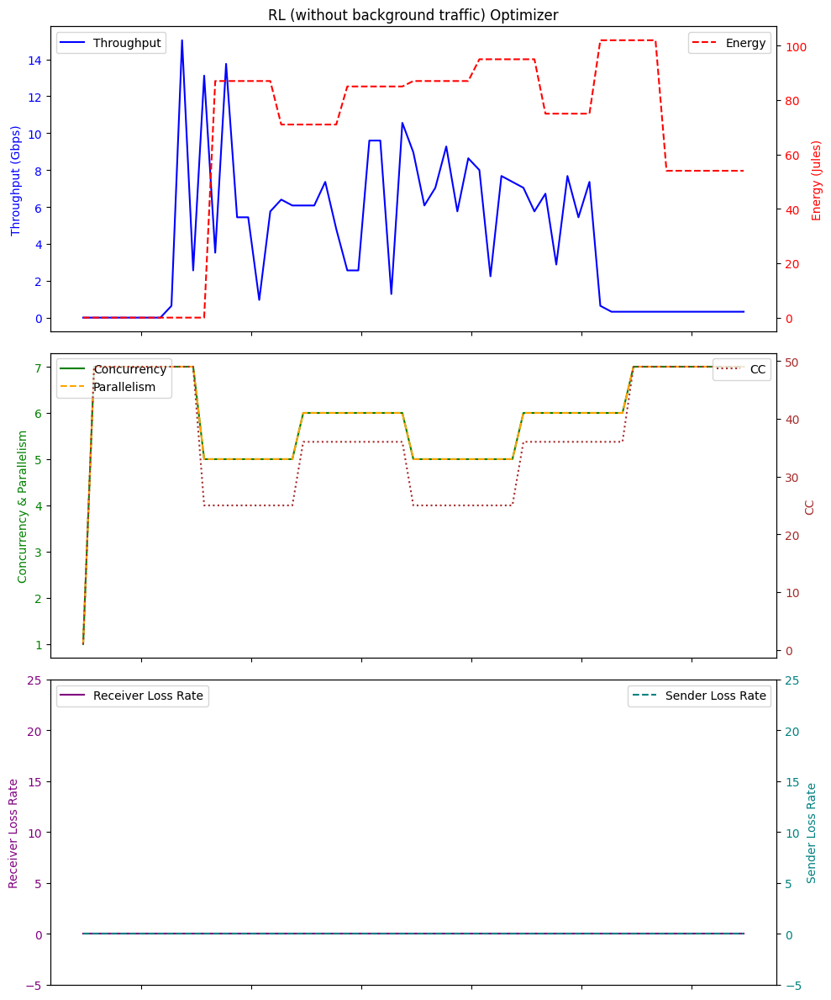

Average Throughput: 4.228196721311475
Total Energy: 3969.0
Total loss rate: 0.0062365488414367985
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:42:08.672122        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:42:09.669132        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:42:10.667573        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:42:11.670127        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:42:12.670084        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:43:04.724699        1.28          0.0  36    1.0  32.6   
57 2024-01-26 05:43:05.726100        1.28          0.0  36    1.0  33.2   
58 2024-01-26 05:43:06.726228        1.28          0.0  36    1.0  32.7   
59 2024-01-26 05:43:07.727974        1.28          0.0  36    1.0  32.7   
60 2024-01-26 05:43:08.728509        1.28          0.0  36    1.0  32.7   

 

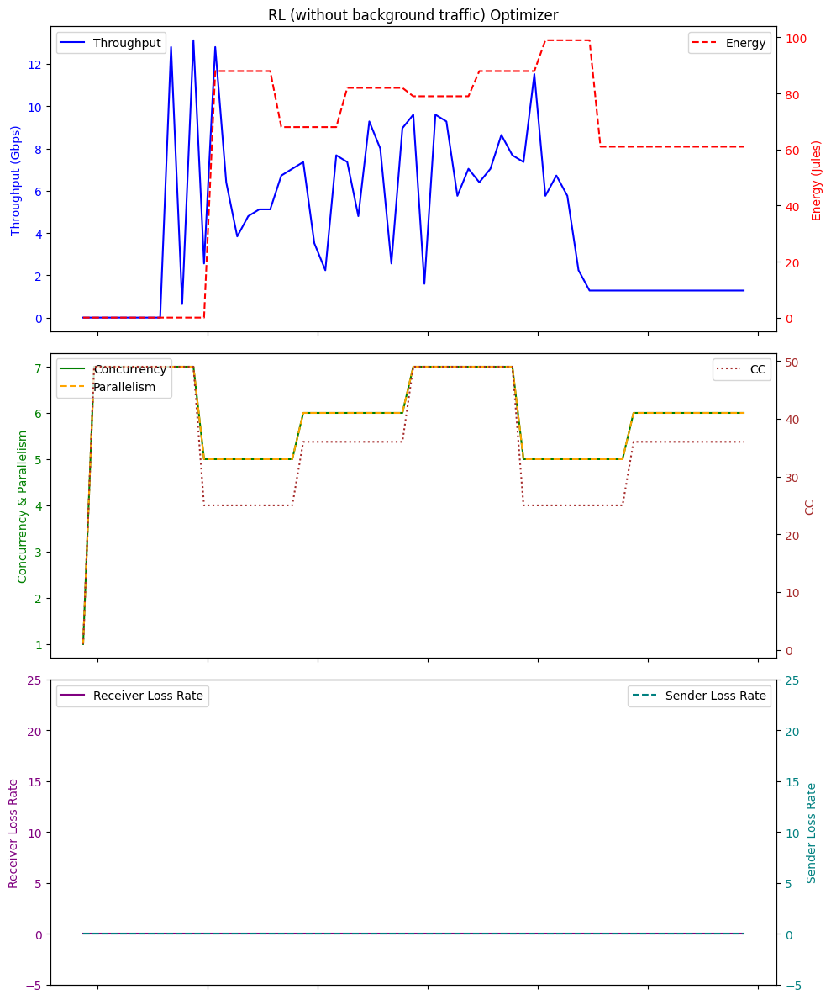

Average Throughput: 4.490491803278686
Total Energy: 3779.0
Total loss rate: 0.009844001551705783
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:20:02.672197        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:20:03.664593        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:20:04.666712        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:20:05.666170        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:20:06.669083        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:20:58.720581        1.92          0.0  36    2.0  32.7   
57 2024-01-26 07:20:59.720765        1.92          0.0  36    2.0  32.7   
58 2024-01-26 07:21:00.723000        1.92          0.0  36    2.0  32.6   
59 2024-01-26 07:21:01.723593        1.92          0.0  36    2.0  32.6   
60 2024-01-26 07:21:02.723633        1.92          0.0  36    2.0  32.7   

  

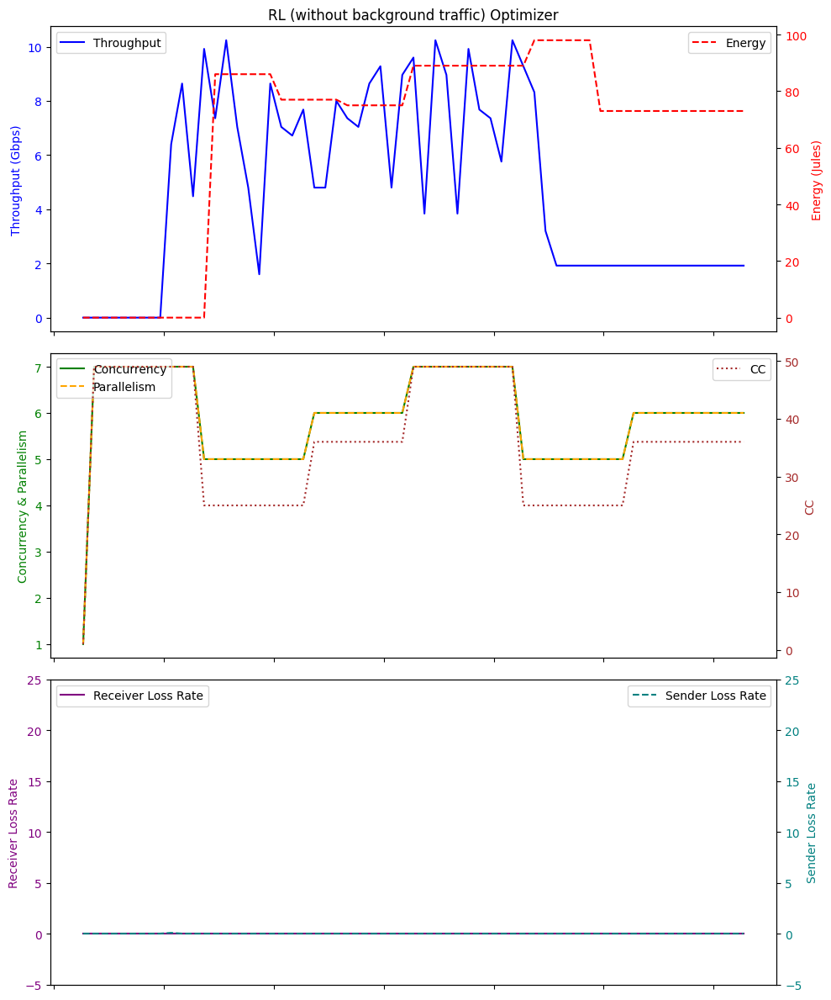

Average Throughput: 4.705573770491805
Total Energy: 4017.0
Total loss rate: 0.08091223452208962
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:25:10.998456        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:25:11.994477        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:25:12.993997        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:25:13.996983        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:25:14.996732        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:26:07.047504        0.64          0.0  36    1.0  32.7   
57 2024-01-26 07:26:08.050283        0.64          0.0  36    1.0  32.7   
58 2024-01-26 07:26:09.050821        0.64          0.0  36    1.0  32.6   
59 2024-01-26 07:26:10.050724        0.64          0.0  36    1.0  32.7   
60 2024-01-26 07:26:11.052659        0.64          0.0  36    1.0  32.7   

   

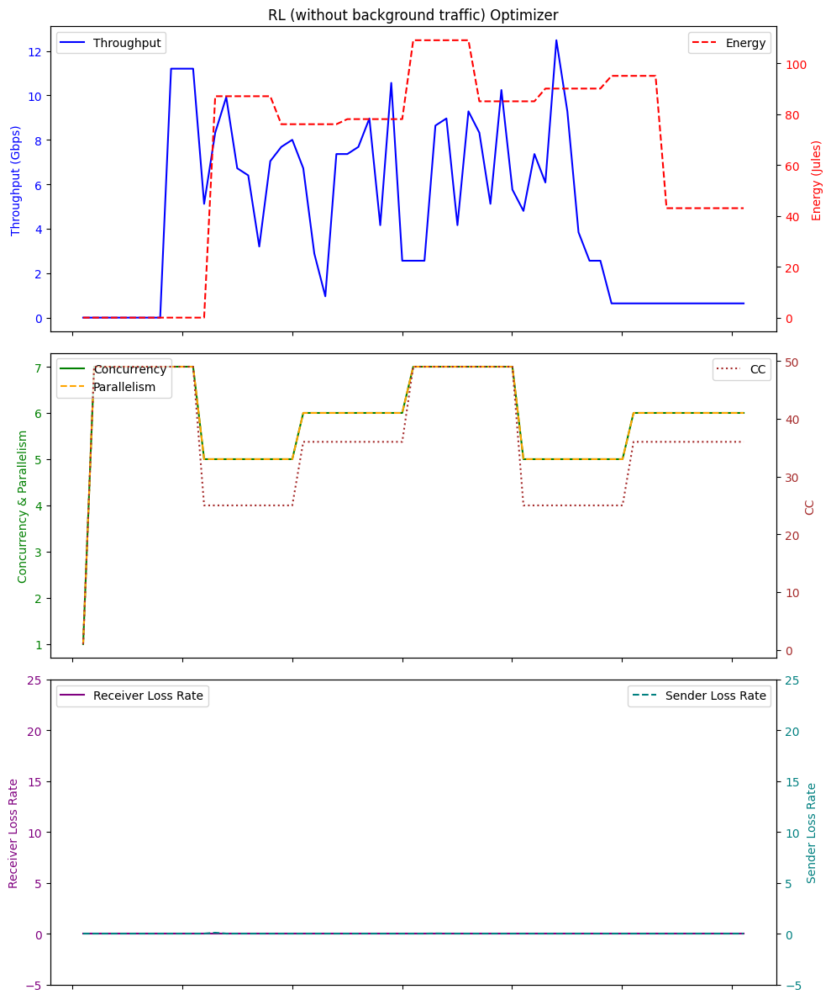

Average Throughput: 4.5586885245901625
Total Energy: 3969.0
Total loss rate: 0.10521464438108191
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:20:26.005078         0.0          0.0   1    0.0   0.0   
1  2024-01-26 05:20:27.004059         0.0          0.0  49    0.0   0.0   
2  2024-01-26 05:20:28.002140         0.0          0.0  49    0.0  32.6   
3  2024-01-26 05:20:29.004677         0.0          0.0  49    0.0  32.7   
4  2024-01-26 05:20:30.003928         0.0          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:21:22.054289         1.6          0.0  36    1.0  32.8   
57 2024-01-26 05:21:23.057444         1.6          0.0  36    1.0  32.8   
58 2024-01-26 05:21:24.056117         1.6          0.0  36    1.0  32.8   
59 2024-01-26 05:21:25.058830         1.6          0.0  36    1.0  32.8   
60 2024-01-26 05:21:26.059636         1.6          0.0  36    1.0  32.9   

  

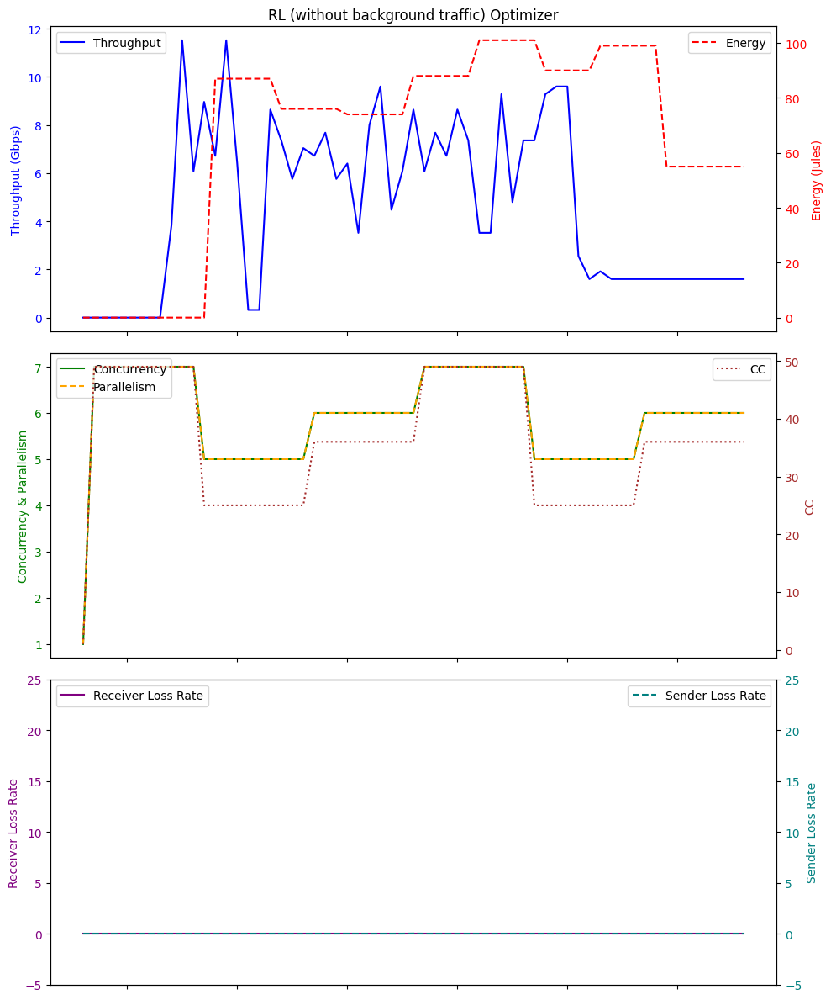

Average Throughput: 4.574426229508199
Total Energy: 4040.0
Total loss rate: 0.016963814634689628
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:03:27.793852        0.00          0.0   1    0.0   0.0   
1  2024-01-26 05:03:28.788003        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:03:29.789052        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:03:30.791539        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:03:31.791616        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:04:23.842496        0.32          0.0  36    0.0  32.7   
57 2024-01-26 05:04:24.845535        0.32          0.0  36    0.0  32.7   
58 2024-01-26 05:04:25.845870        0.32          0.0  36    0.0  32.7   
59 2024-01-26 05:04:26.848372        0.32          0.0  36    0.0  32.7   
60 2024-01-26 05:04:27.845085        0.32          0.0  36    0.0  32.6   

  

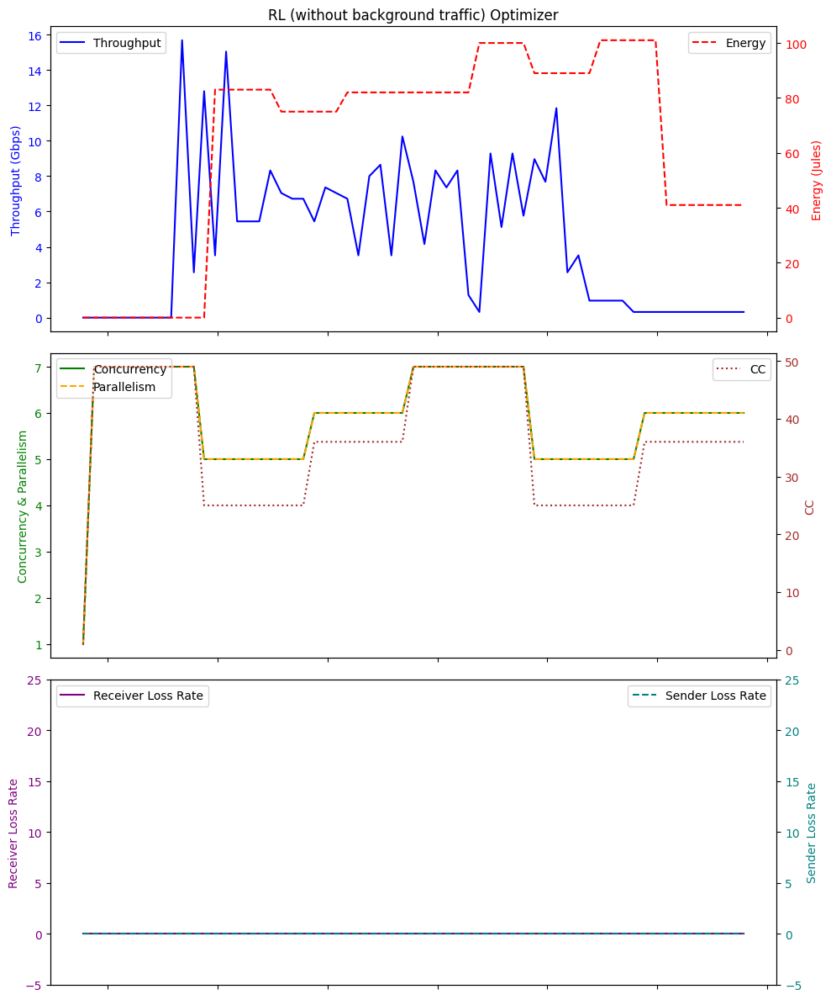

Average Throughput: 4.327868852459017
Total Energy: 3900.0
Total loss rate: 0.006129947744097006
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 04:57:06.449999         0.0          0.0   1    0.0   0.0   
1  2024-01-26 04:57:07.446876         0.0          0.0  49    0.0   0.0   
2  2024-01-26 04:57:08.445694         0.0          0.0  49    0.0  32.6   
3  2024-01-26 04:57:09.446876         0.0          0.0  49    0.0  32.7   
4  2024-01-26 04:57:10.445700         0.0          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 04:58:02.499401         1.6          0.0  49    1.0  32.7   
57 2024-01-26 04:58:03.499072         1.6          0.0  49    1.0  32.7   
58 2024-01-26 04:58:04.500904         1.6          0.0  49    1.0  32.7   
59 2024-01-26 04:58:05.502113         1.6          0.0  49    1.0  32.7   
60 2024-01-26 04:58:06.504312         1.6          0.0  49    1.0  32.7   

  

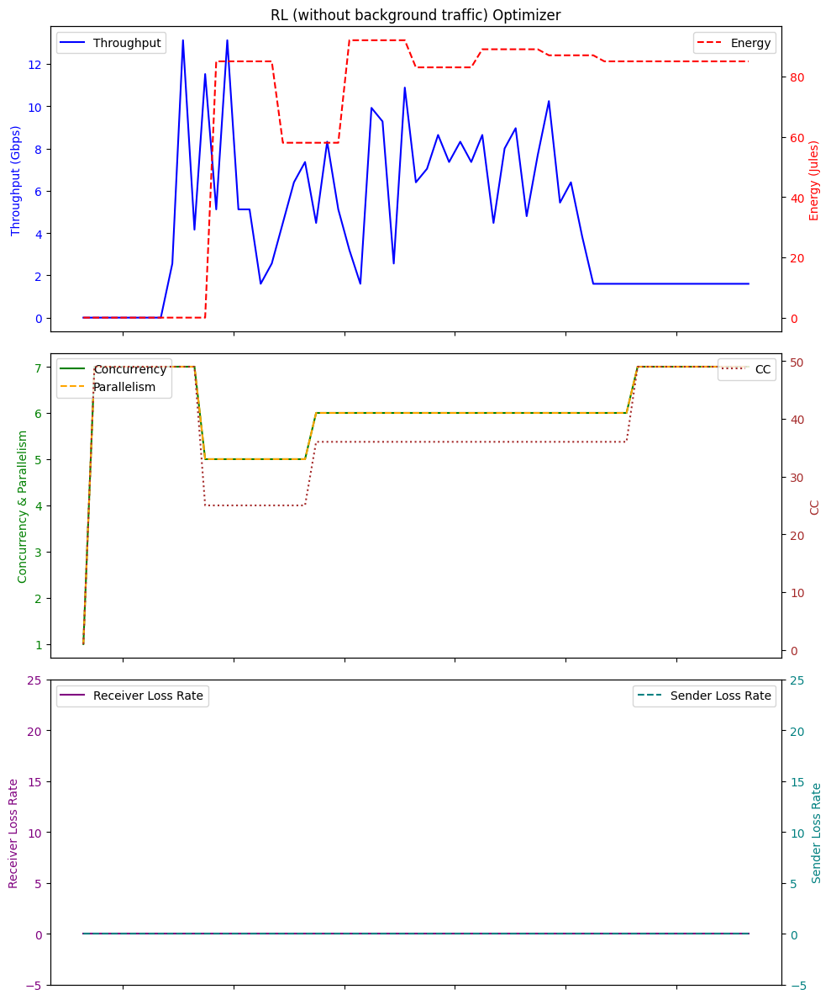

Average Throughput: 4.511475409836068
Total Energy: 4067.0
Total loss rate: 0.003995871832052999
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:51:34.475945        0.00          0.0   1    0.0   0.0   
1  2024-01-26 06:51:35.475023        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:51:36.475261        0.00          0.0  49    0.0  32.8   
3  2024-01-26 06:51:37.474556        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:51:38.477897        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:52:30.528365        0.32          0.0  36    0.0  32.7   
57 2024-01-26 06:52:31.527805        0.32          0.0  36    0.0  32.7   
58 2024-01-26 06:52:32.527882        0.32          0.0  36    0.0  32.7   
59 2024-01-26 06:52:33.531309        0.32          0.0  36    0.0  32.7   
60 2024-01-26 06:52:34.527002        0.32          0.0  36    0.0  32.7   

  

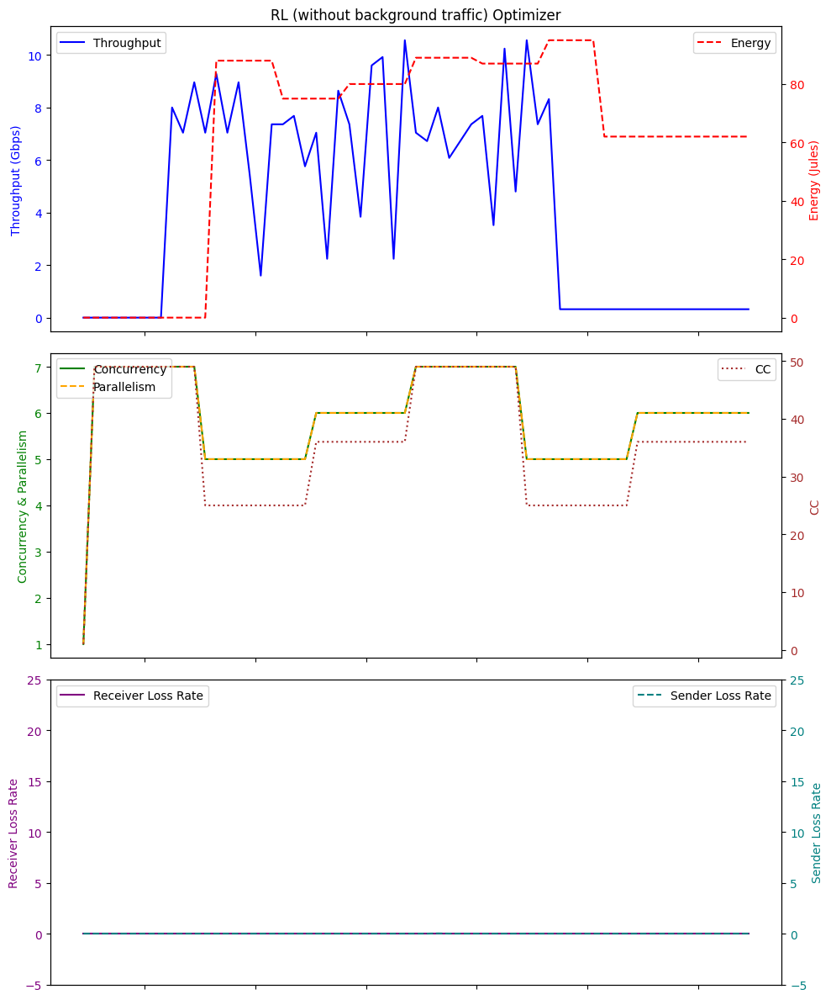

Average Throughput: 4.149508196721311
Total Energy: 3857.0
Total loss rate: 0.022814694019894742
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:40:51.480629        0.00          0.0   1    0.0   0.0   
1  2024-01-26 07:40:52.475803        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:40:53.475092        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:40:54.477665        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:40:55.478286        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:41:47.531917        0.32          0.0  36    0.0  32.7   
57 2024-01-26 07:41:48.532470        0.32          0.0  36    0.0  32.8   
58 2024-01-26 07:41:49.534246        0.32          0.0  36    0.0  32.8   
59 2024-01-26 07:41:50.534674        0.32          0.0  36    0.0  32.7   
60 2024-01-26 07:41:51.532129        0.32          0.0  36    0.0  32.8   

  

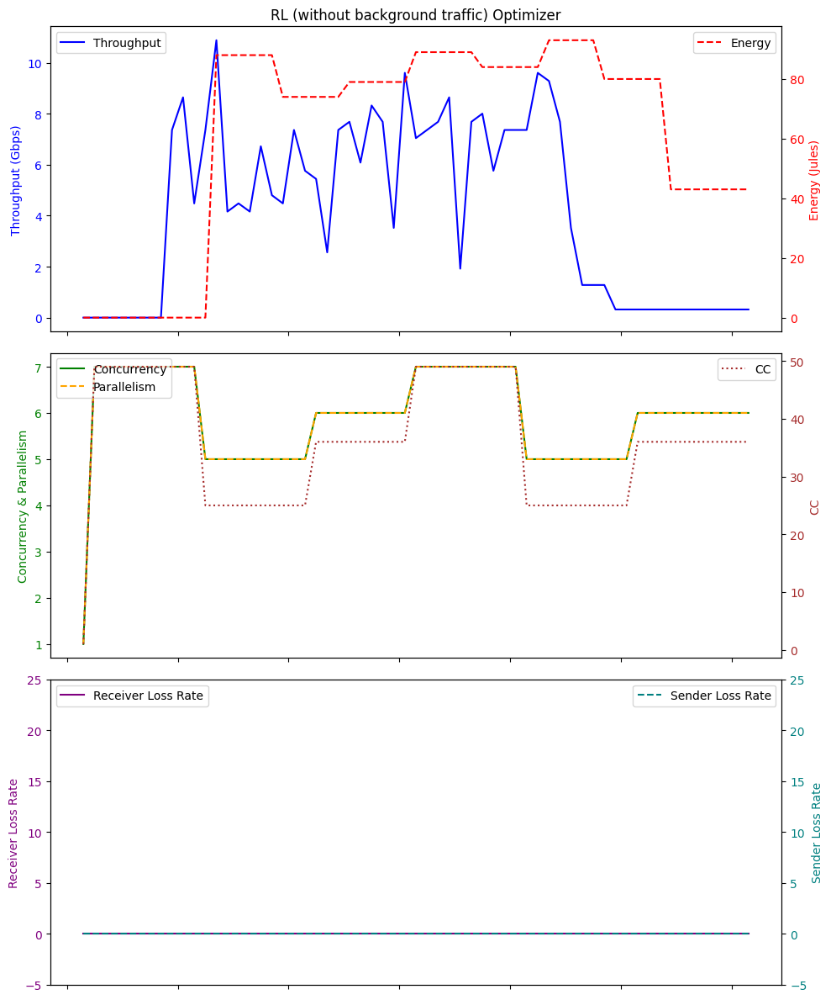

Average Throughput: 4.14950819672131
Total Energy: 3773.0
Total loss rate: 0.011699065624256611


In [13]:
# Example usage RL
directory = './logFileDir_simu_w_bg/PPO/'
dfs = process_log_files(directory,"PPO_logFile_")

ppo_throughput_list=[]
ppo_energy_list=[]
ppo_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('RL (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    ppo_throughput_list.append(average_throughput)
    ppo_energy_list.append(total_energy)
    ppo_plr_list.append(total_plr)


                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:55:42.626771        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:55:43.622959        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:55:44.622372        0.00          0.0  49    0.0  32.8   
3  2024-01-26 06:55:45.624643        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:55:46.625337        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:56:38.674644        0.32          0.0  49    0.0  32.7   
57 2024-01-26 06:56:39.676193        0.32          0.0  49    0.0  32.7   
58 2024-01-26 06:56:40.675414        0.32          0.0  49    0.0  32.9   
59 2024-01-26 06:56:41.677999        0.32          0.0  49    0.0  32.8   
60 2024-01-26 06:56:42.678971        0.32          0.0  49    0.0  32.6   

    Energy  sender_lr  concurrency  parallelism  
0      0.0        0.0            7            7  

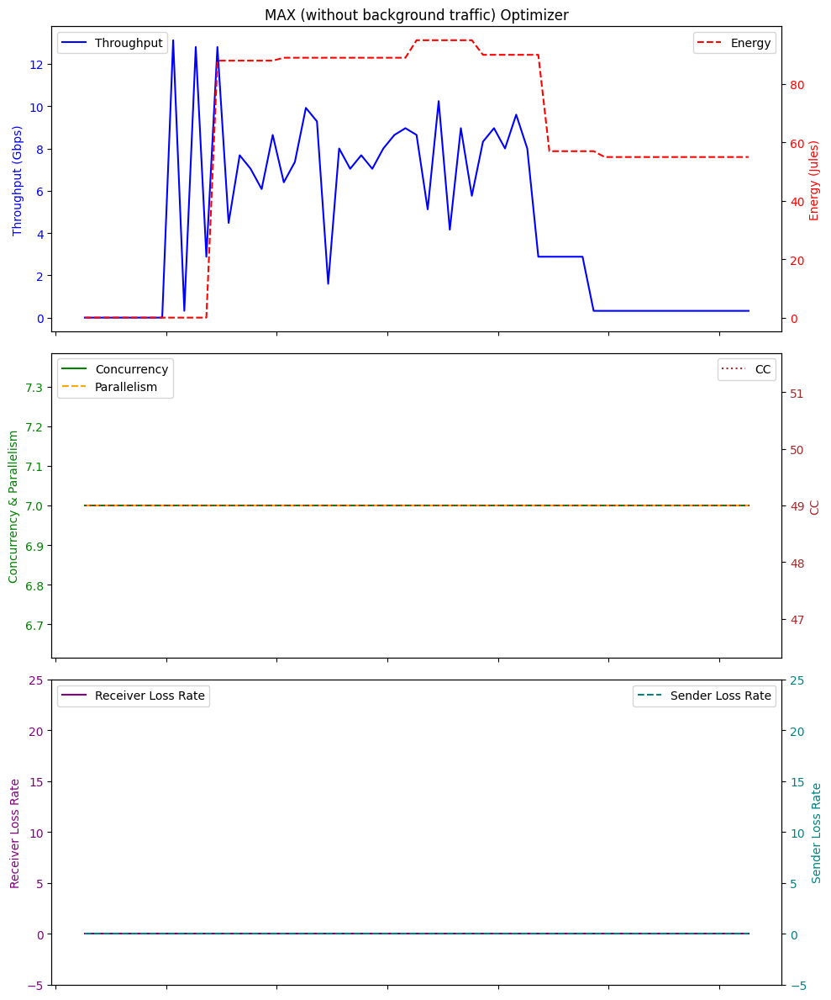

Average Throughput: 4.438032786885246
Total Energy: 3761.0
Total loss rate: 0.009864732099468466
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:29:22.510154        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:29:23.505900        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:29:24.507262        0.00          0.0  49    0.0  32.9   
3  2024-01-26 07:29:25.505844        0.00          0.0  49    0.0  32.8   
4  2024-01-26 07:29:26.509014        0.00          0.0  49    0.0  32.7   
5  2024-01-26 07:29:27.508674        0.00          0.0  49    0.0  32.7   
6  2024-01-26 07:29:28.513509        0.00          0.0  49    0.0  32.7   
7  2024-01-26 07:29:29.514837        0.00          0.0  49    0.0  33.2   
8  2024-01-26 07:29:30.515223        8.96          0.0  49    8.0  32.7   
9  2024-01-26 07:29:31.551361        8.96          0.0  49    8.0  35.7   
10 2024-01-26 07:29:32.505687        8.96          0.0  49    0.0  33.4   
11 

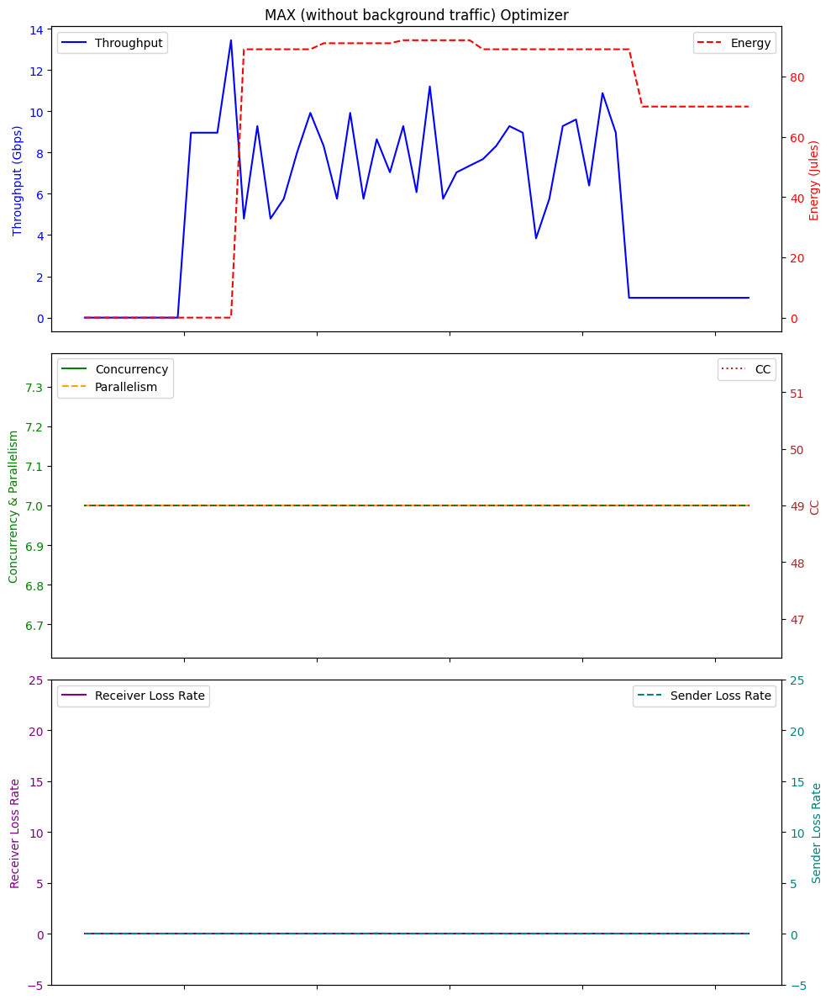

Average Throughput: 5.364705882352941
Total Energy: 3330.0
Total loss rate: 0.0336485209670626
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:19:23.727651        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:19:24.723443        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:19:25.726773        0.00          0.0  49    0.0  32.8   
3  2024-01-26 05:19:26.726792        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:19:27.727496        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:20:19.778150        0.64          0.0  49    1.0  32.7   
57 2024-01-26 05:20:20.777969        0.64          0.0  49    1.0  32.7   
58 2024-01-26 05:20:21.780711        0.64          0.0  49    1.0  32.9   
59 2024-01-26 05:20:22.781507        0.64          0.0  49    1.0  32.7   
60 2024-01-26 05:20:23.779382        0.64          0.0  49    1.0  32.8   

    

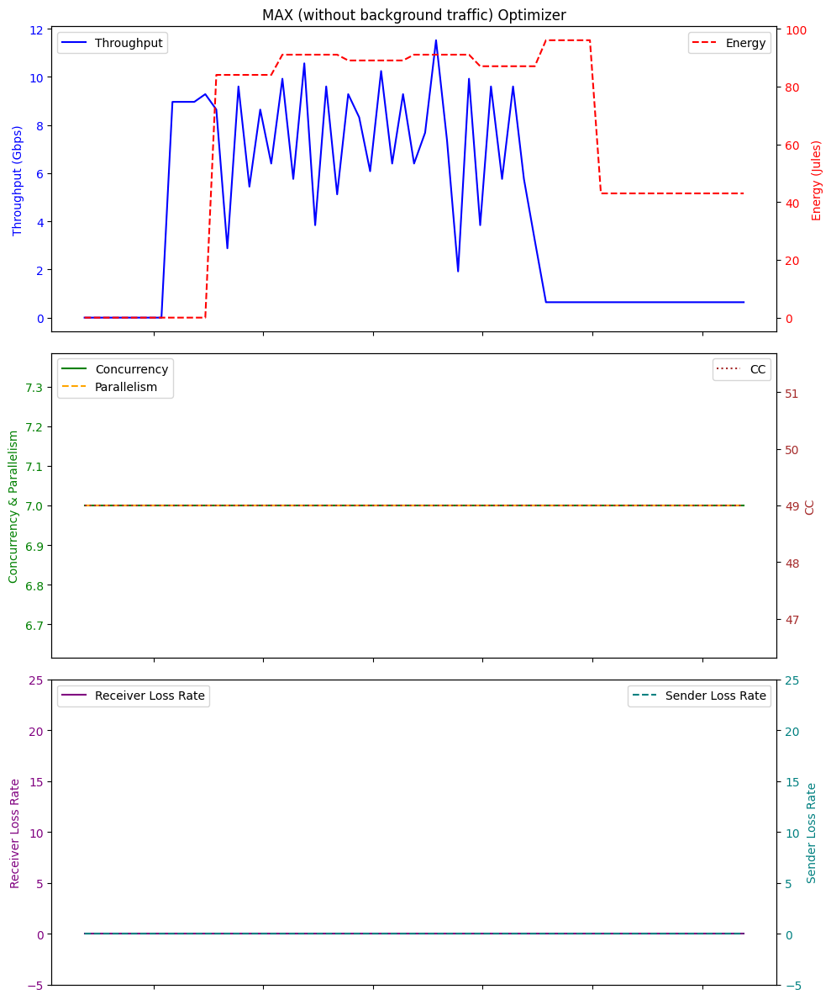

Average Throughput: 4.375081967213115
Total Energy: 3734.0
Total loss rate: 0.008539443725216235
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:33:44.580582        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:33:45.577106        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:33:46.577860        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:33:47.579267        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:33:48.577880        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:34:40.626797        0.32          0.0  49    0.0  32.7   
57 2024-01-26 06:34:41.627124        0.32          0.0  49    0.0  32.7   
58 2024-01-26 06:34:42.630489        0.32          0.0  49    0.0  32.7   
59 2024-01-26 06:34:43.630687        0.32          0.0  49    0.0  32.7   
60 2024-01-26 06:34:44.629338        0.32          0.0  49    0.0  32.7   

  

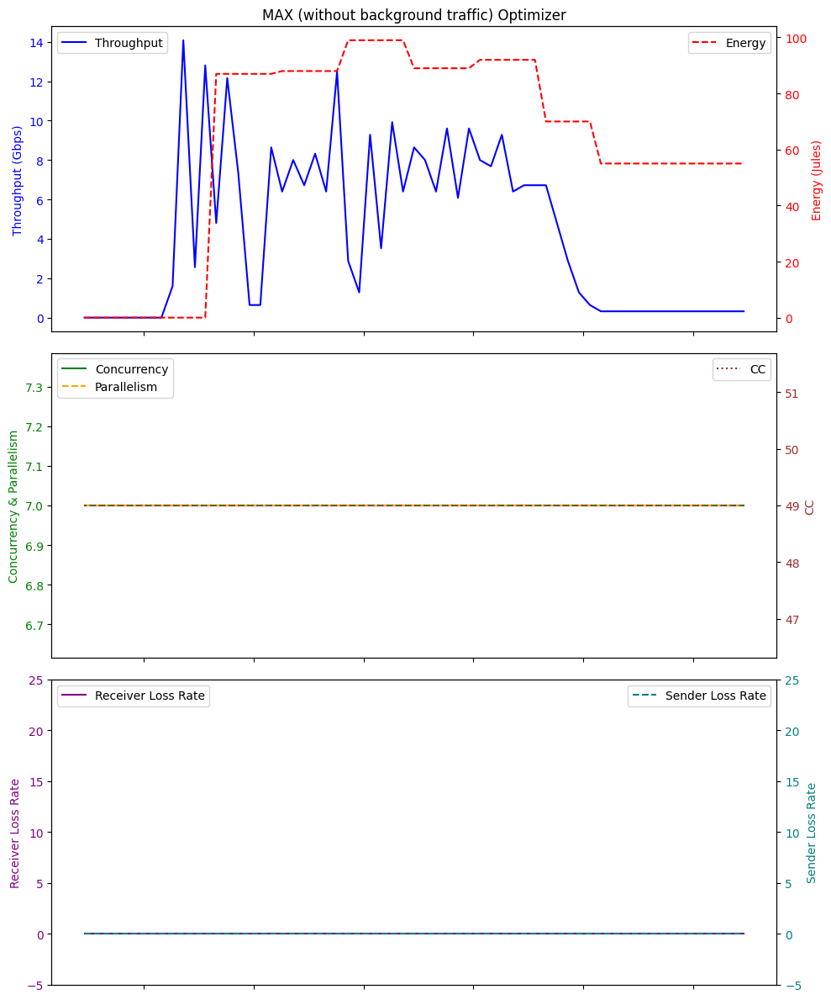

Average Throughput: 4.275409836065574
Total Energy: 3850.0
Total loss rate: 0.016712089706247792
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:13:35.429996        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:13:36.424881        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:13:37.428412        0.00          0.0  49    0.0  32.8   
3  2024-01-26 07:13:38.428156        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:13:39.430131        0.00          0.0  49    0.0  32.6   
5  2024-01-26 07:13:40.431985        0.00          0.0  49    0.0  32.6   
6  2024-01-26 07:13:41.434614        0.00          0.0  49    0.0  32.6   
7  2024-01-26 07:13:42.434882        0.00          0.0  49    0.0  33.2   
8  2024-01-26 07:13:43.437008        8.96          0.0  49    8.0  33.0   
9  2024-01-26 07:13:44.461436        8.96          0.0  49    8.0  33.6   
10 2024-01-26 07:13:45.426402        8.96          0.0  49    0.0  32.7   
11 

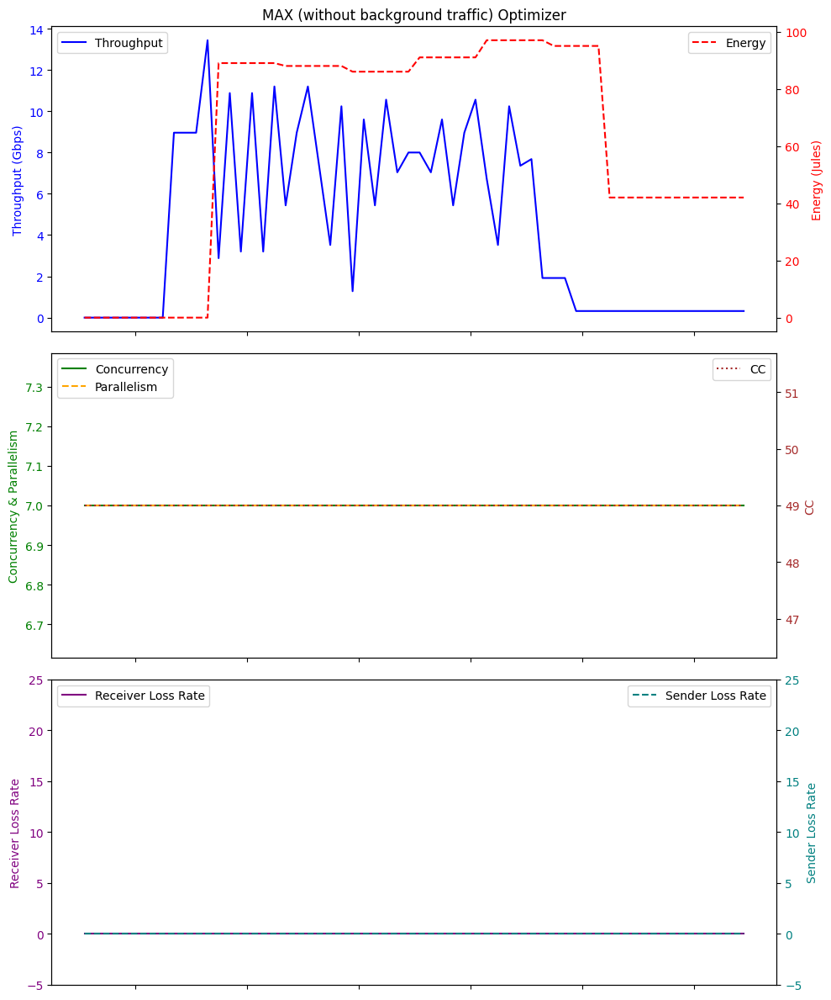

Average Throughput: 4.453333333333333
Total Energy: 3727.0
Total loss rate: 0.006618194570127941
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:19:00.409918        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:19:01.402613        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:19:02.405153        0.00          0.0  49    0.0  32.6   
3  2024-01-26 07:19:03.405102        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:19:04.404702        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:19:56.457643        0.32          0.0  49    0.0  32.7   
57 2024-01-26 07:19:57.460731        0.32          0.0  49    0.0  32.7   
58 2024-01-26 07:19:58.461007        0.32          0.0  49    0.0  32.7   
59 2024-01-26 07:19:59.460749        0.32          0.0  49    0.0  32.7   
60 2024-01-26 07:20:00.463481        0.32          0.0  49    0.0  32.7   

  

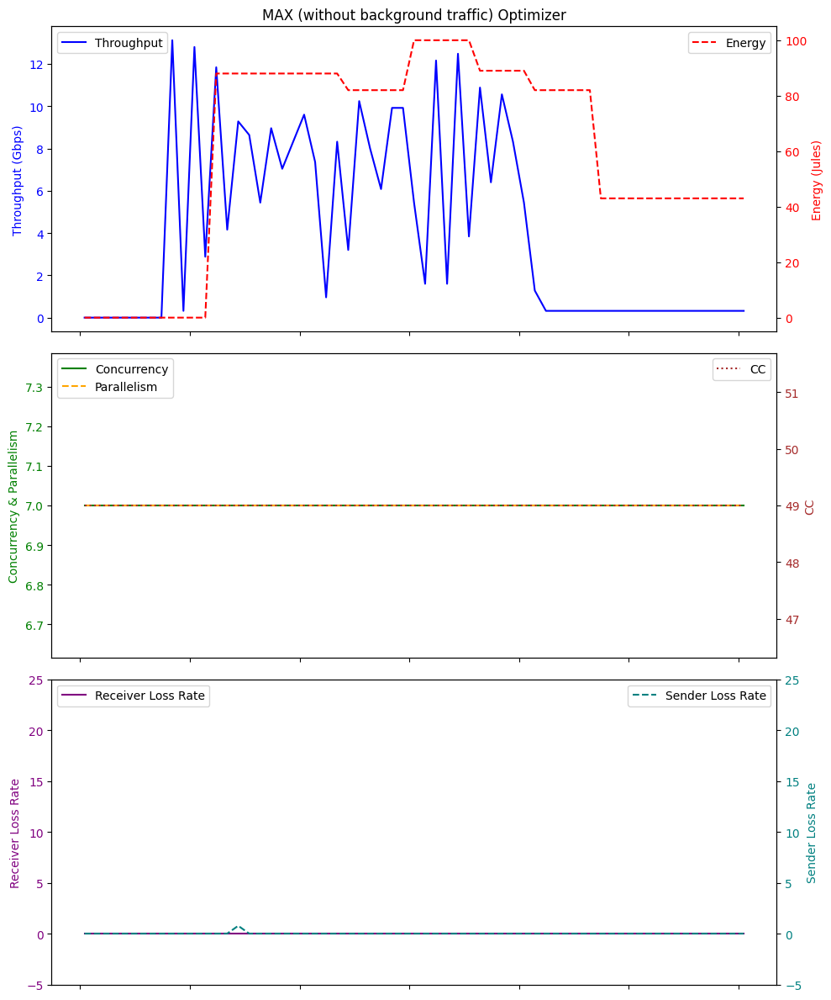

Average Throughput: 4.139016393442622
Total Energy: 3687.0
Total loss rate: 0.7728493747856686
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:24:47.517383        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:24:48.515575        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:24:49.517189        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:24:50.516338        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:24:51.517016        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:25:43.565424        0.32          0.0  49    0.0  32.7   
57 2024-01-26 05:25:44.568638        0.32          0.0  49    0.0  32.7   
58 2024-01-26 05:25:45.568491        0.32          0.0  49    0.0  32.7   
59 2024-01-26 05:25:46.568214        0.32          0.0  49    0.0  32.7   
60 2024-01-26 05:25:47.561284        0.32          0.0  49    0.0  32.7   

    

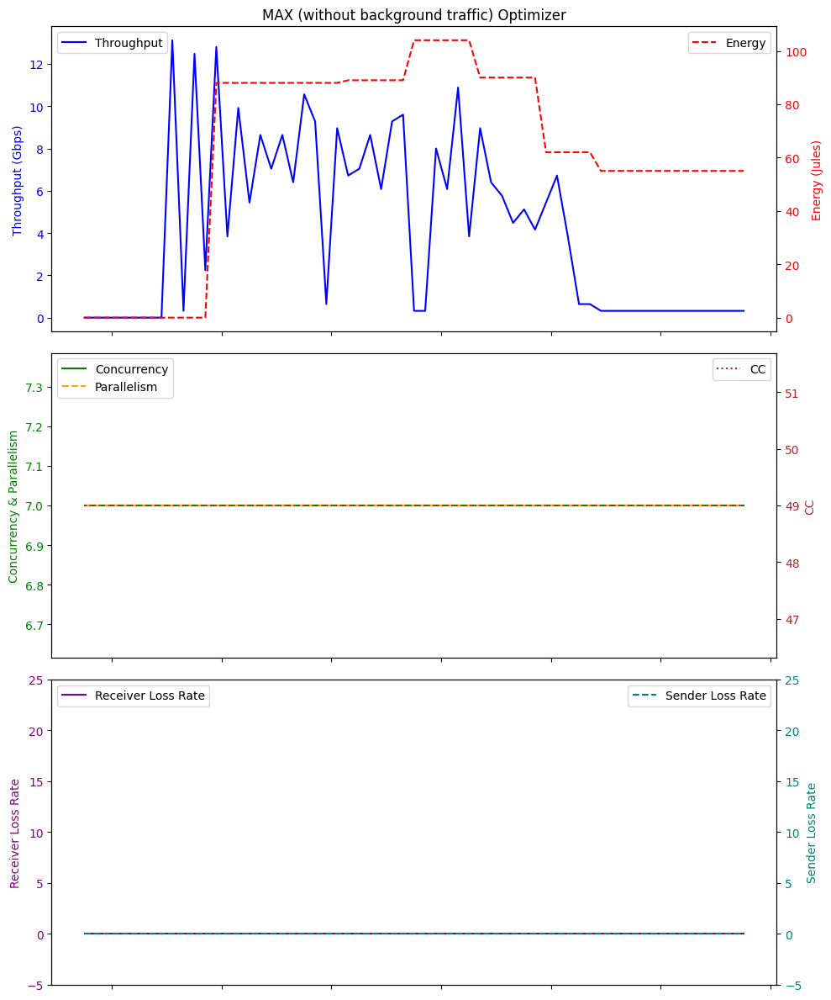

Average Throughput: 4.159999999999999
Total Energy: 3834.0
Total loss rate: 0.01789467960974513
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:39:49.214808        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:39:50.212233        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:39:51.213881        0.00          0.0  49    0.0  32.8   
3  2024-01-26 07:39:52.214085        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:39:53.215702        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:40:45.265058        0.96          0.0  49    1.0  32.7   
57 2024-01-26 07:40:46.266791        0.96          0.0  49    1.0  32.7   
58 2024-01-26 07:40:47.266576        0.96          0.0  49    1.0  33.0   
59 2024-01-26 07:40:48.266216        0.96          0.0  49    1.0  32.6   
60 2024-01-26 07:40:49.261082        0.96          0.0  49    1.0  32.7   

   

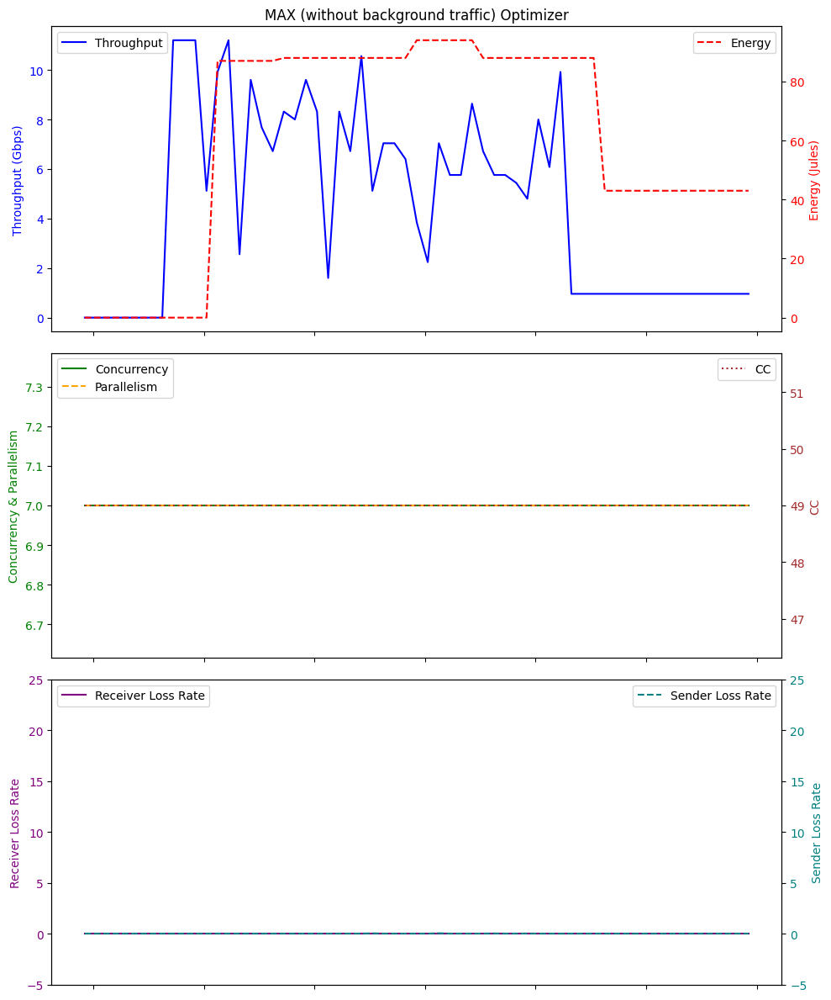

Average Throughput: 4.516721311475409
Total Energy: 3712.0
Total loss rate: 0.07699482121381497
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:35:34.825444        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:35:35.822006        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:35:36.821649        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:35:37.821779        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:35:38.824207        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
65 2024-01-26 05:36:39.883383        0.32          0.0  49    0.0  32.7   
66 2024-01-26 05:36:40.883175        0.32          0.0  49    0.0  32.7   
67 2024-01-26 05:36:41.886408        0.32          0.0  49    0.0  32.7   
68 2024-01-26 05:36:42.887109        0.32          0.0  49    0.0  32.6   
69 2024-01-26 05:36:43.886732        0.32          0.0  49    0.0  32.6   

   

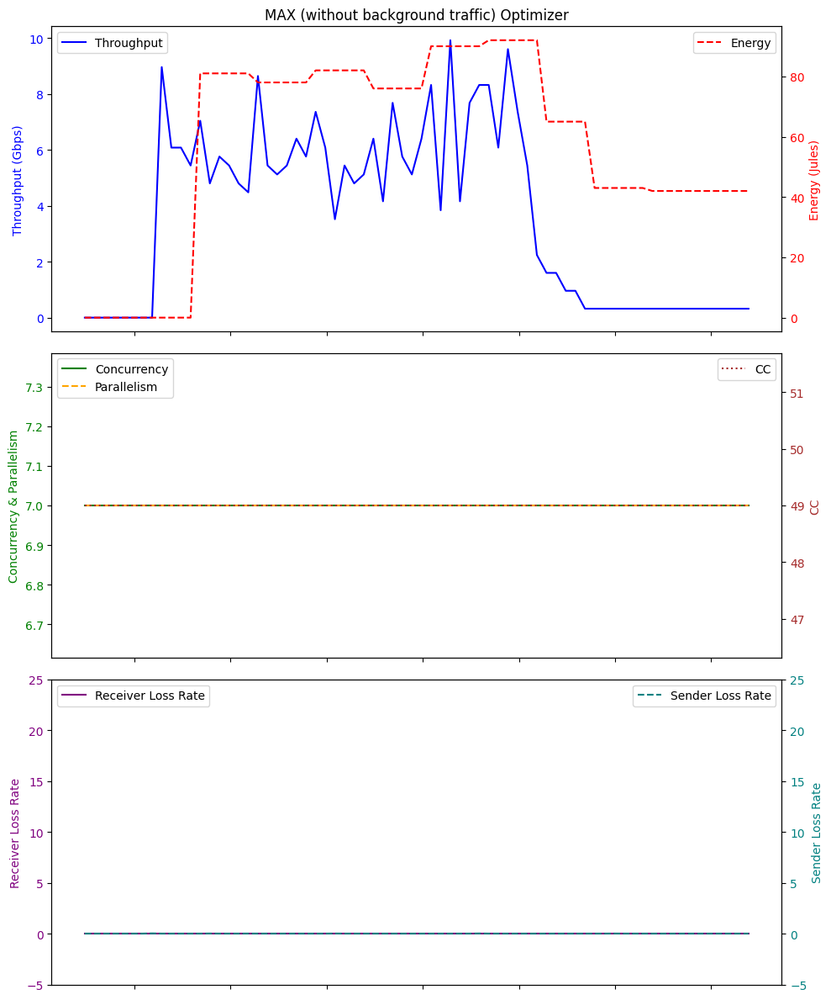

Average Throughput: 3.652571428571428
Total Energy: 4039.0
Total loss rate: 0.05661972474779253
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:28:20.353101        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:28:21.347455        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:28:22.350435        0.00          0.0  49    0.0  32.8   
3  2024-01-26 06:28:23.349524        0.00          0.0  49    0.0  32.8   
4  2024-01-26 06:28:24.352288        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:29:16.400465        0.32          0.0  49    0.0  32.6   
57 2024-01-26 06:29:17.400542        0.32          0.0  49    0.0  32.6   
58 2024-01-26 06:29:18.402363        0.32          0.0  49    0.0  32.7   
59 2024-01-26 06:29:19.402956        0.32          0.0  49    0.0  32.8   
60 2024-01-26 06:29:20.403142        0.32          0.0  49    0.0  32.8   

   

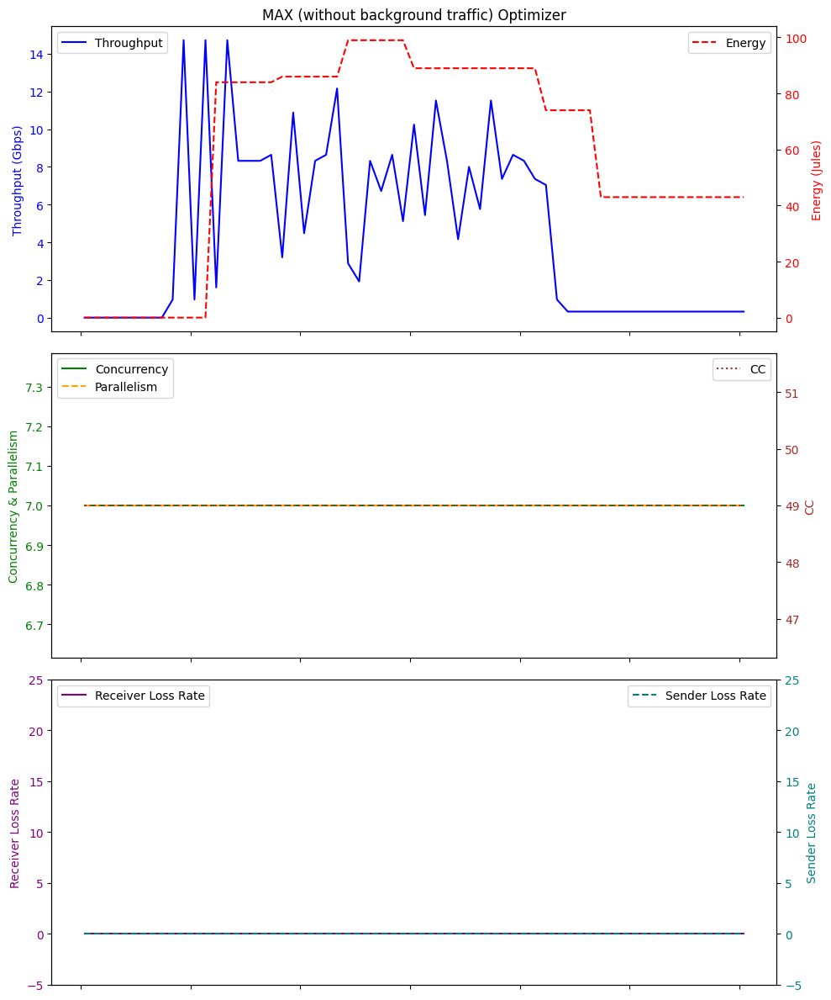

Average Throughput: 4.469508196721311
Total Energy: 3654.0
Total loss rate: 0.008271259602537832
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:08:02.420056        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:08:03.415826        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:08:04.419554        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:08:05.418246        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:08:06.420217        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:08:58.470685        2.24          0.0  49    2.0  32.7   
57 2024-01-26 07:08:59.469511        2.24          0.0  49    2.0  32.7   
58 2024-01-26 07:09:00.472620        2.24          0.0  49    2.0  32.7   
59 2024-01-26 07:09:01.473146        2.24          0.0  49    2.0  32.8   
60 2024-01-26 07:09:02.473005        2.24          0.0  49    2.0  32.8   

  

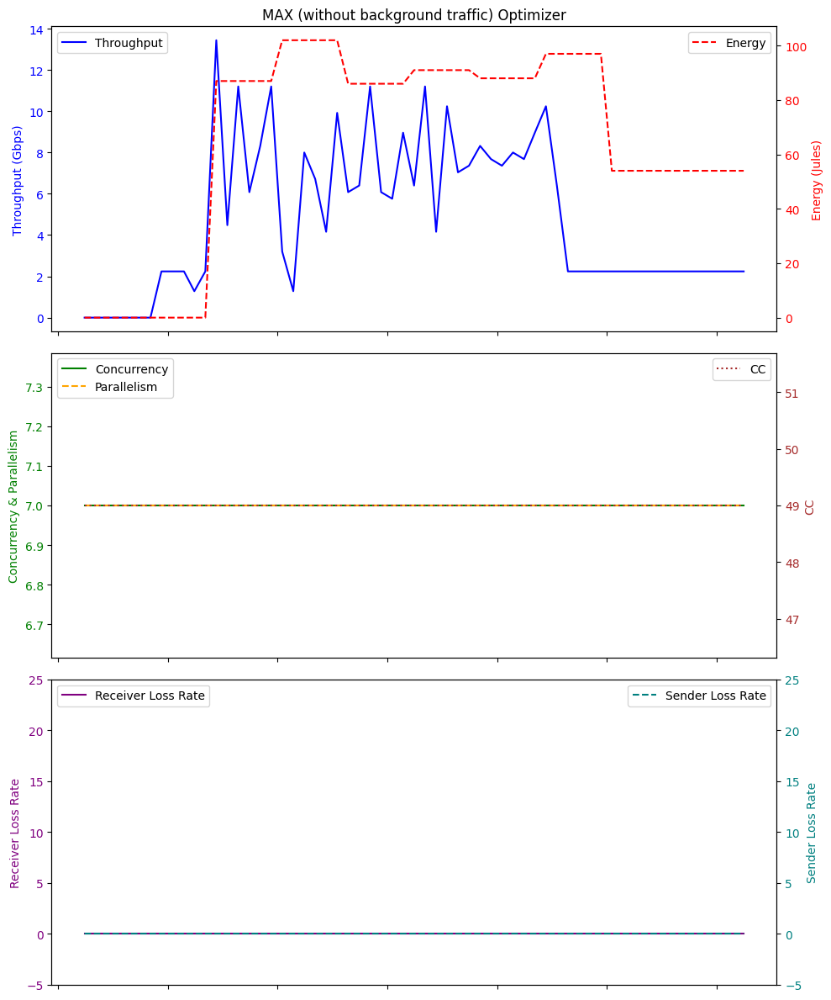

Average Throughput: 4.784262295081968
Total Energy: 4008.0
Total loss rate: 0.008003866793391367
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:01:46.711516        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:01:47.710755        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:01:48.707338        0.00          0.0  49    0.0  32.6   
3  2024-01-26 05:01:49.711448        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:01:50.710640        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:02:42.763250        0.32          0.0  49    0.0  32.7   
57 2024-01-26 05:02:43.763963        0.32          0.0  49    0.0  32.7   
58 2024-01-26 05:02:44.764454        0.32          0.0  49    0.0  32.7   
59 2024-01-26 05:02:45.767707        0.32          0.0  49    0.0  32.6   
60 2024-01-26 05:02:46.767256        0.32          0.0  49    0.0  32.8   

  

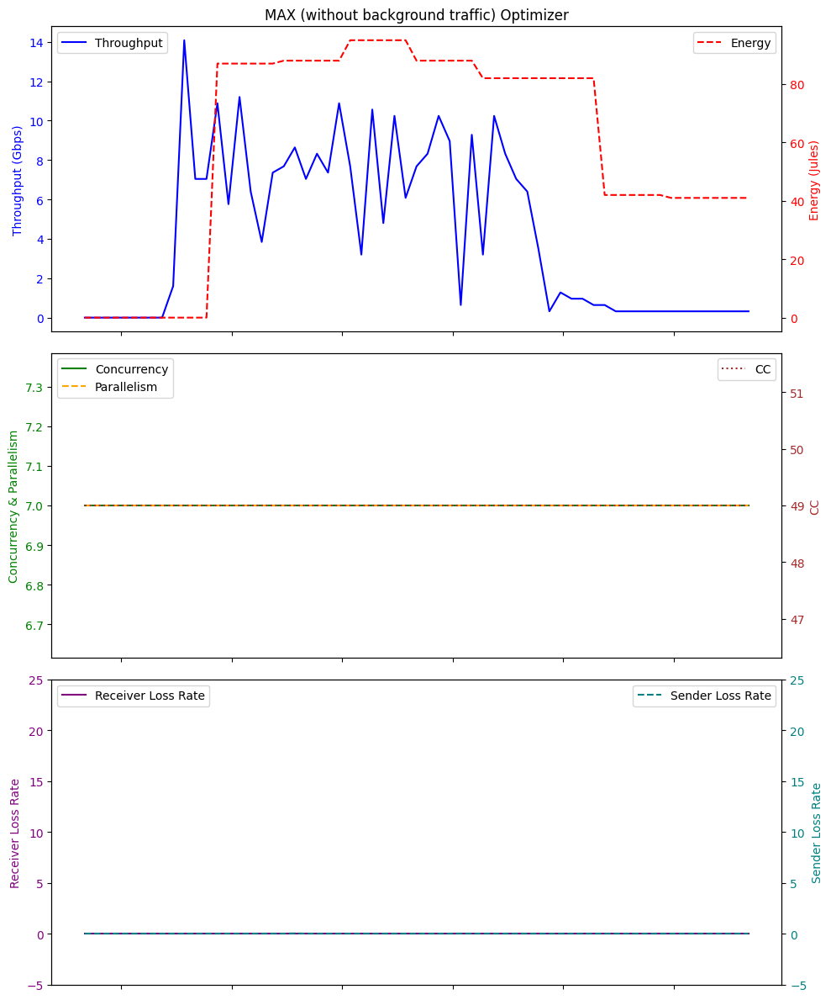

Average Throughput: 4.270163934426229
Total Energy: 3630.0
Total loss rate: 0.03280922064976355
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:07:01.065765        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:07:02.062119        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:07:03.059952        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:07:04.062883        0.00          0.0  49    0.0  32.6   
4  2024-01-26 06:07:05.064657        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:07:57.112870        2.24          0.0  49    2.0  32.8   
57 2024-01-26 06:07:58.113525        2.24          0.0  49    2.0  32.7   
58 2024-01-26 06:07:59.113460        2.24          0.0  49    2.0  32.7   
59 2024-01-26 06:08:00.114952        2.24          0.0  49    2.0  32.7   
60 2024-01-26 06:08:01.117824        2.24          0.0  49    2.0  32.8   

   

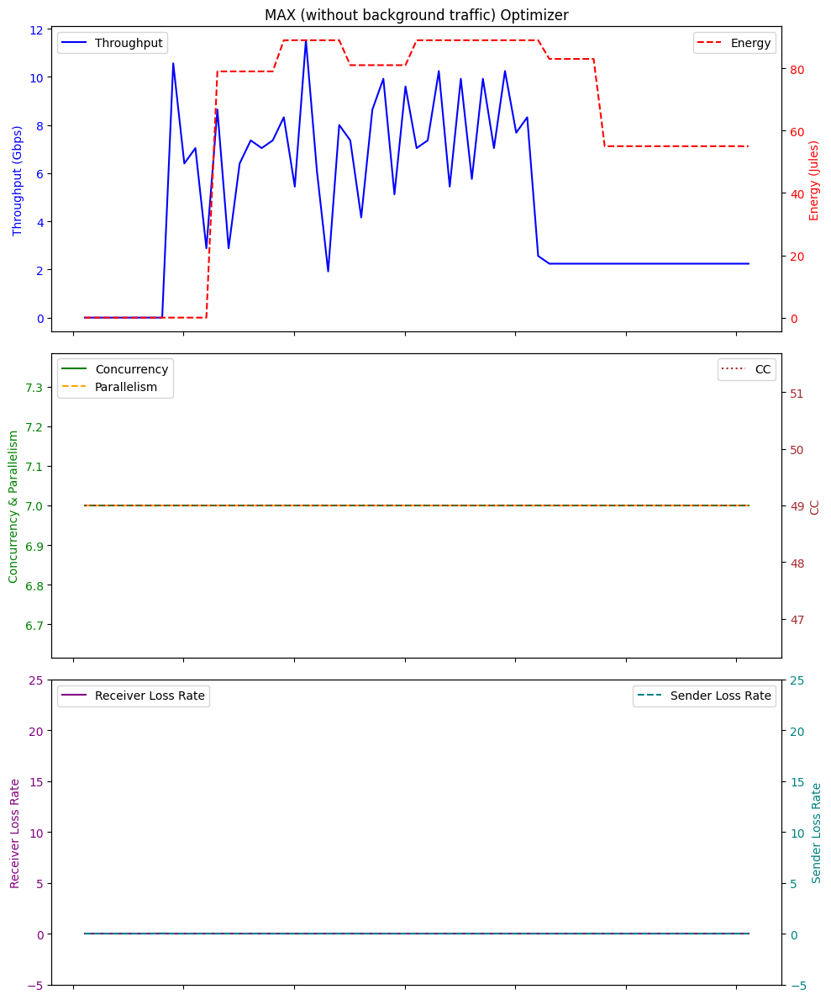

Average Throughput: 4.700327868852461
Total Energy: 3747.0
Total loss rate: 0.0336870010137422
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:07:22.134887        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:07:23.133200        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:07:24.133185        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:07:25.133147        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:07:26.136487        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
85 2024-01-26 05:08:47.223168        0.64          0.0  49    1.0  32.7   
86 2024-01-26 05:08:48.222458        0.64          0.0  49    1.0  32.6   
87 2024-01-26 05:08:49.222357        0.64          0.0  49    1.0  32.7   
88 2024-01-26 05:08:50.225103        0.64          0.0  49    1.0  32.8   
89 2024-01-26 05:08:51.227404        0.64          0.0  49    1.0  32.7   

    

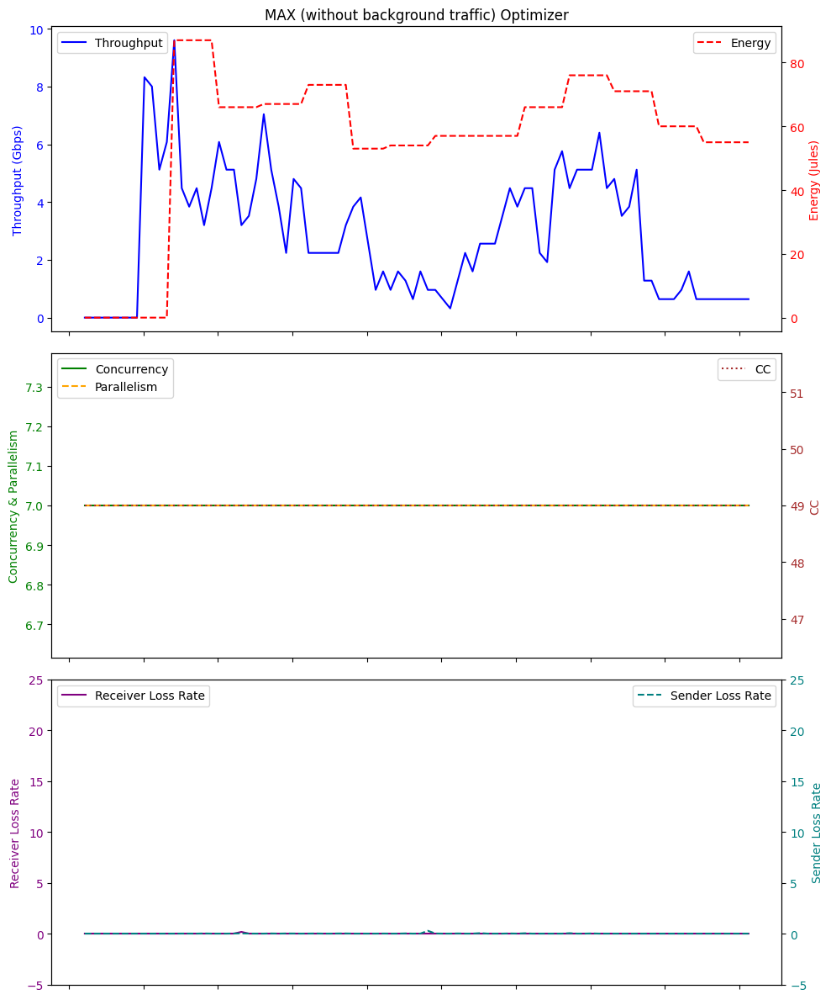

Average Throughput: 2.8693333333333335
Total Energy: 5054.0
Total loss rate: 0.6117935442292102
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:39:29.504634        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:39:30.501195        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:39:31.500897        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:39:32.504875        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:39:33.504454        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:40:25.552104        0.32          0.0  49    0.0  32.7   
57 2024-01-26 06:40:26.552880        0.32          0.0  49    0.0  32.7   
58 2024-01-26 06:40:27.555855        0.32          0.0  49    0.0  32.6   
59 2024-01-26 06:40:28.557505        0.32          0.0  49    0.0  32.8   
60 2024-01-26 06:40:29.555631        0.32          0.0  49    0.0  32.7   

   

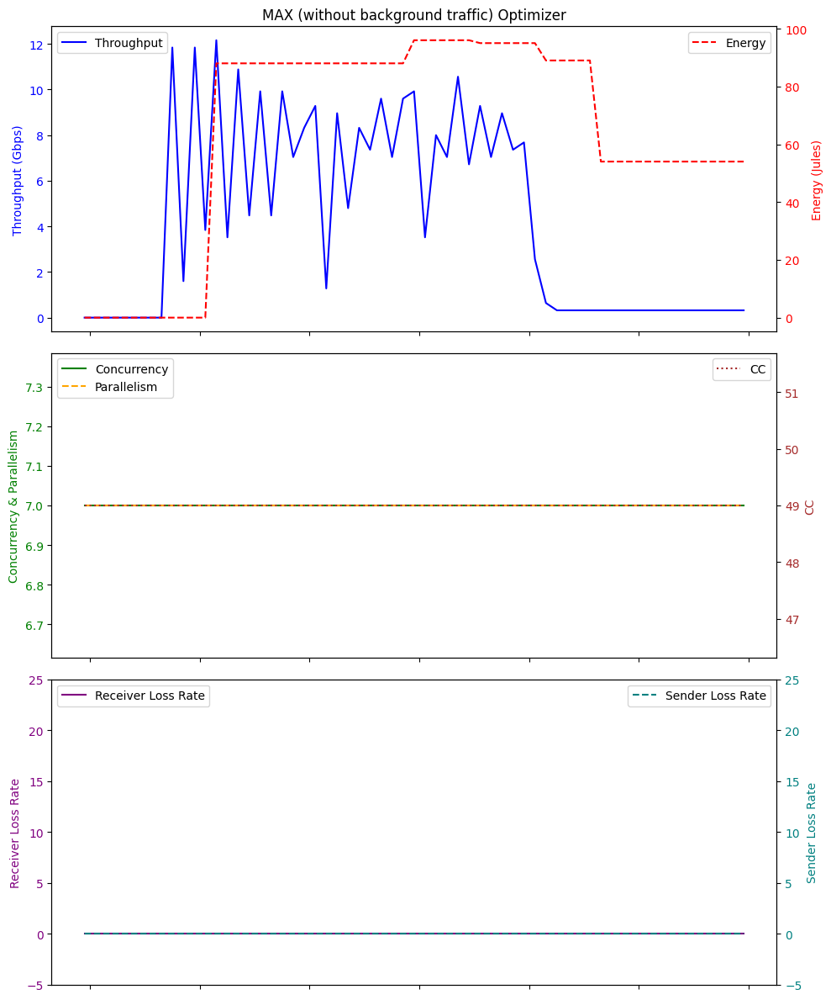

Average Throughput: 4.280655737704917
Total Energy: 3931.0
Total loss rate: 0.008157461037729491
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:30:13.915591        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:30:14.911935        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:30:15.911694        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:30:16.911584        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:30:17.914918        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:31:09.964575        0.32          0.0  49    0.0  32.7   
57 2024-01-26 05:31:10.964426        0.32          0.0  49    0.0  32.6   
58 2024-01-26 05:31:11.964075        0.32          0.0  49    0.0  32.7   
59 2024-01-26 05:31:12.964231        0.32          0.0  49    0.0  32.8   
60 2024-01-26 05:31:13.967217        0.32          0.0  49    0.0  32.7   

  

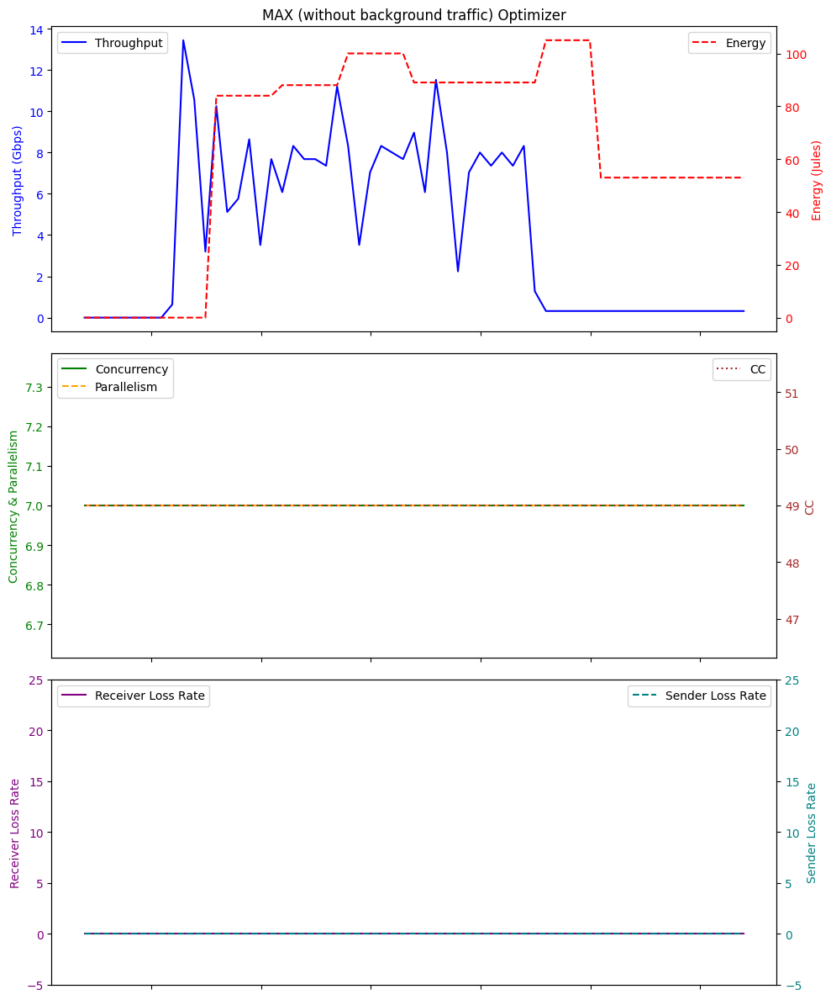

Average Throughput: 4.102295081967212
Total Energy: 3967.0
Total loss rate: 0.02296521509287172
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:46:06.812659        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:46:07.807171        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:46:08.810179        0.00          0.0  49    0.0  32.8   
3  2024-01-26 05:46:09.811682        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:46:10.811079        0.00          0.0  49    0.0  32.7   
5  2024-01-26 05:46:11.813700        0.00          0.0  49    0.0  32.6   
6  2024-01-26 05:46:12.807480        0.00          0.0  49    0.0  32.6   
7  2024-01-26 05:46:13.816747        0.00          0.0  49    0.0  33.0   
8  2024-01-26 05:46:14.813534        8.32          0.0  49    7.0  33.0   
9  2024-01-26 05:46:15.817836        4.48          0.0  49    4.0  32.6   
10 2024-01-26 05:46:16.818847       10.24          0.0  49    9.0  32.8   
11 2

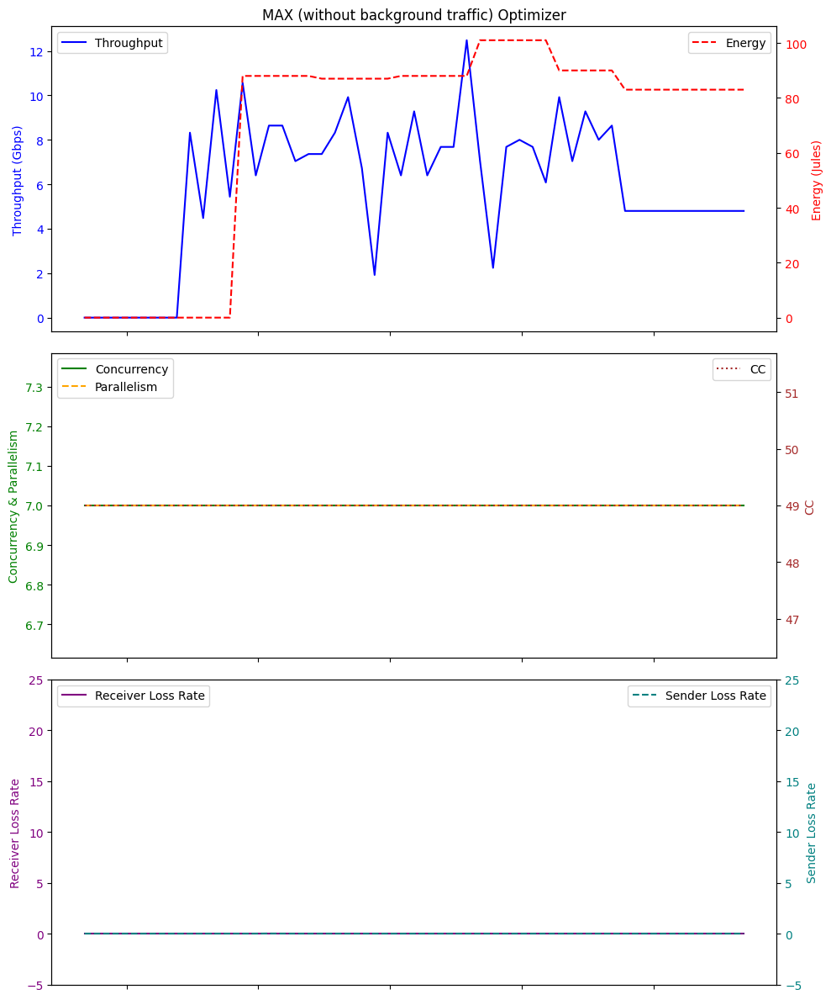

Average Throughput: 5.866666666666667
Total Energy: 3464.0
Total loss rate: 0.01942134522803817
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:24:06.172842        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:24:07.167379        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:24:08.168192        0.00          0.0  49    0.0  32.9   
3  2024-01-26 07:24:09.167459        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:24:10.169097        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:25:02.221608        3.84          0.0  49    3.0  32.6   
57 2024-01-26 07:25:03.223759        3.84          0.0  49    3.0  32.7   
58 2024-01-26 07:25:04.222669        3.84          0.0  49    3.0  32.6   
59 2024-01-26 07:25:05.222350        3.84          0.0  49    3.0  32.7   
60 2024-01-26 07:25:06.224177        3.84          0.0  49    3.0  32.8   

   

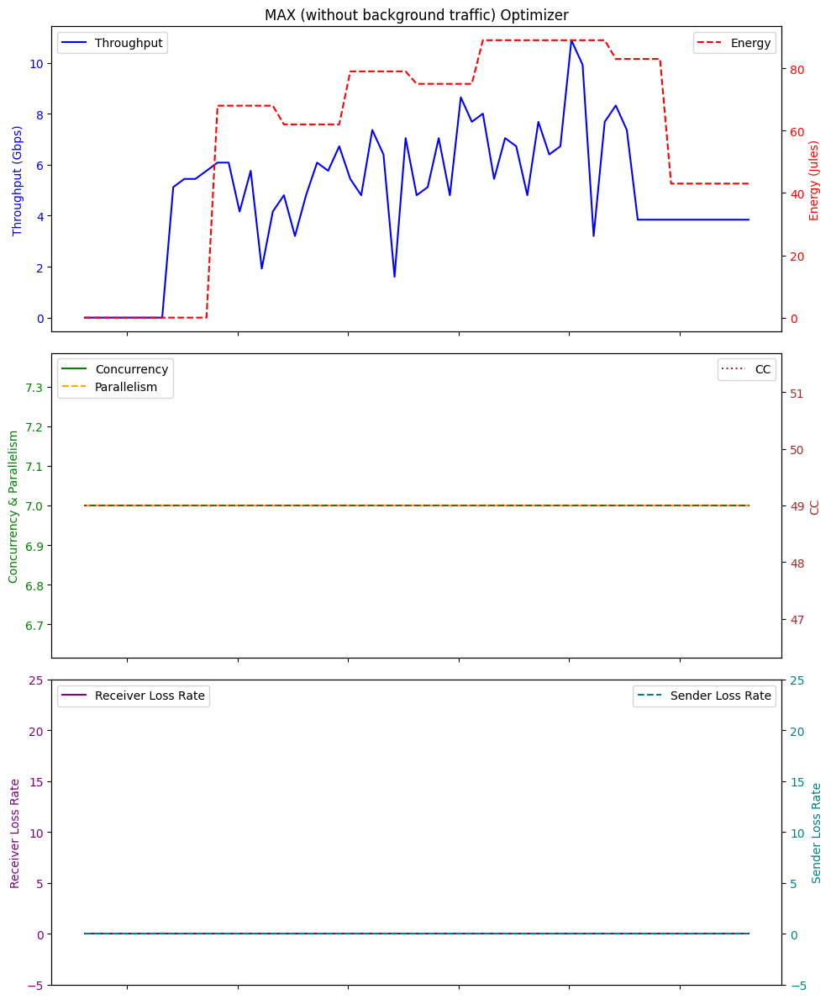

Average Throughput: 4.826229508196719
Total Energy: 3531.0
Total loss rate: 0.02528817157046258
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:17:52.455158        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:17:53.451866        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:17:54.454067        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:17:55.456399        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:17:56.454767        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:18:48.508489        0.32          0.0  49    0.0  32.7   
57 2024-01-26 06:18:49.509088        0.32          0.0  49    0.0  32.7   
58 2024-01-26 06:18:50.513039        0.32          0.0  49    0.0  32.6   
59 2024-01-26 06:18:51.512435        0.32          0.0  49    0.0  32.6   
60 2024-01-26 06:18:52.509265        0.32          0.0  49    0.0  32.6   

   

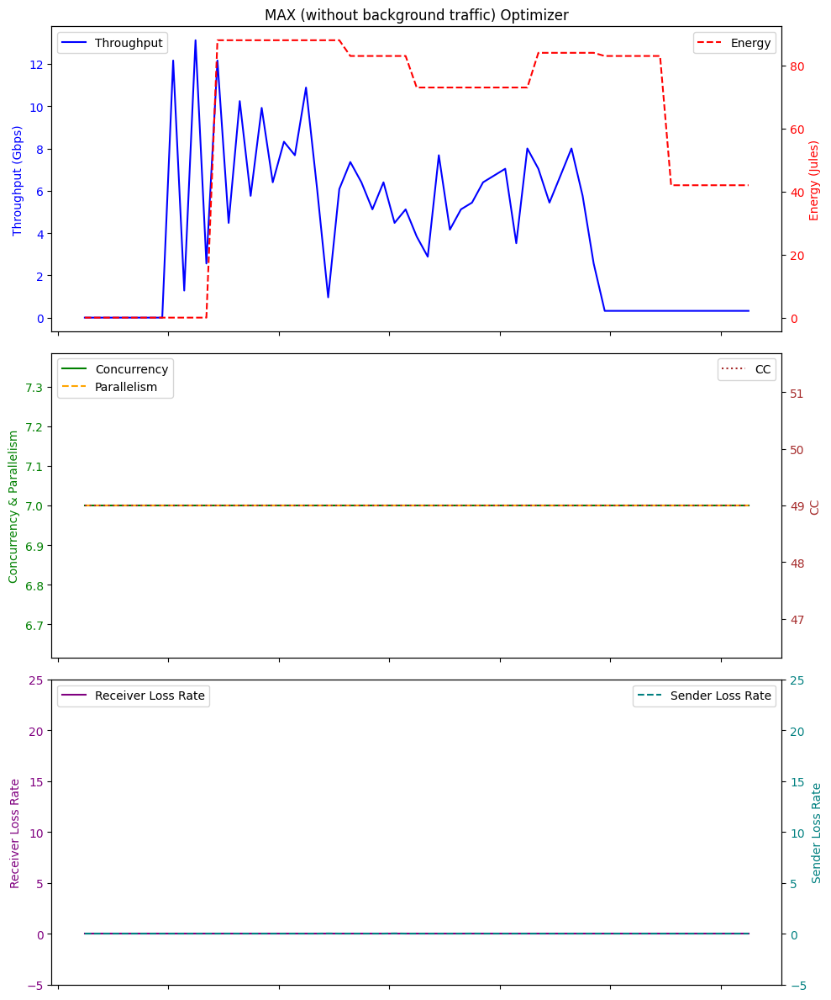

Average Throughput: 4.159999999999999
Total Energy: 3695.0
Total loss rate: 0.036953489541442744
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:44:59.514014        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:45:00.510520        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:45:01.511414        0.00          0.0  49    0.0  32.8   
3  2024-01-26 06:45:02.513550        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:45:03.513777        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:45:55.565383        0.32          0.0  49    0.0  32.6   
57 2024-01-26 06:45:56.565164        0.32          0.0  49    0.0  32.6   
58 2024-01-26 06:45:57.569313        0.32          0.0  49    0.0  32.7   
59 2024-01-26 06:45:58.567995        0.32          0.0  49    0.0  32.7   
60 2024-01-26 06:45:59.568927        0.32          0.0  49    0.0  32.6   

  

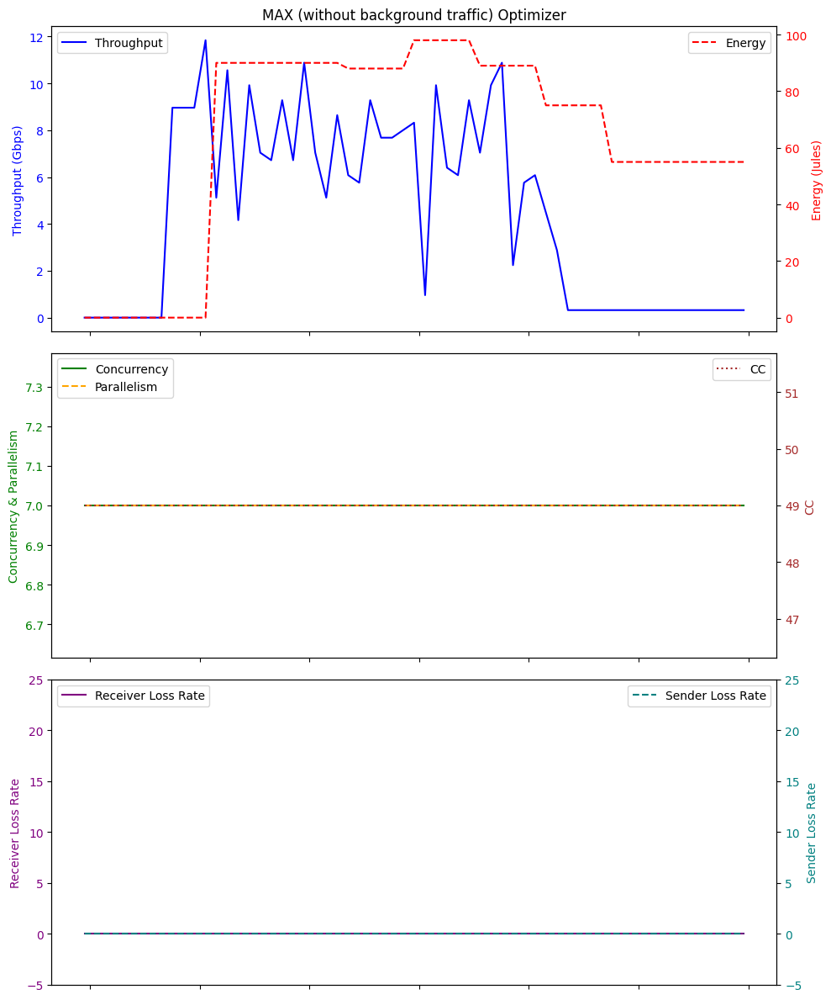

Average Throughput: 4.427540983606557
Total Energy: 3895.0
Total loss rate: 0.006256408227934156
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:34:13.020268        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:34:14.016449        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:34:15.017490        0.00          0.0  49    0.0  32.7   
3  2024-01-26 07:34:16.019656        0.00          0.0  49    0.0  32.7   
4  2024-01-26 07:34:17.019943        0.00          0.0  49    0.0  32.9   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 07:35:09.072397        0.32          0.0  49    0.0  32.6   
57 2024-01-26 07:35:10.075245        0.32          0.0  49    0.0  32.7   
58 2024-01-26 07:35:11.076057        0.32          0.0  49    0.0  32.6   
59 2024-01-26 07:35:12.072137        0.32          0.0  49    0.0  32.6   
60 2024-01-26 07:35:13.071414        0.32          0.0  49    0.0  32.8   

  

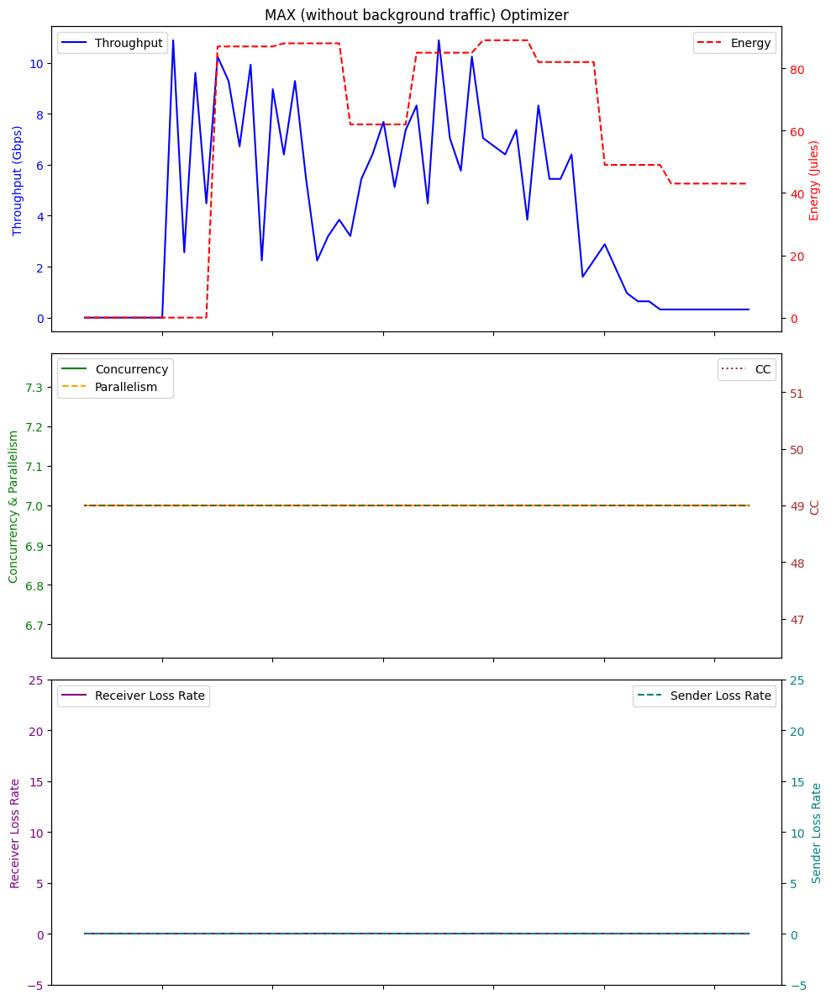

Average Throughput: 4.228196721311475
Total Energy: 3507.0
Total loss rate: 0.06776095354219455
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:02:00.643630        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:02:01.639246        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:02:02.642964        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:02:03.644324        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:02:04.642743        0.00          0.0  49    0.0  32.7   
5  2024-01-26 06:02:05.644526        0.00          0.0  49    0.0  32.6   
6  2024-01-26 06:02:06.674538        0.00          0.0  49    0.0  32.6   
7  2024-01-26 06:02:07.640883        0.00          0.0  49    0.0  33.1   
8  2024-01-26 06:02:08.643115        1.92          0.0  49    2.0  33.0   
9  2024-01-26 06:02:09.639228       13.76          0.0  49   12.0  32.9   
10 2024-01-26 06:02:10.670955        3.84          0.0  49    3.0  33.6   
11 2

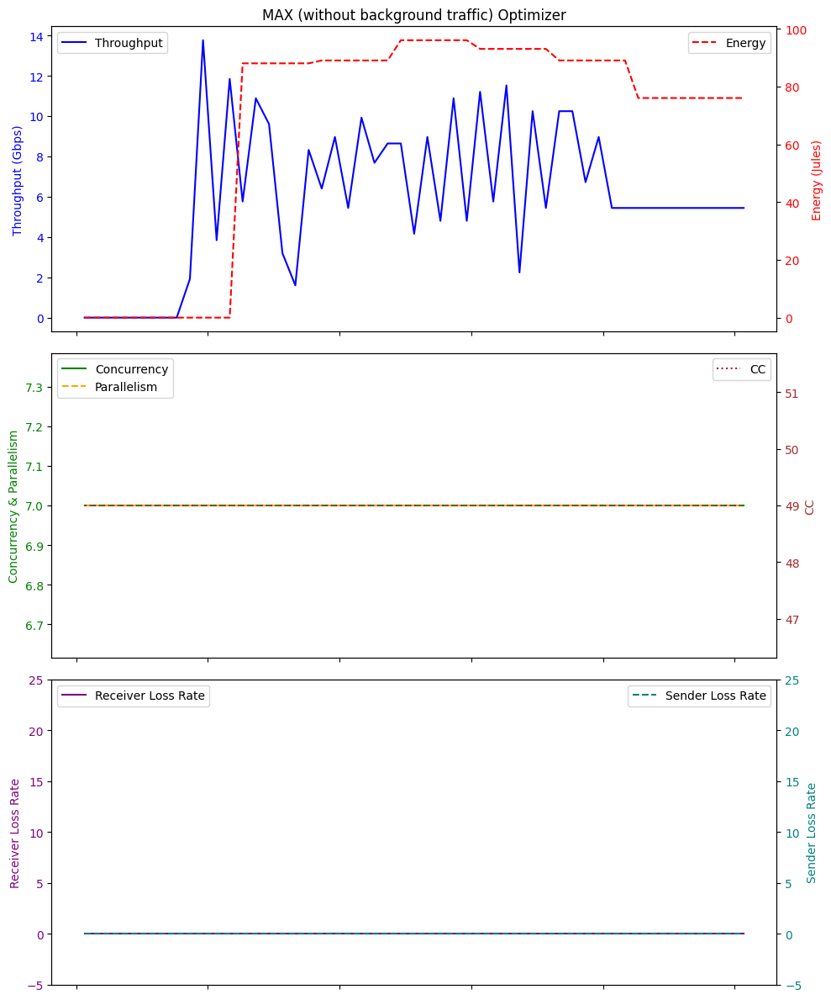

Average Throughput: 5.929411764705883
Total Energy: 3414.0
Total loss rate: 0.010097243154487894
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:13:47.846910        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:13:48.843008        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:13:49.843548        0.00          0.0  49    0.0  32.8   
3  2024-01-26 05:13:50.846015        0.00          0.0  49    0.0  32.8   
4  2024-01-26 05:13:51.846161        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:14:43.896264        0.32          0.0  49    0.0  32.7   
57 2024-01-26 05:14:44.899019        0.32          0.0  49    0.0  32.7   
58 2024-01-26 05:14:45.902109        0.32          0.0  49    0.0  32.6   
59 2024-01-26 05:14:46.900231        0.32          0.0  49    0.0  32.7   
60 2024-01-26 05:14:47.894448        0.32          0.0  49    0.0  32.8   

  

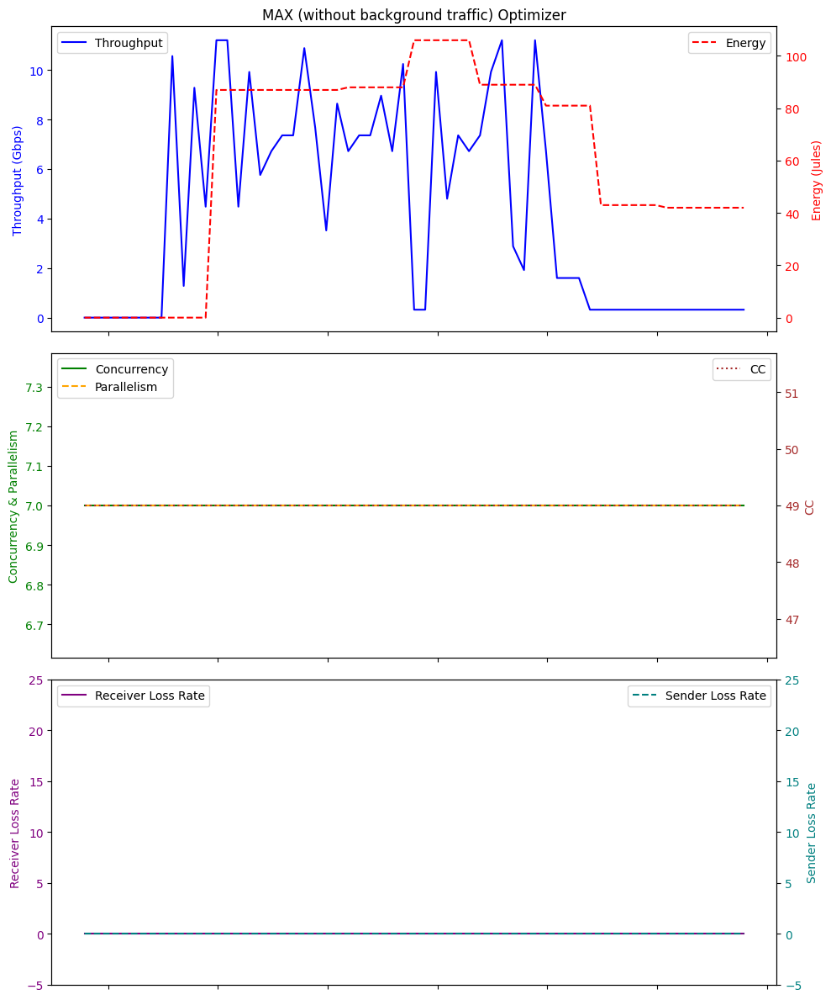

Average Throughput: 4.228196721311475
Total Energy: 3741.0
Total loss rate: 0.00825597978143169
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:23:09.466333        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:23:10.462085        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:23:11.462444        0.00          0.0  49    0.0  32.7   
3  2024-01-26 06:23:12.464787        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:23:13.465665        0.00          0.0  49    0.0  47.4   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:24:05.518022        2.56          0.0  49    2.0  33.0   
57 2024-01-26 06:24:06.517493        2.56          0.0  49    2.0  32.7   
58 2024-01-26 06:24:07.518721        2.56          0.0  49    2.0  32.7   
59 2024-01-26 06:24:08.518886        2.56          0.0  49    2.0  32.7   
60 2024-01-26 06:24:09.519543        2.56          0.0  49    2.0  32.8   

   

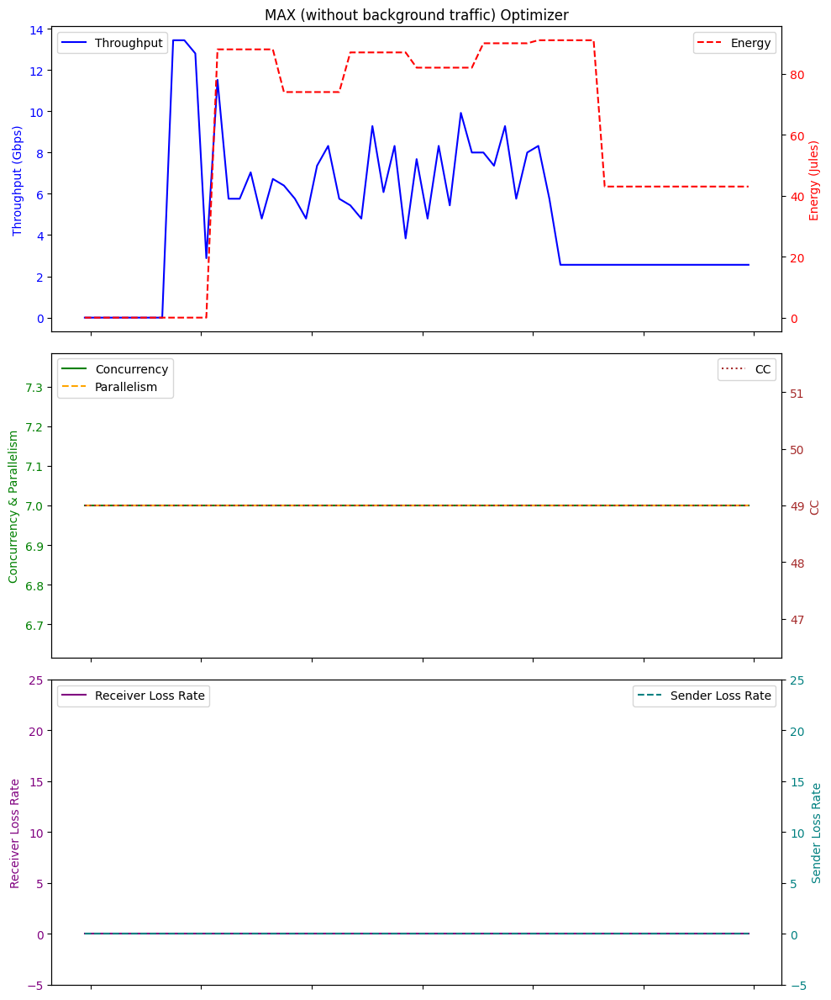

Average Throughput: 4.967868852459016
Total Energy: 3584.0
Total loss rate: 0.010312855902792434
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 07:45:24.410077        0.00          0.0  49    0.0   0.0   
1  2024-01-26 07:45:25.404419        0.00          0.0  49    0.0   0.0   
2  2024-01-26 07:45:26.406603        0.00          0.0  49    0.0  32.6   
3  2024-01-26 07:45:27.408104        0.00          0.0  49    0.0  32.6   
4  2024-01-26 07:45:28.407143        0.00          0.0  49    0.0  32.6   
5  2024-01-26 07:45:29.408916        0.00          0.0  49    0.0  32.7   
6  2024-01-26 07:45:30.442093        0.00          0.0  49    0.0  32.6   
7  2024-01-26 07:45:31.408234        0.00          0.0  49    0.0  33.3   
8  2024-01-26 07:45:32.420549        1.92          0.0  49    2.0  32.7   
9  2024-01-26 07:45:33.407729       13.76          0.0  49   12.0  33.2   
10 2024-01-26 07:45:34.408113        4.16          0.0  49    4.0  33.0   
11 

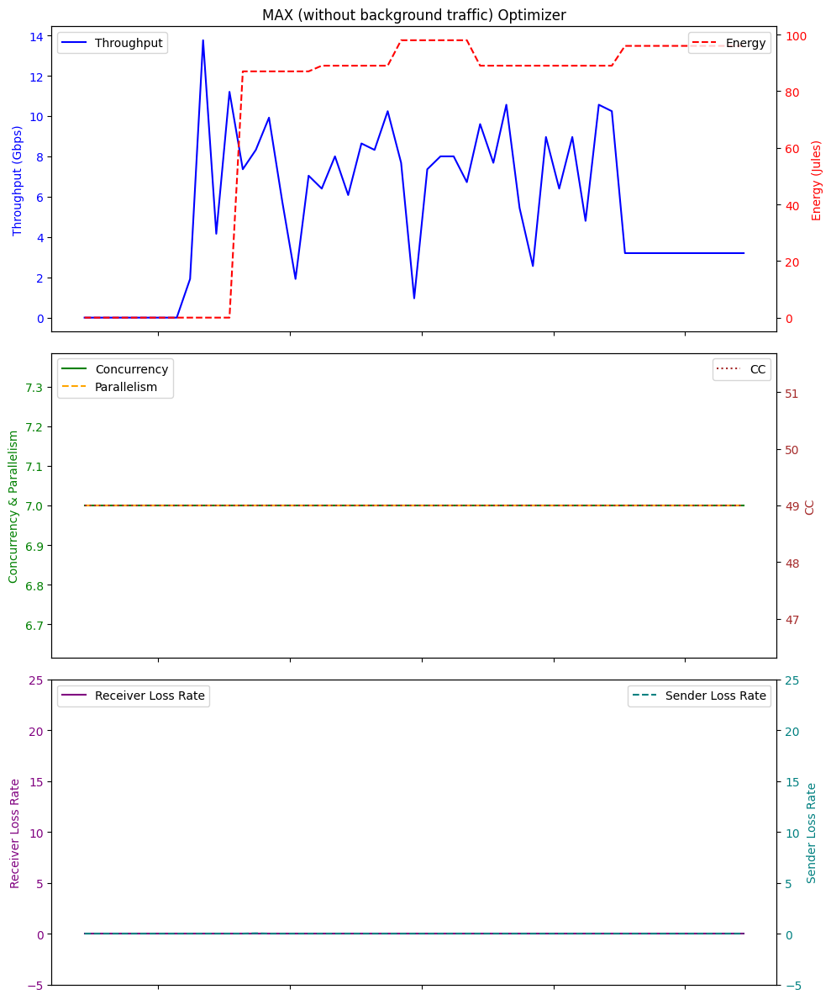

Average Throughput: 5.402352941176471
Total Energy: 3583.0
Total loss rate: 0.03376669135325628
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:12:01.776648        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:12:02.772451        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:12:03.775492        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:12:04.775116        0.00          0.0  49    0.0  32.8   
4  2024-01-26 06:12:05.779911        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:12:57.829145        1.28          0.0  49    1.0  32.6   
57 2024-01-26 06:12:58.830067        1.28          0.0  49    1.0  32.7   
58 2024-01-26 06:12:59.829909        1.28          0.0  49    1.0  32.8   
59 2024-01-26 06:13:00.832452        1.28          0.0  49    1.0  32.7   
60 2024-01-26 06:13:01.833208        1.28          0.0  49    1.0  32.7   

   

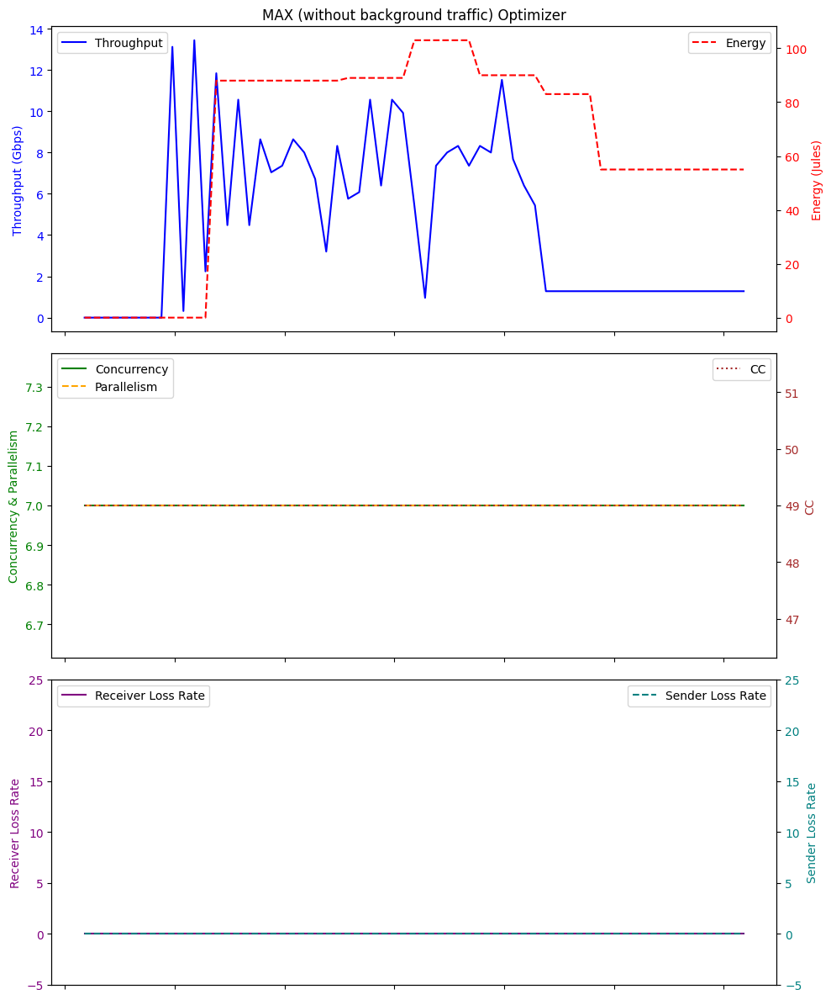

Average Throughput: 4.537704918032785
Total Energy: 3933.0
Total loss rate: 0.01596743833210967
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 06:50:32.208691        0.00          0.0  49    0.0   0.0   
1  2024-01-26 06:50:33.205230        0.00          0.0  49    0.0   0.0   
2  2024-01-26 06:50:34.204846        0.00          0.0  49    0.0  32.6   
3  2024-01-26 06:50:35.208055        0.00          0.0  49    0.0  32.7   
4  2024-01-26 06:50:36.208137        0.00          0.0  49    0.0  32.6   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 06:51:28.254742        0.32          0.0  49    0.0  32.7   
57 2024-01-26 06:51:29.254622        0.32          0.0  49    0.0  32.7   
58 2024-01-26 06:51:30.257693        0.32          0.0  49    0.0  32.7   
59 2024-01-26 06:51:31.257831        0.32          0.0  49    0.0  32.8   
60 2024-01-26 06:51:32.257483        0.32          0.0  49    0.0  32.7   

   

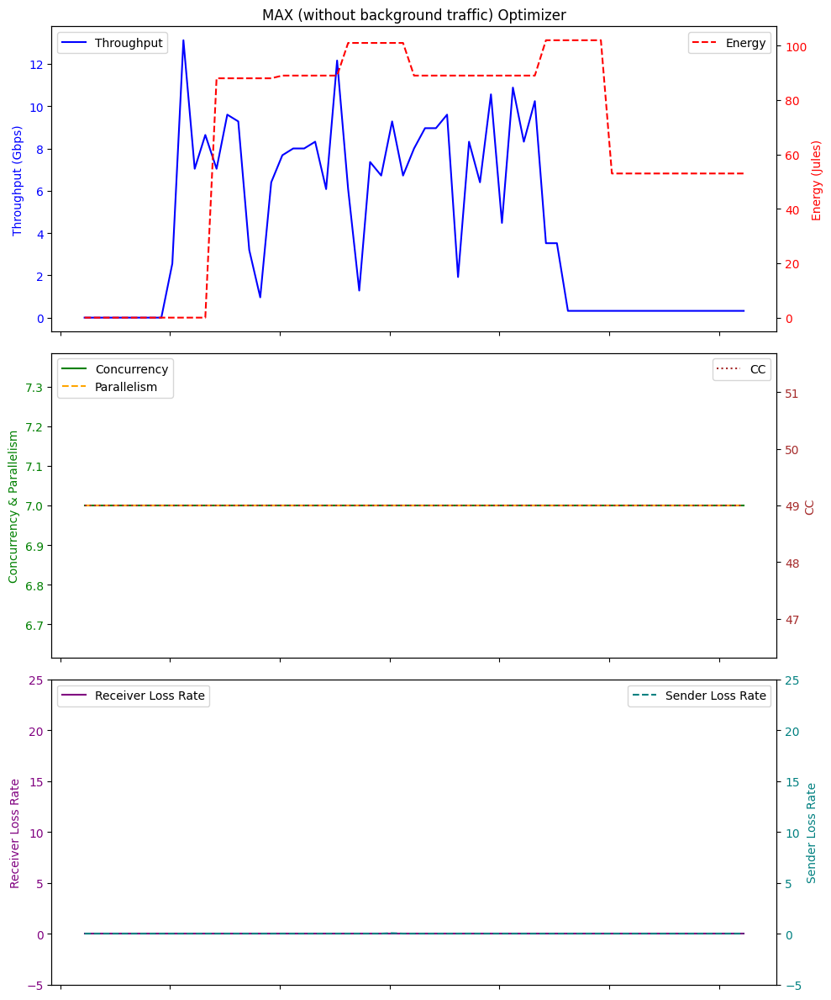

Average Throughput: 4.338360655737704
Total Energy: 4037.0
Total loss rate: 0.046872857763867876
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:56:49.574422        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:56:50.570430        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:56:51.570838        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:56:52.573241        0.00          0.0  49    0.0  32.6   
4  2024-01-26 05:56:53.572936        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:57:45.622877        0.32          0.0  49    0.0  32.7   
57 2024-01-26 05:57:46.623566        0.32          0.0  49    0.0  32.7   
58 2024-01-26 05:57:47.626348        0.32          0.0  49    0.0  32.7   
59 2024-01-26 05:57:48.626631        0.32          0.0  49    0.0  32.8   
60 2024-01-26 05:57:49.627891        0.32          0.0  49    0.0  32.7   

  

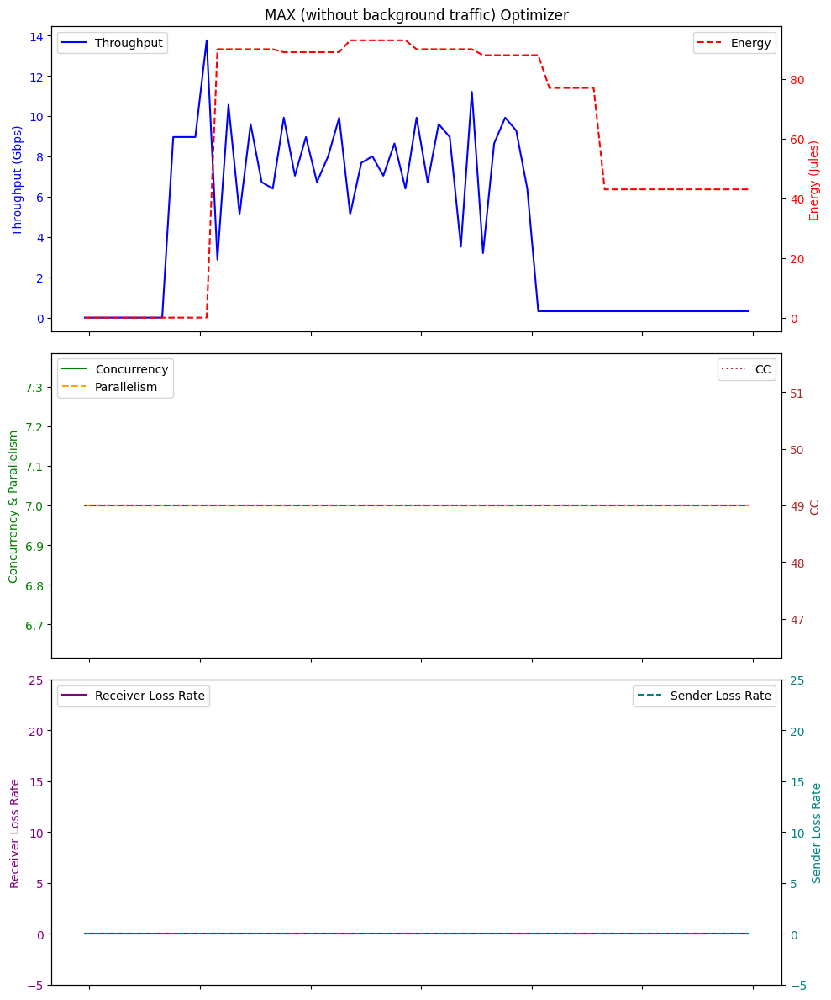

Average Throughput: 4.411803278688524
Total Energy: 3687.0
Total loss rate: 0.015749381742912107
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:51:20.053788        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:51:21.049956        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:51:22.053096        0.00          0.0  49    0.0  32.8   
3  2024-01-26 05:51:23.053284        0.00          0.0  49    0.0  32.8   
4  2024-01-26 05:51:24.053028        0.00          0.0  49    0.0  32.8   
..                        ...         ...          ...  ..    ...   ...   
66 2024-01-26 05:52:26.115126        0.32          0.0  49    0.0  32.7   
67 2024-01-26 05:52:27.114913        0.32          0.0  49    0.0  32.6   
68 2024-01-26 05:52:28.115971        0.32          0.0  49    0.0  32.7   
69 2024-01-26 05:52:29.118457        0.32          0.0  49    0.0  32.6   
70 2024-01-26 05:52:30.118471        0.32          0.0  49    0.0  32.7   

  

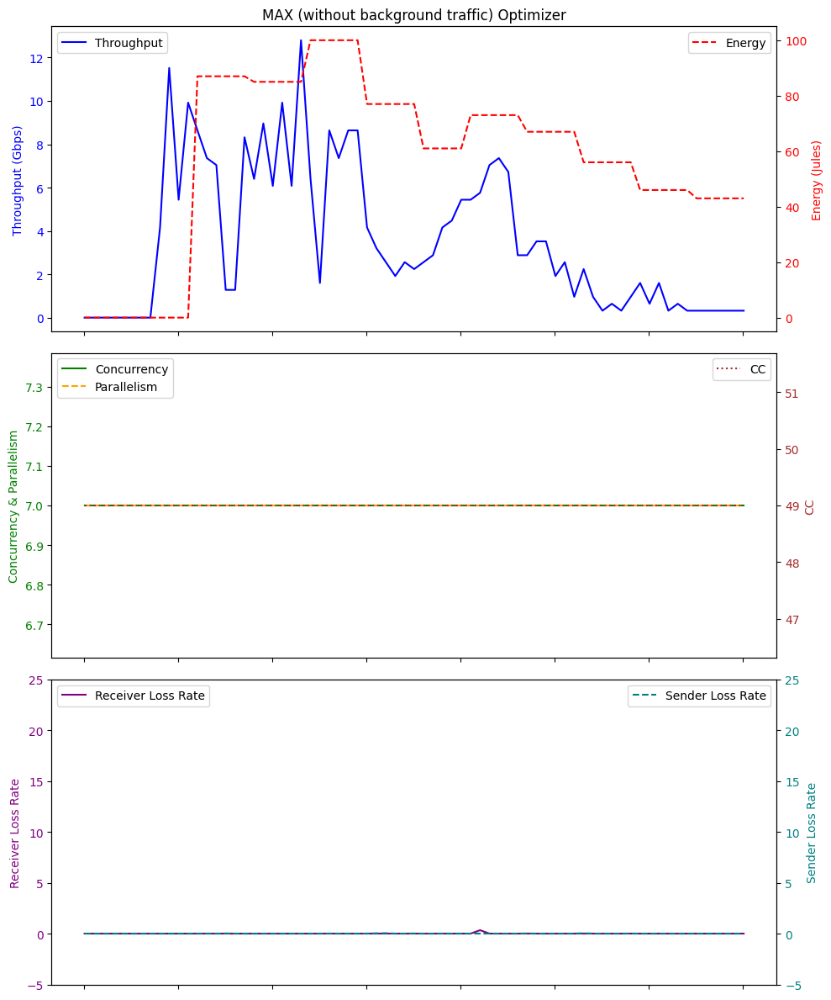

Average Throughput: 3.6011267605633797
Total Energy: 4109.0
Total loss rate: 0.17054526301094236
                         Time  Throughput  receiver_lr  CC  Score   RTT  \
0  2024-01-26 05:41:06.398010        0.00          0.0  49    0.0   0.0   
1  2024-01-26 05:41:07.394934        0.00          0.0  49    0.0   0.0   
2  2024-01-26 05:41:08.395348        0.00          0.0  49    0.0  32.7   
3  2024-01-26 05:41:09.395665        0.00          0.0  49    0.0  32.7   
4  2024-01-26 05:41:10.396182        0.00          0.0  49    0.0  32.7   
..                        ...         ...          ...  ..    ...   ...   
56 2024-01-26 05:42:02.449090        0.32          0.0  49    0.0  32.8   
57 2024-01-26 05:42:03.449214        0.32          0.0  49    0.0  32.6   
58 2024-01-26 05:42:04.449179        0.32          0.0  49    0.0  32.7   
59 2024-01-26 05:42:05.451894        0.32          0.0  49    0.0  32.6   
60 2024-01-26 05:42:06.453202        0.32          0.0  49    0.0  32.7   

  

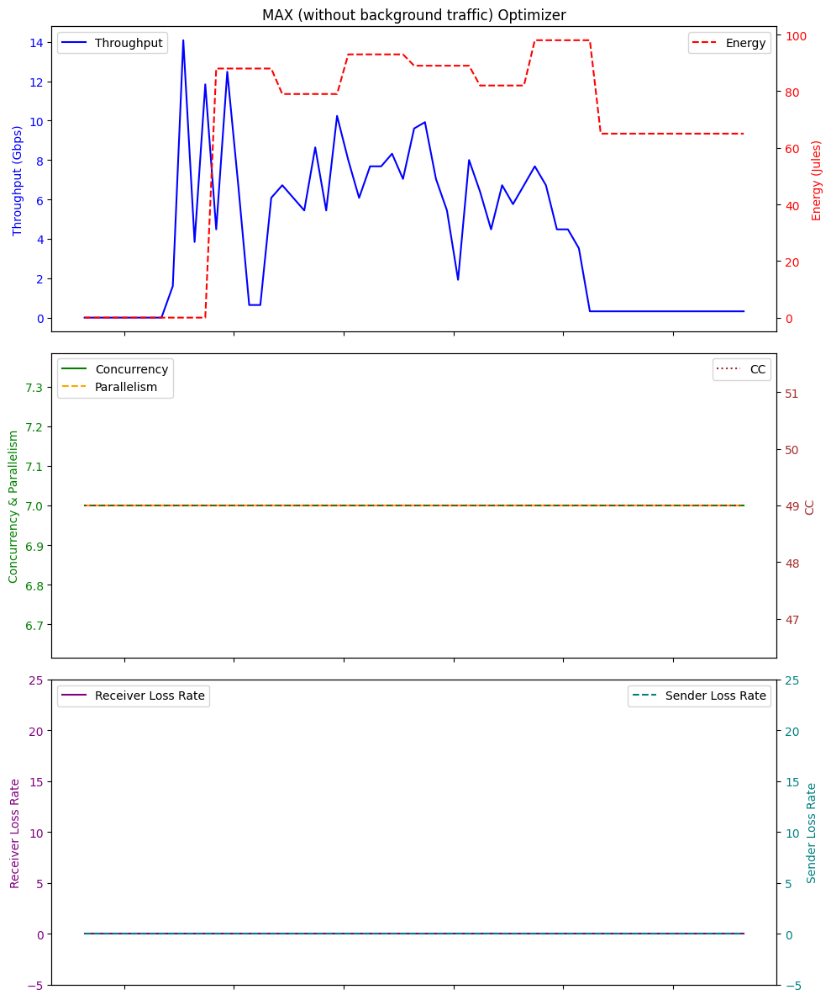

Average Throughput: 4.154754098360655
Total Energy: 4002.0
Total loss rate: 0.01635541262649017


In [14]:
# Example usage MAX
directory = './logFileDir_simu_w_bg/STATIC/'
dfs = process_log_files(directory,"STATIC_logFile_")

max_throughput_list=[]
max_energy_list=[]
max_plr_list=[]
# Print or process the dataframes as needed
for df in dfs:
    print(df)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 12), sharex=True)


    # Top plot with Throughput and Energy
    ax1.plot(df['Time'], df['Throughput'], label='Throughput', color='blue')
    ax1.set_ylabel('Throughput (Gbps)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')
    ax1.set_title('MAX (without background traffic) Optimizer')

    ax2_twin = ax1.twinx()
    ax2_twin.plot(df['Time'], df['Energy'], label='Energy', color='red', linestyle='--')
    ax2_twin.set_ylabel('Energy (Jules)', color='red')
    ax2_twin.tick_params(axis='y', labelcolor='red')

    # Bottom plot with Concurrency, Parallelism, and CC
    ax2.plot(df['Time'], df['concurrency'], label='Concurrency', color='green')
    ax2.plot(df['Time'], df['parallelism'], label='Parallelism', color='orange', linestyle='--')
    ax2.set_ylabel('Concurrency & Parallelism', color='green')
    ax2.tick_params(axis='y', labelcolor='green')

    ax3_twin = ax2.twinx()
    ax3_twin.plot(df['Time'], df['CC'], label='CC', color='brown', linestyle=':')
    ax3_twin.set_ylabel('CC', color='brown')
    ax3_twin.tick_params(axis='y', labelcolor='brown')
    
    # Bottom plot with Receiver Loss Rate and Sender Loss Rate
    ax3.plot(df['Time'], df['receiver_lr'], label='Receiver Loss Rate', color='purple', linestyle='-')
    ax3.set_ylabel('Receiver Loss Rate', color='purple')
    ax3.tick_params(axis='y', labelcolor='purple')

    ax4_twin = ax3.twinx()
    ax4_twin.plot(df['Time'], df['sender_lr'], label='Sender Loss Rate', color='teal', linestyle='--')
    ax4_twin.set_ylabel('Sender Loss Rate', color='teal')
    ax4_twin.tick_params(axis='y', labelcolor='teal')
    ax4_twin.set_ylim(-5,25)

    ax3.set_ylim(-5,25)

    # Formatting the x-axis to show time correctly
#     ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: (datetime.min + timedelta(seconds=x)).strftime('%H:%M:%S')))
#     ax2.set_xticklabels([])
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    # Fix for overlapping layouts
    fig.tight_layout()

    # Legend
    ax1.legend(loc='upper left')
    ax2_twin.legend(loc='upper right')
    ax2.legend(loc='upper left')
    ax3_twin.legend(loc='upper right')
    ax3.legend(loc='upper left')
    ax4_twin.legend(loc='upper right')
    plt.show()

    average_throughput = df['Throughput'].mean()
    print("Average Throughput:", average_throughput)
    total_energy = df['Energy'].sum()
    print("Total Energy:", total_energy)
    total_plr = df['sender_lr'].sum()
    print("Total loss rate:", total_plr)
    
    max_throughput_list.append(average_throughput)
    max_energy_list.append(total_energy)
    max_plr_list.append(total_plr)


In [15]:
result_dictionary={"Throughput":[bo_throughput_list,gd_throughput_list,ppo_throughput_list,max_throughput_list],"Energy":[bo_energy_list,gd_energy_list,ppo_energy_list,max_energy_list],"lossRate":[bo_plr_list,gd_plr_list,ppo_plr_list,max_plr_list]}
print(result_dictionary)

{'Throughput': [[4.898461538461538, 3.6146478873239434, 3.633170731707318, 3.8444444444444446, 2.466796116504854, 4.953846153846153, 2.688627450980391, 0.7719521912350598, 3.795555555555556, 5.345882352941176, 3.2702439024390246, 3.7426086956521742, 3.274146341463414, 3.0985365853658533, 3.668732394366196, 2.254159292035398, 4.947692307692307, 3.6755555555555555, 3.708493150684932, 4.0888888888888895, 2.7939784946236554, 4.283870967741934, 4.216774193548387, 2.6666666666666665, 3.768888888888889, 3.9377777777777783, 2.5192156862745096, 5.599999999999999, 2.647843137254901, 4.129032258064515], [2.1679999999999997, 2.7552000000000008, 2.3447272727272725, 2.1413333333333338, 1.9963076923076921, 2.5791999999999997, 2.6719999999999993, 2.146666666666667, 3.721600000000001, 2.4116363636363625, 2.168, 2.176, 2.5439999999999996, 2.5599999999999996, 2.245333333333334, 2.4232727272727264, 2.399999999999999, 2.186666666666667, 2.4145454545454537, 2.7648000000000015, 2.152, 2.6175999999999995, 2.2

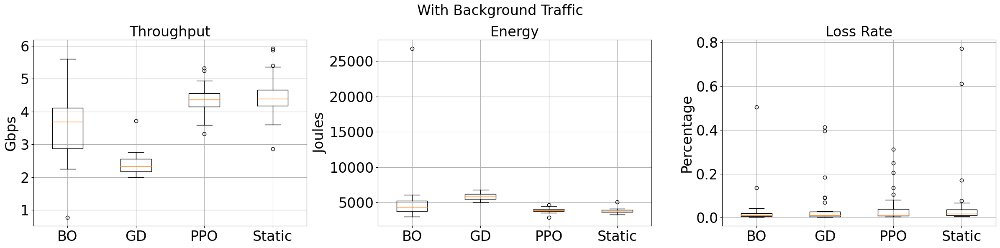

In [16]:
import matplotlib.pyplot as plt

labels = ['BO', 'GD', 'PPO', 'Static']

# Assuming result_dictionary is already defined with the relevant data
# result_dictionary = {...}

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 6))

# Font size for the ticks
tick_font_size = 24  # You can change this value as needed

# Plotting Throughput
axes[0].boxplot(result_dictionary['Throughput'], labels=labels)
axes[0].set_title('Throughput',fontsize=24)
axes[0].set_ylabel('Gbps',fontsize=24)
axes[0].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[0].grid(True)  # Adding grid

# Plotting Energy
axes[1].boxplot(result_dictionary['Energy'], labels=labels)
axes[1].set_title('Energy',fontsize=24)
axes[1].set_ylabel('Joules',fontsize=24)
axes[1].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[1].grid(True)  # Adding grid

# Plotting Loss Rate
axes[2].boxplot(result_dictionary['lossRate'], labels=labels)
axes[2].set_title('Loss Rate',fontsize=24)
axes[2].set_ylabel('Percentage',fontsize=24)
axes[2].tick_params(axis='both', which='major', labelsize=tick_font_size)  # Set tick font size
axes[2].grid(True)  # Adding grid
# axes[2].set_title('Without Background Traffic',fontsize=18)
plt.suptitle('With Background Traffic',fontsize=tick_font_size)

plt.tight_layout()
plt.show()


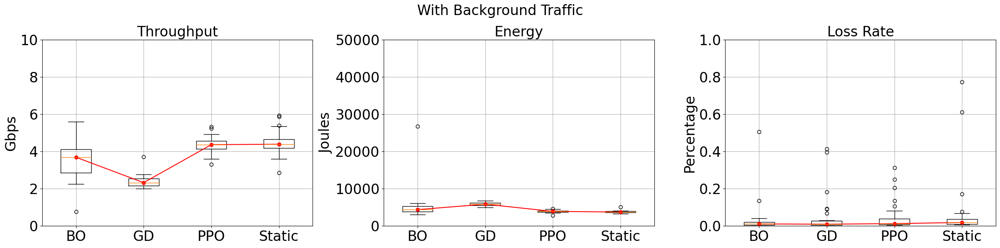

In [19]:
import matplotlib.pyplot as plt
import numpy as np

labels = ['BO', 'GD', 'PPO', 'Static']

# Assuming result_dictionary is already defined with the relevant data
# result_dictionary = {...}

# Creating subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 6))

# Font size for the ticks
tick_font_size = 24  # You can change this value as needed

# Function to plot boxplot and median line
def plot_with_median_line(ax, data, title, y_label,y_limit=None):
    # Plotting the boxplot
    boxplot = ax.boxplot(data, labels=labels)
    
    # Calculating medians
    medians = [np.median(d) for d in data]
    
    # x-coordinates for the medians
    median_positions = range(1, len(medians) + 1)
    
    # Adding a line plot for medians
    ax.plot(median_positions, medians, color='red', marker='o')  # You can change the color and marker style

    # Setting title, labels, and other properties
    ax.set_title(title, fontsize=24)
    ax.set_ylabel(y_label, fontsize=24)
    ax.tick_params(axis='both', which='major', labelsize=tick_font_size)
    if y_limit:
        ax.set_ylim(y_limit)
    ax.grid(True)

# Plotting Throughput
plot_with_median_line(axes[0], result_dictionary['Throughput'], 'Throughput', 'Gbps',(0,10))

# Plotting Energy
plot_with_median_line(axes[1], result_dictionary['Energy'], 'Energy', 'Joules',(0,50000))

# Plotting Loss Rate
plot_with_median_line(axes[2], result_dictionary['lossRate'], 'Loss Rate', 'Percentage',(0,1))

plt.suptitle('With Background Traffic', fontsize=tick_font_size)
plt.tight_layout()
plt.show()
